# Import Dependency


In [1]:
import tensorflow
import sys

import keras
from keras import optimizers
from keras import losses
from keras.models import Sequential, Model,load_model

import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, roc_auc_score,mean_squared_error,mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from statsmodels.tsa.seasonal import seasonal_decompose

import seaborn as sns
import pandas as pd
import numpy as np
from numpy import ndarray
import matplotlib
import math
import json

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline

import json
from datetime import datetime

import os.path
from os import path

print("Python: ", sys.version)
print("pandas: ", pd.__version__)
print("numpy: ", np.__version__)
print("seaborn: ", sns.__version__)
print("matplotlib: ", matplotlib.__version__)
print("sklearn: ", sklearn.__version__)
print("keras: ", tensorflow.keras.__version__)
print("tensorflow: ", tensorflow.__version__)

Python:  3.10.11 | packaged by Anaconda, Inc. | (main, Apr 20 2023, 18:56:50) [MSC v.1916 64 bit (AMD64)]
pandas:  1.5.2
numpy:  1.24.3
seaborn:  0.12.2
matplotlib:  3.7.1
sklearn:  1.2.0
keras:  2.10.0
tensorflow:  2.10.0


## Parameter 

In [15]:
# Dataset
DATA_TEST_PATH = 'dataset/anomaly/' #anomaly
DATA_TEST_PREFIX = '30nov-04des'

ENCODING = "ISO-8859-1" # csv encoding
DATE_COL_NAME = 'date'

LOG_EXPORT_PATH = 'log/'
if path.exists(LOG_EXPORT_PATH) == False:
  !mkdir LOG_EXPORT_PATH
  os.mkdir(LOG_EXPORT_PATH)

PLOT_EXPORT_PATH = 'plot/'
if path.exists(PLOT_EXPORT_PATH) == False:
  !mkdir PLOT_EXPORT_PATH
  os.mkdir(PLOT_EXPORT_PATH)

# scaler
SCALER = MinMaxScaler(feature_range = (0,1))
PLOT_VISIBLE = True
PLOT_SIZE = (12, 6)
PLOT_SAVE = True
TEST_SPACE = 5

RESULT_DATA = []*8 #temporary result data
RESULT_THRESHOLD = []*8 #temporary result threshold

sensors = [
    "date", #0
    "Excitation Field Current", #1
    "Excitation Field Voltage", #2
    "Power Factor", #3
    "Reactive Power", #4
    "Generator Gross Capacity", #5
]

seasonals = [
    "Trend",
    "Seasonal",
    "Residual"
]
test_types = ['extreme','variance','shift','trend']
anomaly_locations = {
    'extreme': {
        'timestamps': [
            [(576,576)],
            [(576,576),(1152,1152)],
            [(576,576),(1152,1152),(1728,1728)],
            [(576,576),(1152,1152),(1728,1728),(2304,2304)],
            [(576,576),(1152,1152),(1728,1728),(2304,2304),(2880,2880)],
            [(576,576),(1152,1152),(1728,1728),(2304,2304),(2880,2880),(3456,3456)],
            [(576,576),(1152,1152),(1728,1728),(2304,2304),(2880,2880),(3456,3456),(4032,4032)],
            [(576,576),(1152,1152),(1728,1728),(2304,2304),(2880,2880),(3456,3456),(4032,4032),(4608,4608)],
            [(576,576),(1152,1152),(1728,1728),(2304,2304),(2880,2880),(3456,3456),(4032,4032),(4608,4608),(5184,5184)],
            [(576,576),(1152,1152),(1728,1728),(2304,2304),(2880,2880),(3456,3456),(4032,4032),(4608,4608),(5184,5184),(5760,5760)],
        ],
        'factor': 8
    },
    'shift': {
        'timestamps': [
          [(576,586)],
          [(576,586),(1132,1152)],
          [(576,586),(1132,1152),(1698,1728)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032),(4528,4608)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032),(4528,4608),(5094,5184)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032),(4528,4608),(5094,5184),(5660,5760)],
        ],
        'factor': 3
    },
    'trend': {
        'timestamps': [
          [(576,586)],
          [(576,586),(1132,1152)],
          [(576,586),(1132,1152),(1698,1728)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032),(4528,4608)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032),(4528,4608),(5094,5184)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032),(4528,4608),(5094,5184),(5660,5760)],
        ],
        'factor': 2
    },
    'variance': {
        'timestamps': [
          [(576,586)],
          [(576,586),(1132,1152)],
          [(576,586),(1132,1152),(1698,1728)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032),(4528,4608)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032),(4528,4608),(5094,5184)],
          [(576,586),(1132,1152),(1698,1728),(2264,2304),(2830,2880),(3396,3456),(3962,4032),(4528,4608),(5094,5184),(5660,5760)],
        ],
        'factor': 8
    }
}

single_summary = []

## Fungsi - Fungsi

### Fungsi Reshape Data

In [4]:
def Reshape(df_input, prefix=''):
  
  # change to datetime format
  df_input['date'] = pd.to_datetime(df_input['date'])
  
  # sort datetime
  df_input.sort_values(by='date', ascending=True, inplace=True)

  # make datetime as index
  df_input.set_index('date', drop=True, inplace=True)

  # resample to avoid missing data or timeseries (convert to zeros). Also can be used to  reduce data
  df_input = df_input.resample('1min').sum() # (1) .sum() make no value in lookup become 0. (2) 1min = 1 minute

  #if zeros means missing data change into NAN, 
  df_input[df_input.columns] = df_input[df_input.columns].replace(0, np.nan)
  
  #check NaN
  nan_counts = [df_input[col].isnull().sum() for col in df_input.columns]

  # Fill NaN Using Interpolate
  if sum(nan_counts) > 0:
    df_input.interpolate(method='spline', order=3, limit=max(nan_counts), limit_direction='both', inplace=True)

  if PLOT_VISIBLE:
    cm = plt.get_cmap('gist_rainbow')
    fig = plt.figure(figsize=PLOT_SIZE)
    ax = fig.add_subplot(111)
    ax.set_prop_cycle('color', [cm(1.*i/len(df_input.columns)) for i in range(len(df_input.columns))])
    for col_name in df_input.columns:
        ax.plot(df_input[col_name])
    plt.legend(df_input.columns, ncol=int(math.ceil(len(df_input.columns)/10)),  bbox_to_anchor=(1, 1))
    plt.title('Data Original '+prefix)
    plt.savefig(PLOT_EXPORT_PATH + 'Data Original_' + prefix + '.jpg')  
    plt.show()

  return df_input

### Fungsi MinMaxScaller

In [5]:
def FitScaler(df_input):
  scaler = MinMaxScaler(feature_range = (0,1))
  df_scaled = scaler.fit_transform(df_input.values.reshape(-1,1))

  return df_scaled, scaler

### Fungsi Inverse Scaler

In [6]:
def InverseScaler(df_input,scaler):
  df_inverse = scaler.inverse_transform(df_input)
  return df_inverse

### Fungsi Split Seasonal Decompose

In [7]:
def SplitSeasonalDecompose(df_input, prefix=''):
  df_split = seasonal_decompose(df_input, period=1440, model="additive", extrapolate_trend='freq') 
  #model menggunakan "additive" (pertambahan) karena terdapat nilai 0. "multiplicative" (Perkalian)  tidak bisa jika terdapat value 0
  #1440 dari menit perhari

  if PLOT_VISIBLE:
    plt.figure(figsize=(24,3))
    plt.plot(df_split.trend)
    plt.title(prefix + ' Trend')
    plt.savefig(PLOT_EXPORT_PATH + prefix + ' Trend.jpg')
    plt.show()

    plt.figure(figsize=(24,3))
    plt.plot(df_split.seasonal)
    plt.title(prefix + ' Seasonal')
    plt.savefig(PLOT_EXPORT_PATH + prefix + ' Seasonal.jpg')
    plt.show()

    plt.figure(figsize=(24,3))
    plt.plot(df_split.resid)
    plt.title(prefix + ' Residual')
    plt.savefig(PLOT_EXPORT_PATH + prefix + ' Residual.jpg')
    plt.show()
    
  return df_split.trend, df_split.seasonal, df_split.resid

### Fungsi Prediksi

In [8]:
def Prediction(df_test_scaled,sensor, season):
  prefix_model = str(sensor)+'_'+season

  model = load_model(LOG_EXPORT_PATH + 'Model ' + prefix_model + '.h5')

  # Predict test dataset__________________________
  prediction = model.predict(df_test_scaled)
  prediction_reshape = prediction.reshape((prediction.shape[0]*prediction.shape[1]), prediction.shape[2])

  # Plot Test & Predict Data
  figure = plt.subplots(figsize=PLOT_SIZE)
  plt.plot(df_test_scaled, color='green', label='Dataset')
  plt.plot(prediction_reshape, color='red', label='Prediction')
  
  plt.title('Dataset & Prediction - '+sensor+' '+ season)
  plt.savefig(PLOT_EXPORT_PATH + 'Dataset & Prediction_'+sensor+'_'+ season+'.jpg', bbox_inches="tight")
  plt.legend()
  plt.show()
  print(PLOT_EXPORT_PATH + 'Dataset & Prediction_'+sensor+'_'+ season+'.jpg')
  
  return prediction_reshape

### Fungsi Plot Prediksi


In [9]:
def PlotPrediction(df_result,threshold,anomaly_count, prefix=''):
  
  anomaly_plot = df_result[df_result['anomaly_label'] == 1]
  figure, axes = plt.subplots(figsize=PLOT_SIZE)
  axes.scatter(anomaly_plot.index,anomaly_plot['anomaly_value'], color='r',s=100, marker="*", label='anomali', zorder=1)
  axes.scatter(df_result.index,df_result['anomaly_value'], color='g',s=5, marker="o",label='anomaly score', zorder=-1)
  axes.hlines(threshold, axes.get_xlim()[0], axes.get_xlim()[1], colors="b", linestyle='--', label='threshold', zorder=0)
  for start, end in anomaly_locations[test_type]['timestamps'][anomaly_count-1]:
        plt.axvspan(start, end, alpha=0.2, color='red')
  plt.xlabel('Waktu (menit ke-)')
  plt.ylabel('Anomaly Score')
  plt.legend()
  plt.title('Anomaly Value with Threshold_'+prefix)
  plt.savefig(PLOT_EXPORT_PATH + 'Anomaly Value with Threshold_' + prefix + '.jpg', bbox_inches="tight")
  plt.show()
  print(PLOT_EXPORT_PATH + 'Anomaly Value with Threshold_' + prefix + '.jpg')


  figure, axes = plt.subplots(figsize=PLOT_SIZE)
  axes.plot(df_result['df_anomaly'], color='g', label='data validasi + anomali', zorder=0)
  anomaliesDF = df_result.query('anomaly_label == 1')
  axes.scatter(anomaliesDF.index.values,anomaliesDF['df_anomaly'], color='r', s=100, marker="*", label='anomali', zorder=0)
  for start, end in anomaly_locations[test_type]['timestamps'][anomaly_count-1]:
        plt.axvspan(start, end, alpha=0.2, color='r')
  plt.legend()
  plt.xlabel('Waktu (menit ke-)')
  # plt.ylabel('')
  plt.title('Time Series Data with Anomaly_' + prefix)
  plt.savefig(PLOT_EXPORT_PATH + 'Time Series Data with Anomaly_' + prefix + '.jpg', bbox_inches="tight")
  plt.show()

  print(PLOT_EXPORT_PATH + 'Time Series Data with Anomaly_' + prefix + '.jpg')

### Fungsi Anomaly Detection
1. Cari jarak antara n dan (n-1) pada dataset dan prediksi
2. Nilai absolute dari Jarak antar dataset dan prediksi menjadi nilai anomali
3. Tentukan threshold dengan quartile 0.99 dari nilai-nilai anomali (tidak pakai 0.999 karena terlalu sedikit)
4. Nilai anomali diatas threshold menjadi anomali


In [10]:
def AnomalyDetection(testing_dataset,prediction_combined,prediction_params):
  value_space = []
  for i in range(0,len(testing_dataset)):
    if i == 0:
      value_space.append(0)
    else:
      temp_dateset = abs((testing_dataset[i] - testing_dataset[i-1]) - (prediction_combined[i] - prediction_combined[i-1]))
      value_space.append(temp_dateset)

  value_space = np.array(value_space)
  threshold = np.quantile(value_space,prediction_params[sensor]['threshold'][test_type])
  print('Threshold: ', threshold)
  
  z = zip(value_space > threshold, value_space)
  anomaly_label=[]
  # error = []
  for idx, (is_anomaly, dist) in enumerate(z):
    if is_anomaly.any():
        anomaly_label.append(1)
    else:
        anomaly_label.append(0)
    # error.append(value_space)
  
  return threshold, value_space, anomaly_label

### Fungsi Calculate Metric

In [11]:
def CalculateMetic(df_result, anomaly_count):
  sintetic_anomaly_location = anomaly_locations[test_type]['timestamps'][anomaly_count-1]

  true_positive = 0
  false_negative = 0
  sintetic_loc = []

  for start, end in sintetic_anomaly_location:
    df_area = df_result.iloc[range(start-TEST_SPACE, end+TEST_SPACE)]
    df_check = df_area[df_area['anomaly_label'] == 1]
    
    if df_check.shape[0] > 0:
      true_positive += 1
    else:
      false_negative += 1
      
    for i in range(start-TEST_SPACE,end+TEST_SPACE):
      sintetic_loc.append(i)
    
  df_anomaly = df_result[df_result['anomaly_label'] == 1]

  df_false_positive = df_anomaly.loc[~df_anomaly.index.isin(sintetic_loc)]
  false_positive = df_false_positive.shape[0]

  #True positives -> Anomali yang Terdeteksi
  #False Positives -> Normal yang dideteksi sebagai anomali
  #False Negative -> Anomali yang tidak terdeksi

  anomaly_predicted = true_positive+false_positive
  print('| > Anomaly Predicted: ',anomaly_predicted) #save
  print('| > True Positif: ',true_positive)
  print('| > False Positif: ',false_positive)
  print('| > False Negative: ',false_negative)
    
  return anomaly_predicted,true_positive, false_positive, false_negative, df_false_positive

# Batch Prediction
Training akan dilakukan sebanyak jumlah sensor dikali 3 seasonal

In [12]:
summary = []

prediction_params = {   
    "Excitation Field Current":{
      'threshold': {'extreme':0.997 , 'variance':0.99, 'shift':0.998,'trend':0.998},
      'seasonal_selections' : {'extreme':['Trend','Seasonal'] , 'variance':['Trend','Seasonal'],  'shift':['Trend','Seasonal'],'trend':['Trend','Seasonal']}
    },
    "Excitation Field Voltage":{
      'threshold': {'extreme':0.997 , 'variance':0.99, 'shift':0.998,'trend':0.998},
      'seasonal_selections' : {'extreme':['Trend','Seasonal'] , 'variance':['Trend','Seasonal'],  'shift':['Trend','Seasonal'],'trend':['Trend','Seasonal']}
    },
    "Power Factor":{
      'threshold': {'extreme':0.997 , 'variance':0.99, 'shift':0.998,'trend':0.998},
      'seasonal_selections' : {'extreme':['Trend','Seasonal'] , 'variance':['Trend','Seasonal'],  'shift':['Trend','Seasonal'],'trend':['Trend','Seasonal']}
    },
    "Reactive Power":{
        'threshold': {'extreme':0.997, 'variance':0.99, 'shift':0.995,'trend':0.99},
      'seasonal_selections' : {'extreme':['Trend','Seasonal'] , 'variance':['Trend','Seasonal'],  'shift':['Trend','Seasonal'],'trend':['Trend','Seasonal']}
    },
    "Generator Gross Capacity":{
        'threshold': {'extreme':0.997, 'variance':0.99, 'shift':0.998,'trend':0.998},
      'seasonal_selections' : {'extreme':['Trend','Seasonal'] , 'variance':['Trend','Seasonal'],  'shift':['Trend','Seasonal'],'trend':['Trend','Seasonal']}
    },
}

## Batch Prediction

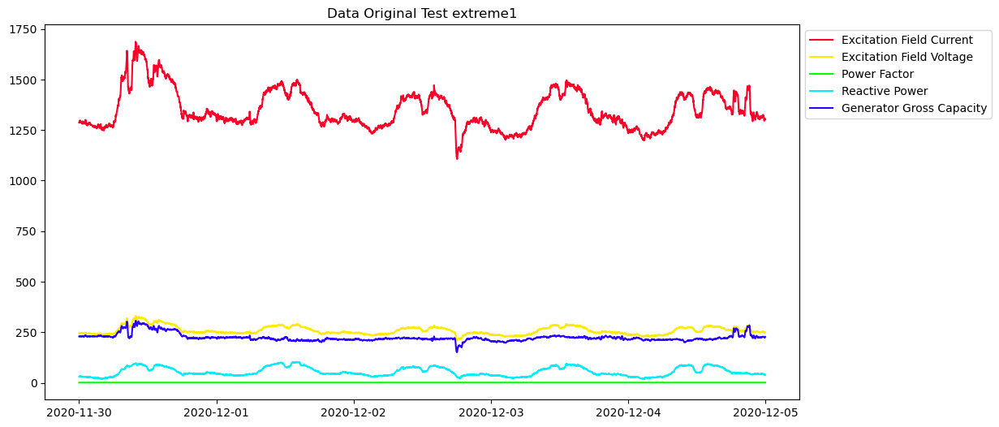


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 1
| > Sensor Start Time:  2023-05-19 08:16:19.746282 



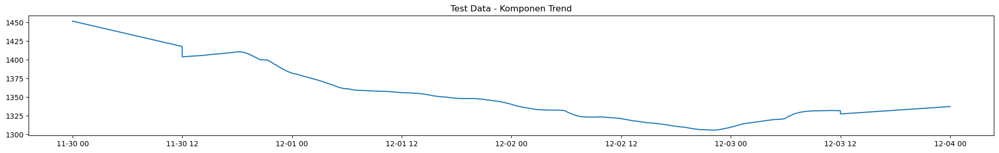

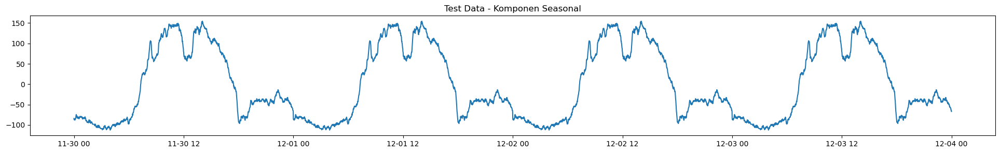

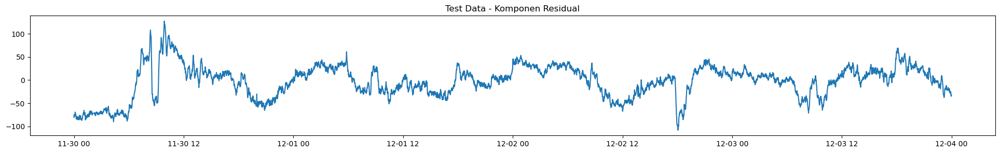

180/180 [==============================] - 1s 1ms/step


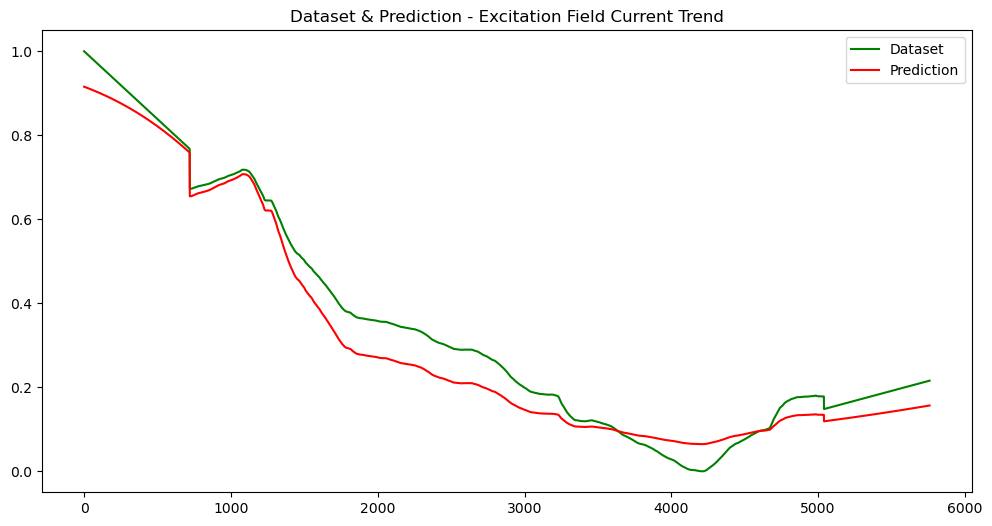

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 1ms/step


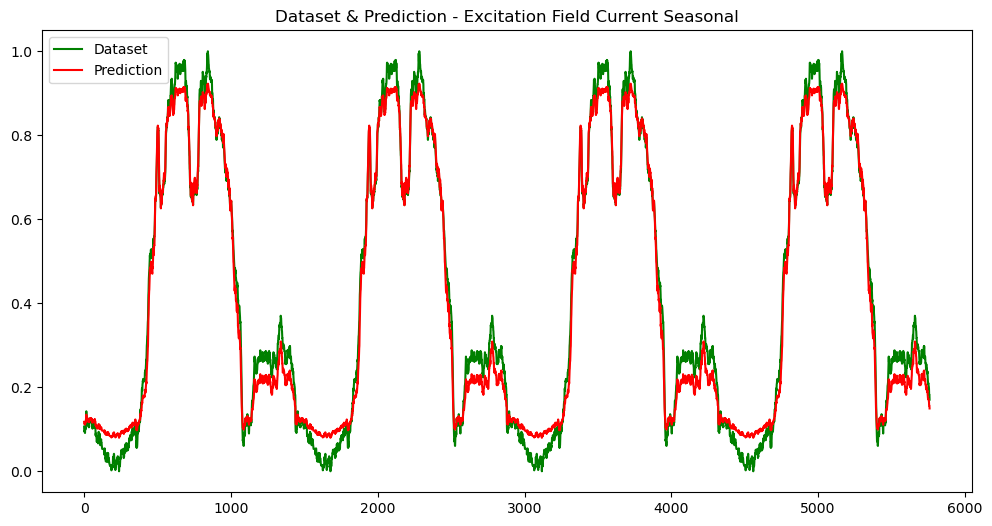

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


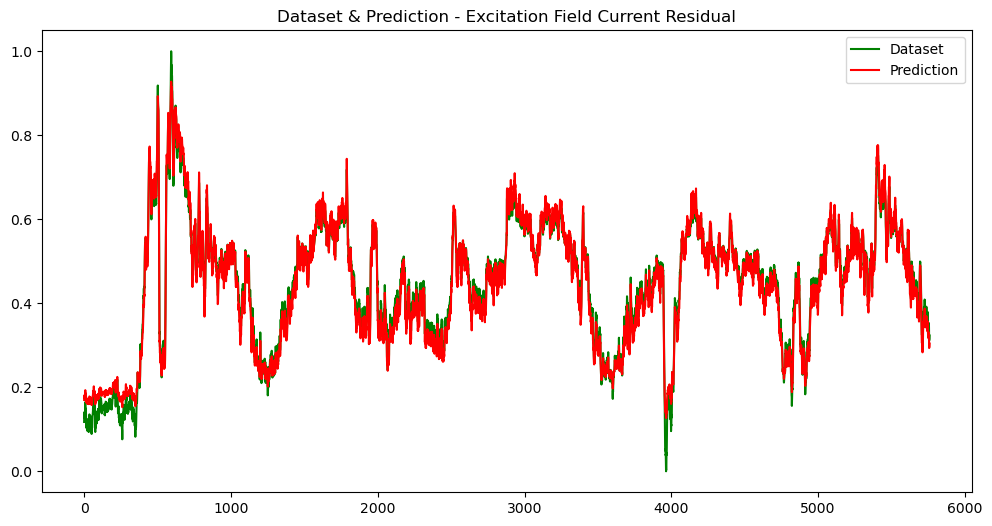

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


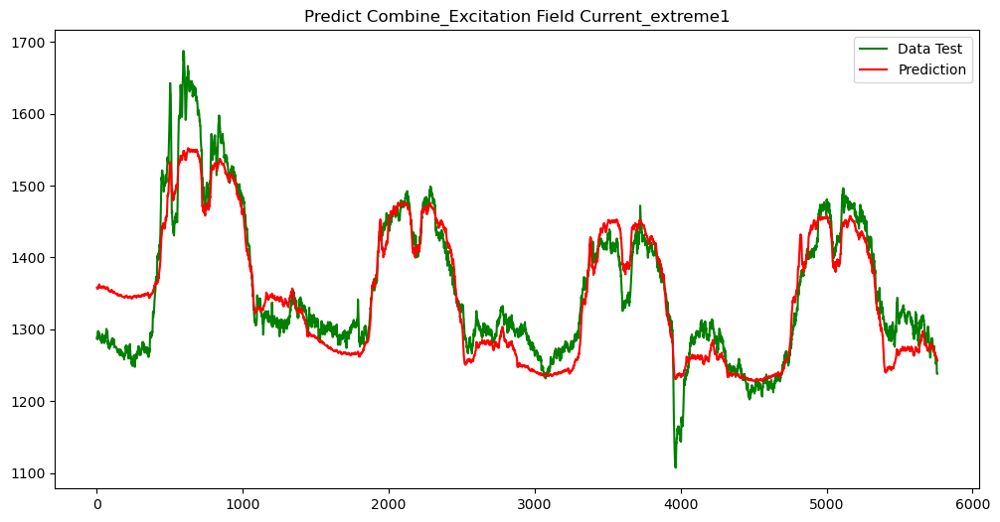

plot/Predict Combine_Excitation Field Current_extreme1.jpg
| > errorsDF:  [71.18759159 67.41415397 67.84058334 ... 18.77649685 18.52561196
 17.74942773]
| > RSME:  36.16287398048079
| > MSE:  1307.7534545281346
| > MAE:  28.38447505559817
Threshold:  15.29358965233613


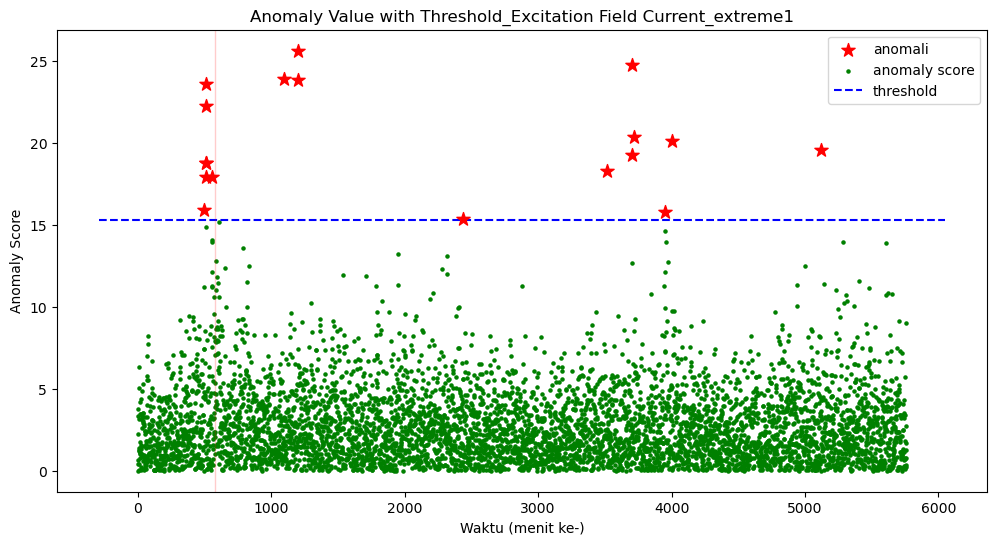

plot/Anomaly Value with Threshold_Excitation Field Current_extreme1.jpg


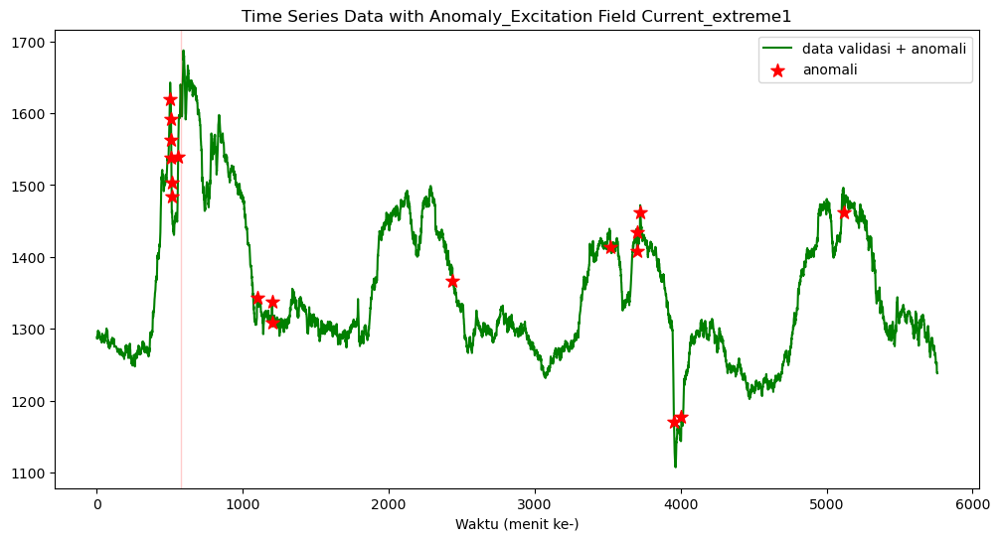

plot/Time Series Data with Anomaly_Excitation Field Current_extreme1.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  1
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:16:26.863802
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Excitation Field Voltage _ extreme 1
| > Sensor Start Time:  2023-05-19 08:16:26.863802 



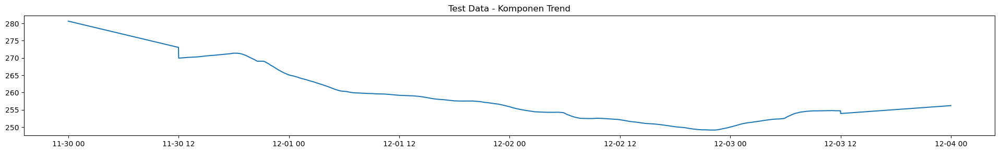

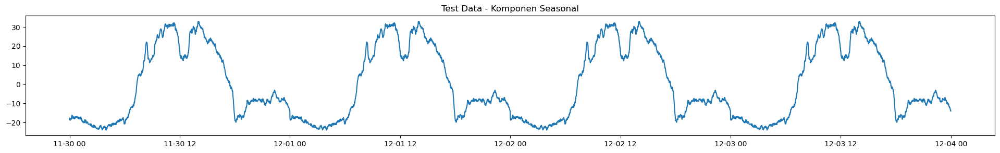

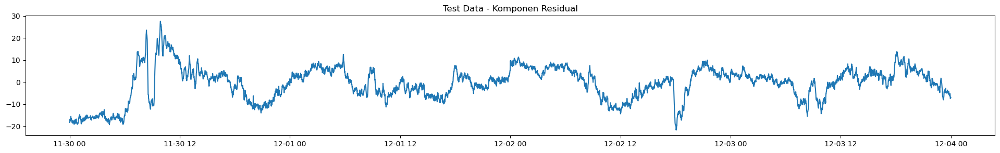

180/180 [==============================] - 1s 983us/step


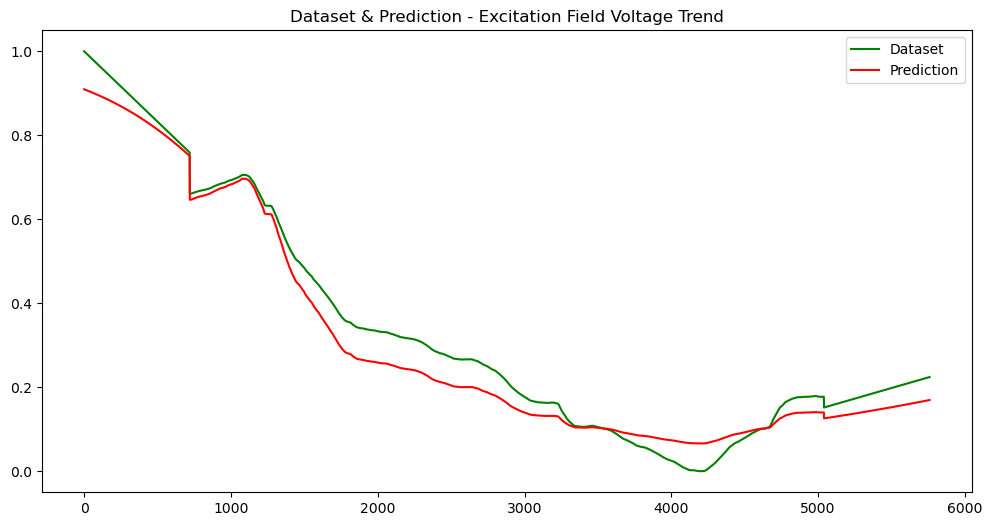

plot/Dataset & Prediction_Excitation Field Voltage_Trend.jpg
180/180 [==============================] - 1s 939us/step


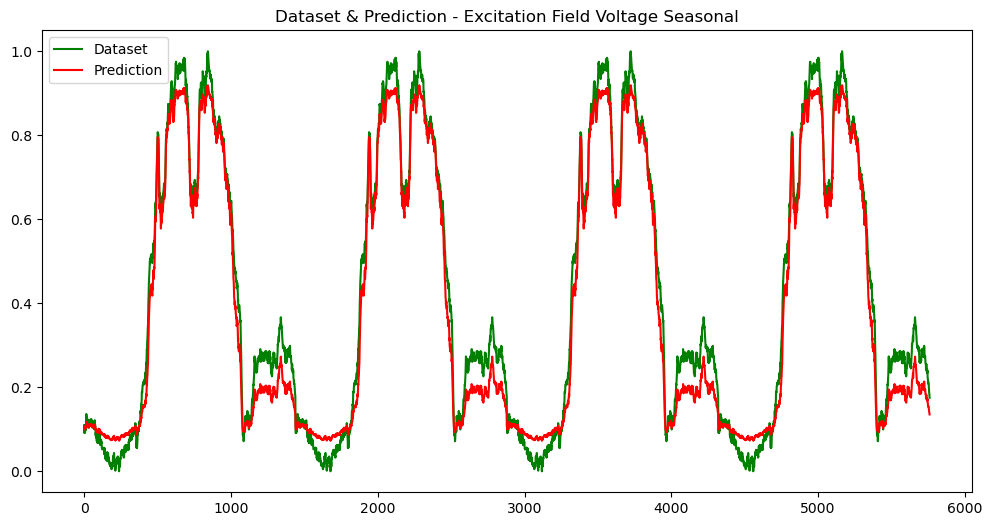

plot/Dataset & Prediction_Excitation Field Voltage_Seasonal.jpg
180/180 [==============================] - 1s 875us/step


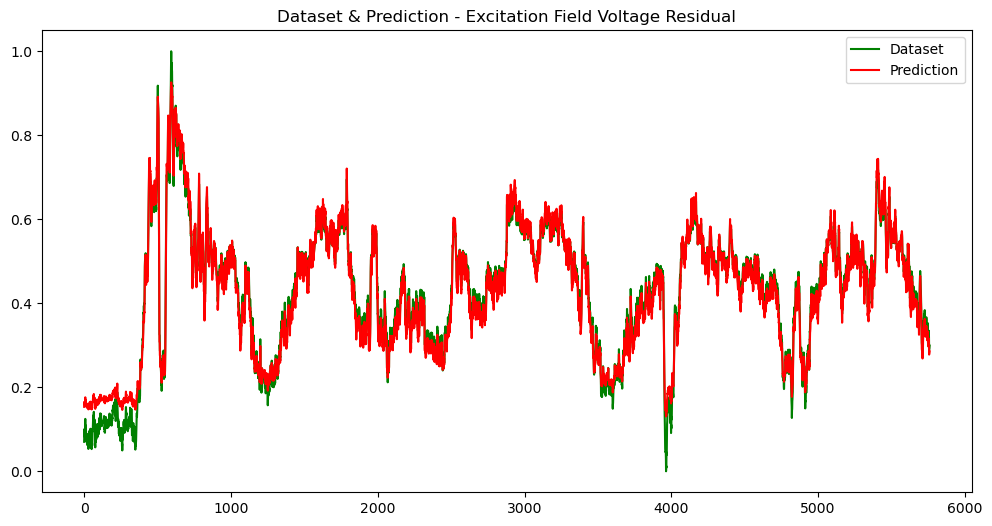

plot/Dataset & Prediction_Excitation Field Voltage_Residual.jpg


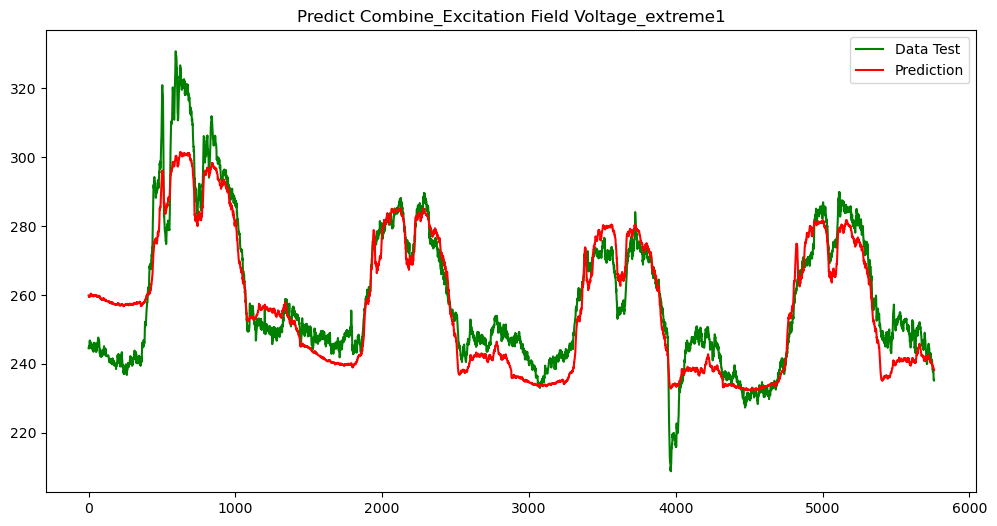

plot/Predict Combine_Excitation Field Voltage_extreme1.jpg
| > errorsDF:  [15.32881742 14.66800689 14.53559499 ...  3.07515714  2.96116452
  3.03472324]
| > RSME:  8.02991060621739
| > MSE:  64.47946434384254
| > MAE:  6.42392602917049
Threshold:  3.0855833813888696


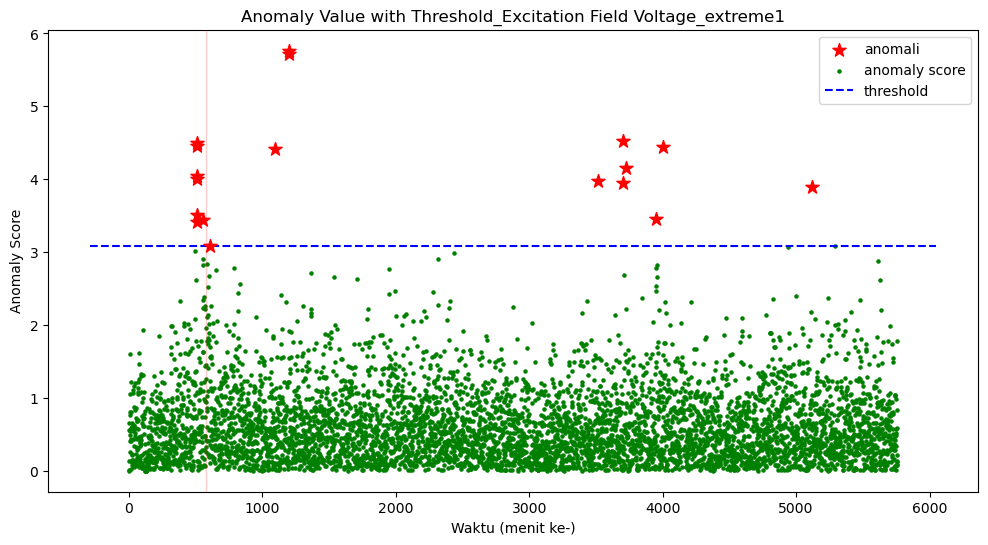

plot/Anomaly Value with Threshold_Excitation Field Voltage_extreme1.jpg


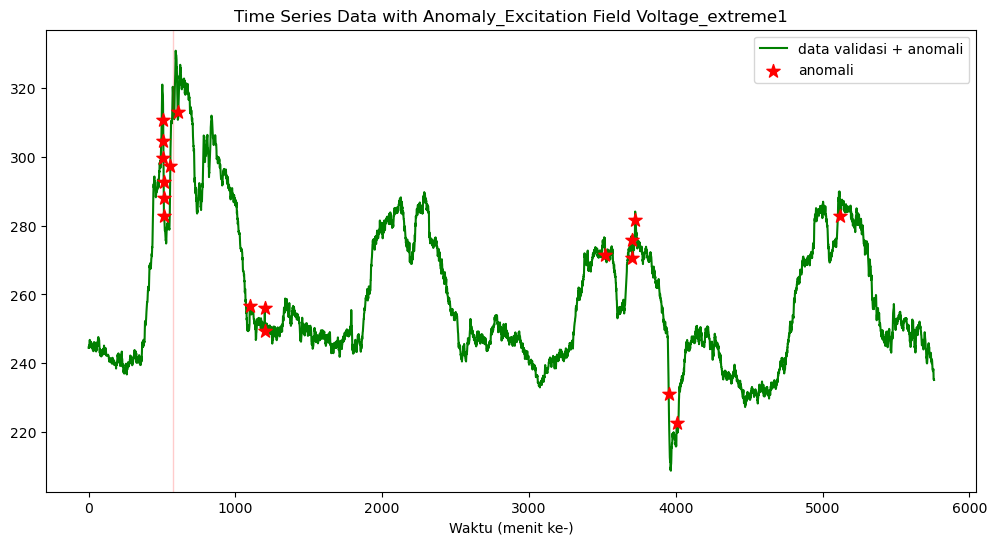

plot/Time Series Data with Anomaly_Excitation Field Voltage_extreme1.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  1
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:16:33.576382
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Power Factor _ extreme 1
| > Sensor Start Time:  2023-05-19 08:16:33.576382 



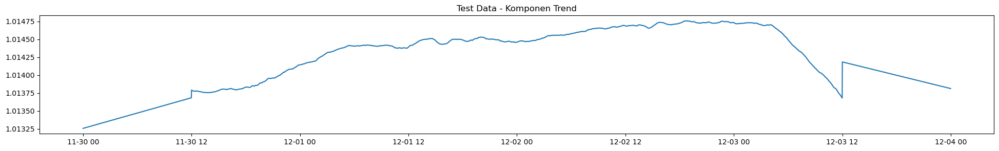

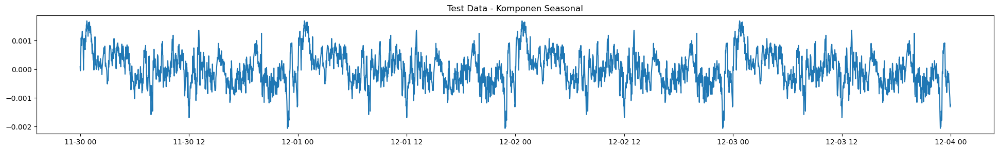

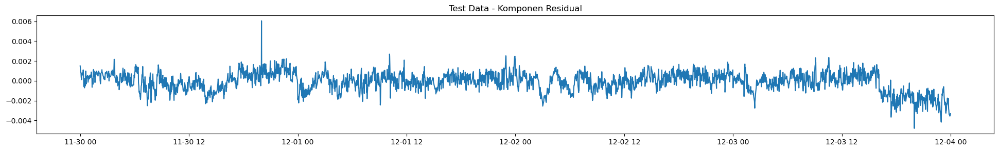

180/180 [==============================] - 1s 1ms/step


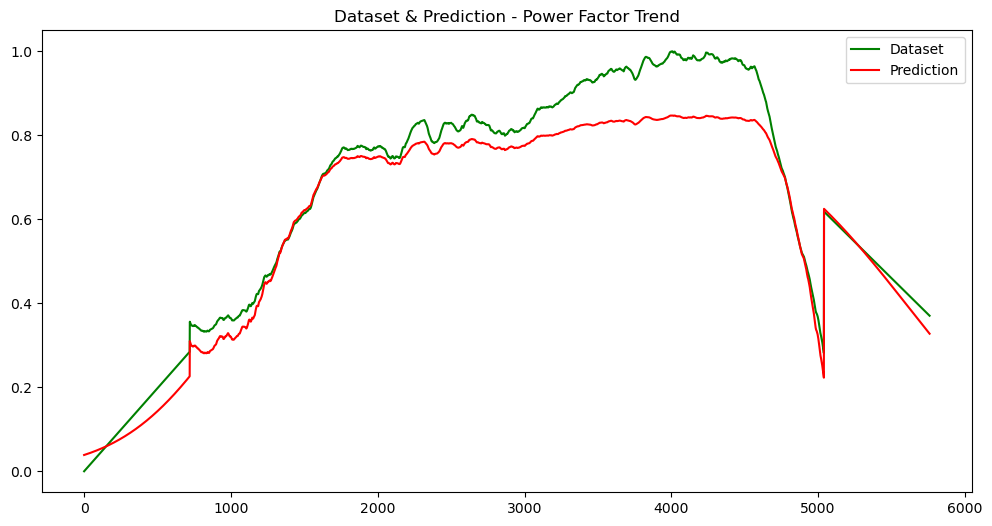

plot/Dataset & Prediction_Power Factor_Trend.jpg
180/180 [==============================] - 1s 1ms/step


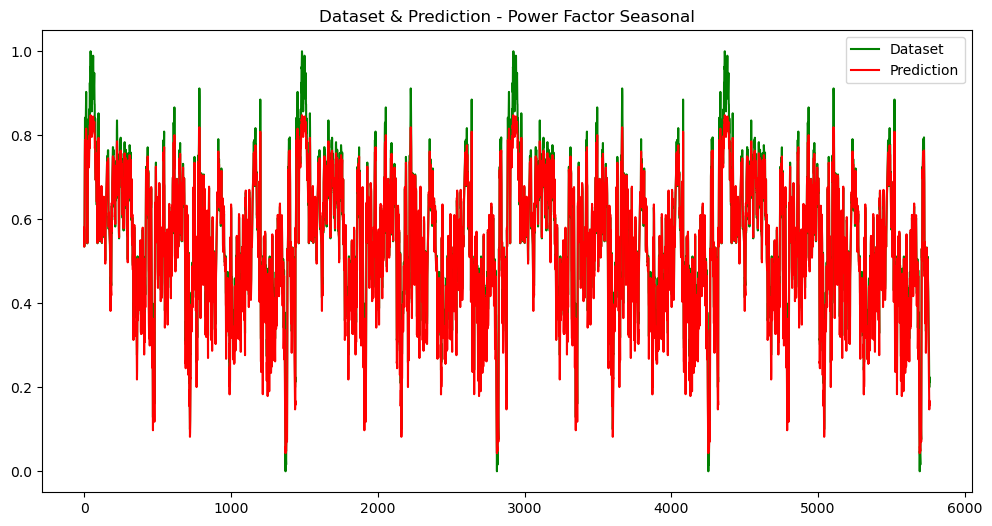

plot/Dataset & Prediction_Power Factor_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


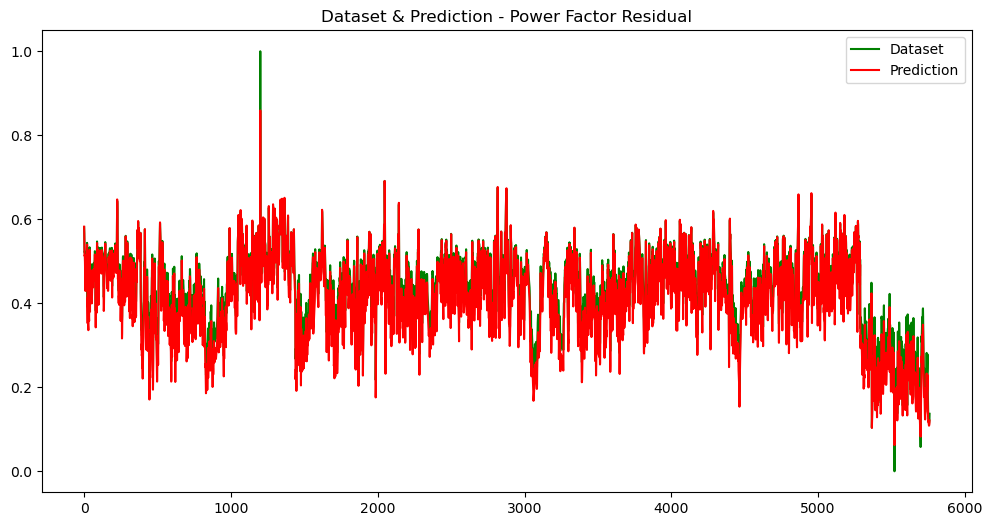

plot/Dataset & Prediction_Power Factor_Residual.jpg


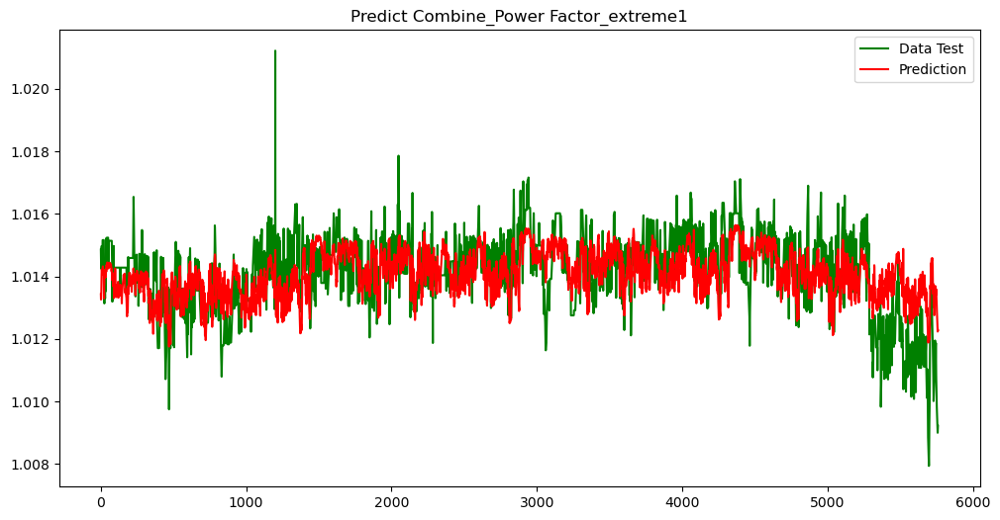

plot/Predict Combine_Power Factor_extreme1.jpg
| > errorsDF:  [0.00142389 0.00128826 0.00094597 ... 0.0032354  0.00320046 0.00304812]
| > RSME:  0.0009466471400414553
| > MSE:  8.961408077486667e-07
| > MAE:  0.0007408923734926098
Threshold:  0.001459189027808356


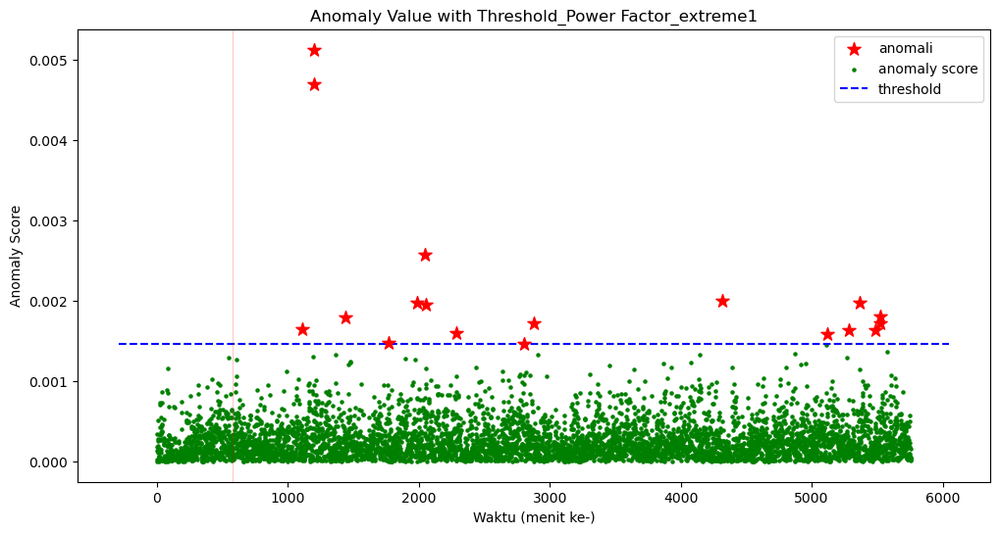

plot/Anomaly Value with Threshold_Power Factor_extreme1.jpg


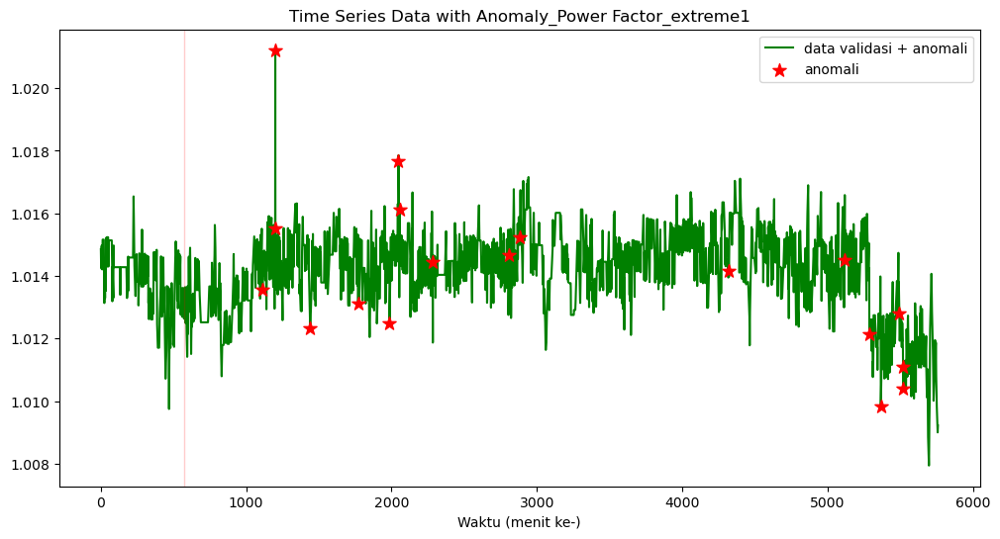

plot/Time Series Data with Anomaly_Power Factor_extreme1.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  1
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:16:42.214382
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Reactive Power _ extreme 1
| > Sensor Start Time:  2023-05-19 08:16:42.214382 



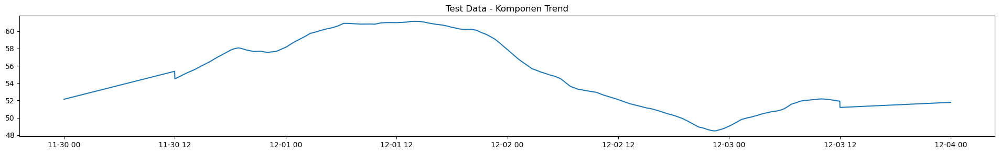

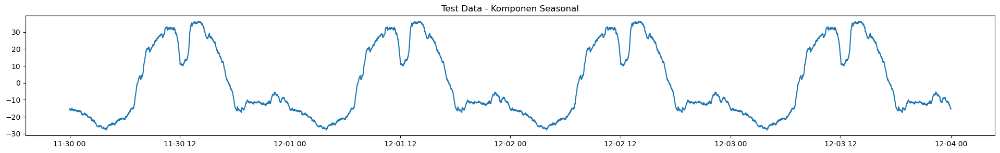

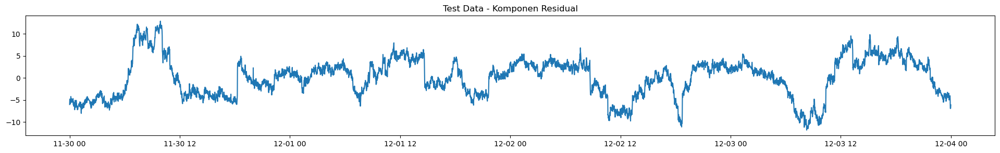

180/180 [==============================] - 1s 1ms/step


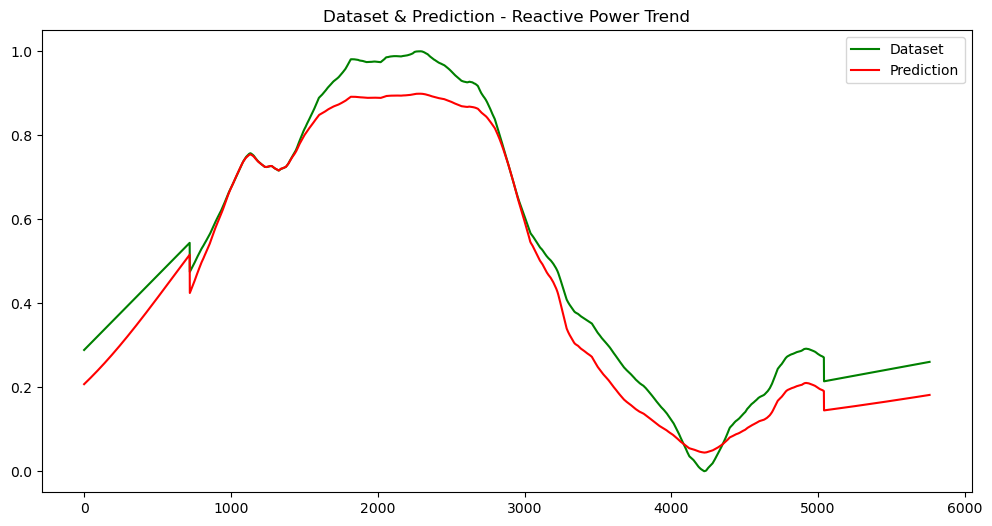

plot/Dataset & Prediction_Reactive Power_Trend.jpg
180/180 [==============================] - 1s 1ms/step


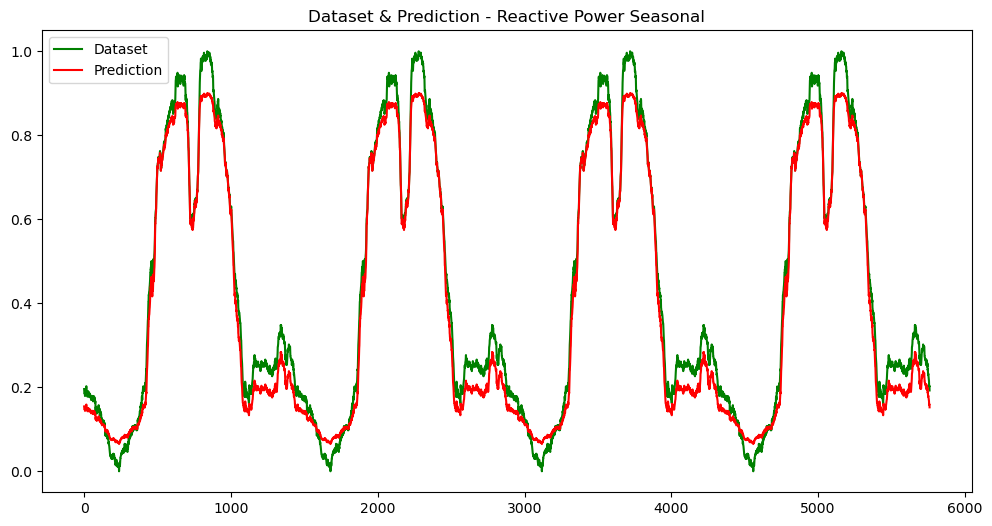

plot/Dataset & Prediction_Reactive Power_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


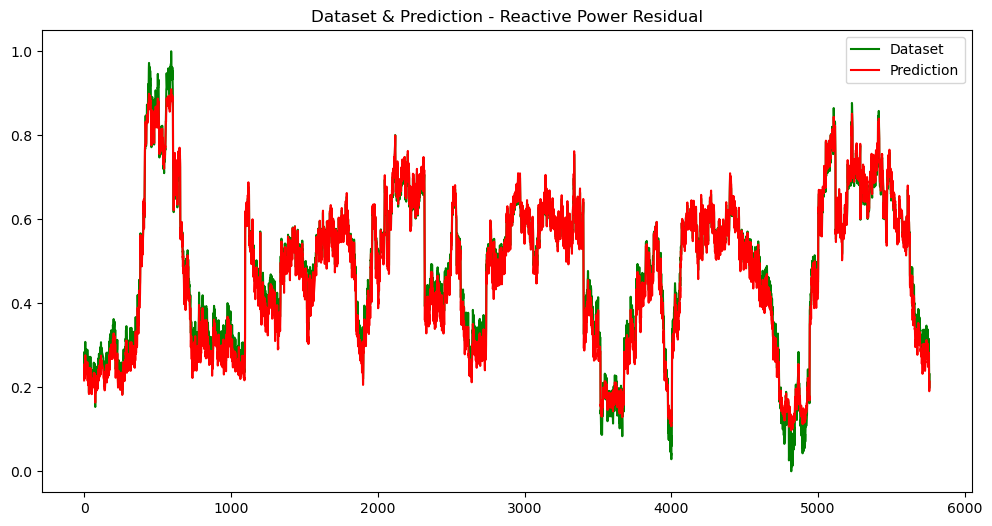

plot/Dataset & Prediction_Reactive Power_Residual.jpg


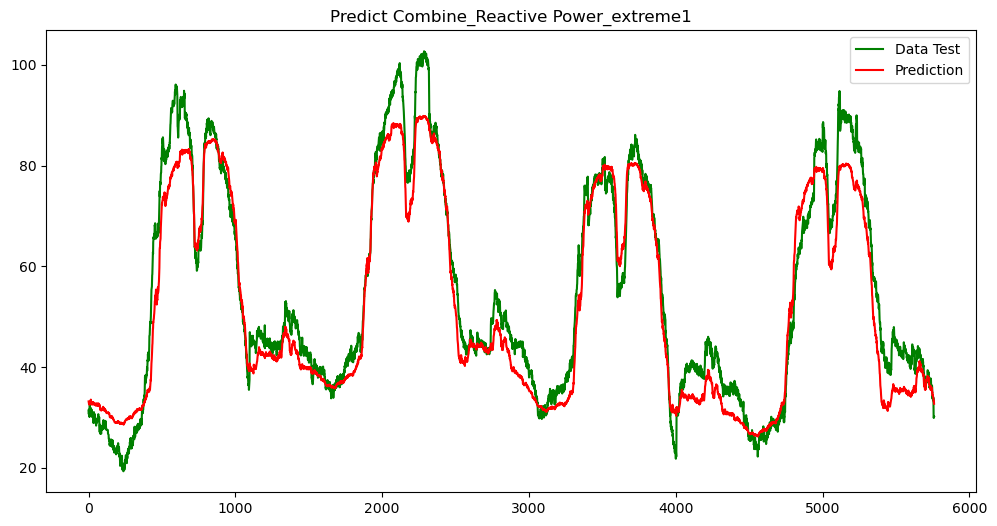

plot/Predict Combine_Reactive Power_extreme1.jpg
| > errorsDF:  [2.35508537 1.30829811 1.50245476 ... 3.19444656 3.06912994 2.55700493]
| > RSME:  5.499865273320545
| > MSE:  30.248518024677267
| > MAE:  4.45586237088926
Threshold:  2.695754372823905


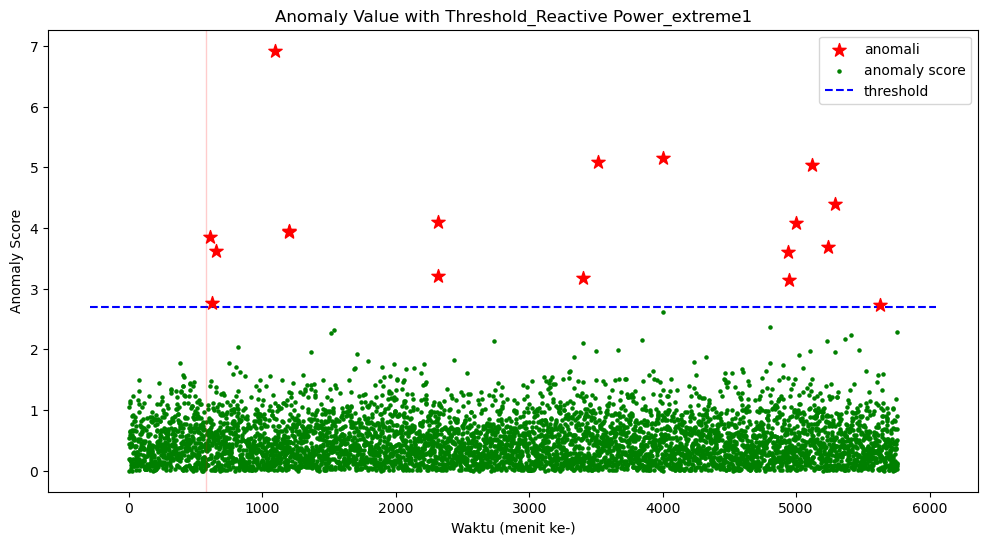

plot/Anomaly Value with Threshold_Reactive Power_extreme1.jpg


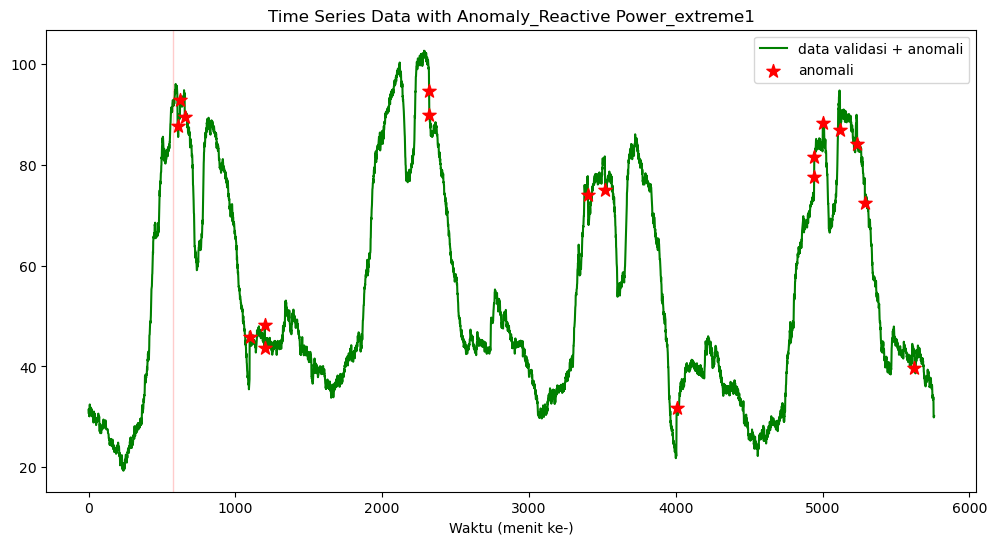

plot/Time Series Data with Anomaly_Reactive Power_extreme1.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  1
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:16:49.918016
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Generator Gross Capacity _ extreme 1
| > Sensor Start Time:  2023-05-19 08:16:49.918016 



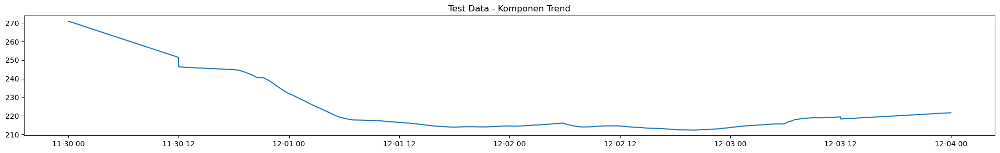

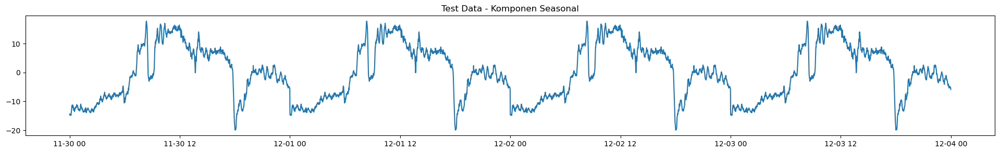

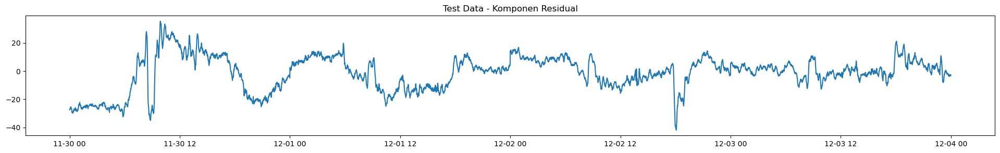

180/180 [==============================] - 1s 1ms/step


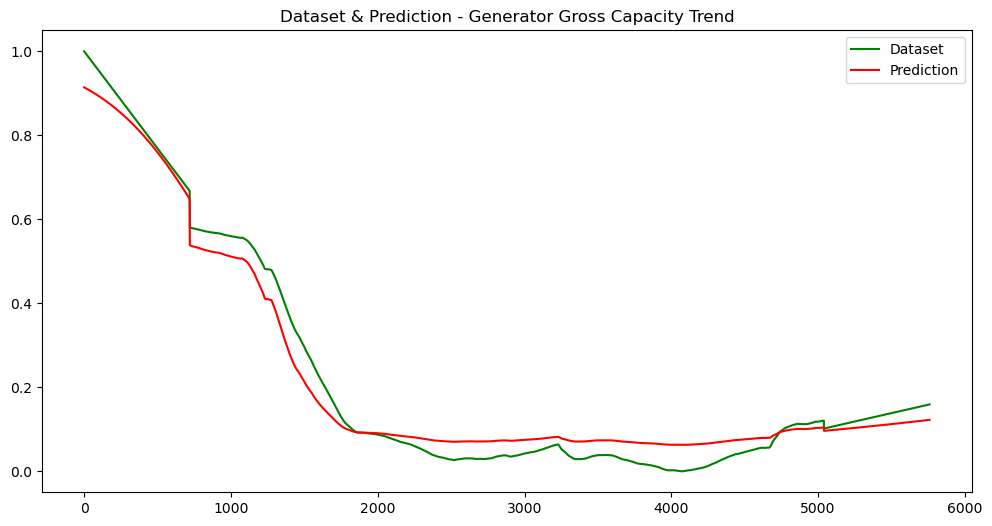

plot/Dataset & Prediction_Generator Gross Capacity_Trend.jpg
180/180 [==============================] - 1s 1ms/step


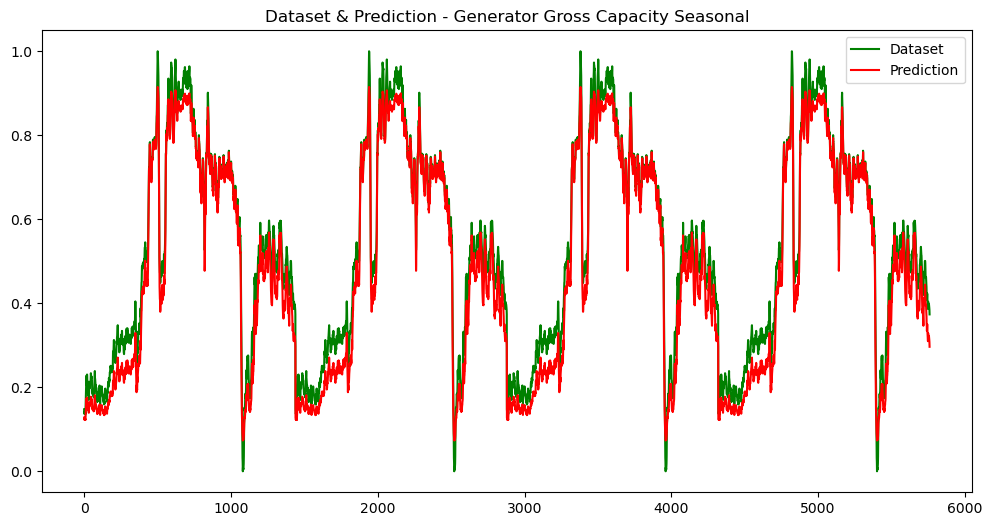

plot/Dataset & Prediction_Generator Gross Capacity_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


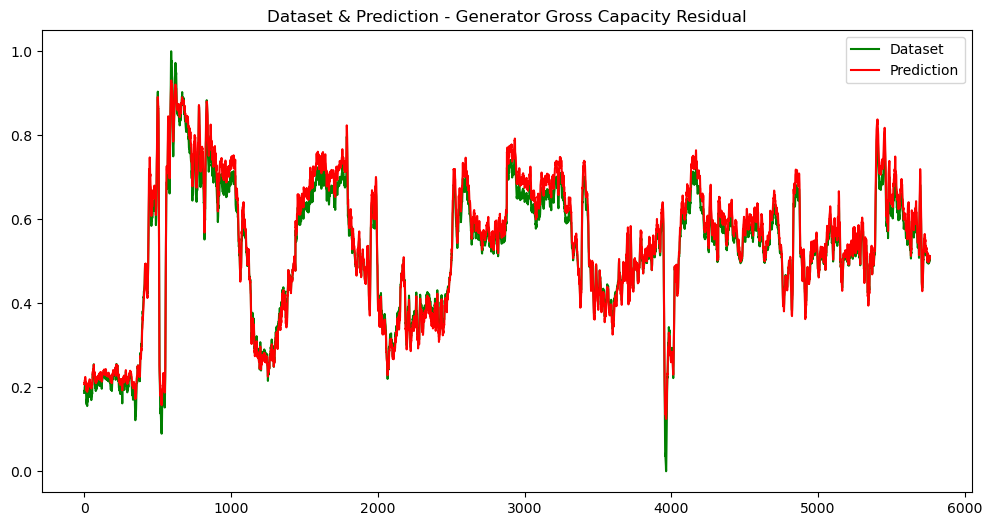

plot/Dataset & Prediction_Generator Gross Capacity_Residual.jpg


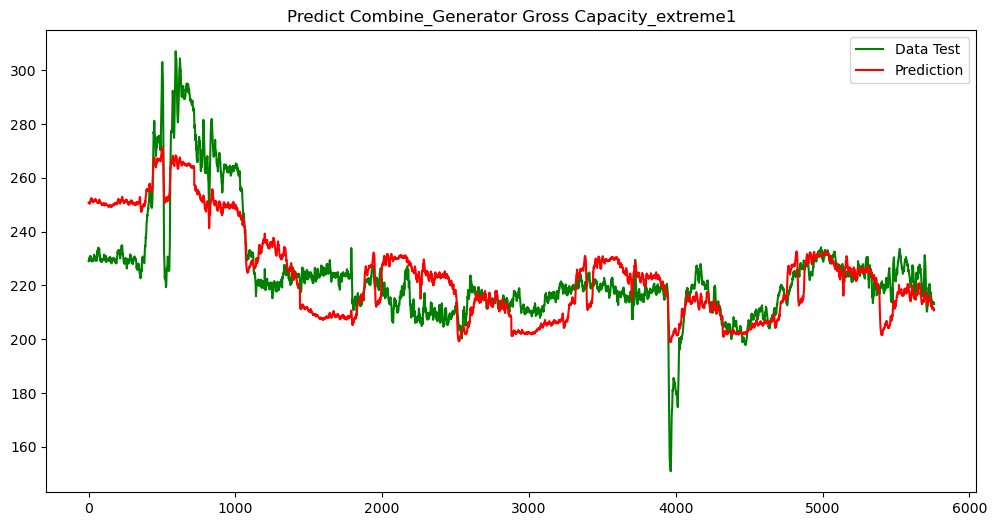

plot/Predict Combine_Generator Gross Capacity_extreme1.jpg
| > errorsDF:  [21.70281696 21.48343377 21.54294494 ...  2.35870643  1.84537886
  2.33483694]
| > RSME:  12.145019769344081
| > MSE:  147.50150519775858
| > MAE:  9.681933281589044
Threshold:  4.80782191286028


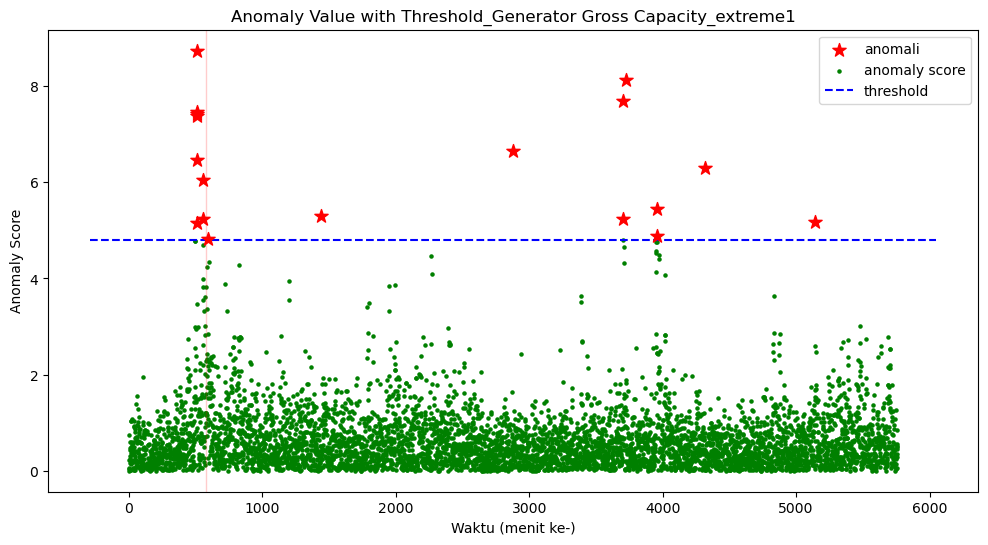

plot/Anomaly Value with Threshold_Generator Gross Capacity_extreme1.jpg


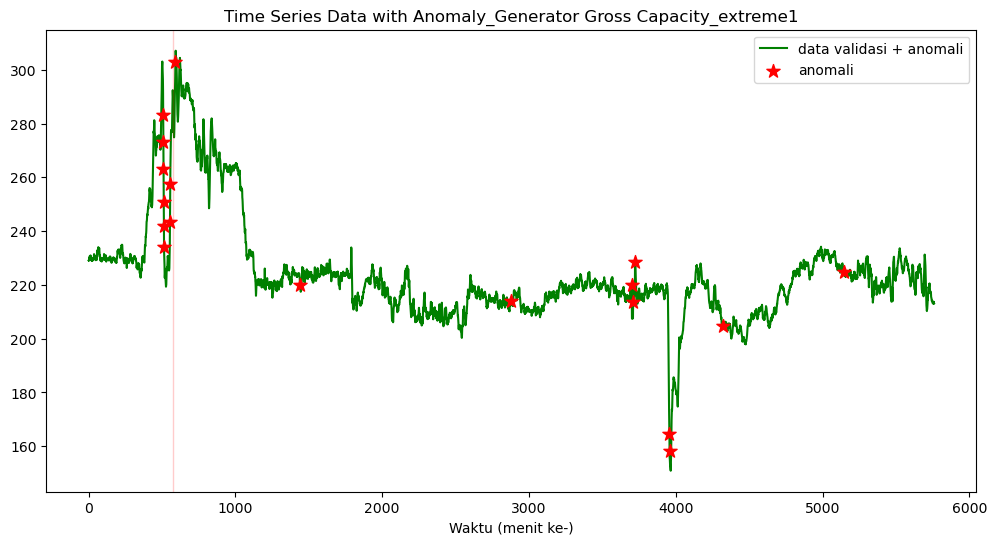

plot/Time Series Data with Anomaly_Generator Gross Capacity_extreme1.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  1
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:16:57.547291
| ========================================================================================== |



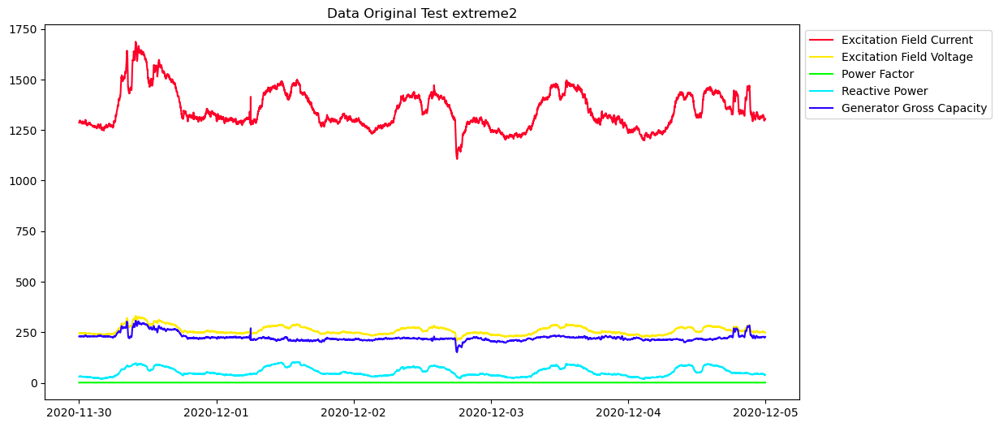


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 2
| > Sensor Start Time:  2023-05-19 08:17:00.076293 



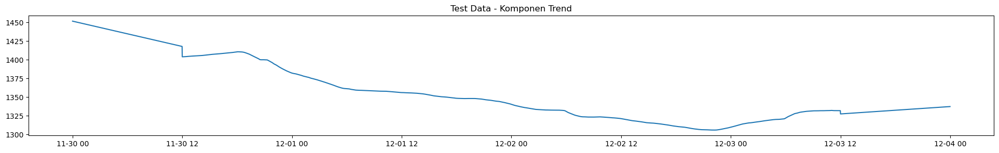

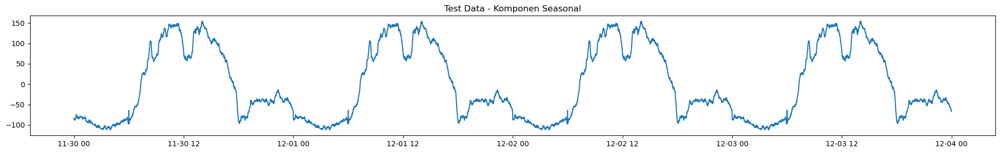

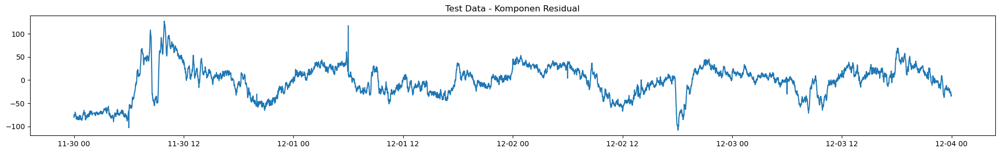

180/180 [==============================] - 1s 1ms/step


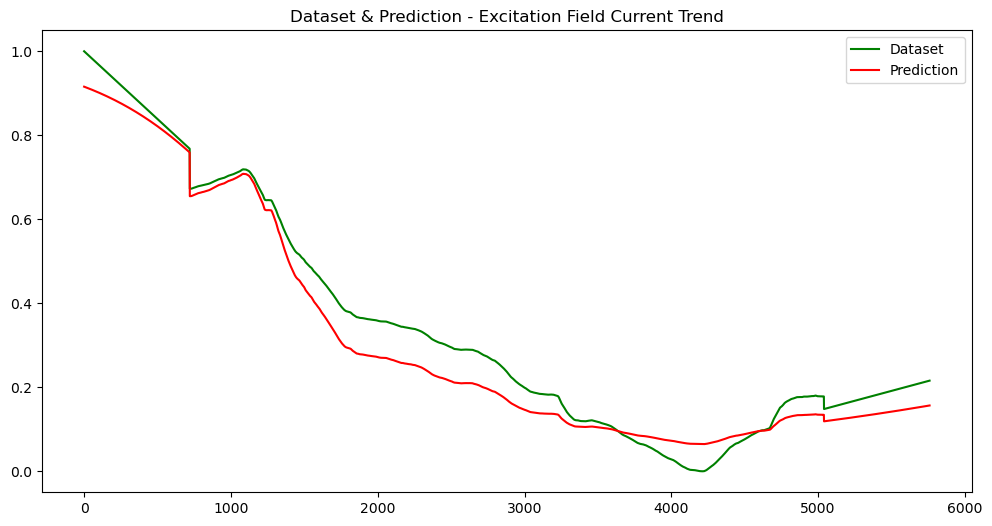

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 1ms/step


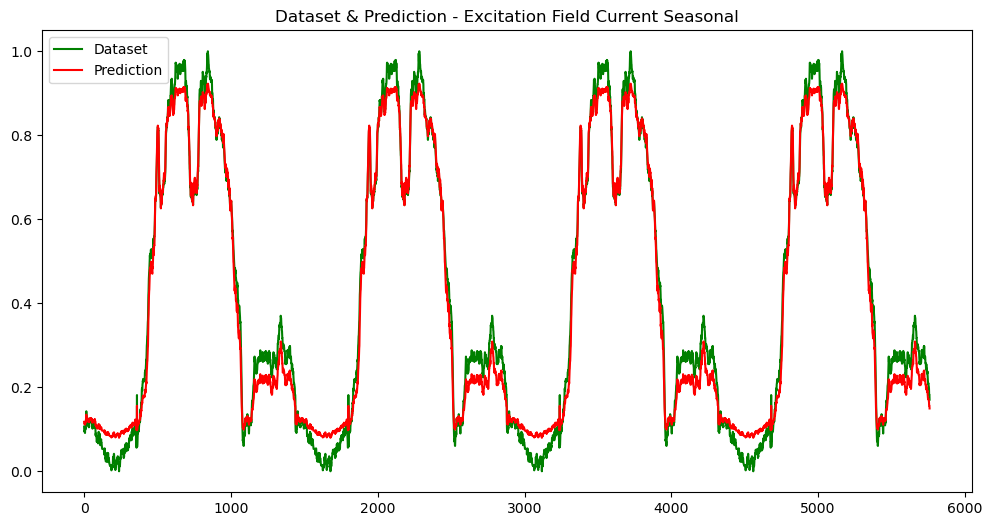

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


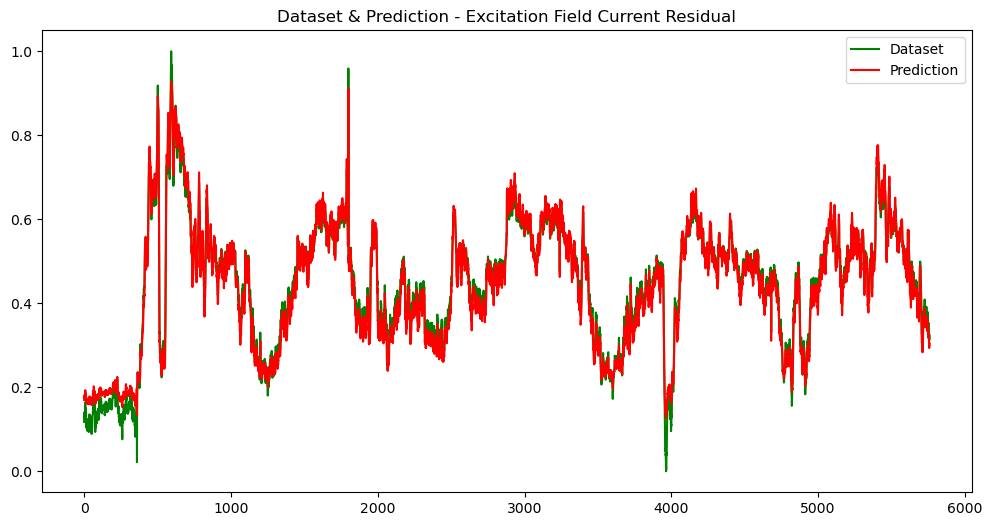

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


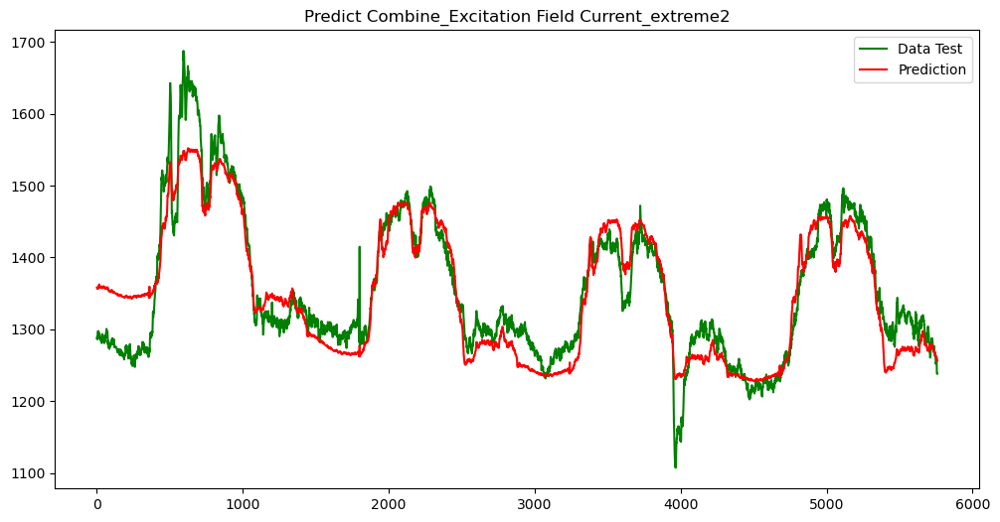

plot/Predict Combine_Excitation Field Current_extreme2.jpg
| > errorsDF:  [71.13745884 67.36405174 67.79032852 ... 18.7531509  18.5023652
 17.72602838]
| > RSME:  36.209647498795334
| > MSE:  1311.1385719870152
| > MAE:  28.406266002677402
Threshold:  17.799251544646815


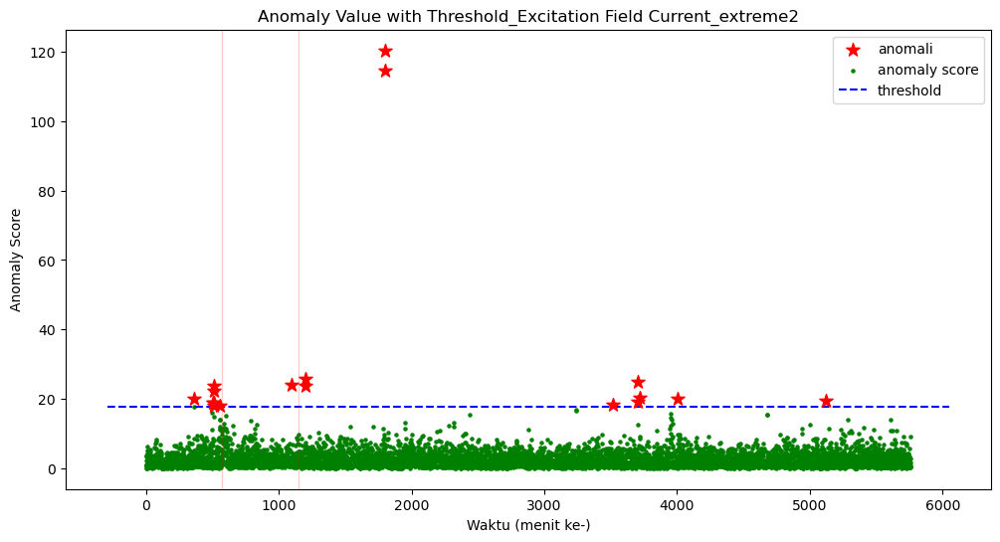

plot/Anomaly Value with Threshold_Excitation Field Current_extreme2.jpg


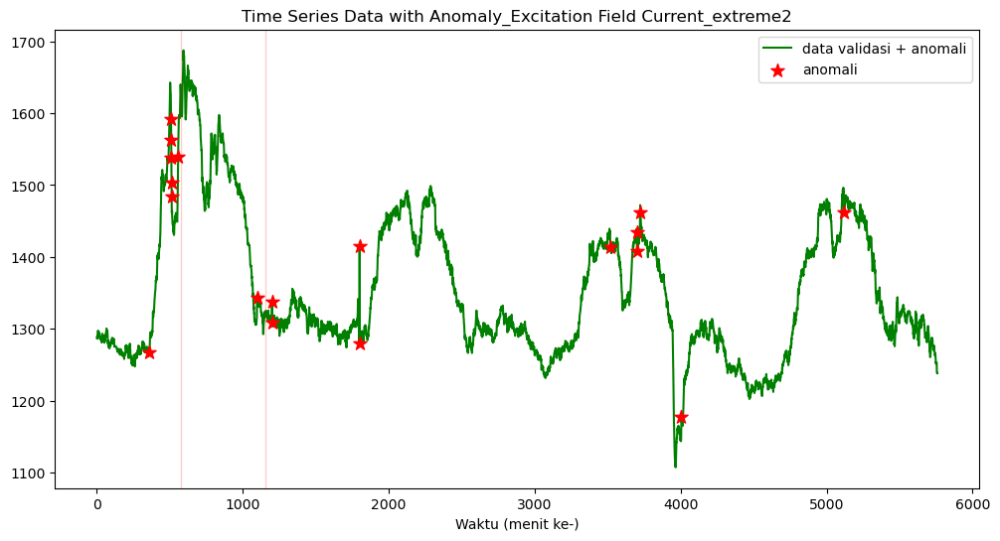

plot/Time Series Data with Anomaly_Excitation Field Current_extreme2.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  2
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:17:07.570435
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Excitation Field Voltage _ extreme 2
| > Sensor Start Time:  2023-05-19 08:17:07.570435 



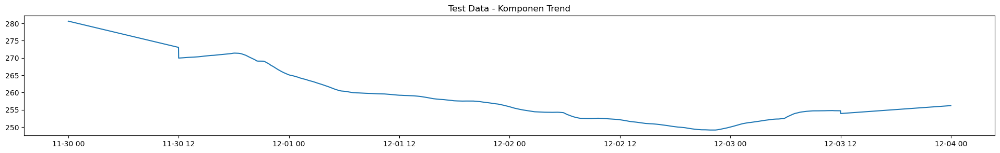

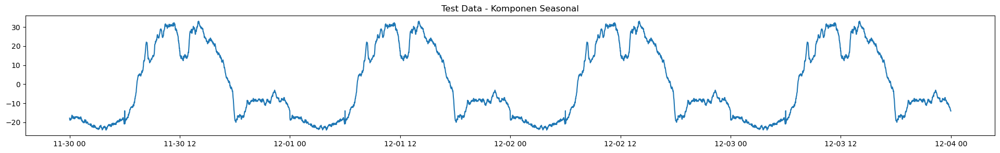

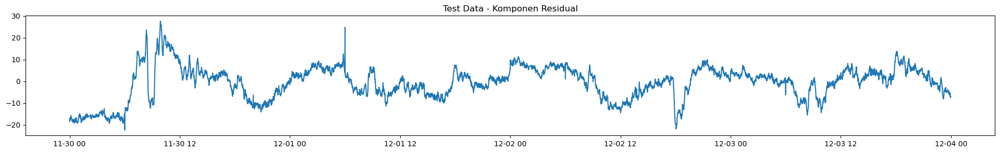

180/180 [==============================] - 1s 1ms/step


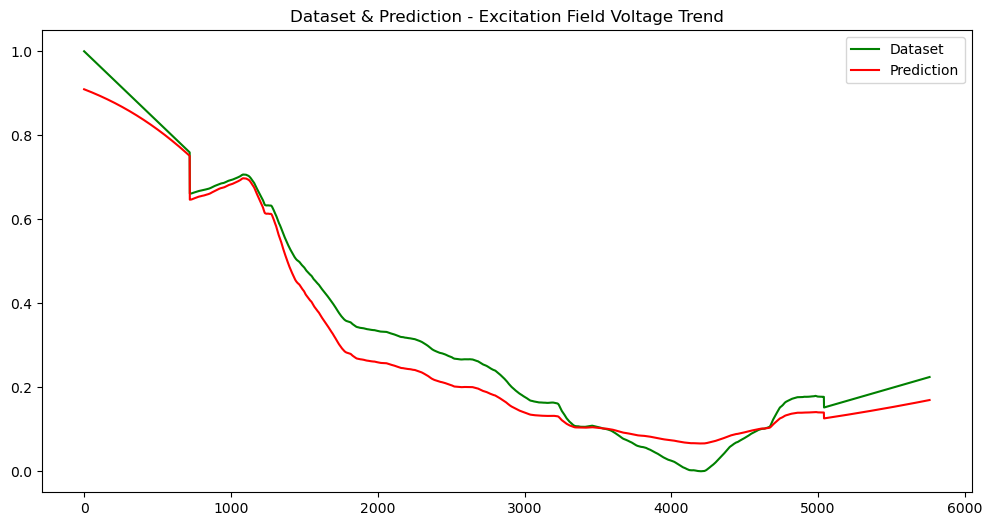

plot/Dataset & Prediction_Excitation Field Voltage_Trend.jpg
180/180 [==============================] - 1s 1ms/step


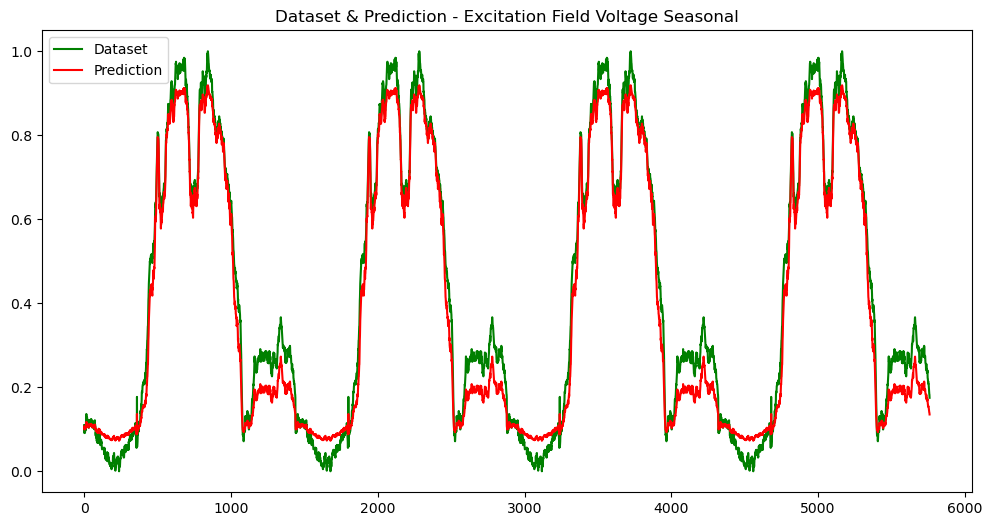

plot/Dataset & Prediction_Excitation Field Voltage_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


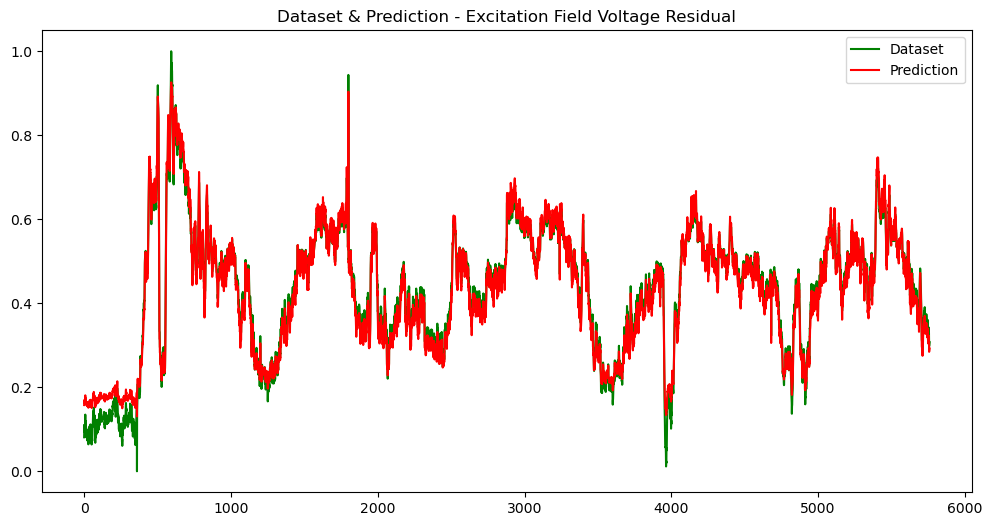

plot/Dataset & Prediction_Excitation Field Voltage_Residual.jpg


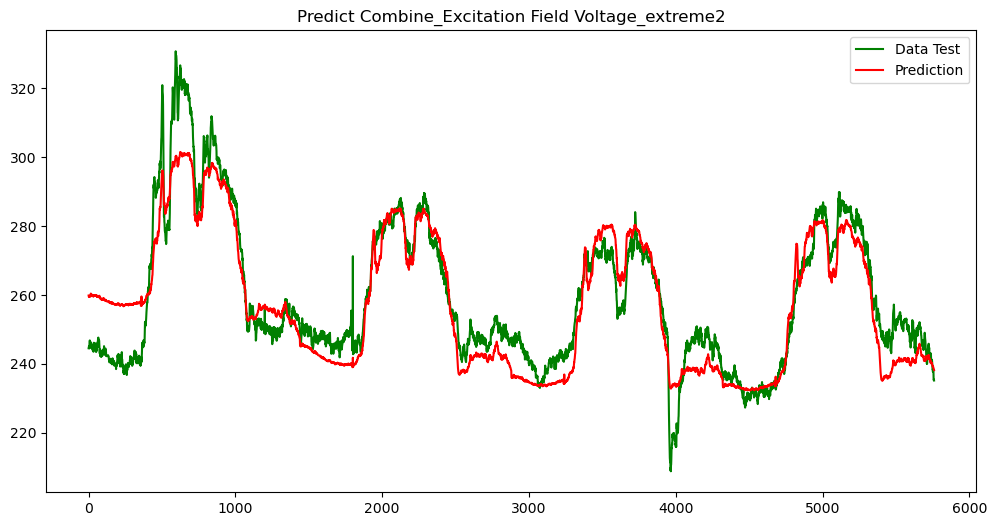

plot/Predict Combine_Excitation Field Voltage_extreme2.jpg
| > errorsDF:  [15.31836896 14.65753555 14.52514463 ...  3.07039449  2.95638852
  3.02995868]
| > RSME:  8.03945699805872
| > MSE:  64.6328688236353
| > MAE:  6.428352869467052
Threshold:  3.4450262856592464


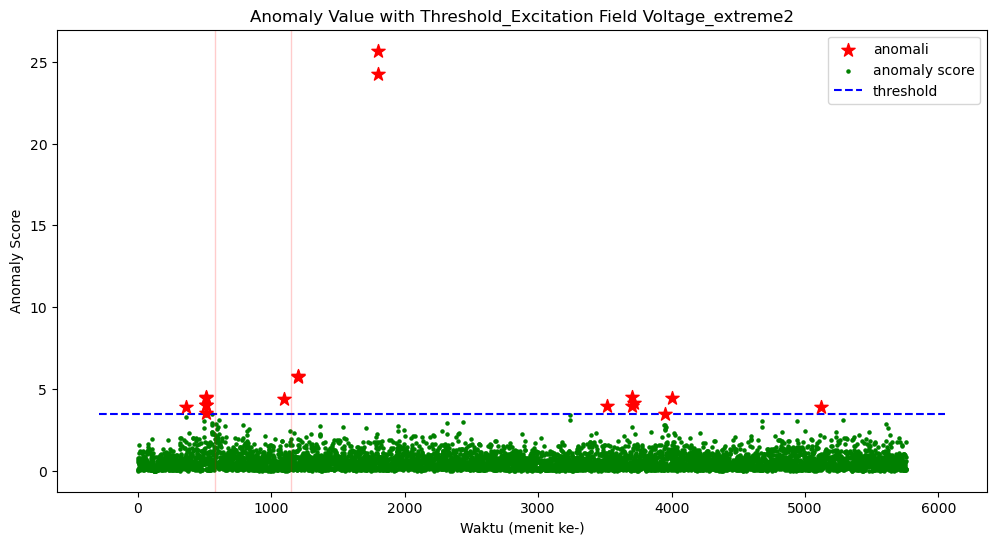

plot/Anomaly Value with Threshold_Excitation Field Voltage_extreme2.jpg


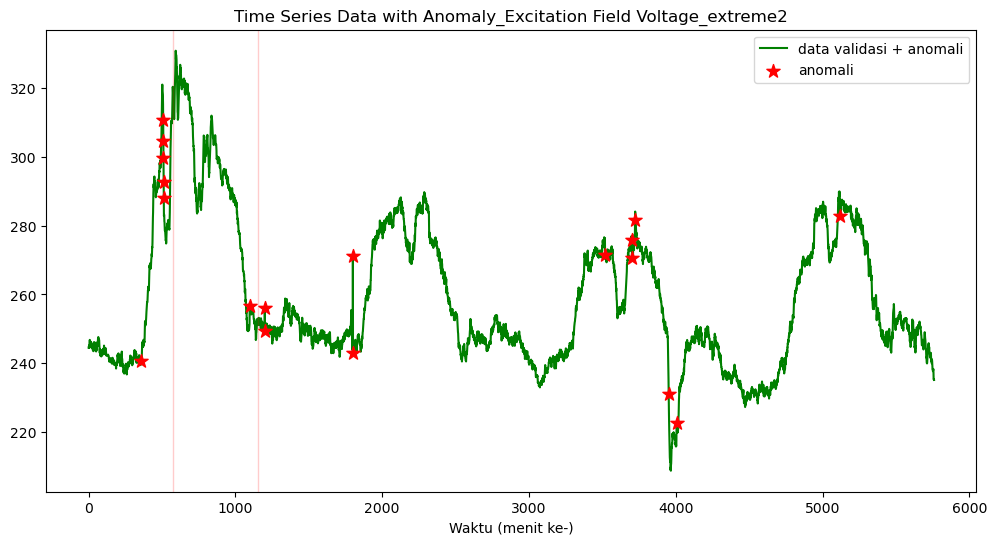

plot/Time Series Data with Anomaly_Excitation Field Voltage_extreme2.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  2
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:17:15.545347
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Power Factor _ extreme 2
| > Sensor Start Time:  2023-05-19 08:17:15.545347 



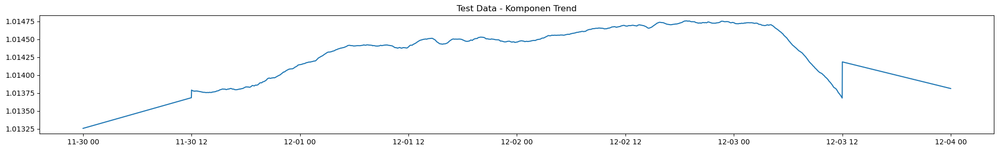

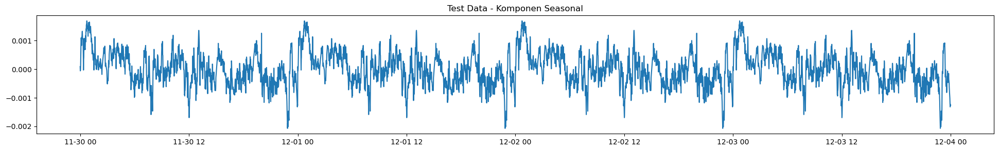

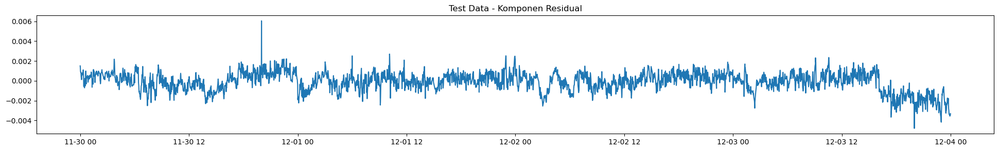

180/180 [==============================] - 1s 1ms/step


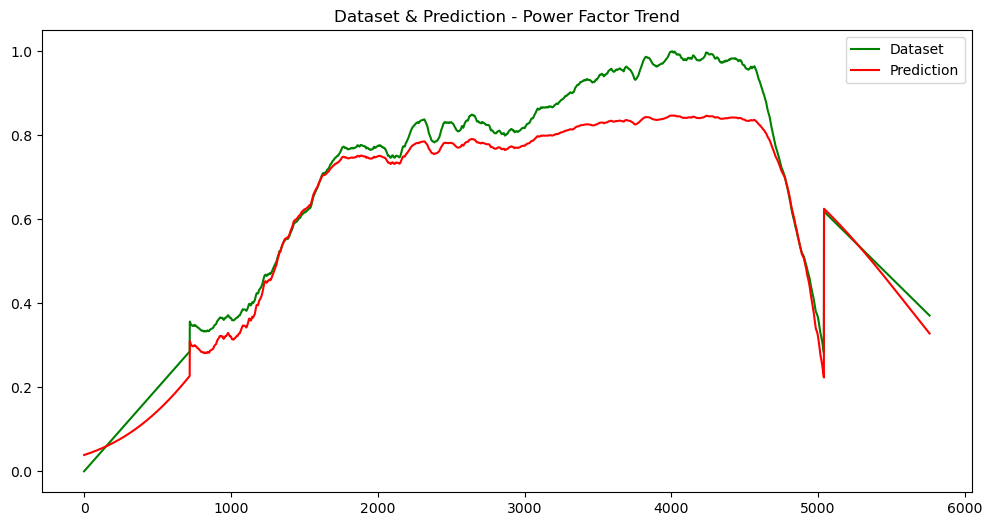

plot/Dataset & Prediction_Power Factor_Trend.jpg
180/180 [==============================] - 1s 1ms/step


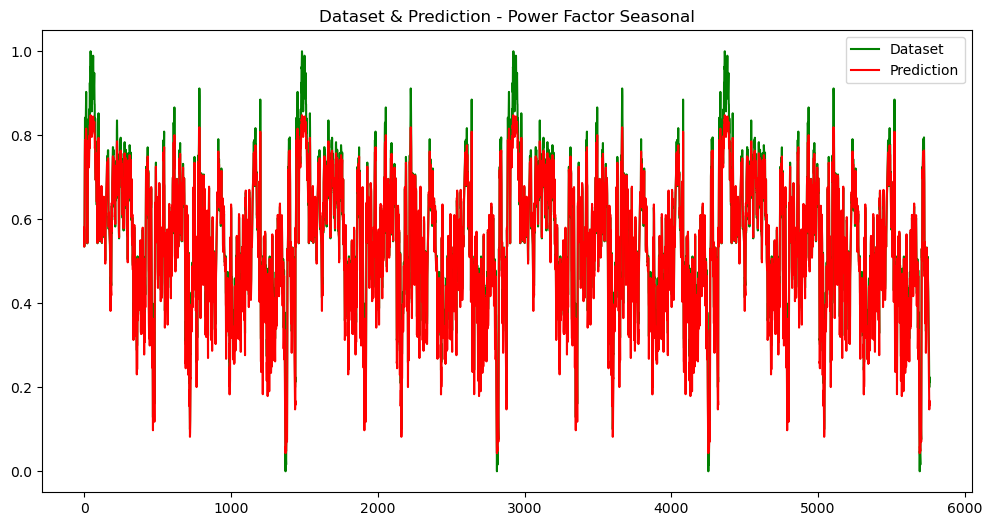

plot/Dataset & Prediction_Power Factor_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


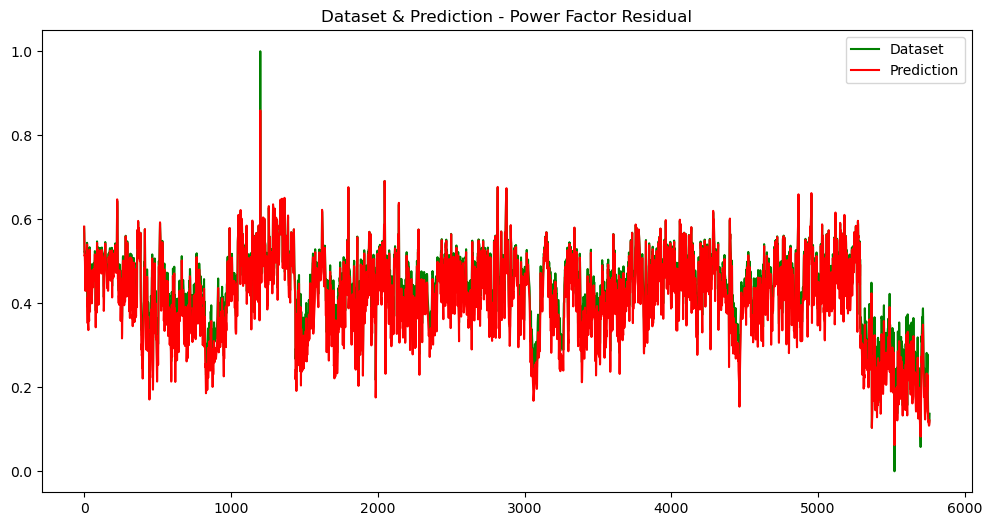

plot/Dataset & Prediction_Power Factor_Residual.jpg


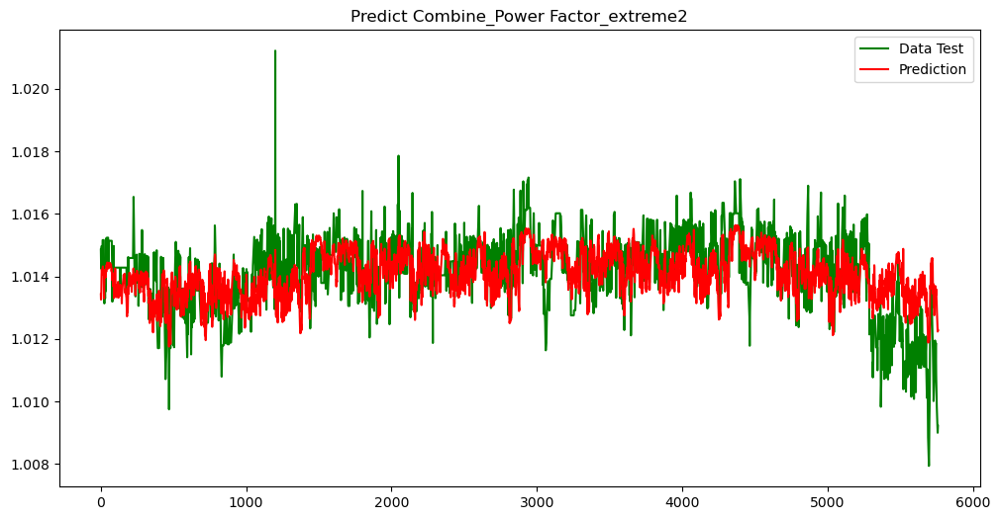

plot/Predict Combine_Power Factor_extreme2.jpg
| > errorsDF:  [0.00142522 0.00128946 0.00094729 ... 0.0032349  0.00319996 0.00304763]
| > RSME:  0.0009473630883456883
| > MSE:  8.974968211598804e-07
| > MAE:  0.0007414788374641262
Threshold:  0.001546267560455631


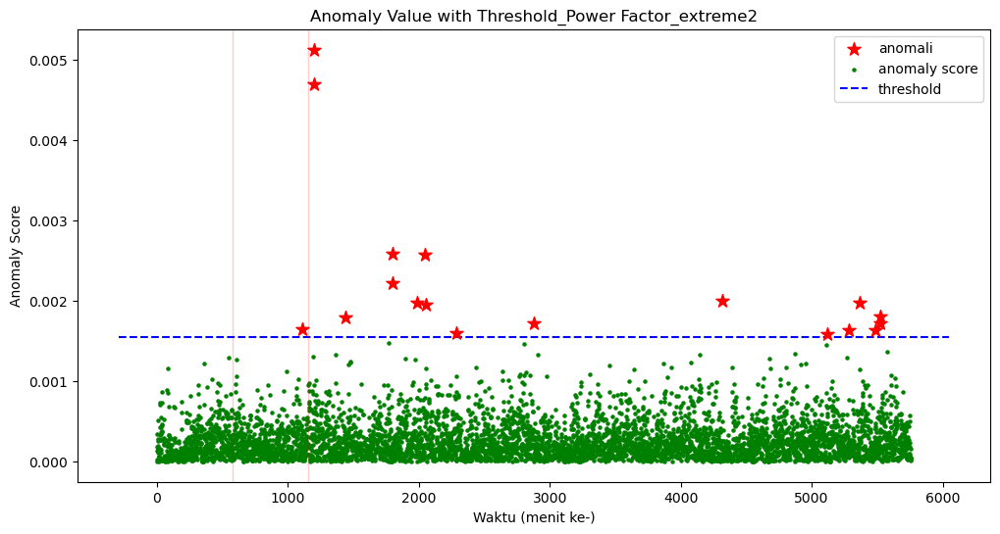

plot/Anomaly Value with Threshold_Power Factor_extreme2.jpg


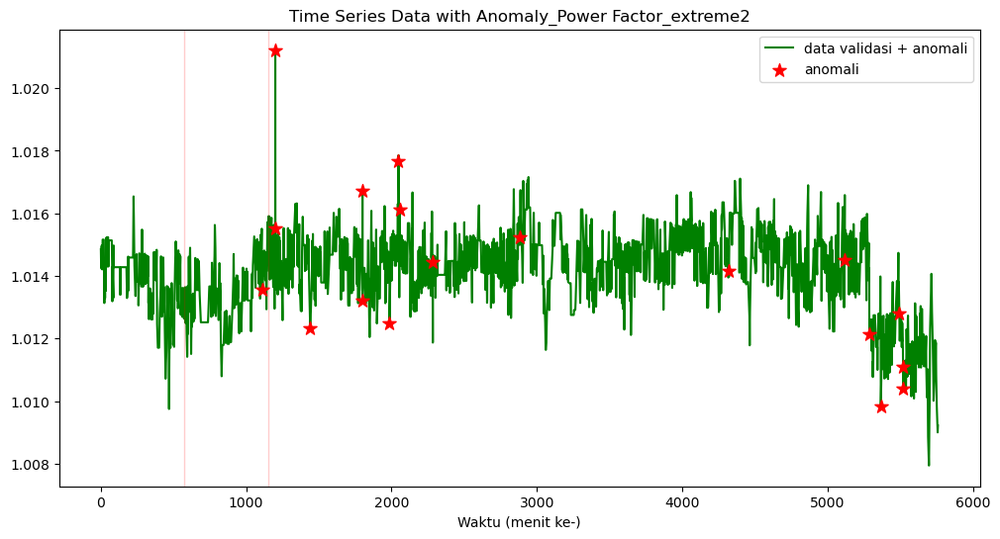

plot/Time Series Data with Anomaly_Power Factor_extreme2.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  2
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:17:23.651660
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Reactive Power _ extreme 2
| > Sensor Start Time:  2023-05-19 08:17:23.651660 



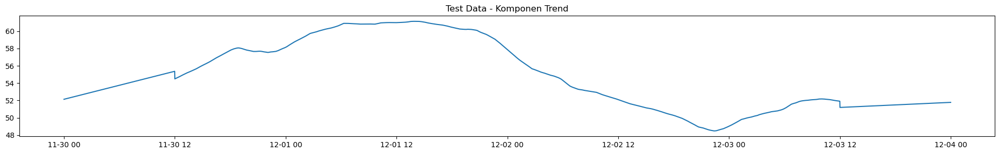

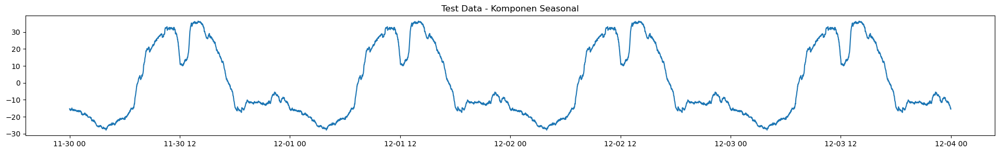

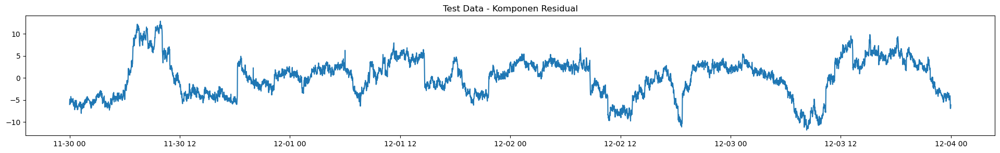

180/180 [==============================] - 1s 1ms/step


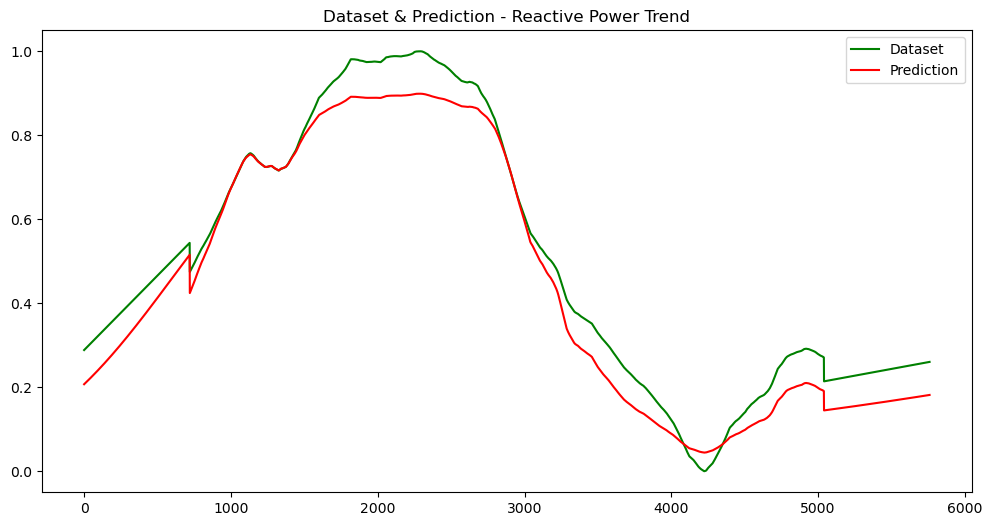

plot/Dataset & Prediction_Reactive Power_Trend.jpg
180/180 [==============================] - 1s 1ms/step


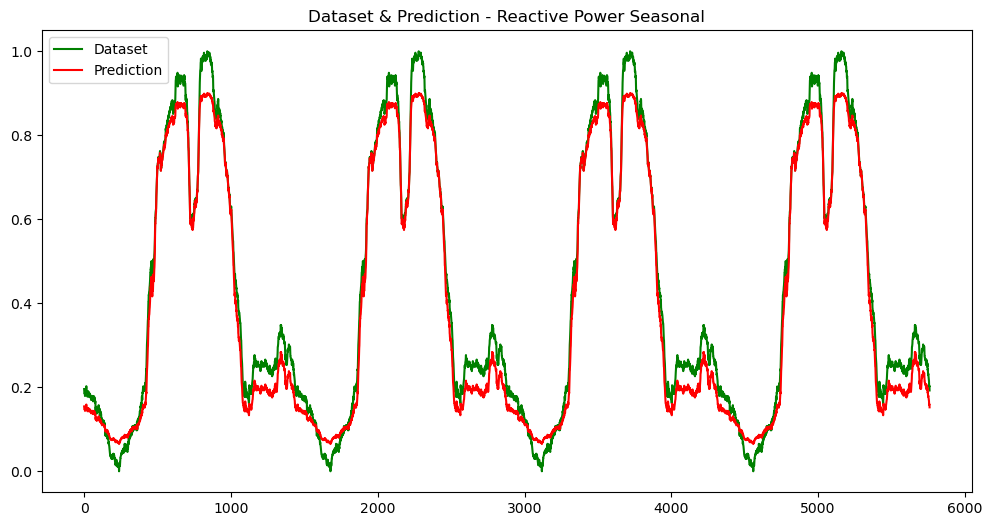

plot/Dataset & Prediction_Reactive Power_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


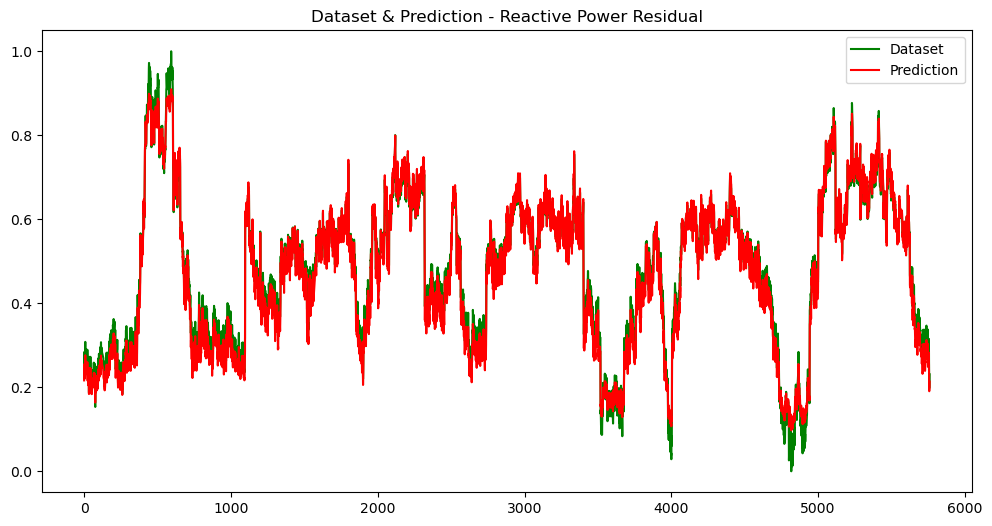

plot/Dataset & Prediction_Reactive Power_Residual.jpg


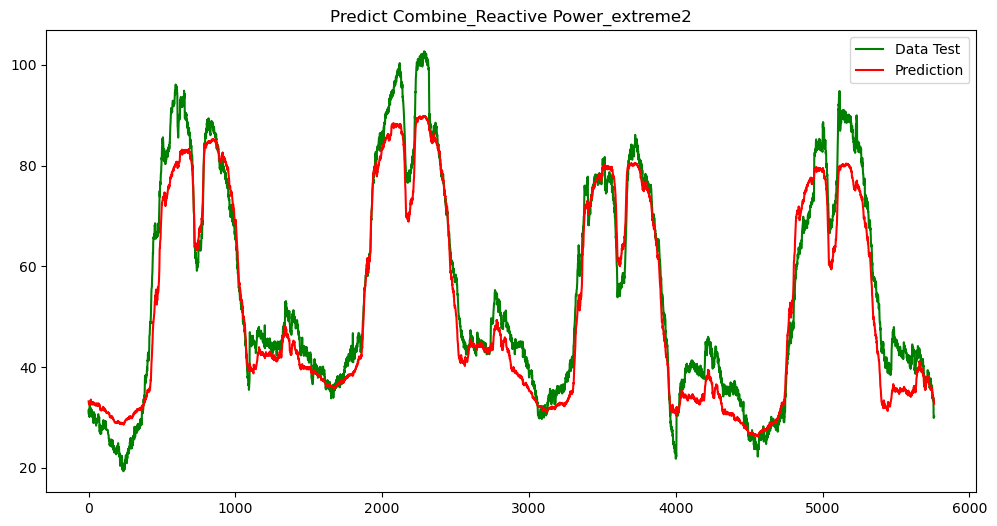

plot/Predict Combine_Reactive Power_extreme2.jpg
| > errorsDF:  [2.35305405 1.30625916 1.50041771 ... 3.19347191 3.06815529 2.55603409]
| > RSME:  5.500534086480692
| > MSE:  30.255875236535985
| > MAE:  4.456391870010424
Threshold:  3.036420773287265


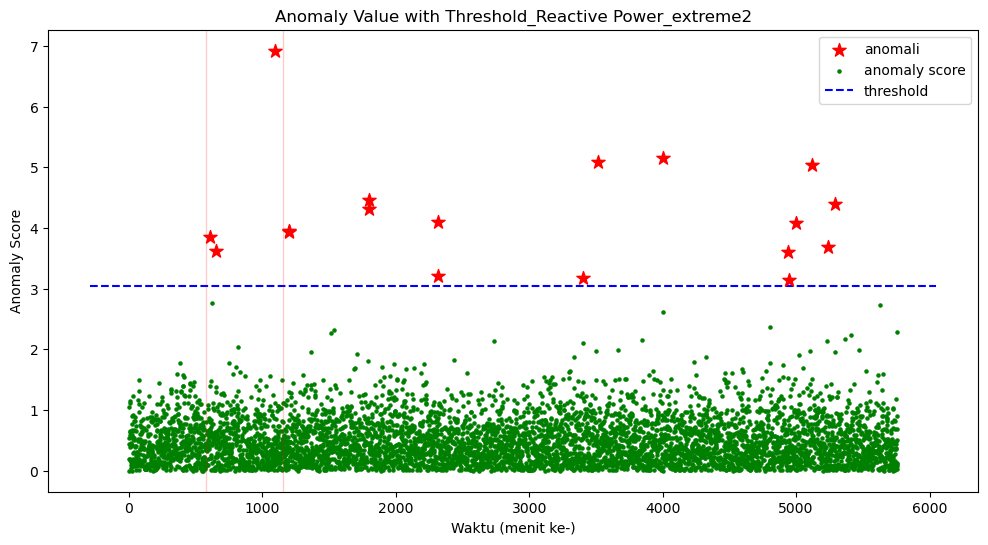

plot/Anomaly Value with Threshold_Reactive Power_extreme2.jpg


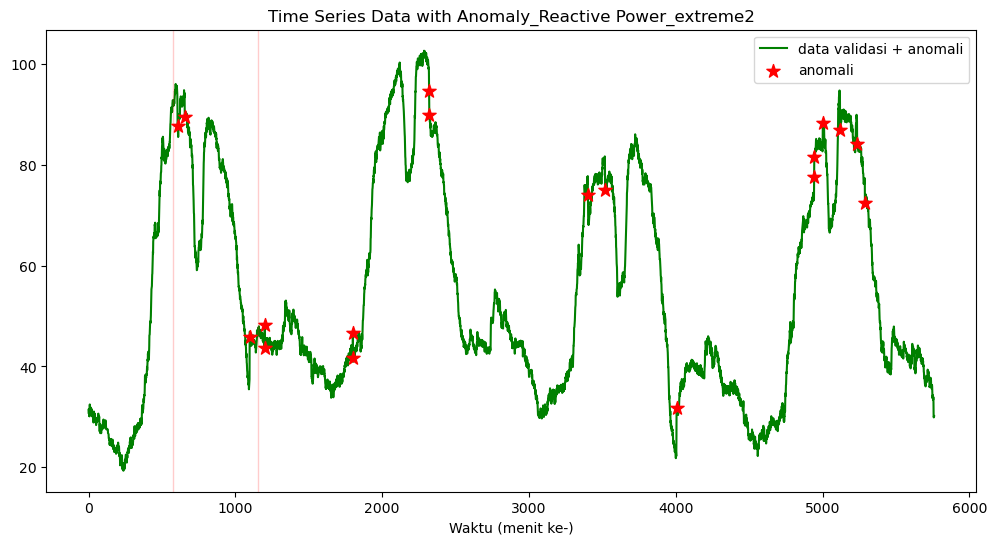

plot/Time Series Data with Anomaly_Reactive Power_extreme2.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  2
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:17:31.436331
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Generator Gross Capacity _ extreme 2
| > Sensor Start Time:  2023-05-19 08:17:31.436331 



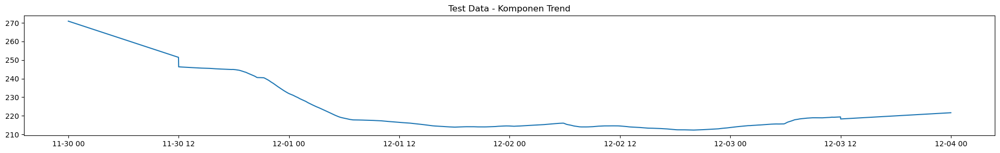

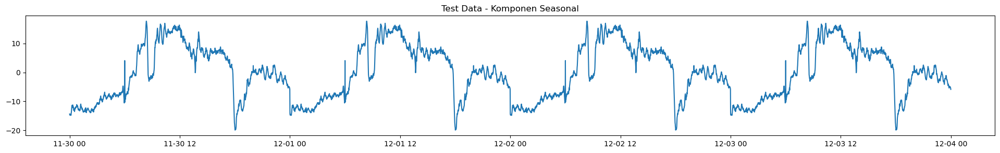

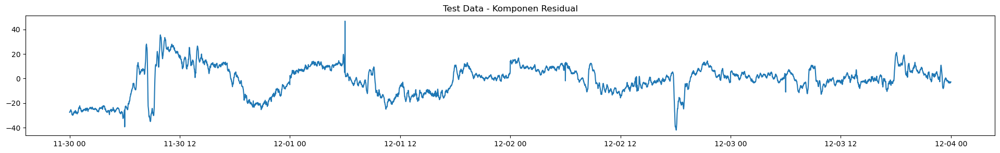

180/180 [==============================] - 1s 1ms/step


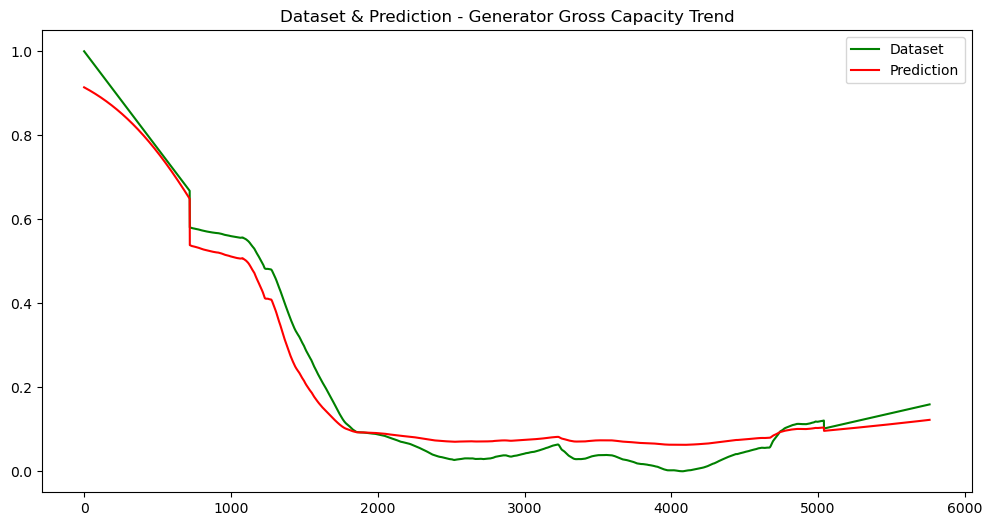

plot/Dataset & Prediction_Generator Gross Capacity_Trend.jpg
180/180 [==============================] - 1s 1ms/step


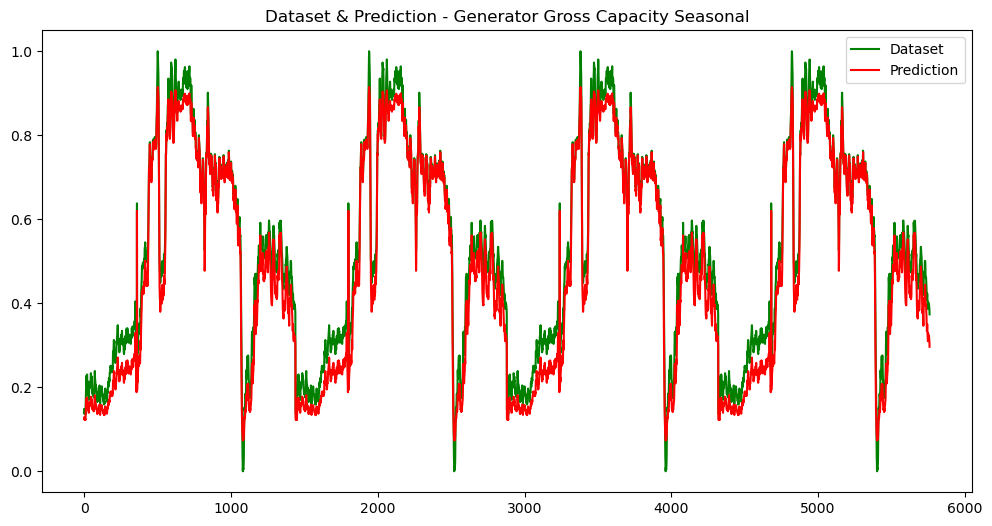

plot/Dataset & Prediction_Generator Gross Capacity_Seasonal.jpg
180/180 [==============================] - 1s 999us/step


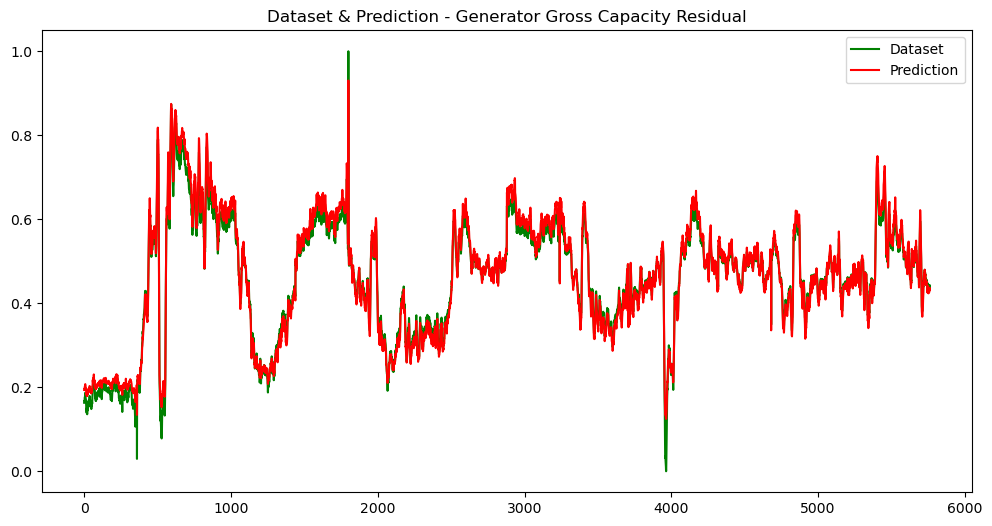

plot/Dataset & Prediction_Generator Gross Capacity_Residual.jpg


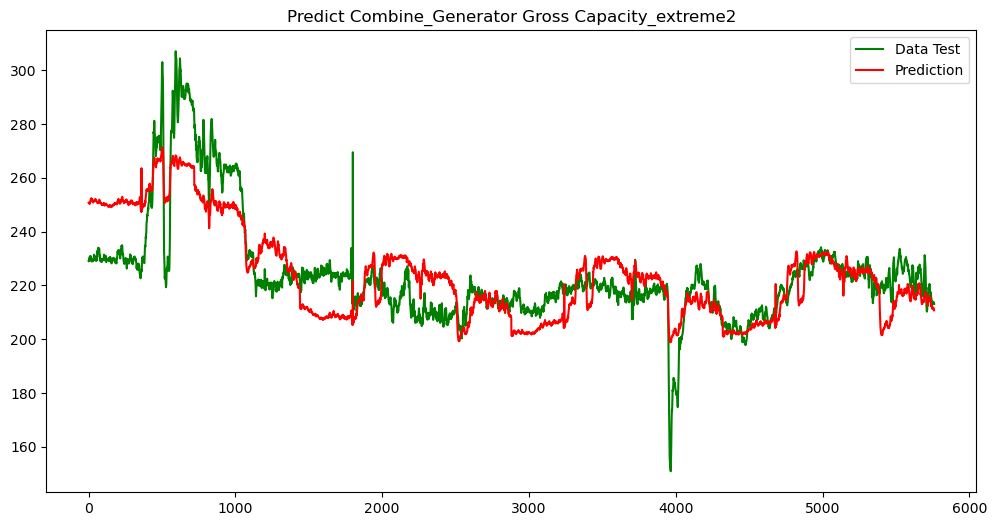

plot/Predict Combine_Generator Gross Capacity_extreme2.jpg
| > errorsDF:  [21.6808672  21.46142392 21.52087978 ...  2.36956115  1.85623358
  2.34569452]
| > RSME:  12.166941922217896
| > MSE:  148.0344757386233
| > MAE:  9.692077907215639
Threshold:  5.881423669839422


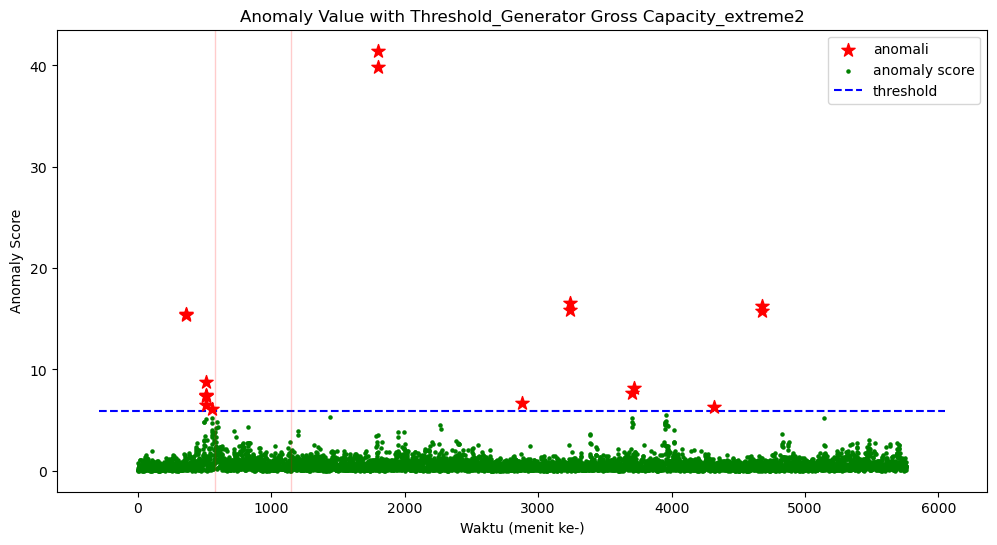

plot/Anomaly Value with Threshold_Generator Gross Capacity_extreme2.jpg


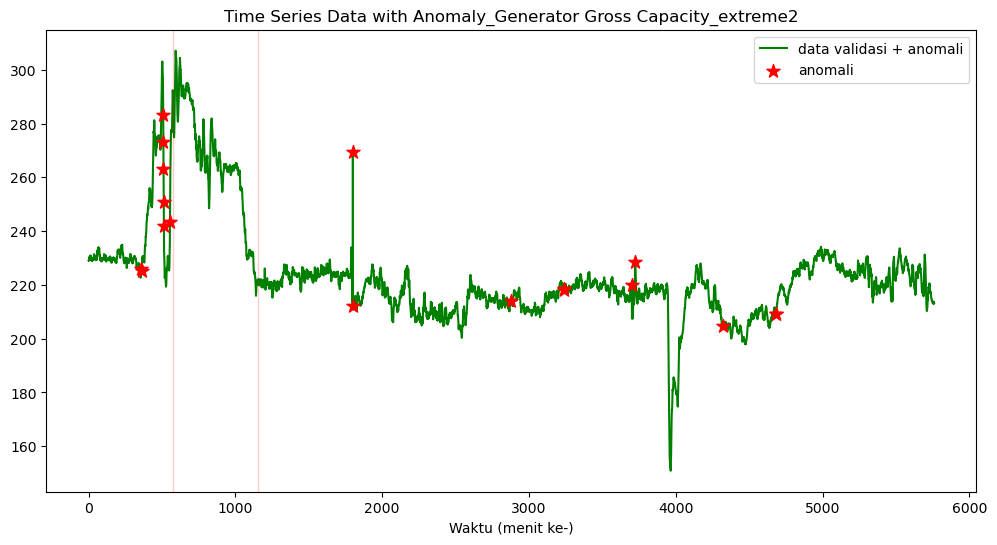

plot/Time Series Data with Anomaly_Generator Gross Capacity_extreme2.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  2
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:17:38.924820
| ========================================================================================== |



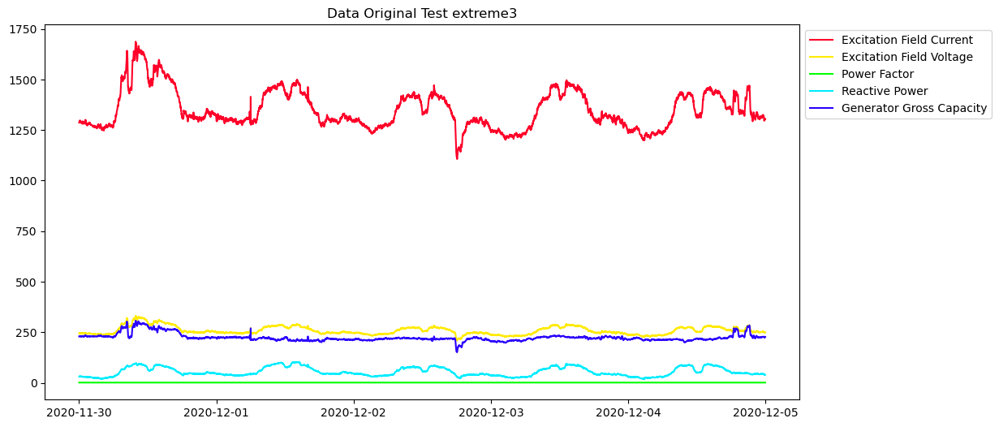


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 3
| > Sensor Start Time:  2023-05-19 08:17:41.141862 



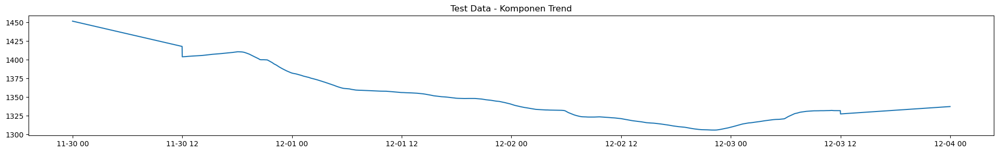

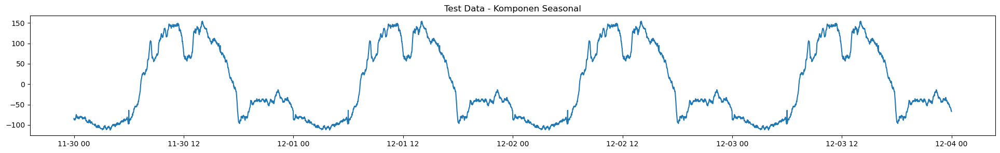

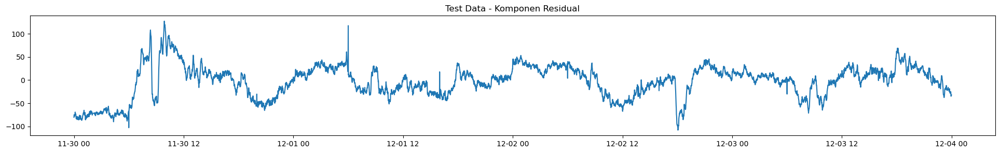

180/180 [==============================] - 1s 1ms/step


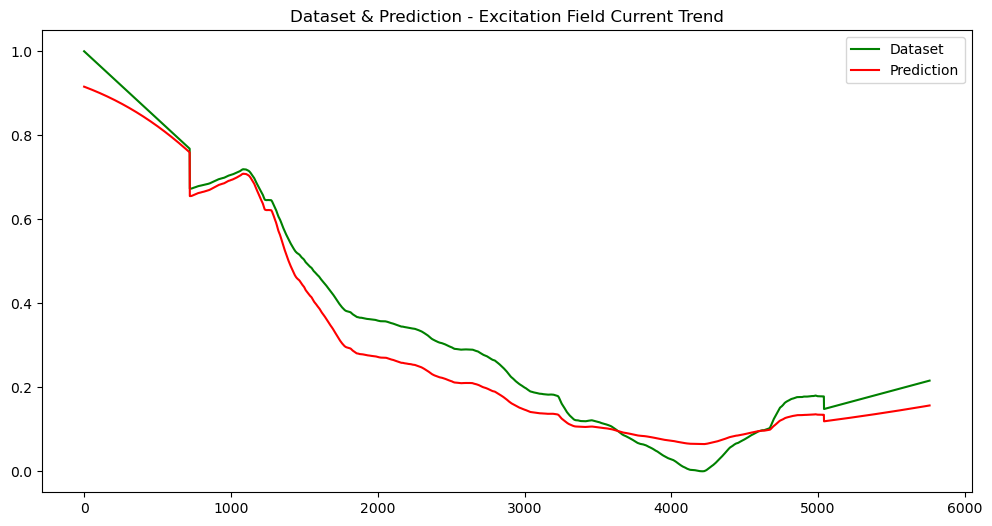

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 1ms/step


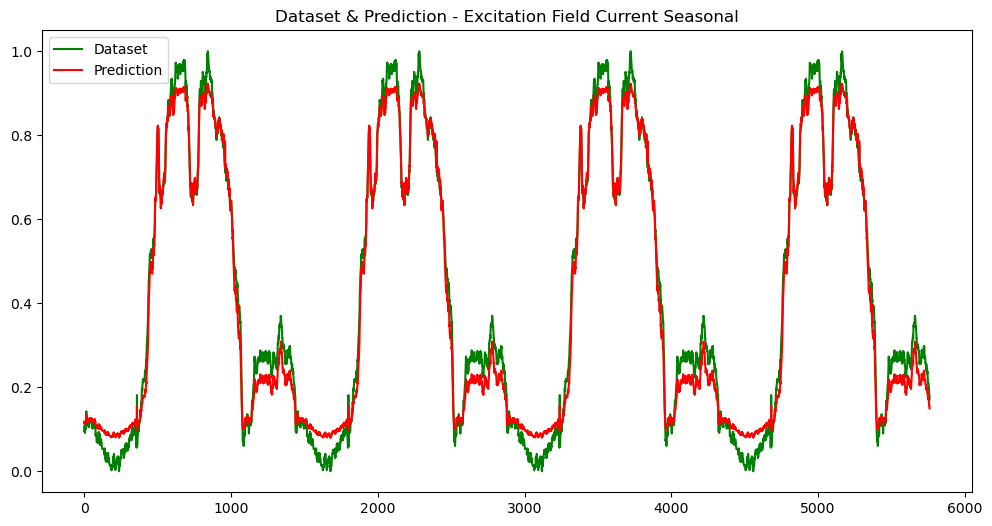

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 977us/step


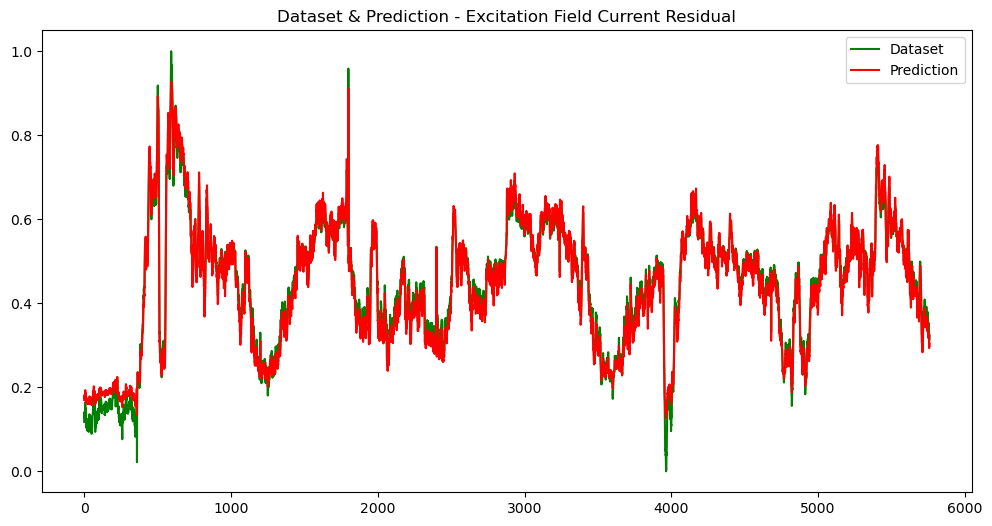

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


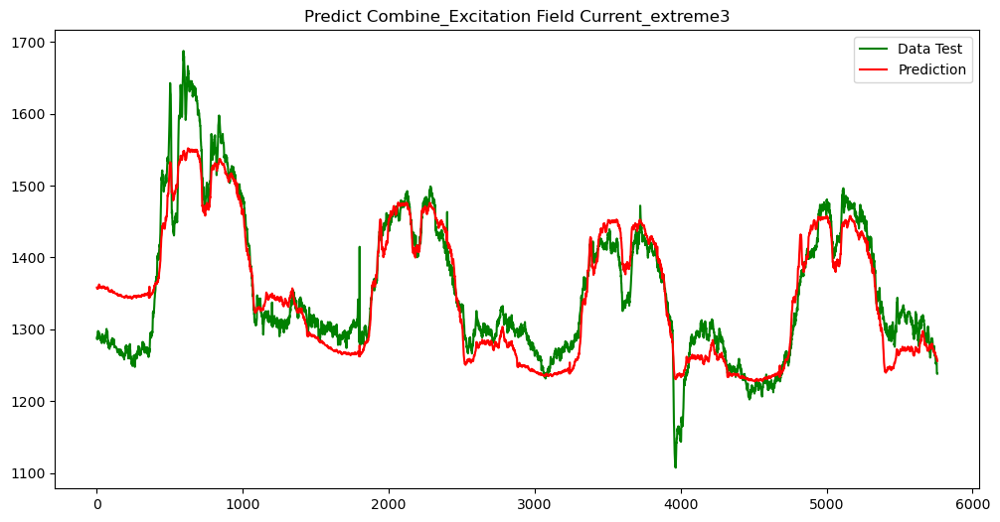

plot/Predict Combine_Excitation Field Current_extreme3.jpg
| > errorsDF:  [71.09249882 67.31901542 67.7452922  ... 18.74098202 18.49020394
 17.71403497]
| > RSME:  36.20613690520169
| > MSE:  1310.8843495982076
| > MAE:  28.403542093260715
Threshold:  18.773047749997048


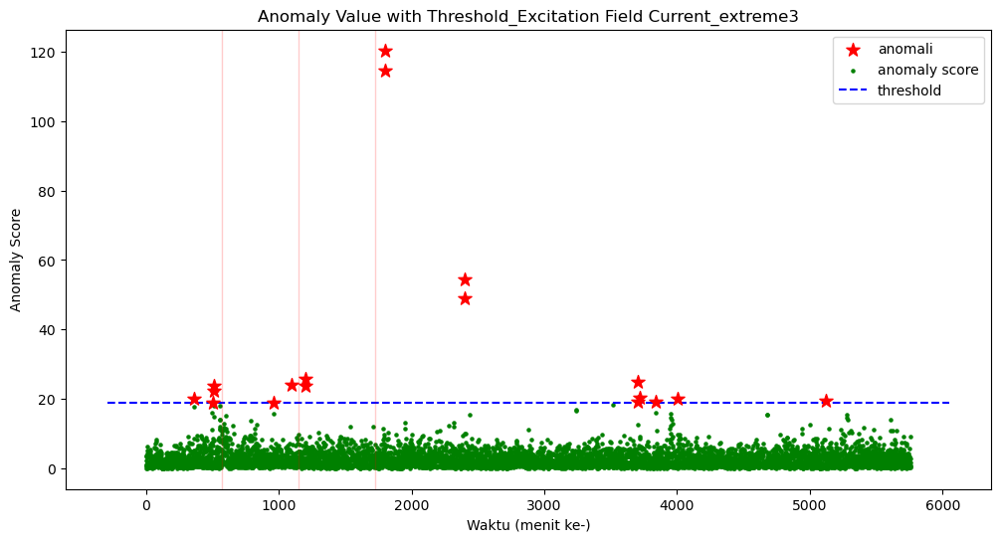

plot/Anomaly Value with Threshold_Excitation Field Current_extreme3.jpg


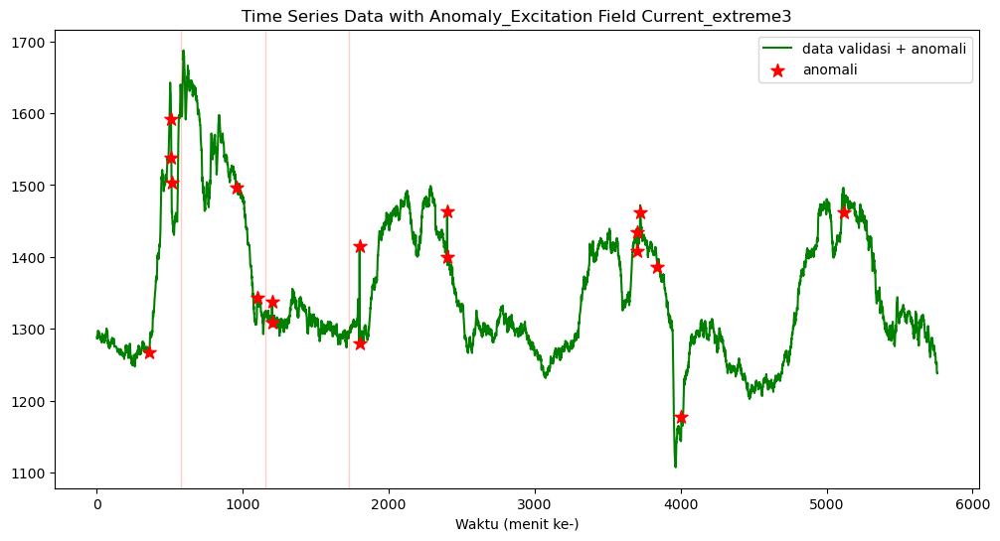

plot/Time Series Data with Anomaly_Excitation Field Current_extreme3.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  3
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:17:49.309086
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Excitation Field Voltage _ extreme 3
| > Sensor Start Time:  2023-05-19 08:17:49.309086 



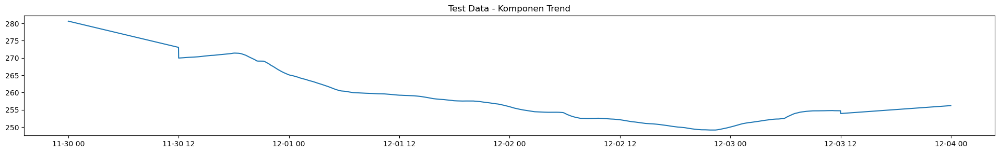

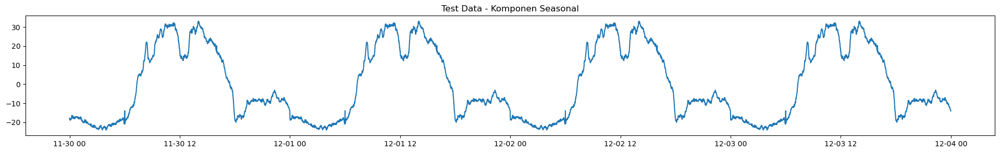

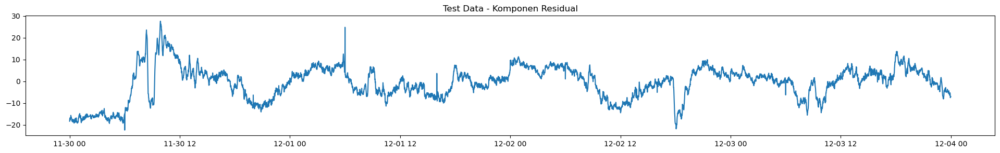

180/180 [==============================] - 1s 1ms/step


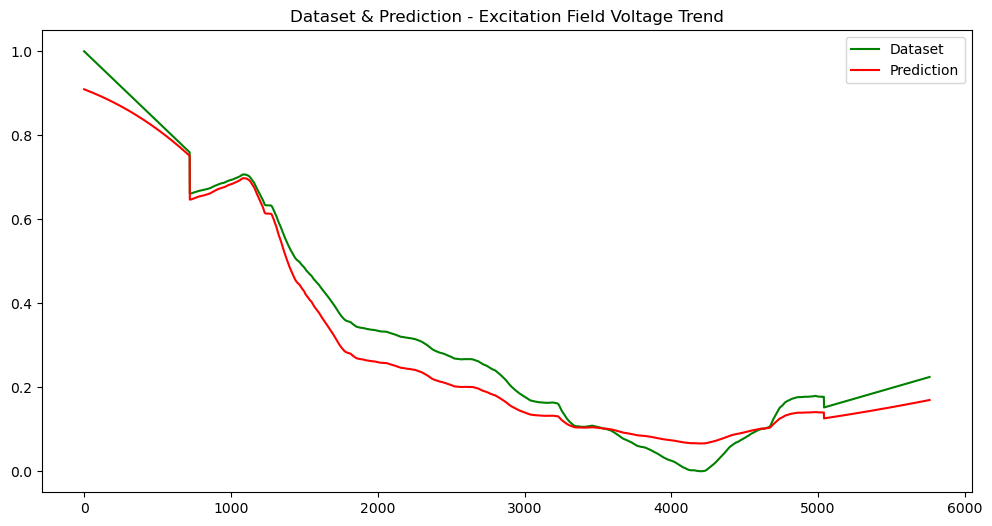

plot/Dataset & Prediction_Excitation Field Voltage_Trend.jpg
180/180 [==============================] - 1s 1ms/step


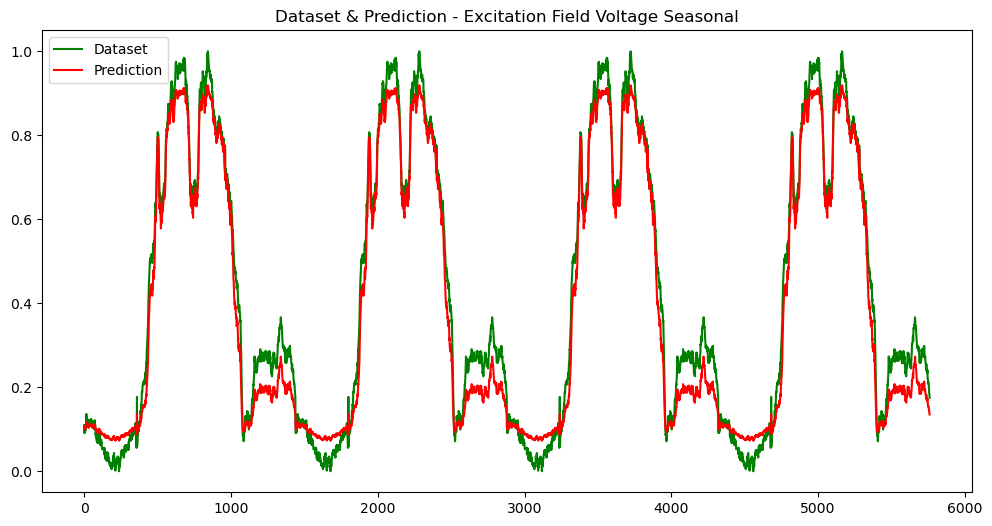

plot/Dataset & Prediction_Excitation Field Voltage_Seasonal.jpg
180/180 [==============================] - 1s 996us/step


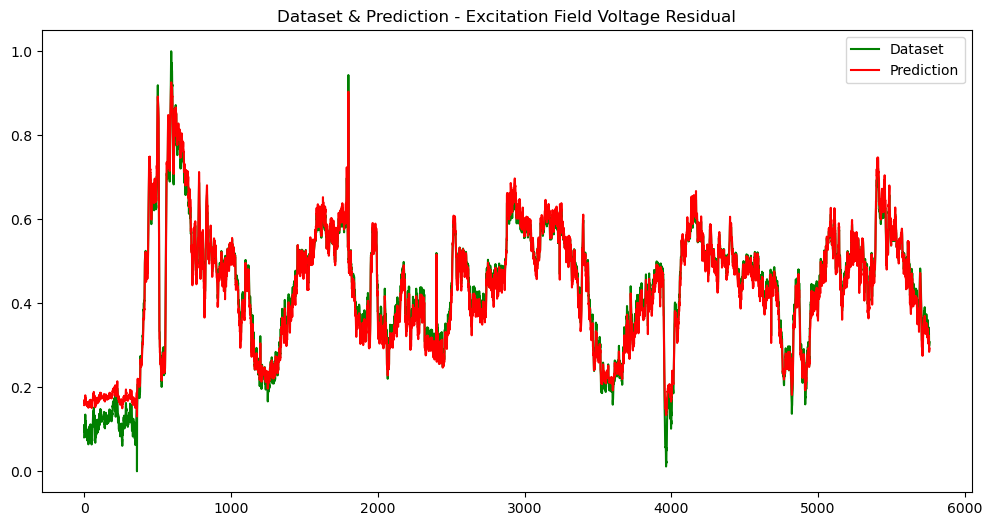

plot/Dataset & Prediction_Excitation Field Voltage_Residual.jpg


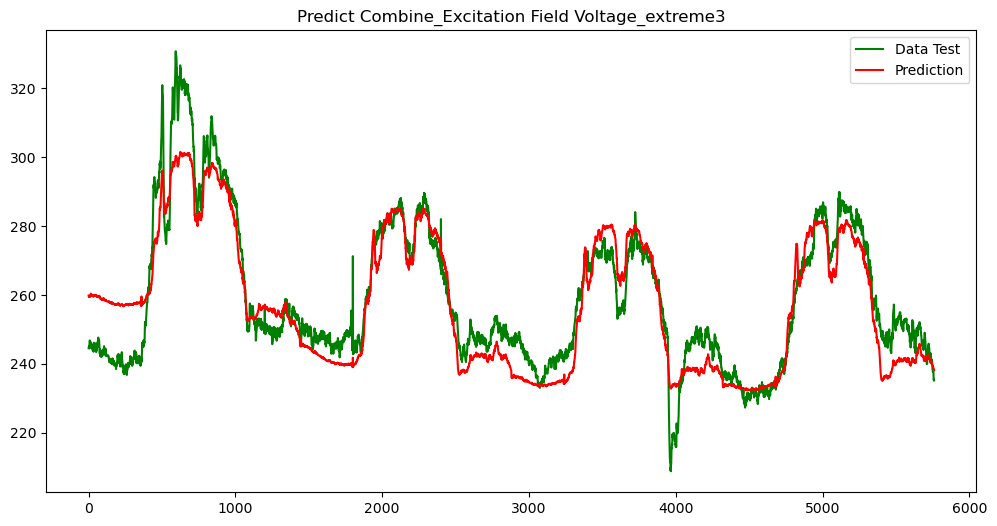

plot/Predict Combine_Excitation Field Voltage_extreme3.jpg
| > errorsDF:  [15.308775   14.64795875 14.51550298 ...  3.067955    2.95396809
  3.02755924]
| > RSME:  8.038780441406319
| > MSE:  64.62199098513676
| > MAE:  6.427484347409816
Threshold:  3.943778098440029


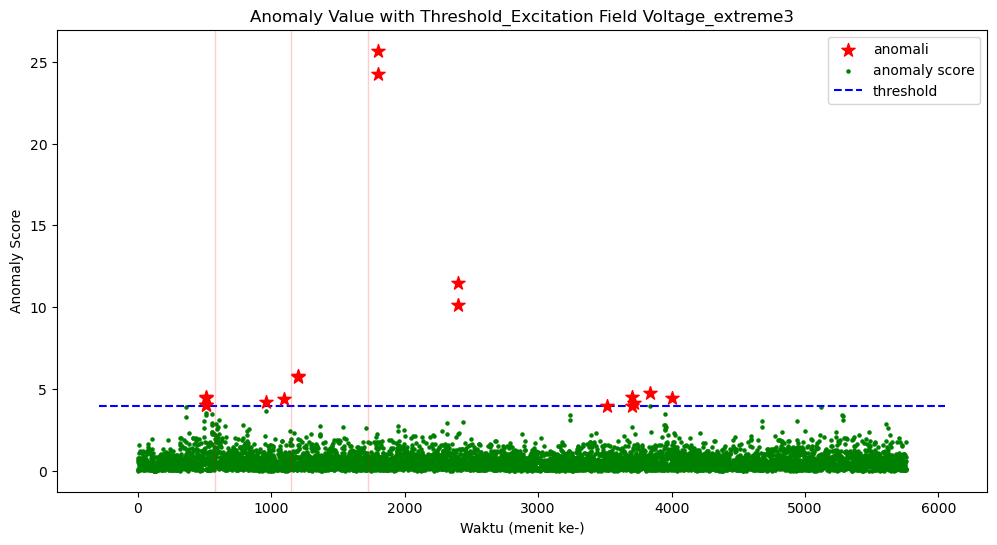

plot/Anomaly Value with Threshold_Excitation Field Voltage_extreme3.jpg


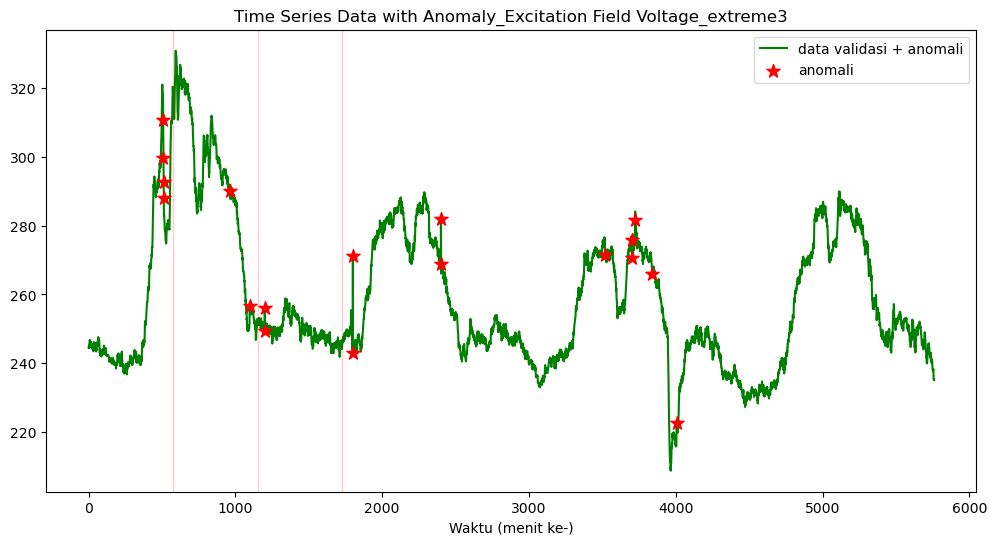

plot/Time Series Data with Anomaly_Excitation Field Voltage_extreme3.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  3
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:17:56.847247
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Power Factor _ extreme 3
| > Sensor Start Time:  2023-05-19 08:17:56.847247 



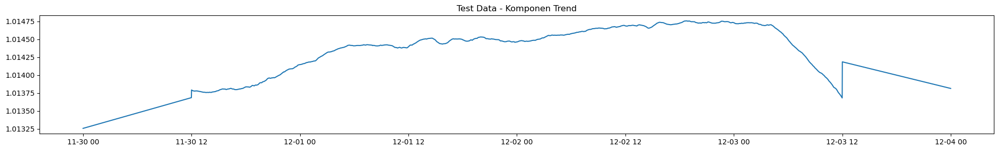

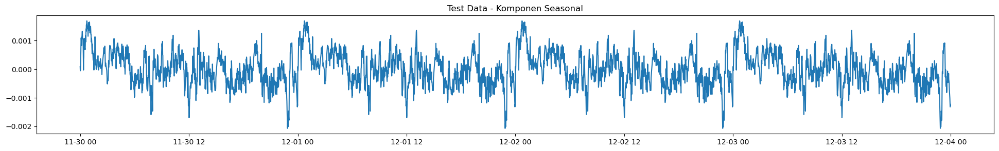

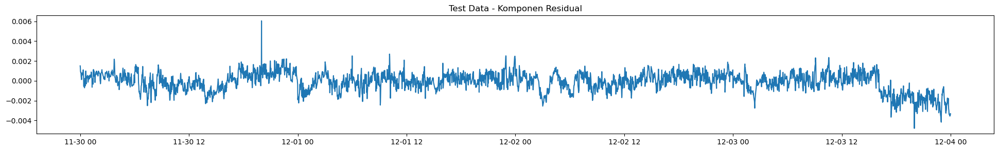

180/180 [==============================] - 1s 1ms/step


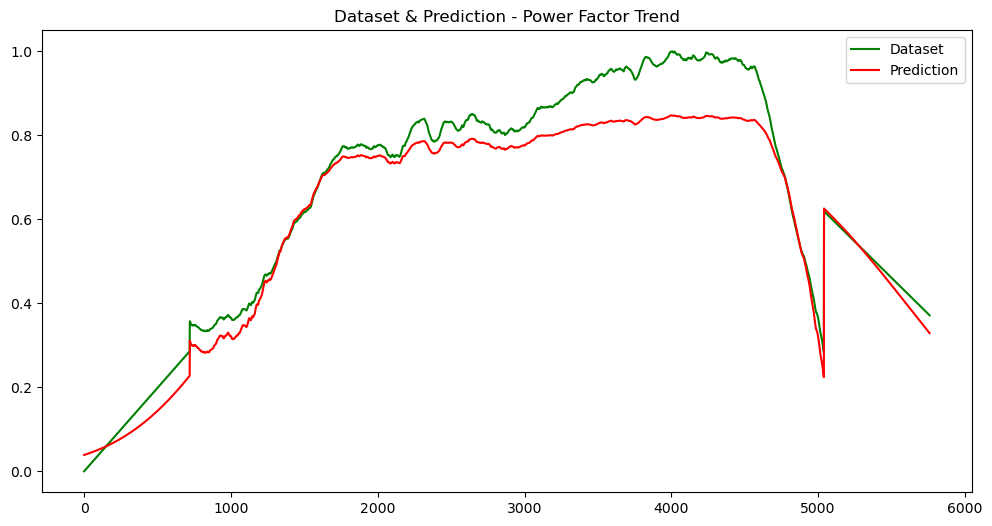

plot/Dataset & Prediction_Power Factor_Trend.jpg
180/180 [==============================] - 1s 1ms/step


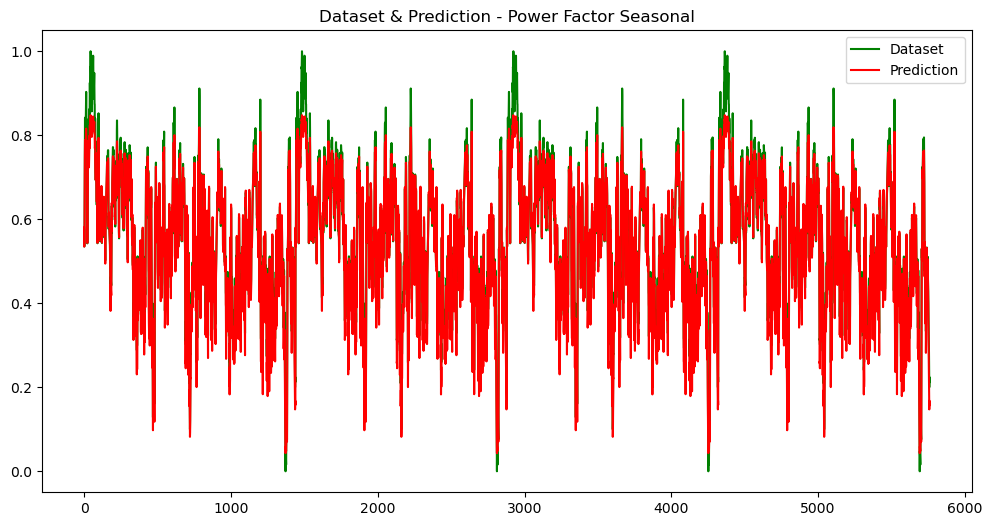

plot/Dataset & Prediction_Power Factor_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


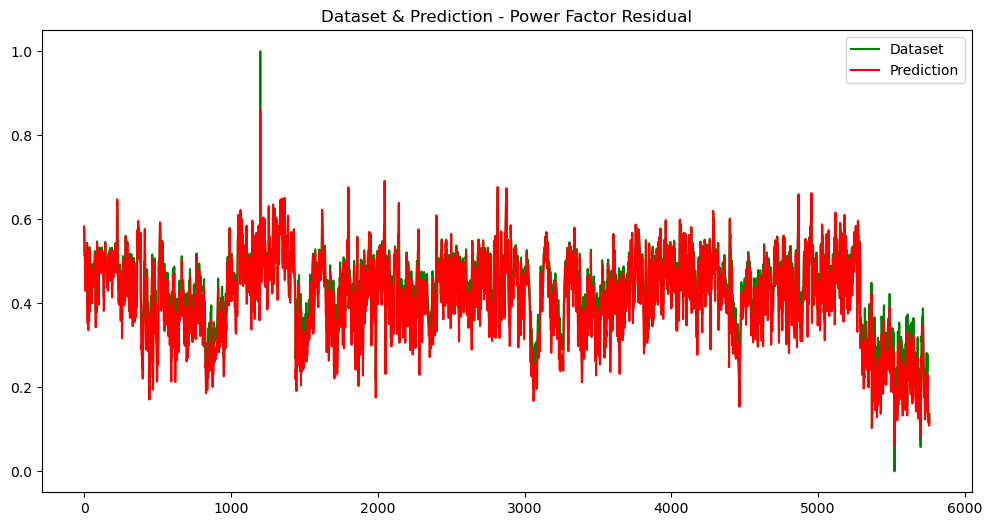

plot/Dataset & Prediction_Power Factor_Residual.jpg


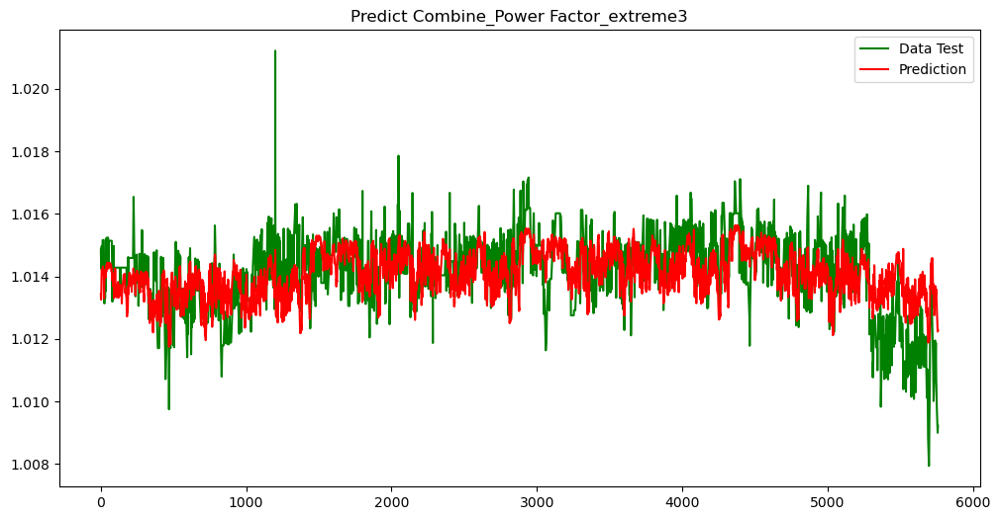

plot/Predict Combine_Power Factor_extreme3.jpg
| > errorsDF:  [0.00142702 0.00129136 0.0009492  ... 0.00323452 0.00319945 0.00304724]
| > RSME:  0.00094785610572847
| > MSE:  8.984311971667406e-07
| > MAE:  0.0007420643698984499
Threshold:  0.0015904517578779606


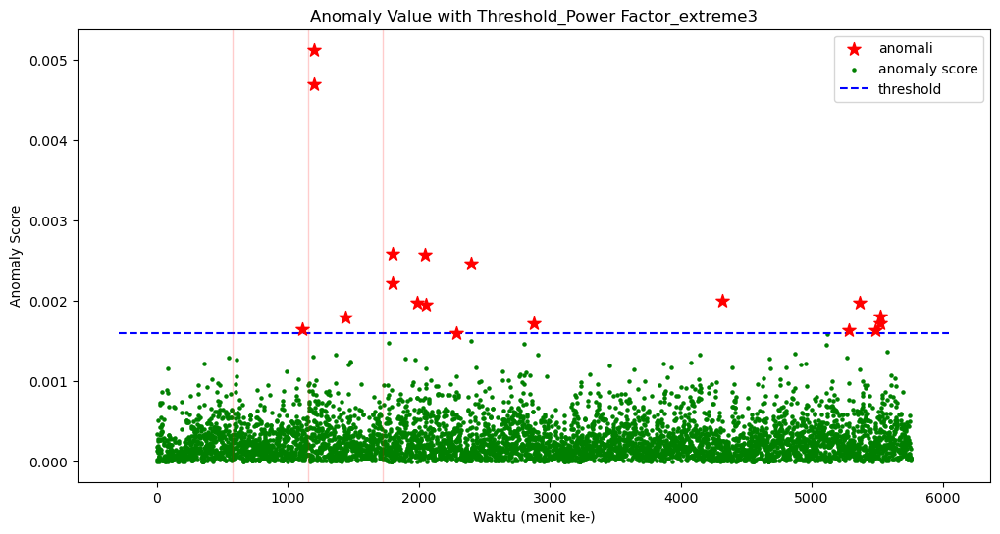

plot/Anomaly Value with Threshold_Power Factor_extreme3.jpg


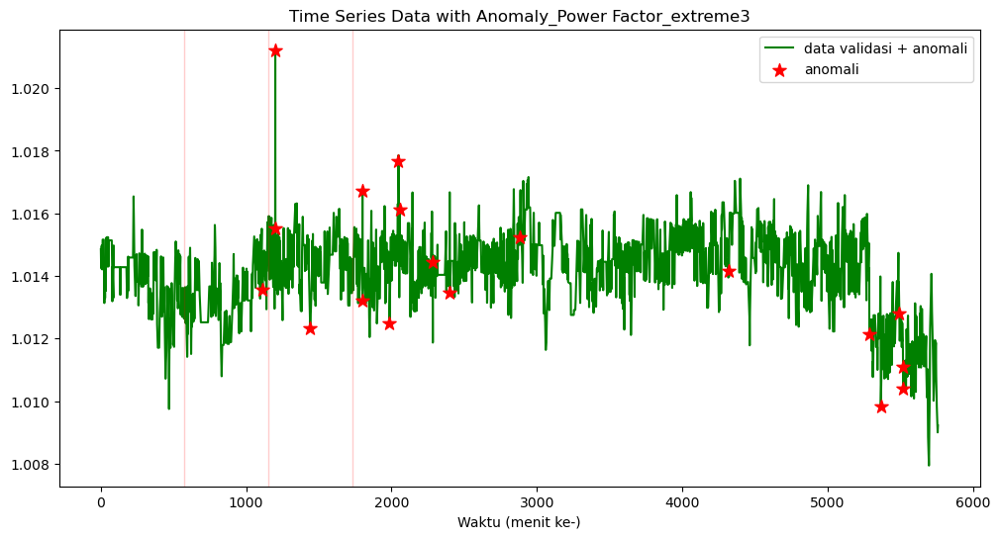

plot/Time Series Data with Anomaly_Power Factor_extreme3.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  3
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:18:04.911077
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Reactive Power _ extreme 3
| > Sensor Start Time:  2023-05-19 08:18:04.911077 



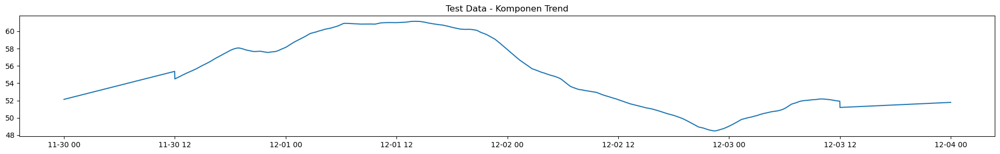

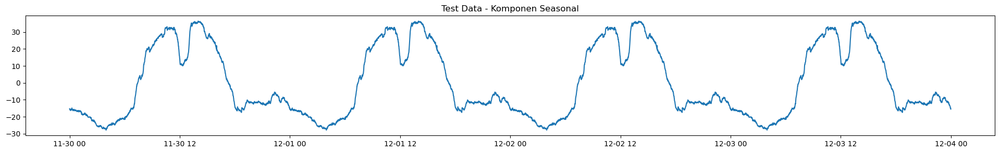

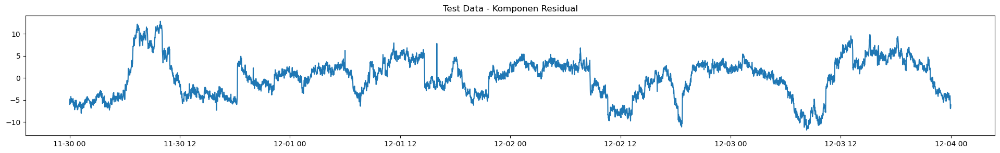

180/180 [==============================] - 1s 1ms/step


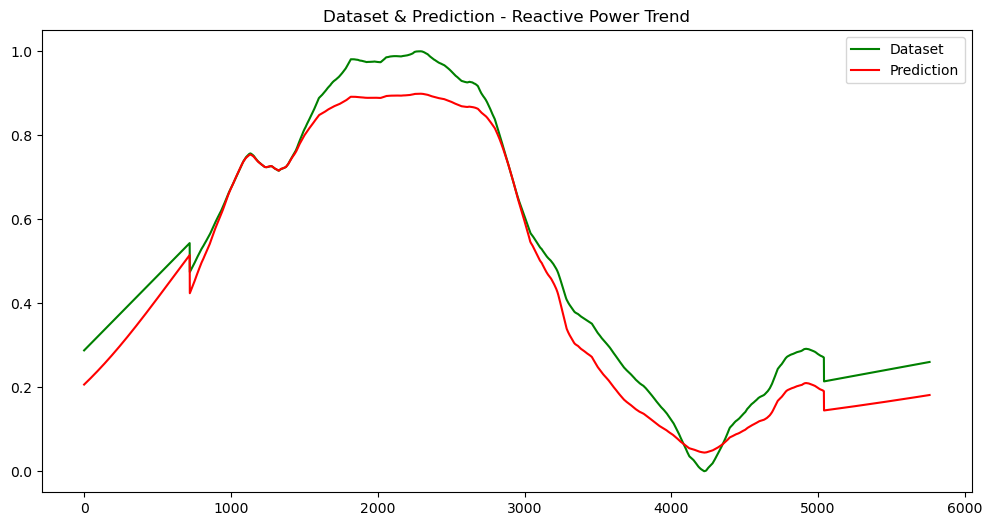

plot/Dataset & Prediction_Reactive Power_Trend.jpg
180/180 [==============================] - 1s 1ms/step


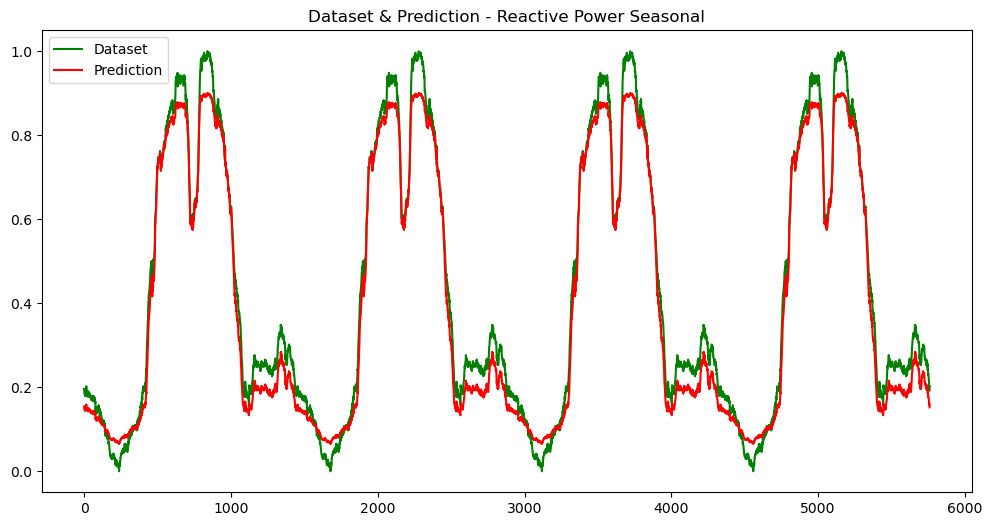

plot/Dataset & Prediction_Reactive Power_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


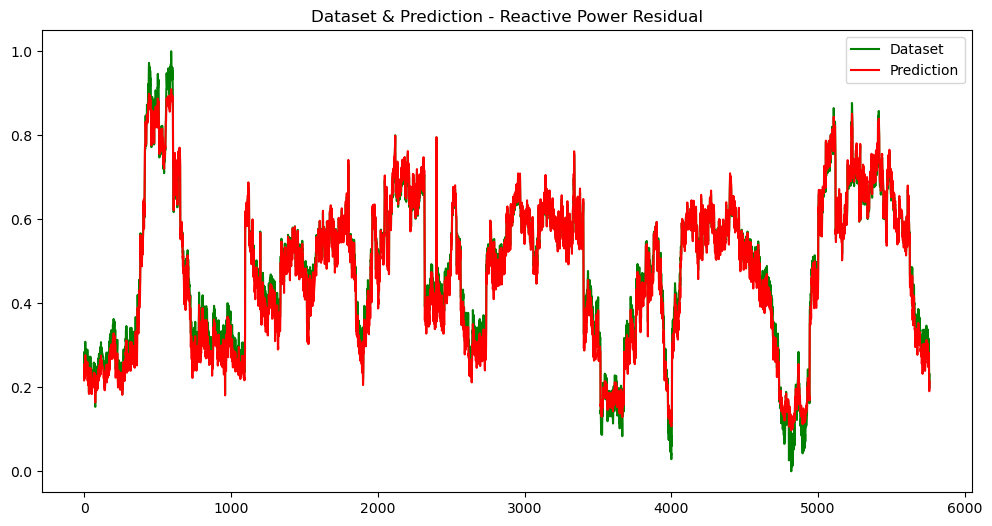

plot/Dataset & Prediction_Reactive Power_Residual.jpg


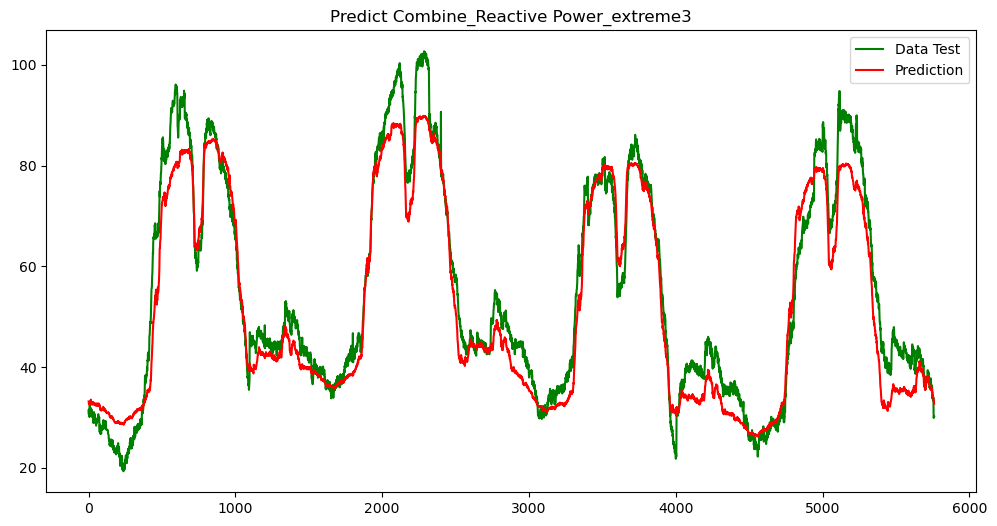

plot/Predict Combine_Reactive Power_extreme3.jpg
| > errorsDF:  [2.34431267 1.29751015 1.49165535 ... 3.19098663 3.06567192 2.55357361]
| > RSME:  5.502004698511503
| > MSE:  30.272055702442653
| > MAE:  4.457563557540876
Threshold:  3.4480929816364956


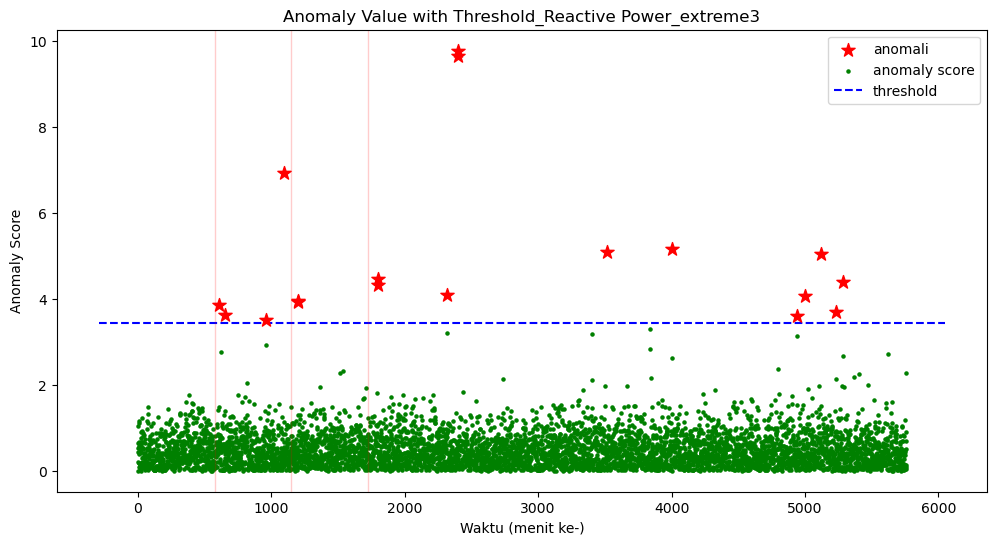

plot/Anomaly Value with Threshold_Reactive Power_extreme3.jpg


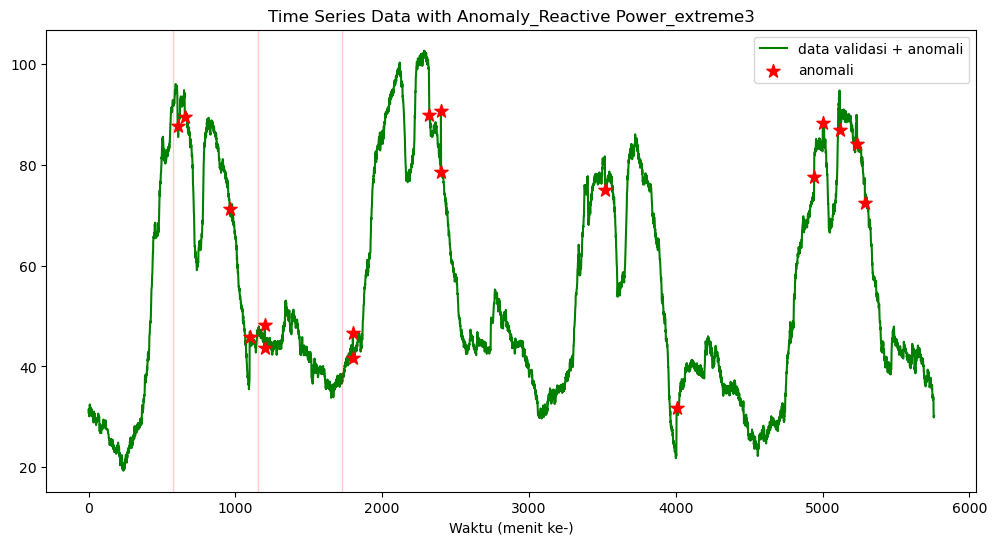

plot/Time Series Data with Anomaly_Reactive Power_extreme3.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  3
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:18:12.014468
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Generator Gross Capacity _ extreme 3
| > Sensor Start Time:  2023-05-19 08:18:12.014468 



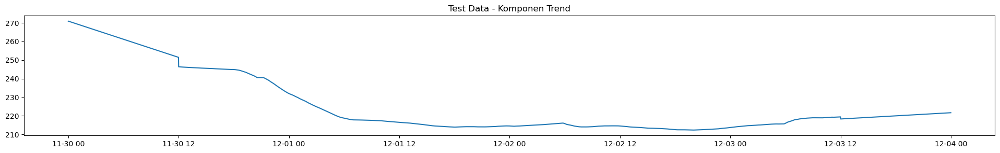

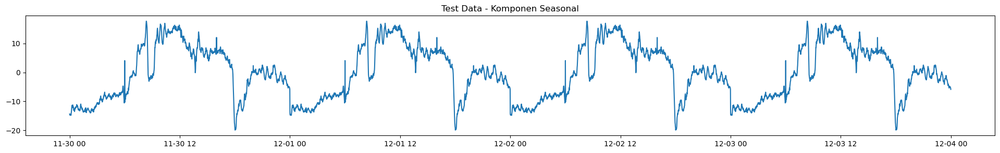

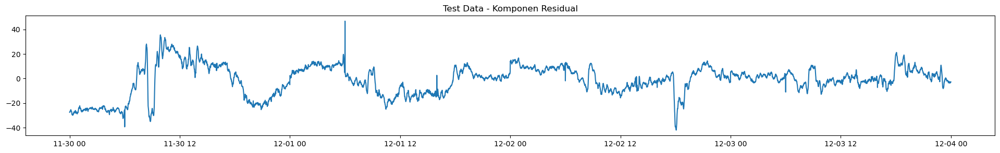

180/180 [==============================] - 1s 1ms/step


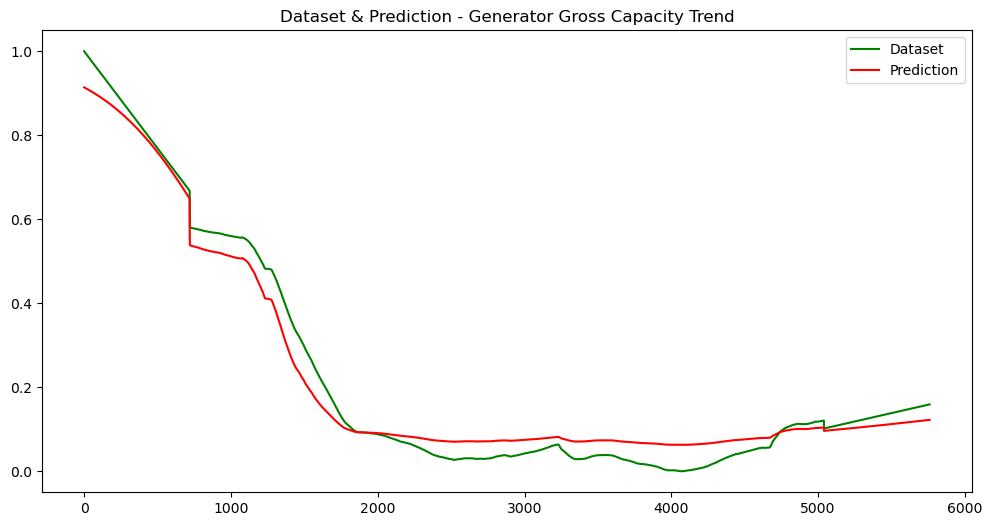

plot/Dataset & Prediction_Generator Gross Capacity_Trend.jpg
180/180 [==============================] - 1s 1ms/step


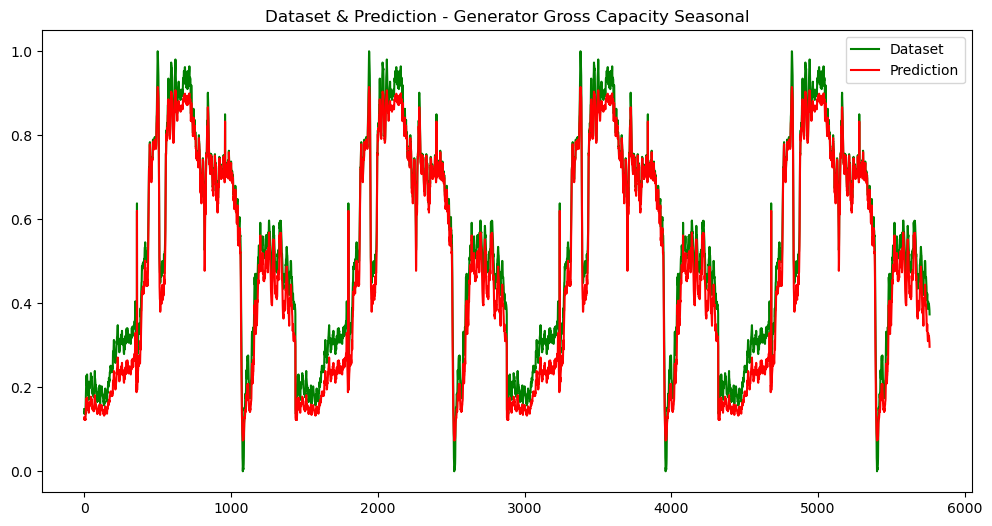

plot/Dataset & Prediction_Generator Gross Capacity_Seasonal.jpg
180/180 [==============================] - 1s 981us/step


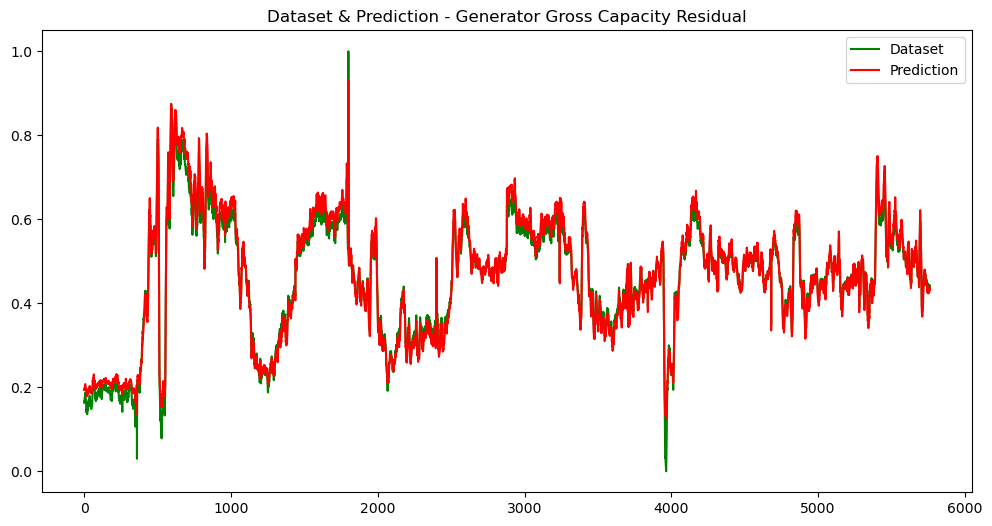

plot/Dataset & Prediction_Generator Gross Capacity_Residual.jpg


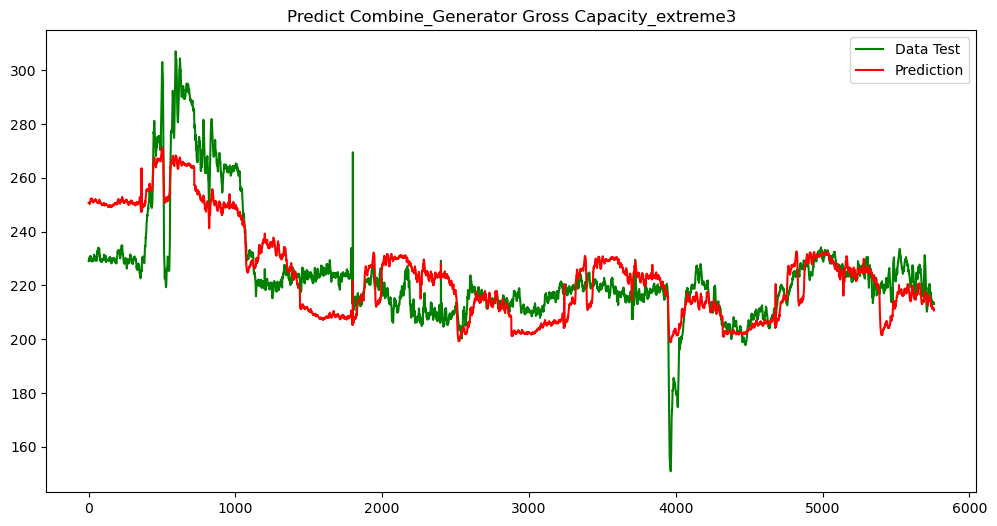

plot/Predict Combine_Generator Gross Capacity_extreme3.jpg
| > errorsDF:  [21.66561318 21.4461184  21.50558475 ...  2.37456794  1.86123274
  2.35067365]
| > RSME:  12.164941252786189
| > MSE:  147.9857956837392
| > MAE:  9.690467799347212
Threshold:  6.423873297717373


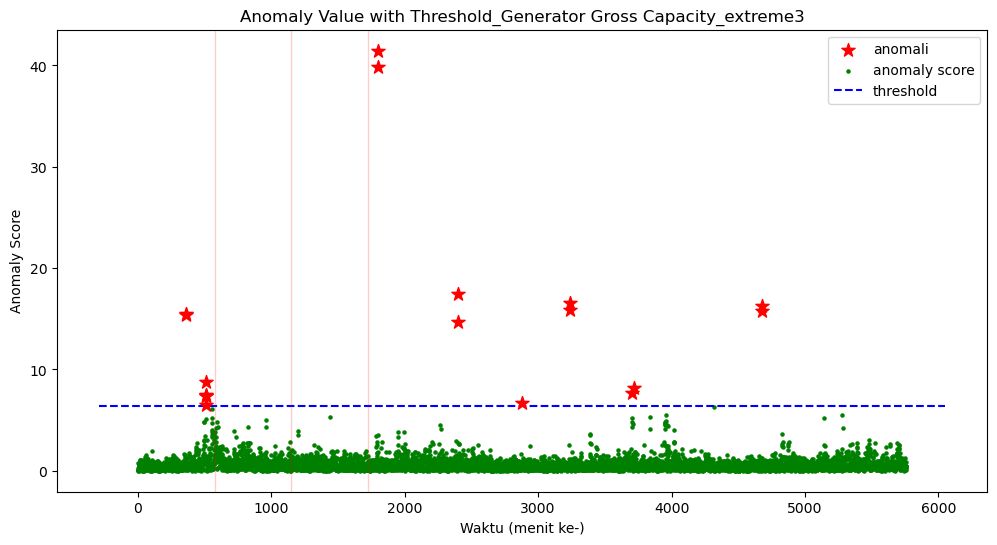

plot/Anomaly Value with Threshold_Generator Gross Capacity_extreme3.jpg


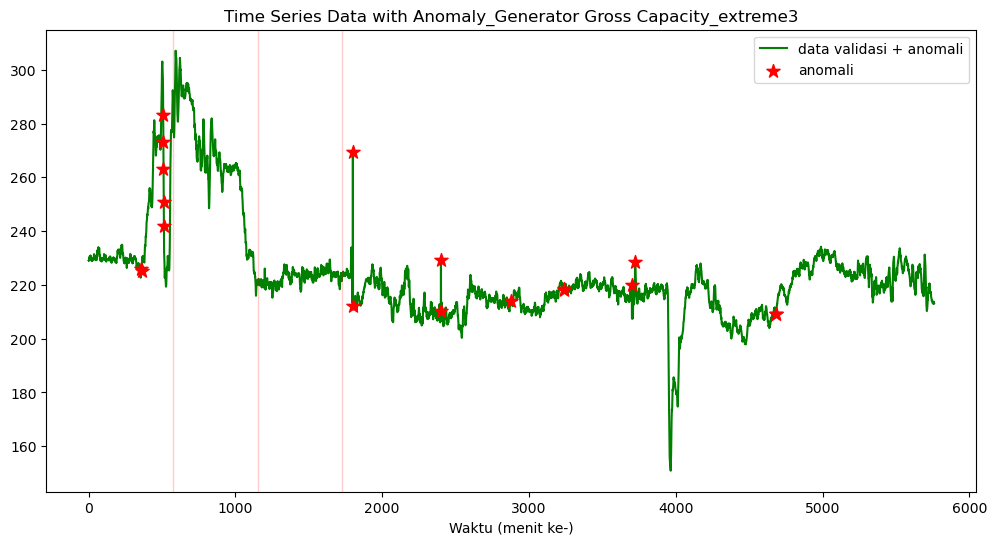

plot/Time Series Data with Anomaly_Generator Gross Capacity_extreme3.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  3
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:18:19.236375
| ========================================================================================== |



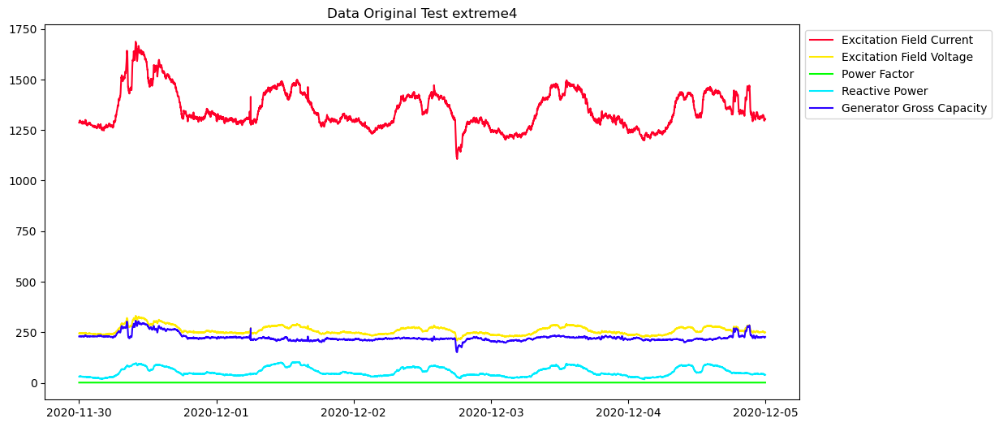


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 4
| > Sensor Start Time:  2023-05-19 08:18:21.004421 



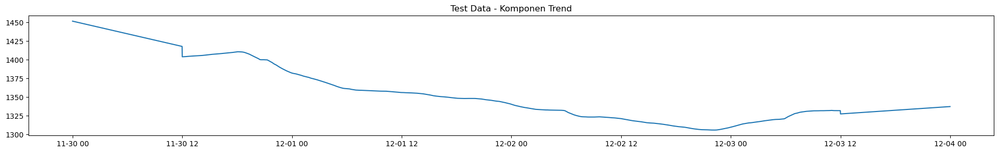

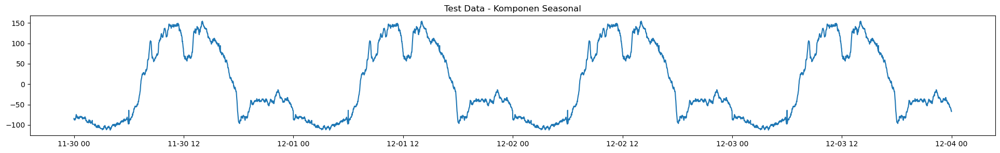

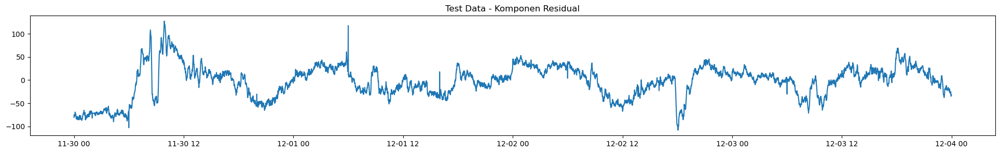

180/180 [==============================] - 1s 1ms/step


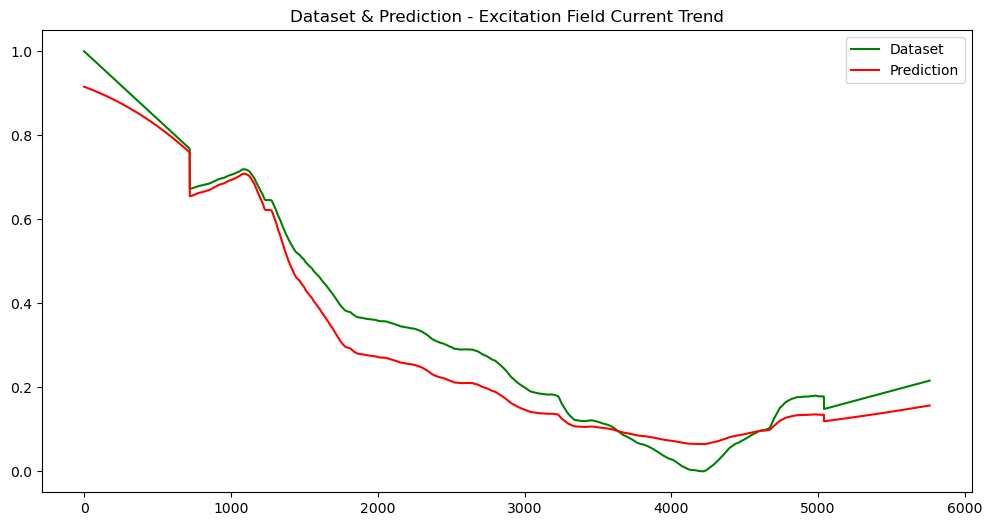

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 1ms/step


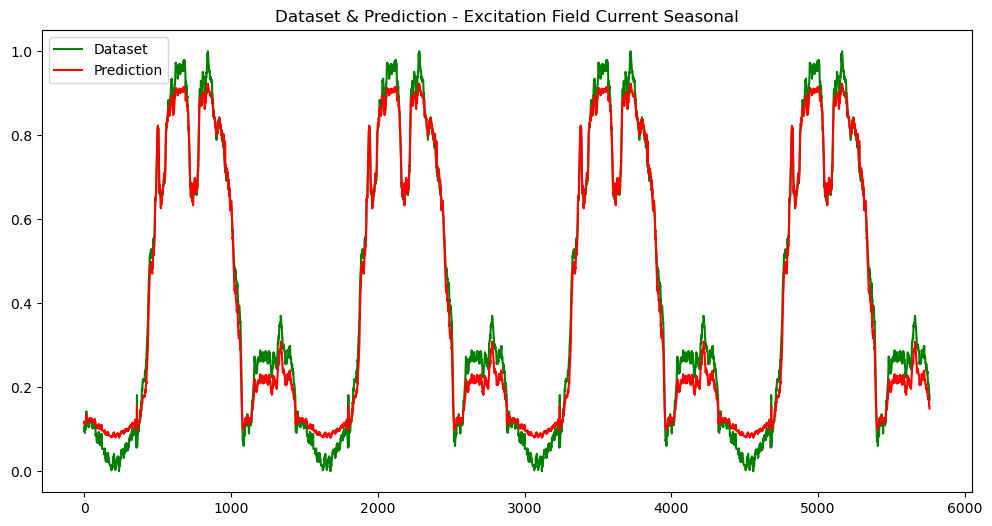

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


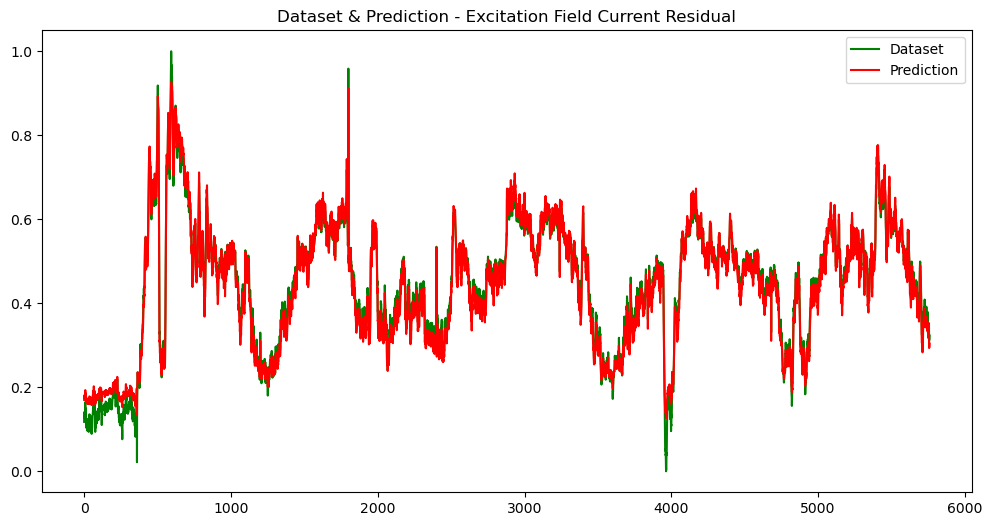

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


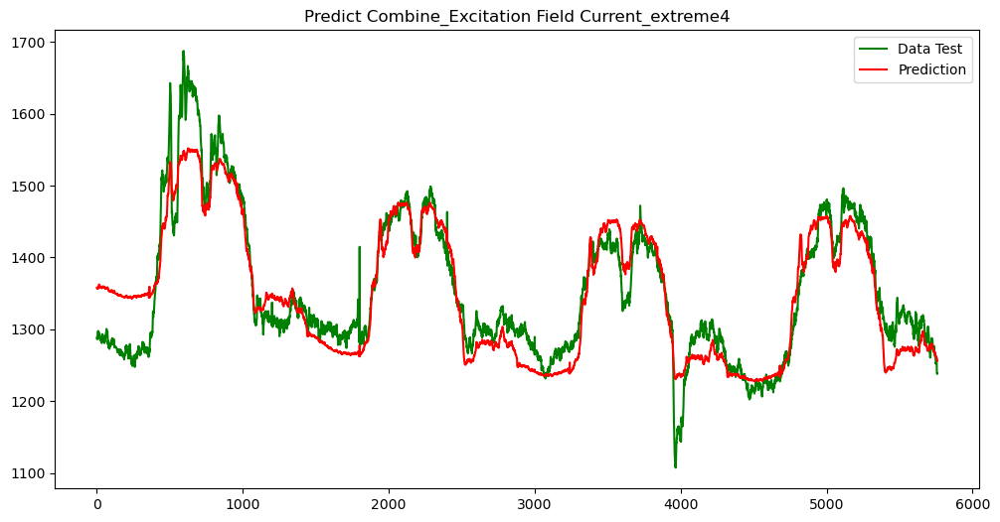

plot/Predict Combine_Excitation Field Current_extreme4.jpg
| > errorsDF:  [71.08737187 67.31388084 67.74015762 ... 18.73257442 18.48154458
 17.70545953]
| > RSME:  36.21055820595156
| > MSE:  1311.2045255866058
| > MAE:  28.407486997748673
Threshold:  19.01578966646496


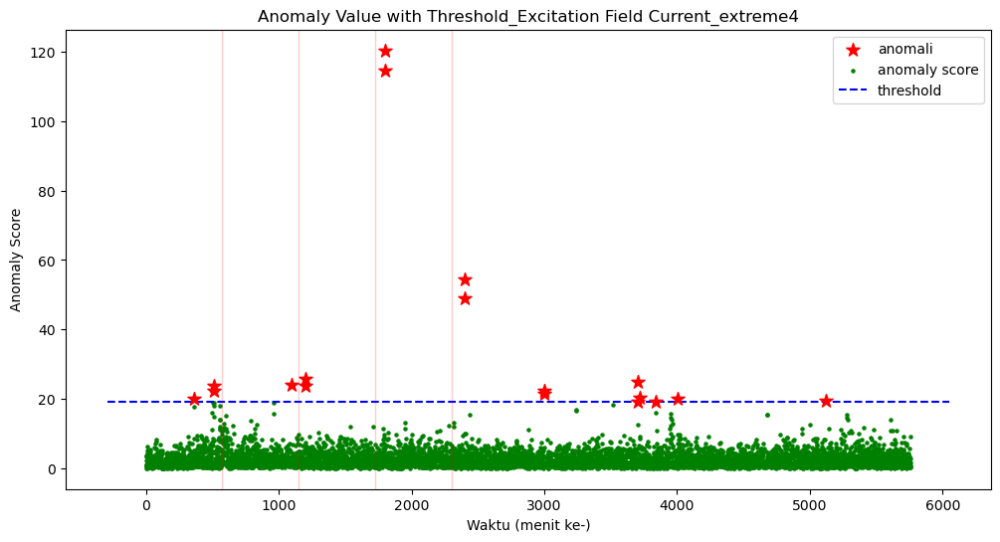

plot/Anomaly Value with Threshold_Excitation Field Current_extreme4.jpg


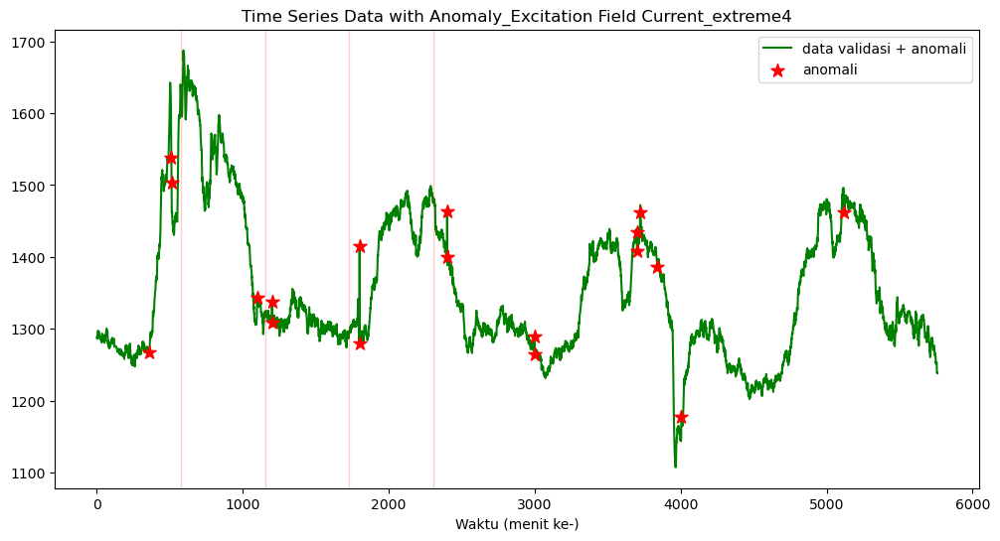

plot/Time Series Data with Anomaly_Excitation Field Current_extreme4.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  4
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:18:28.415546
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Excitation Field Voltage _ extreme 4
| > Sensor Start Time:  2023-05-19 08:18:28.415546 



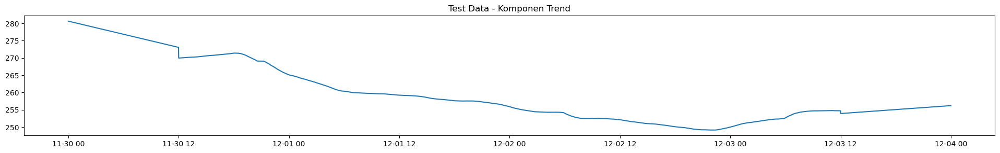

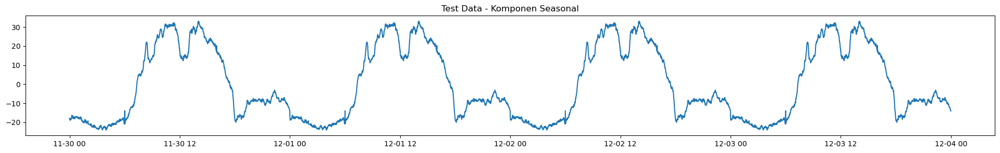

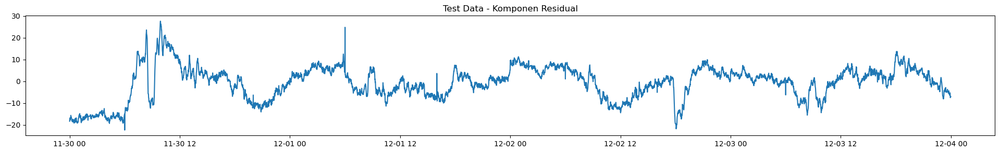

180/180 [==============================] - 1s 1ms/step


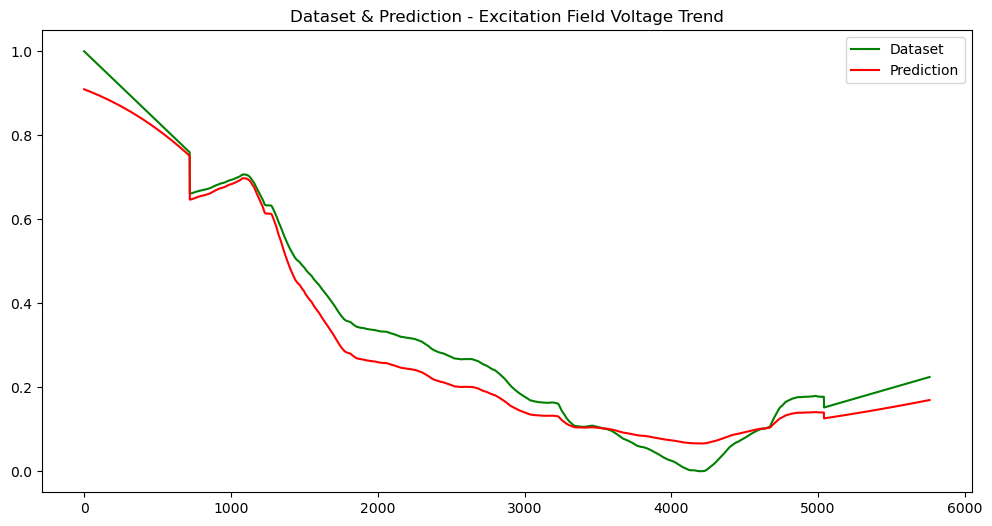

plot/Dataset & Prediction_Excitation Field Voltage_Trend.jpg
180/180 [==============================] - 1s 1ms/step


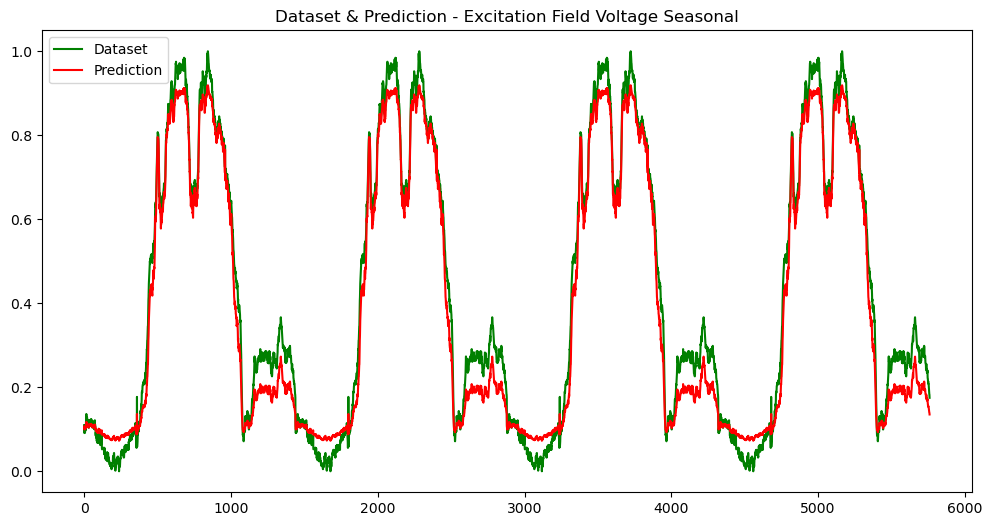

plot/Dataset & Prediction_Excitation Field Voltage_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


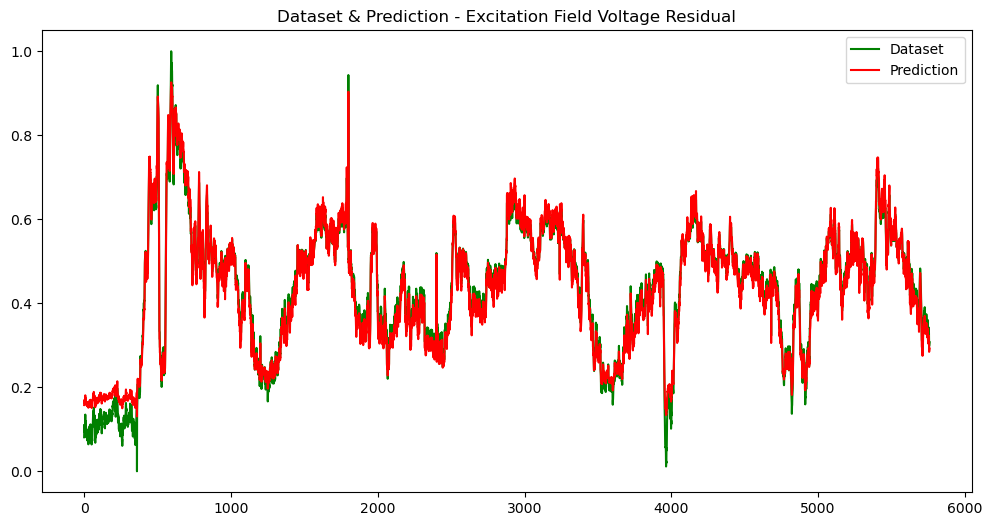

plot/Dataset & Prediction_Excitation Field Voltage_Residual.jpg


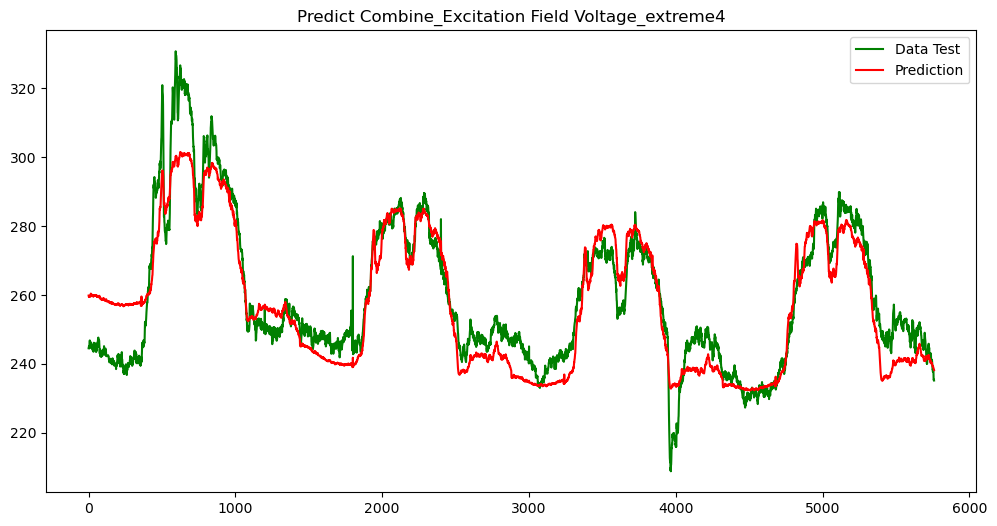

plot/Predict Combine_Excitation Field Voltage_extreme4.jpg
| > errorsDF:  [15.3077126  14.64689445 14.51443677 ...  3.06608007  2.95209507
  3.02571101]
| > RSME:  8.039750840082434
| > MSE:  64.6375935706062
| > MAE:  6.428386938220121
Threshold:  3.998818569016393


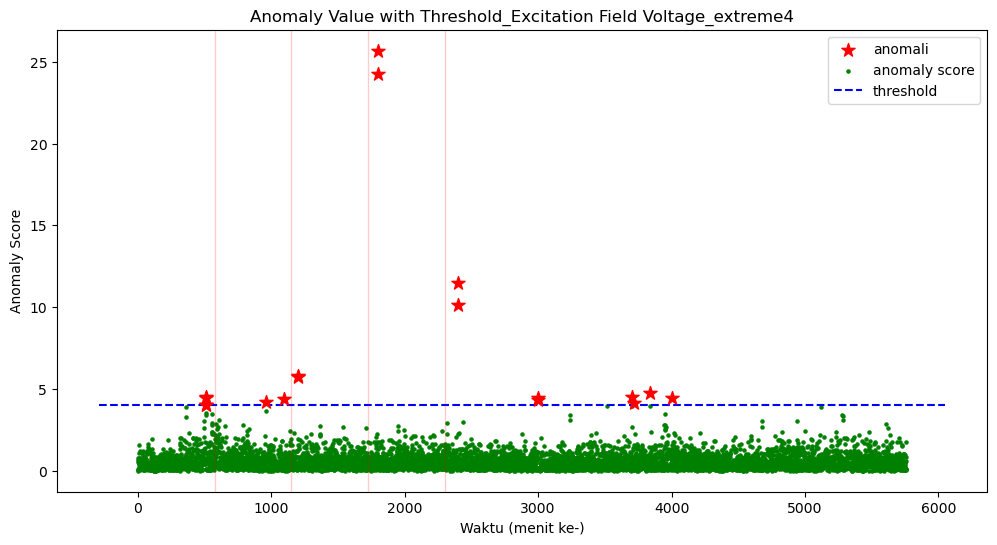

plot/Anomaly Value with Threshold_Excitation Field Voltage_extreme4.jpg


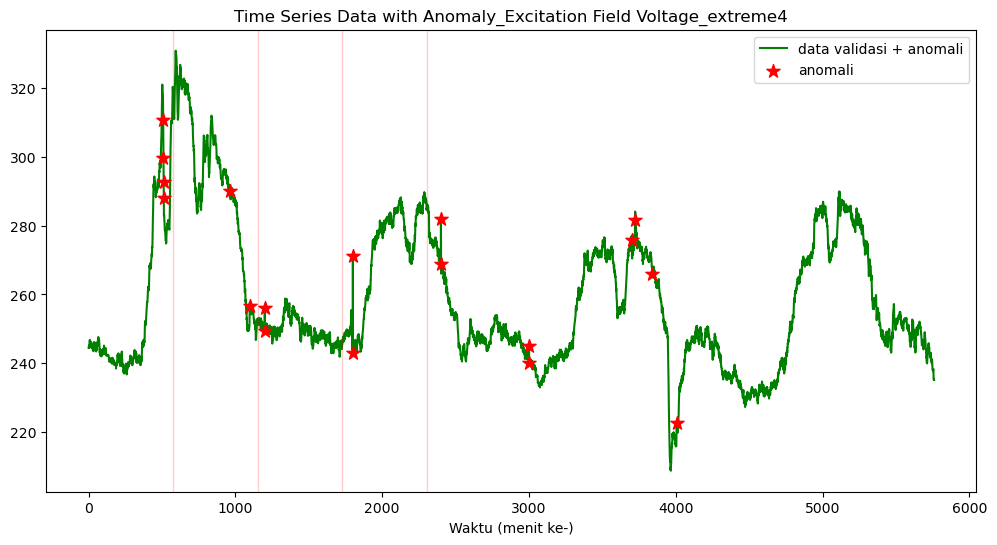

plot/Time Series Data with Anomaly_Excitation Field Voltage_extreme4.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  4
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:18:36.521539
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Power Factor _ extreme 4
| > Sensor Start Time:  2023-05-19 08:18:36.521539 



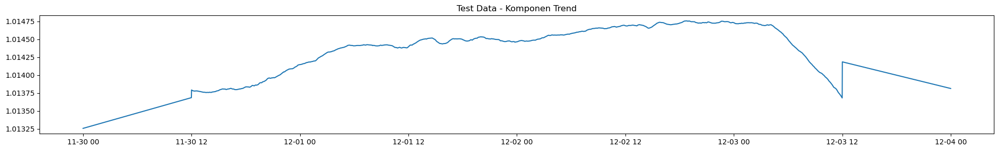

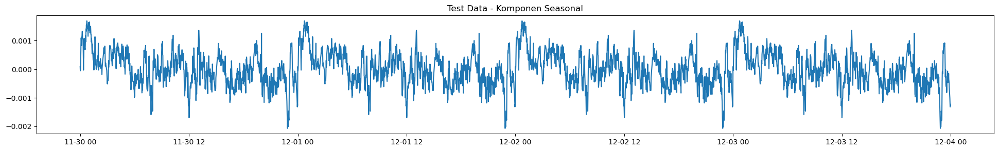

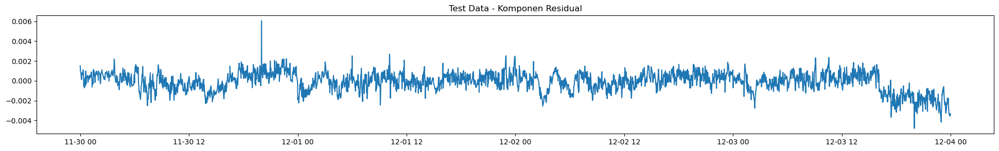

180/180 [==============================] - 1s 1ms/step


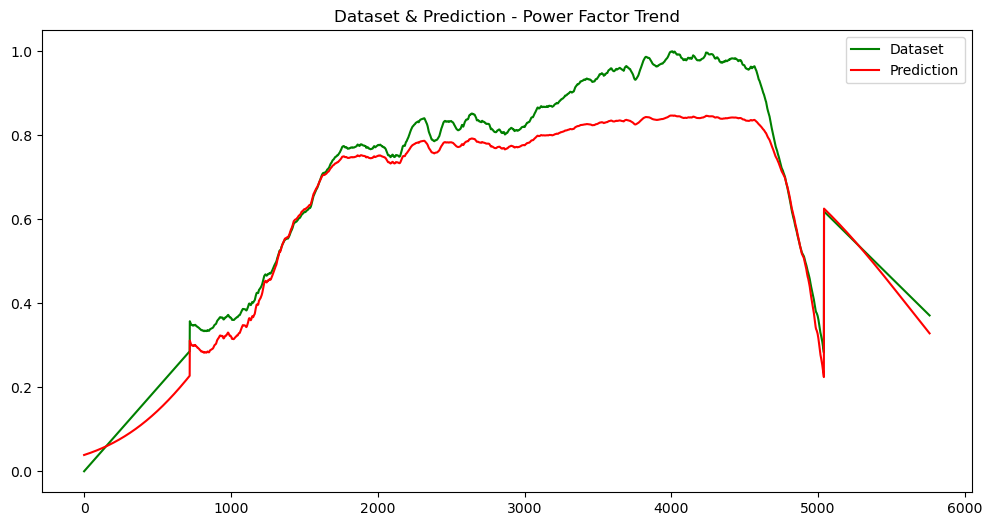

plot/Dataset & Prediction_Power Factor_Trend.jpg
180/180 [==============================] - 1s 981us/step


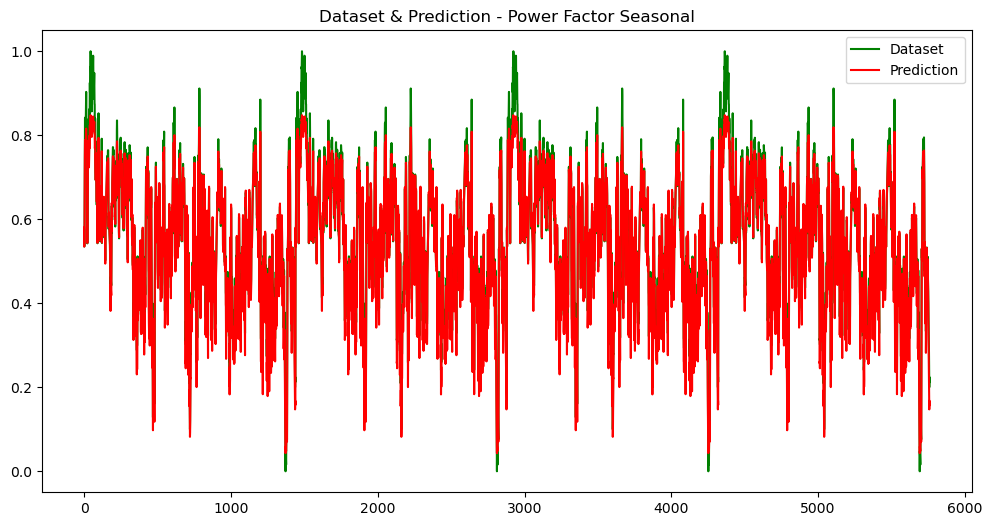

plot/Dataset & Prediction_Power Factor_Seasonal.jpg
180/180 [==============================] - 1s 927us/step


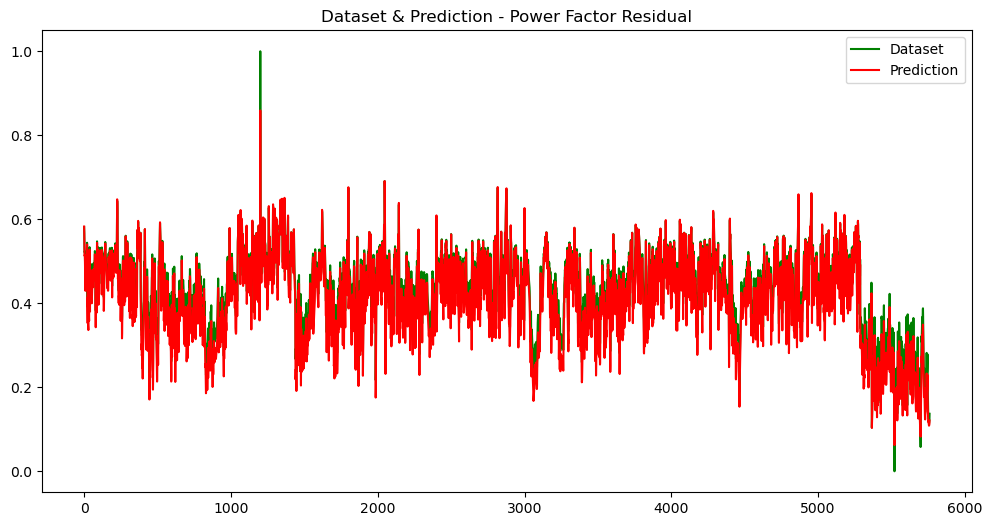

plot/Dataset & Prediction_Power Factor_Residual.jpg


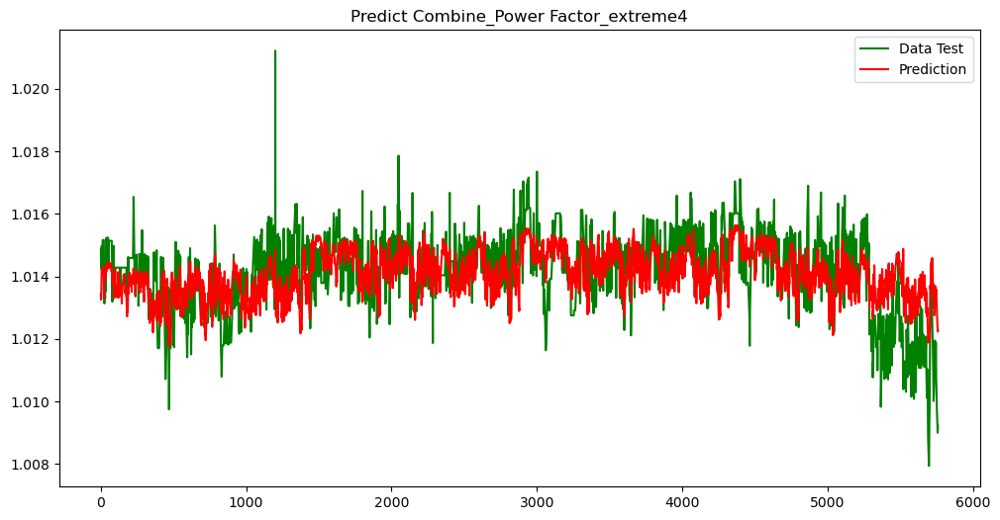

plot/Predict Combine_Power Factor_extreme4.jpg
| > errorsDF:  [0.00142756 0.00129179 0.00094974 ... 0.00323333 0.00319826 0.00304593]
| > RSME:  0.0009482583408250197
| > MSE:  8.991938809442191e-07
| > MAE:  0.0007424423481731568
Threshold:  0.0016341632407177013


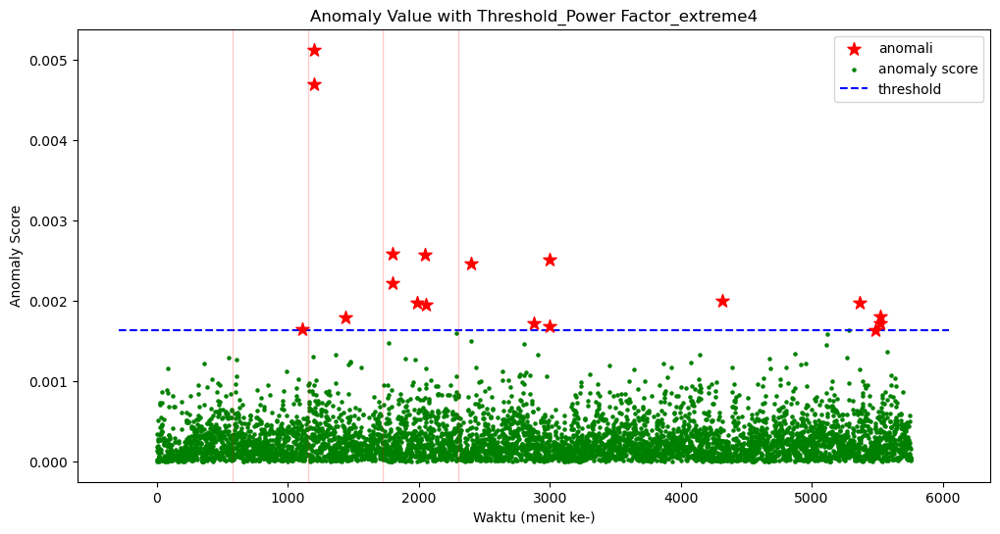

plot/Anomaly Value with Threshold_Power Factor_extreme4.jpg


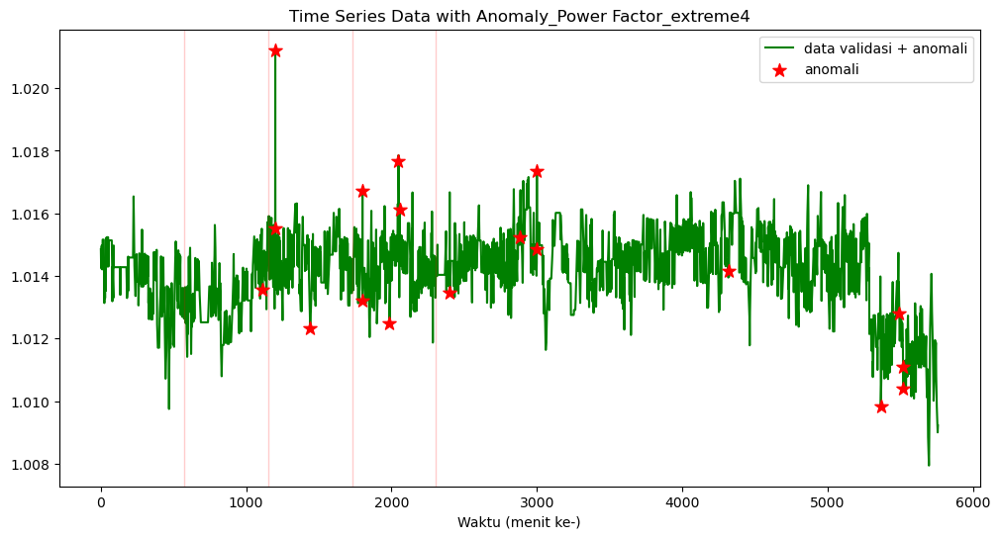

plot/Time Series Data with Anomaly_Power Factor_extreme4.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  4
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:18:44.035693
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Reactive Power _ extreme 4
| > Sensor Start Time:  2023-05-19 08:18:44.035693 



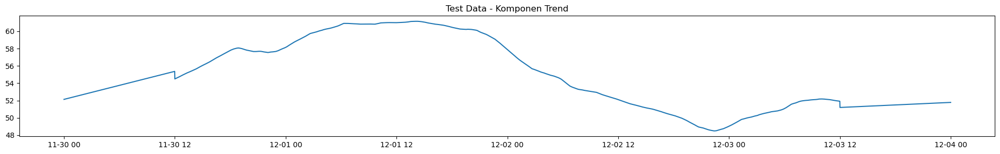

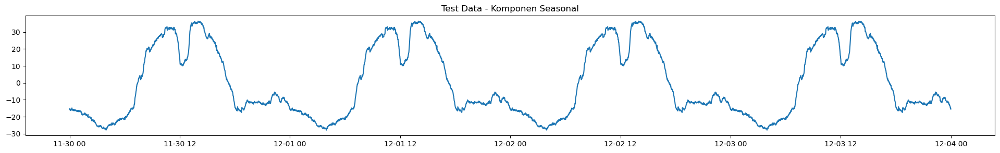

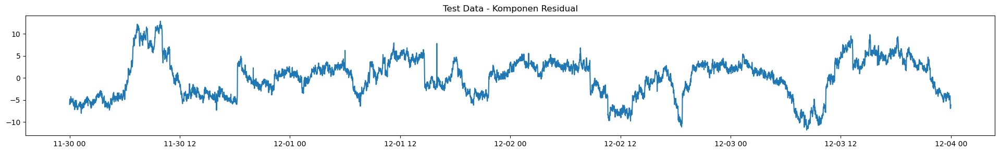

180/180 [==============================] - 1s 1ms/step


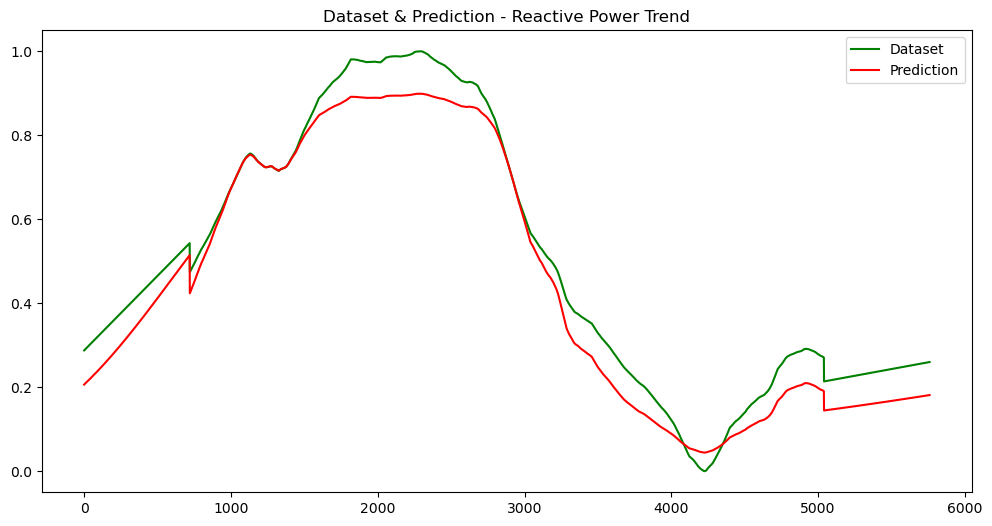

plot/Dataset & Prediction_Reactive Power_Trend.jpg
180/180 [==============================] - 1s 1ms/step


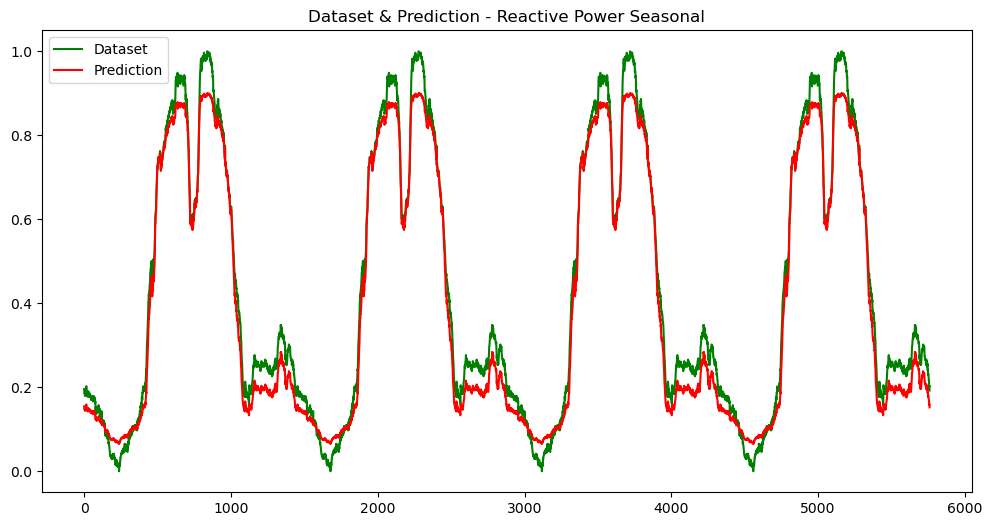

plot/Dataset & Prediction_Reactive Power_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


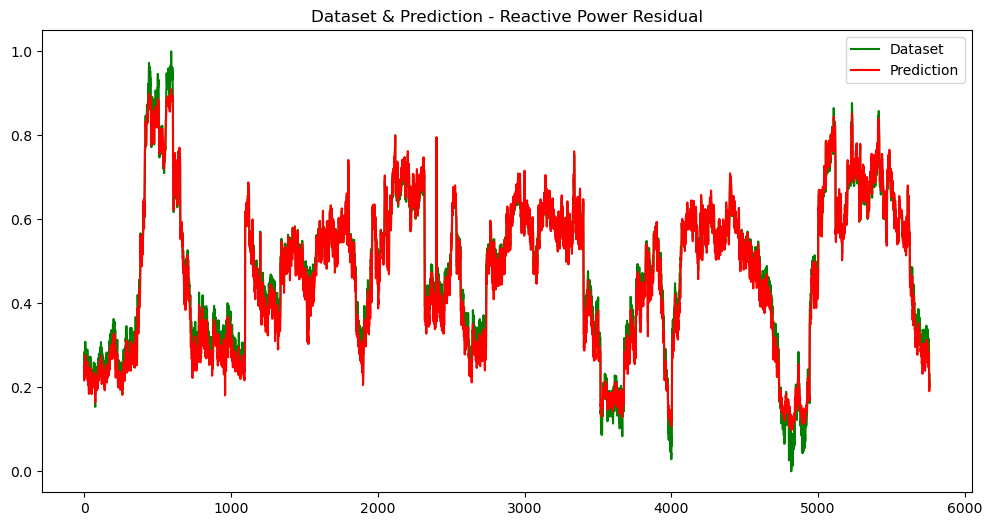

plot/Dataset & Prediction_Reactive Power_Residual.jpg


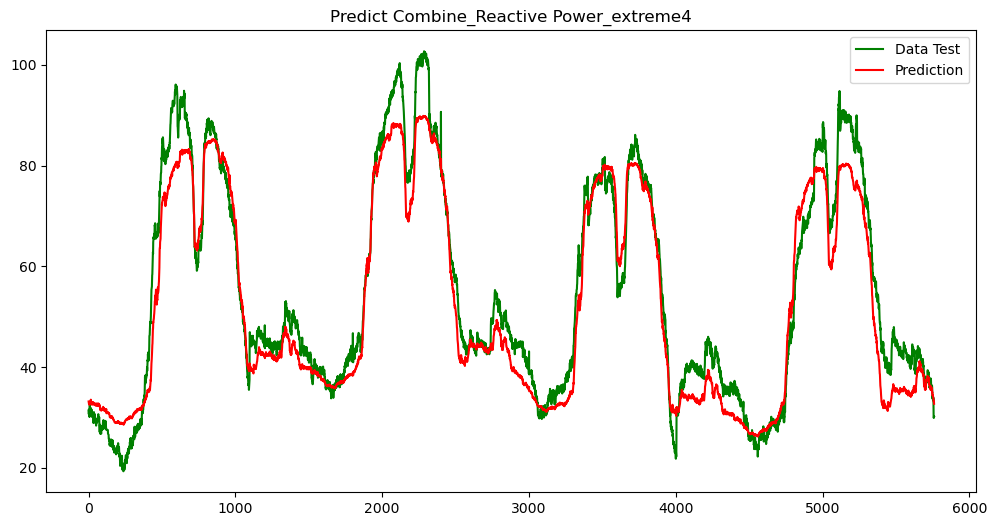

plot/Predict Combine_Reactive Power_extreme4.jpg
| > errorsDF:  [2.34307289 1.29626083 1.49040604 ... 3.18888283 3.06356239 2.55145836]
| > RSME:  5.502688627375598
| > MSE:  30.27958212984874
| > MAE:  4.458052180551274
Threshold:  3.6211637582790295


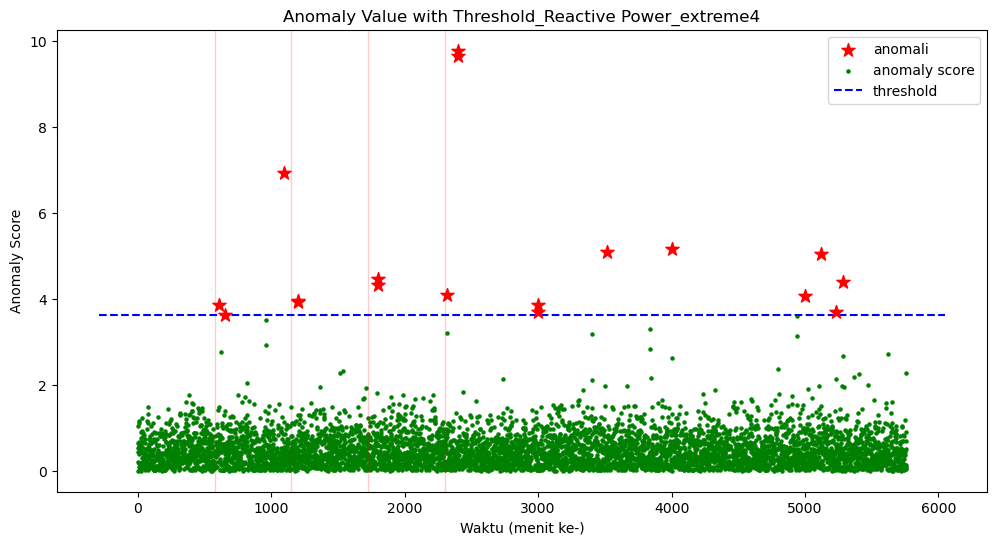

plot/Anomaly Value with Threshold_Reactive Power_extreme4.jpg


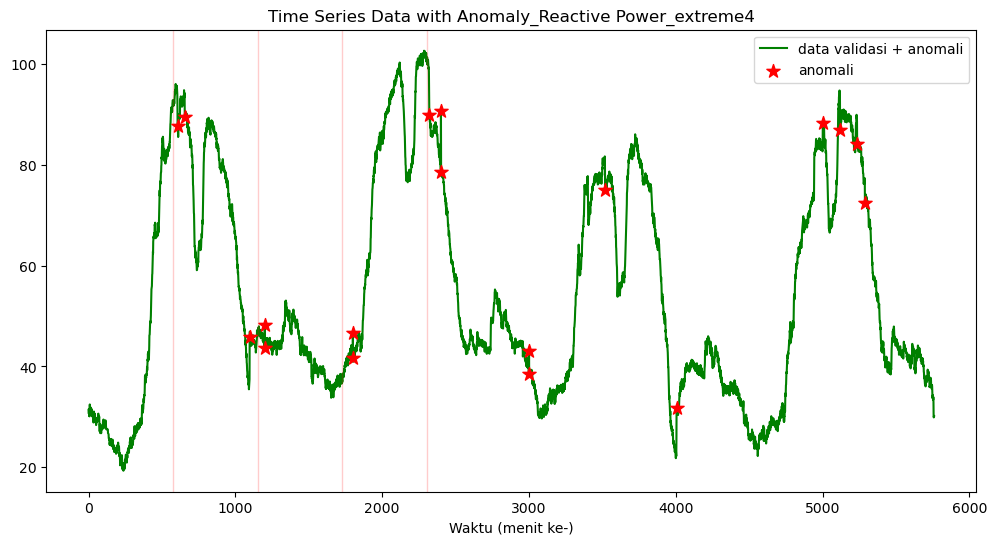

plot/Time Series Data with Anomaly_Reactive Power_extreme4.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  4
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:18:53.401471
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Generator Gross Capacity _ extreme 4
| > Sensor Start Time:  2023-05-19 08:18:53.401471 



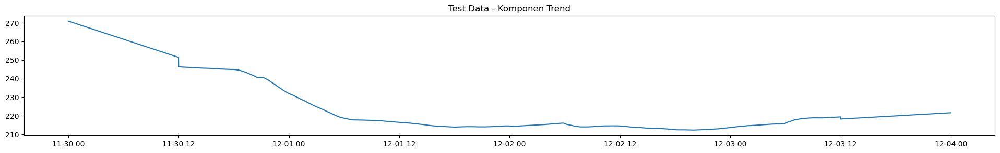

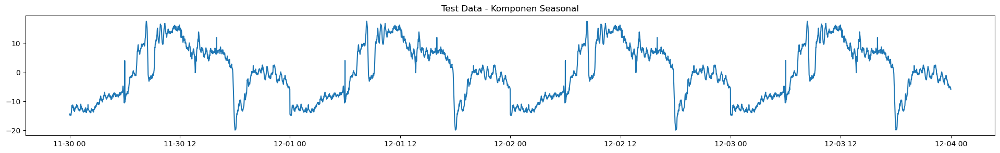

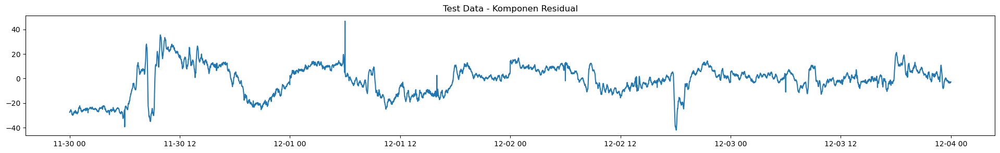

180/180 [==============================] - 1s 1ms/step


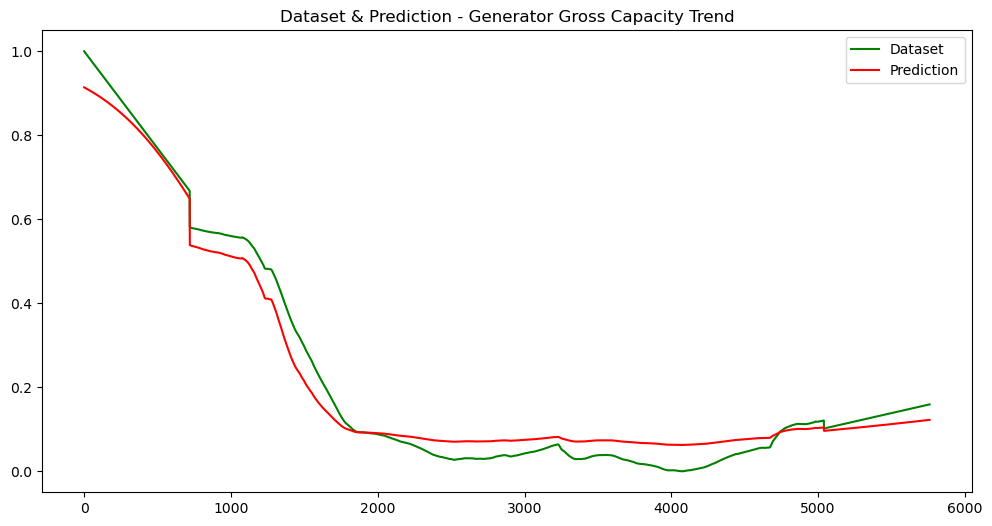

plot/Dataset & Prediction_Generator Gross Capacity_Trend.jpg
180/180 [==============================] - 1s 1ms/step


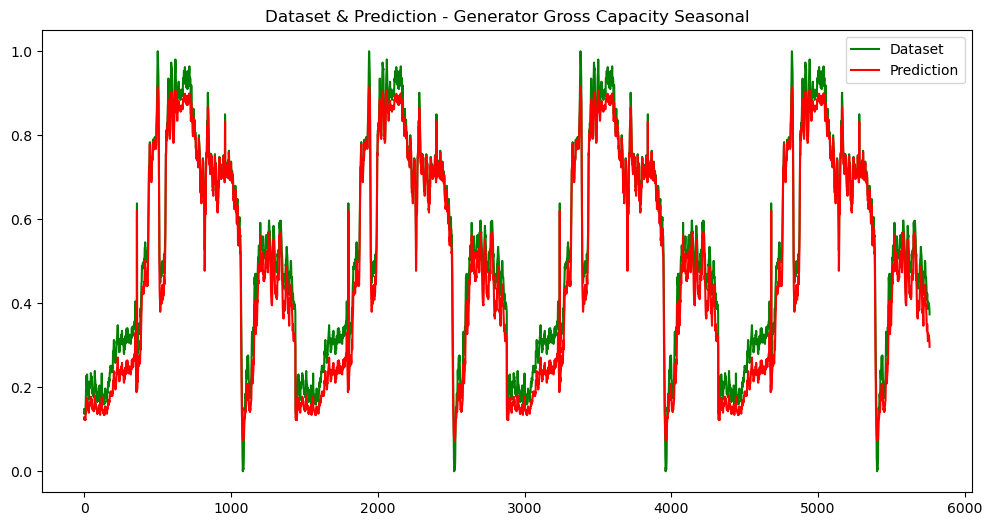

plot/Dataset & Prediction_Generator Gross Capacity_Seasonal.jpg
180/180 [==============================] - 1s 972us/step


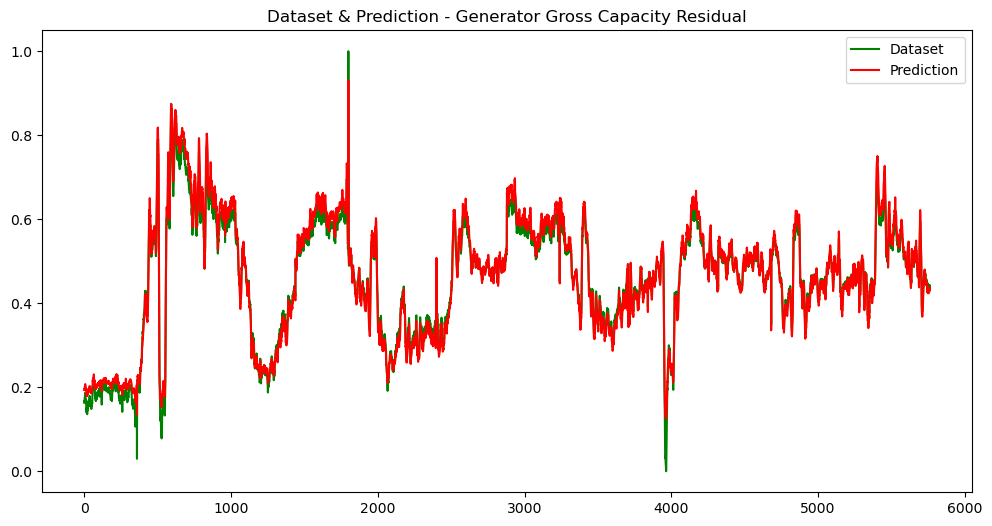

plot/Dataset & Prediction_Generator Gross Capacity_Residual.jpg


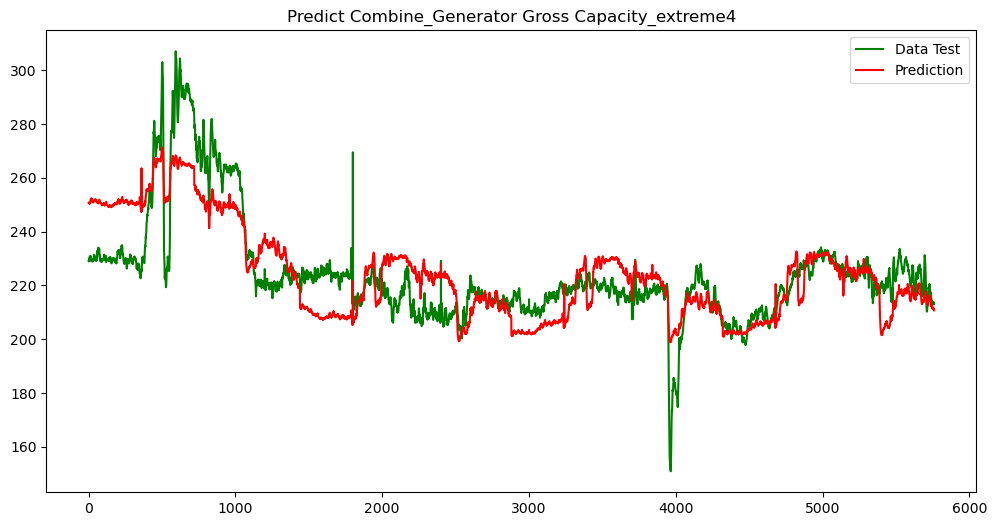

plot/Predict Combine_Generator Gross Capacity_extreme4.jpg
| > errorsDF:  [21.66516972 21.44571118 21.50514987 ...  2.3759317   1.86259745
  2.35202978]
| > RSME:  12.16504736789034
| > MSE:  147.9883774630157
| > MAE:  9.69079772517343
Threshold:  6.423971163909833


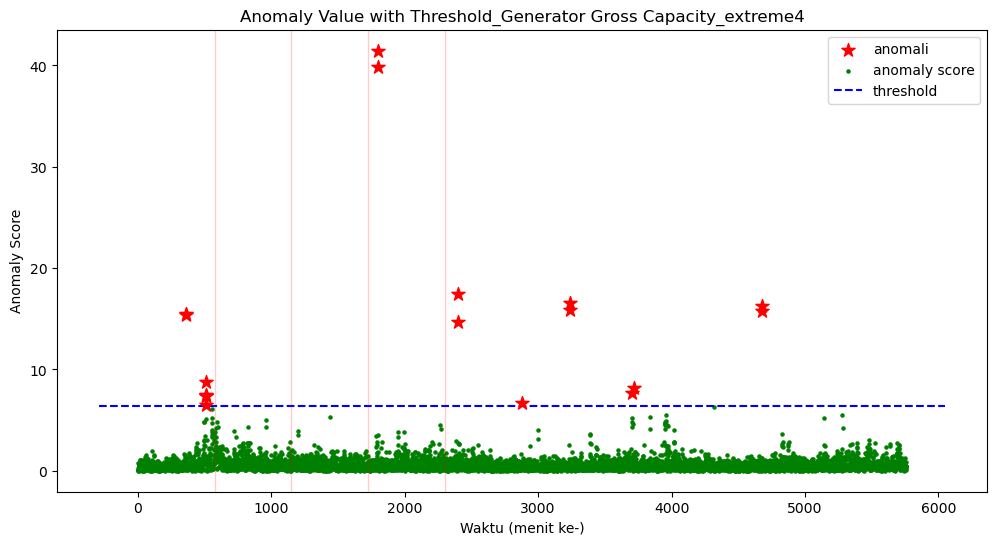

plot/Anomaly Value with Threshold_Generator Gross Capacity_extreme4.jpg


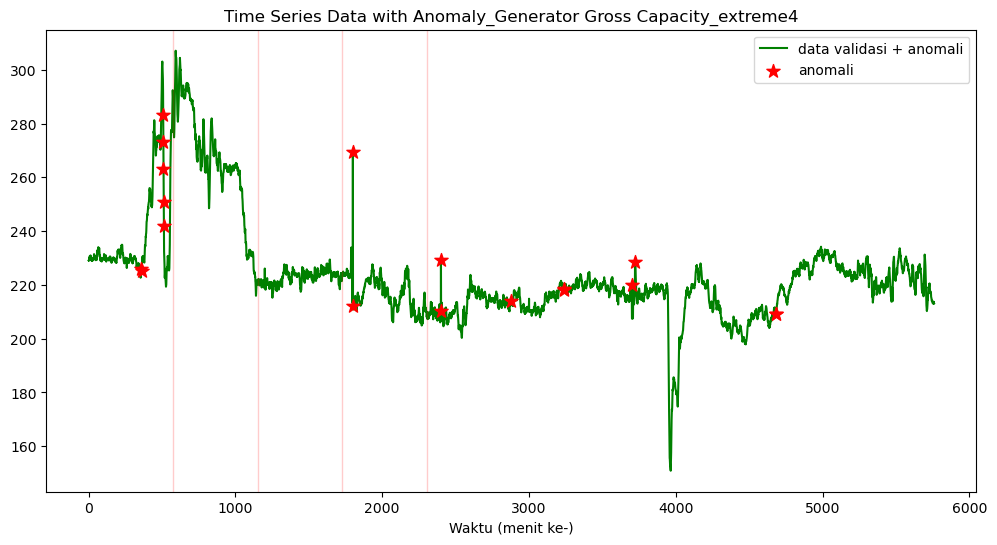

plot/Time Series Data with Anomaly_Generator Gross Capacity_extreme4.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  4
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:19:01.489267
| ========================================================================================== |



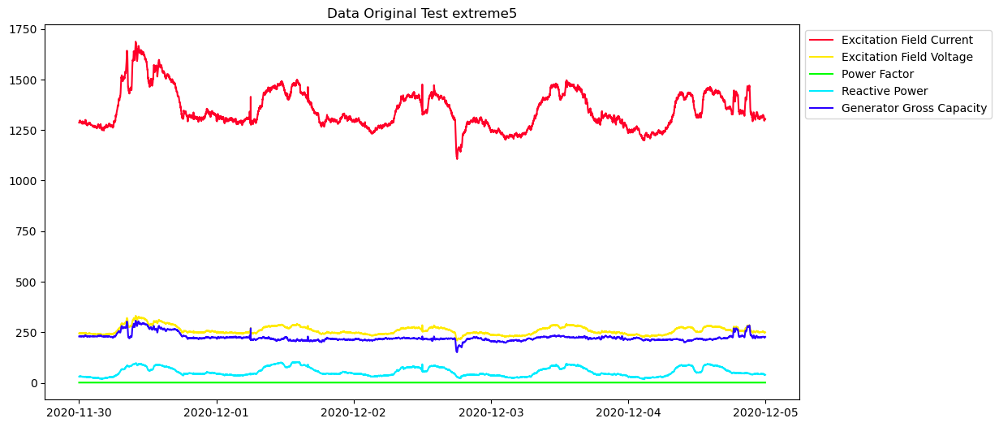


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 5
| > Sensor Start Time:  2023-05-19 08:19:04.171935 



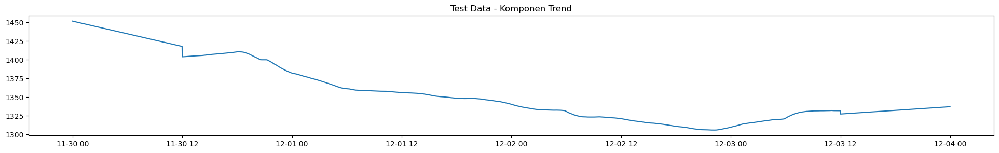

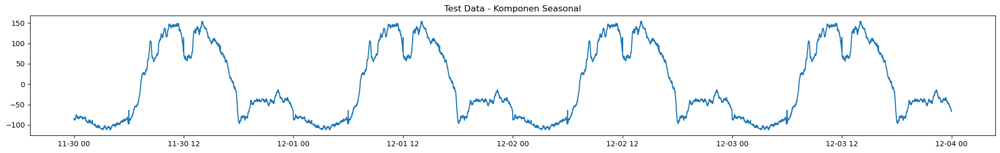

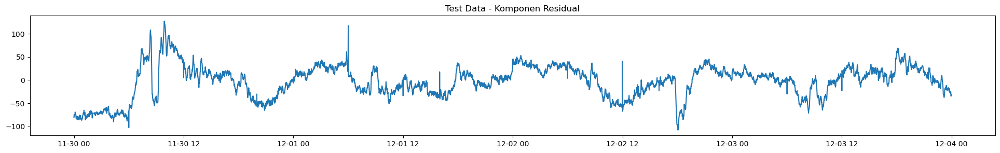

180/180 [==============================] - 1s 1ms/step


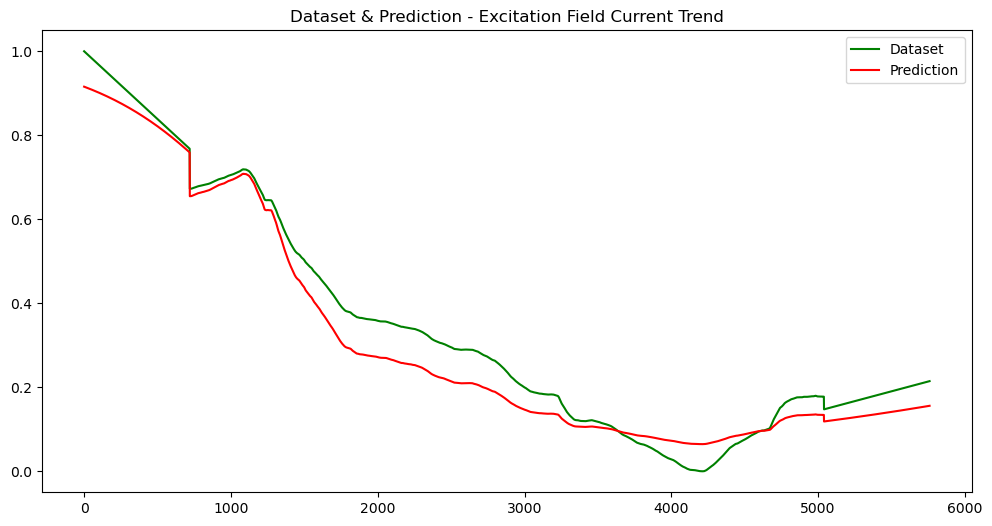

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 1ms/step


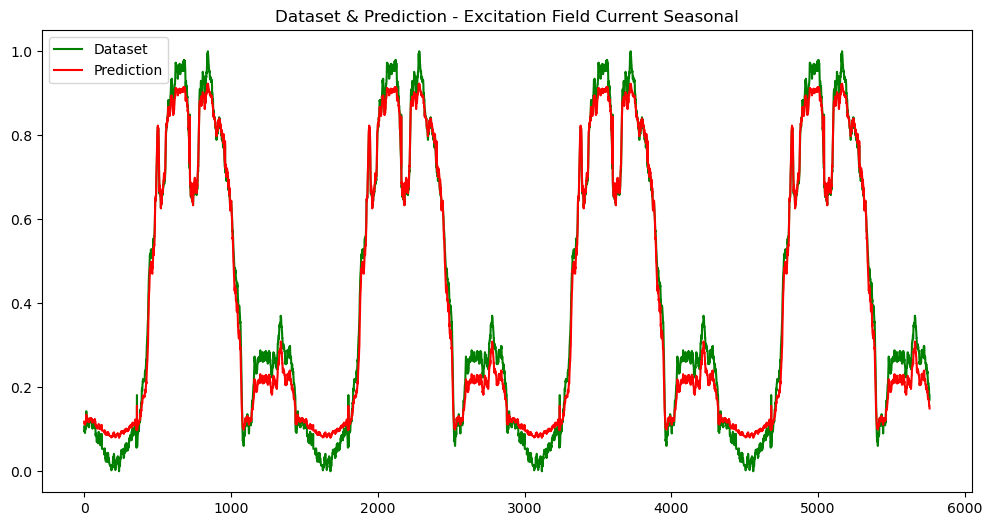

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 927us/step


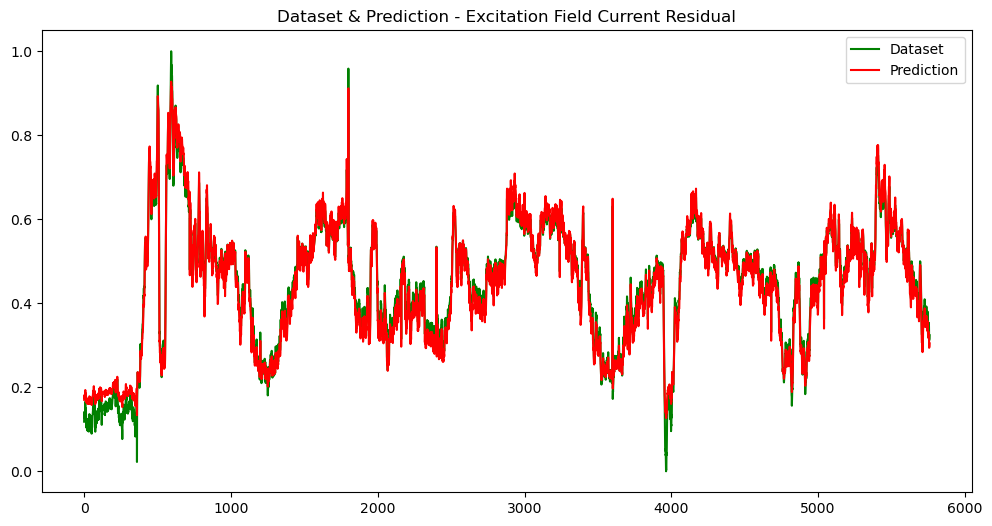

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


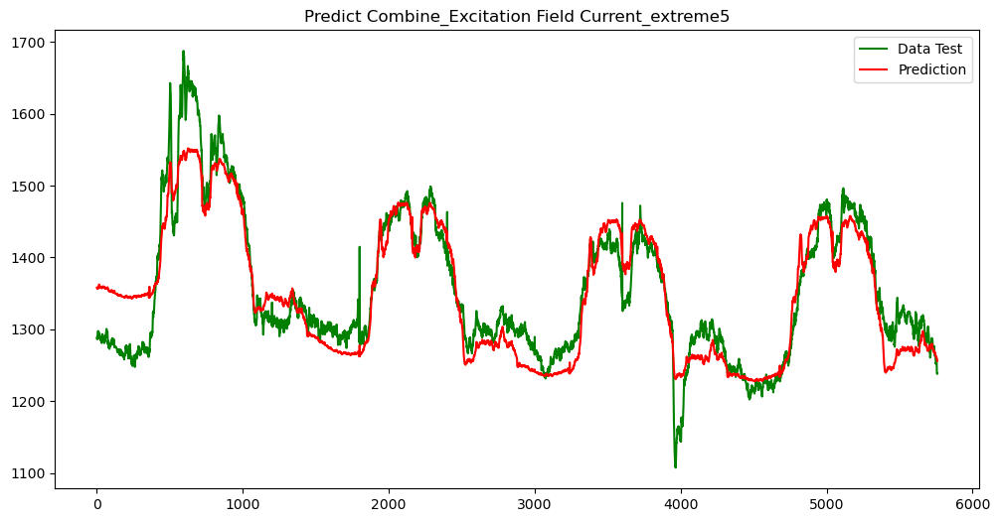

plot/Predict Combine_Excitation Field Current_extreme5.jpg
| > errorsDF:  [71.06410984 67.29052727 67.71692611 ... 18.68776699 18.43666085
 17.66002649]
| > RSME:  36.201824775639935
| > MSE:  1310.5721170861373
| > MAE:  28.40105498632043
Threshold:  22.25136570744801


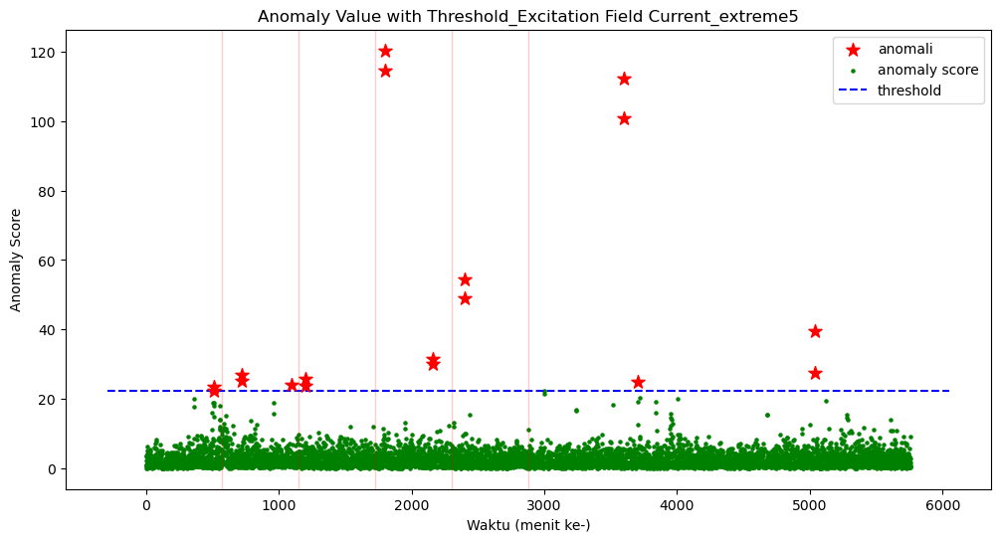

plot/Anomaly Value with Threshold_Excitation Field Current_extreme5.jpg


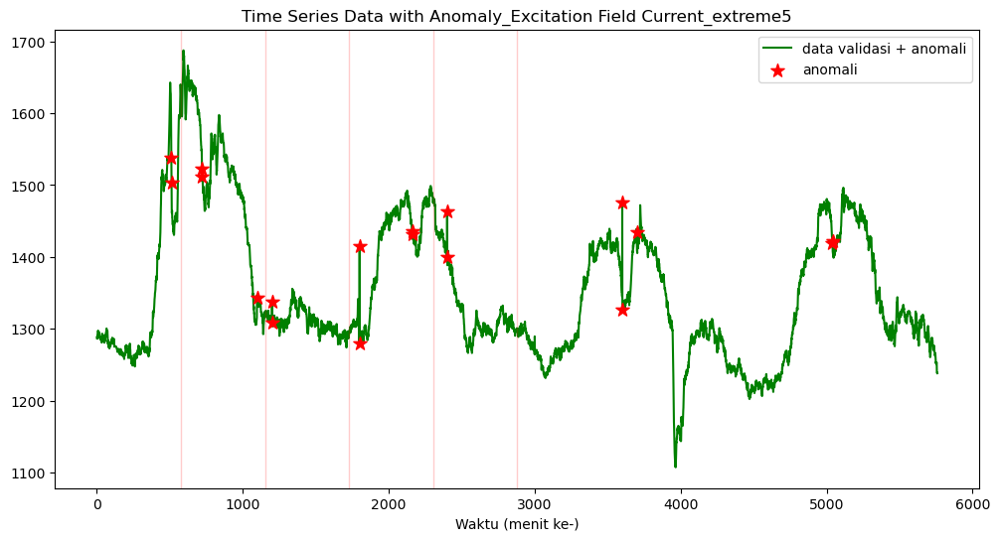

plot/Time Series Data with Anomaly_Excitation Field Current_extreme5.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  5
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:19:12.027990
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Excitation Field Voltage _ extreme 5
| > Sensor Start Time:  2023-05-19 08:19:12.027990 



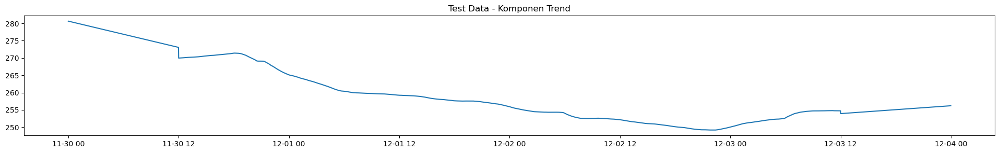

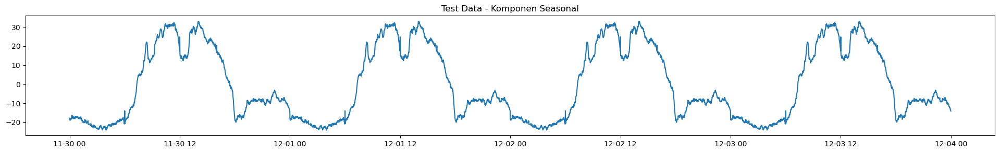

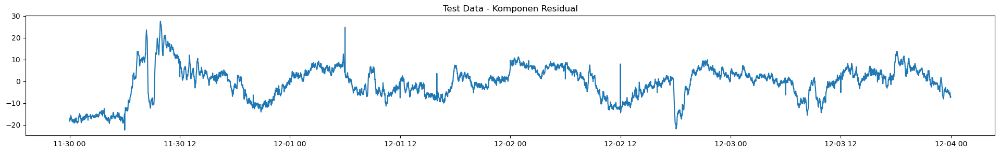

180/180 [==============================] - 1s 1ms/step


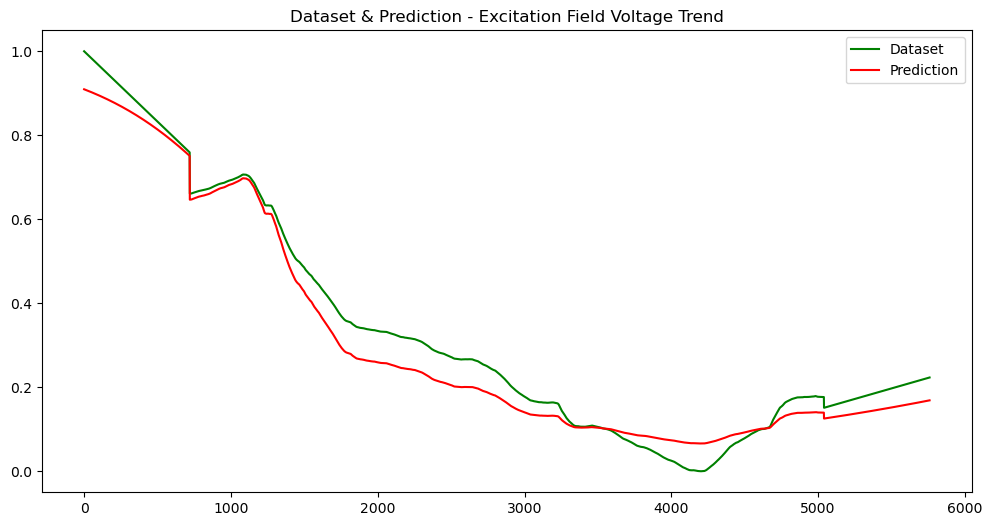

plot/Dataset & Prediction_Excitation Field Voltage_Trend.jpg
180/180 [==============================] - 1s 1ms/step


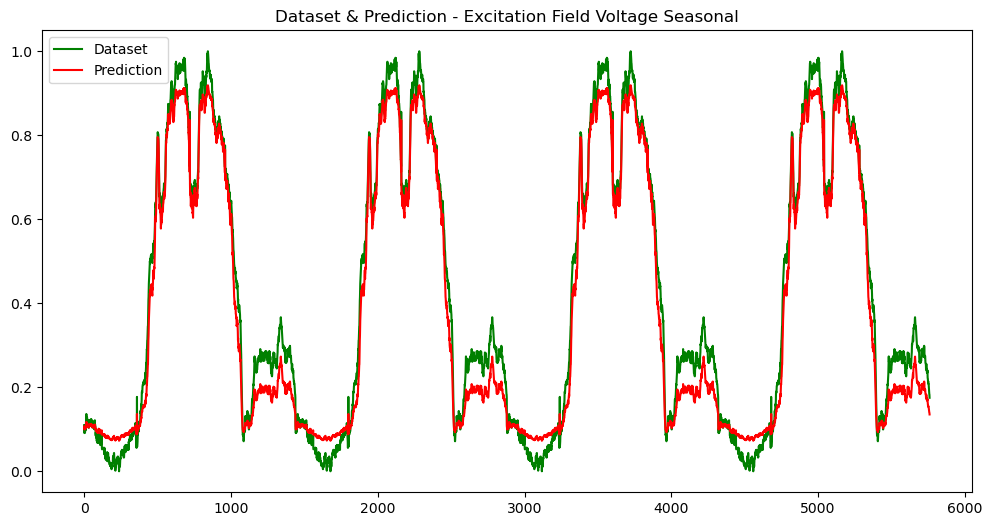

plot/Dataset & Prediction_Excitation Field Voltage_Seasonal.jpg
180/180 [==============================] - 1s 2ms/step


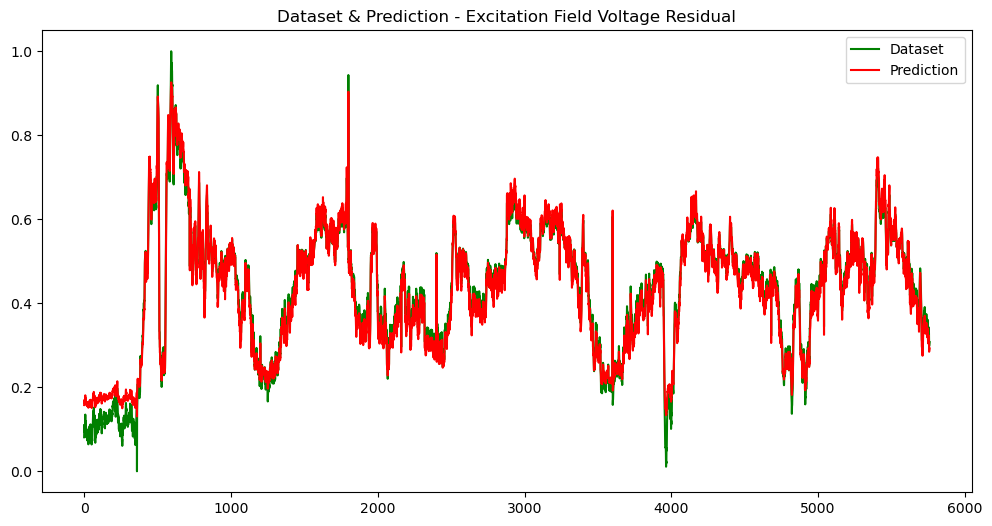

plot/Dataset & Prediction_Excitation Field Voltage_Residual.jpg


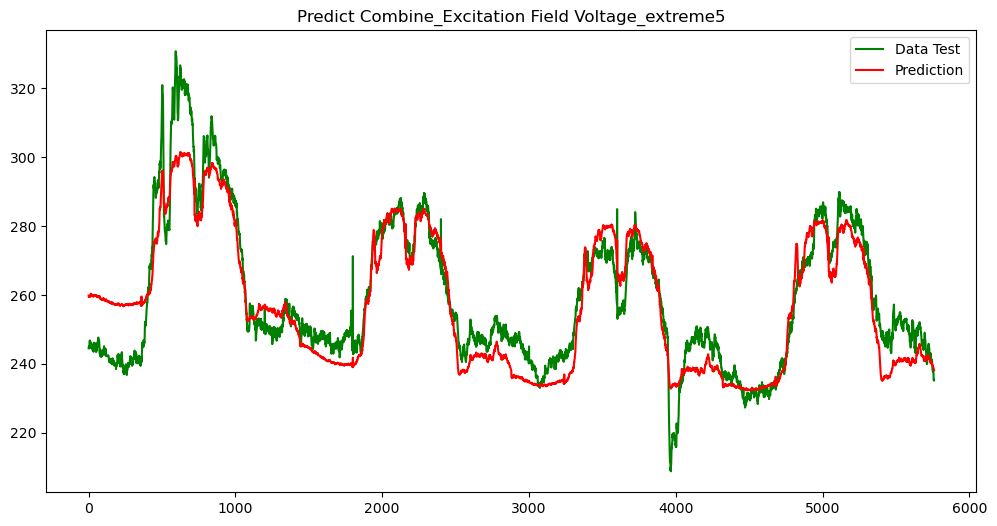

plot/Predict Combine_Excitation Field Voltage_extreme5.jpg
| > errorsDF:  [15.3030148  14.64216994 14.50971418 ...  3.05434988  2.94033627
  3.01385684]
| > RSME:  8.037781471689298
| > MSE:  64.60593098663179
| > MAE:  6.42685955873548
Threshold:  4.468683908286935


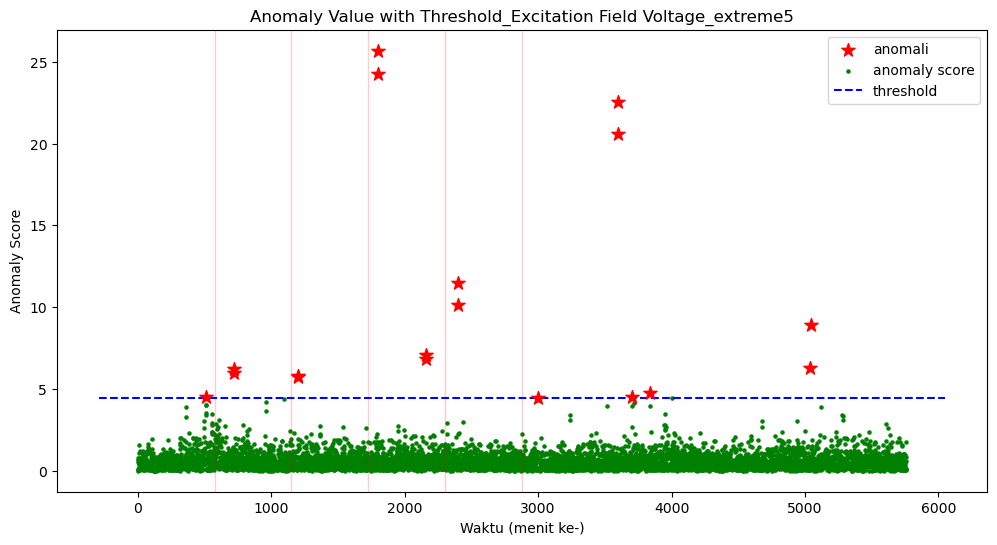

plot/Anomaly Value with Threshold_Excitation Field Voltage_extreme5.jpg


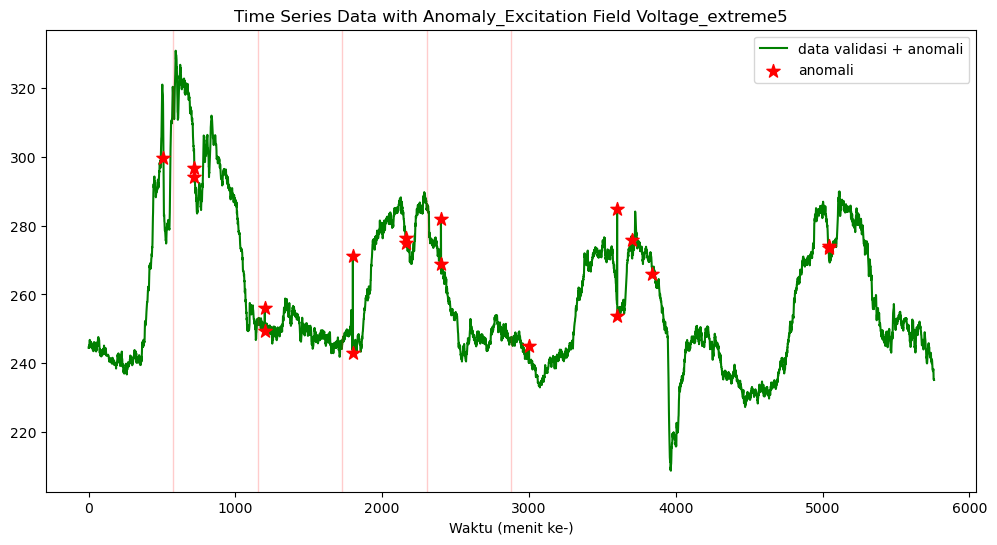

plot/Time Series Data with Anomaly_Excitation Field Voltage_extreme5.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  5
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:19:20.661157
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Power Factor _ extreme 5
| > Sensor Start Time:  2023-05-19 08:19:20.661157 



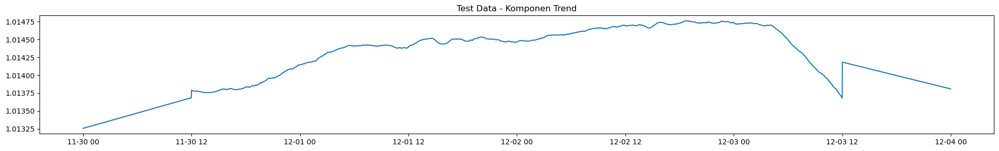

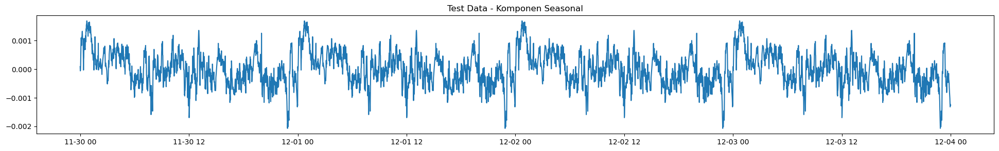

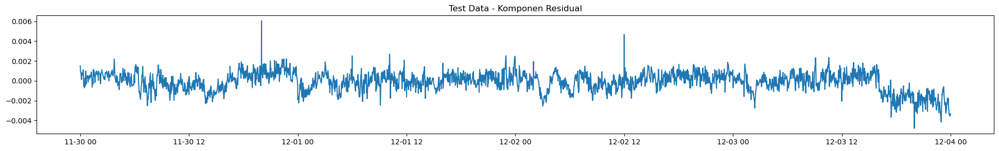

180/180 [==============================] - 2s 2ms/step


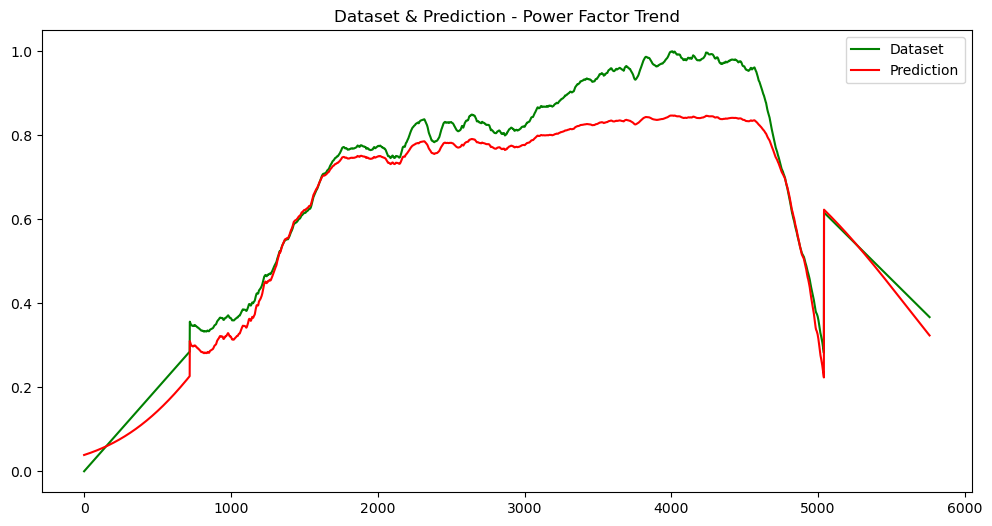

plot/Dataset & Prediction_Power Factor_Trend.jpg
180/180 [==============================] - 1s 1ms/step


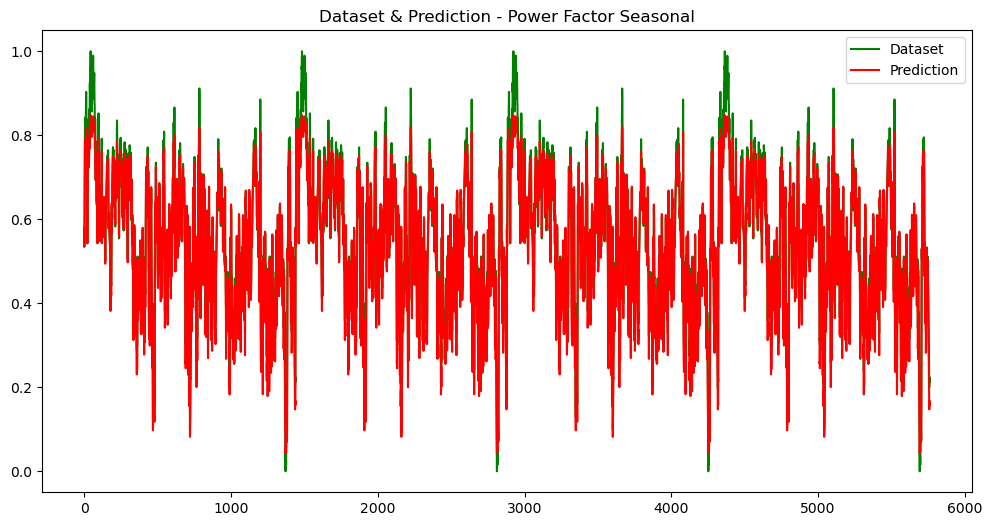

plot/Dataset & Prediction_Power Factor_Seasonal.jpg
180/180 [==============================] - 1s 2ms/step


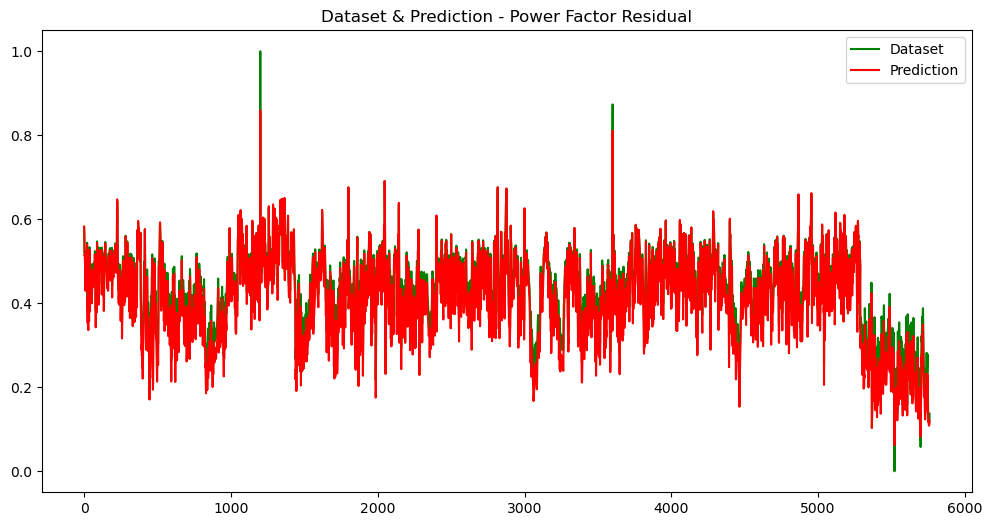

plot/Dataset & Prediction_Power Factor_Residual.jpg


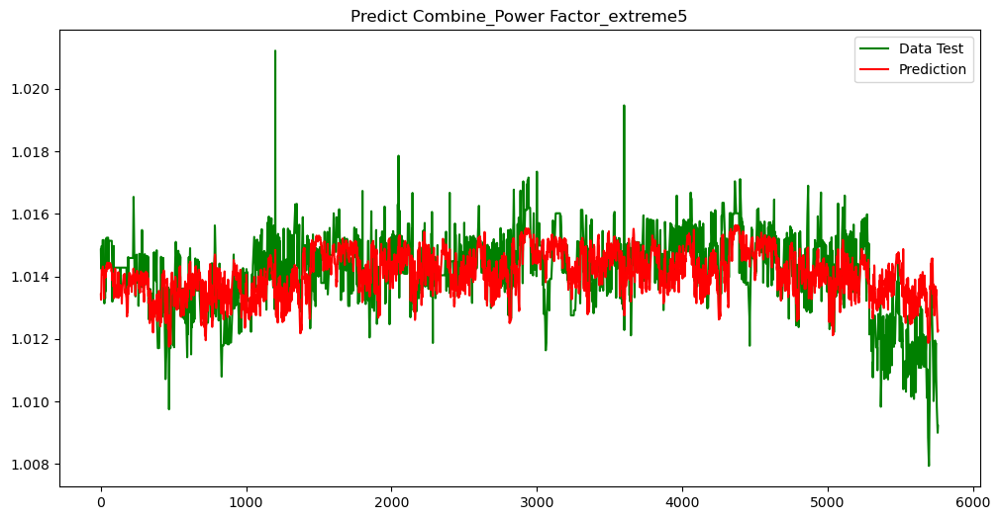

plot/Predict Combine_Power Factor_extreme5.jpg
| > errorsDF:  [0.00142893 0.00129332 0.00095103 ... 0.00322691 0.00319174 0.00303952]
| > RSME:  0.0009502113918301093
| > MSE:  9.029016891637136e-07
| > MAE:  0.0007433666135909814
Threshold:  0.0017972596495882682


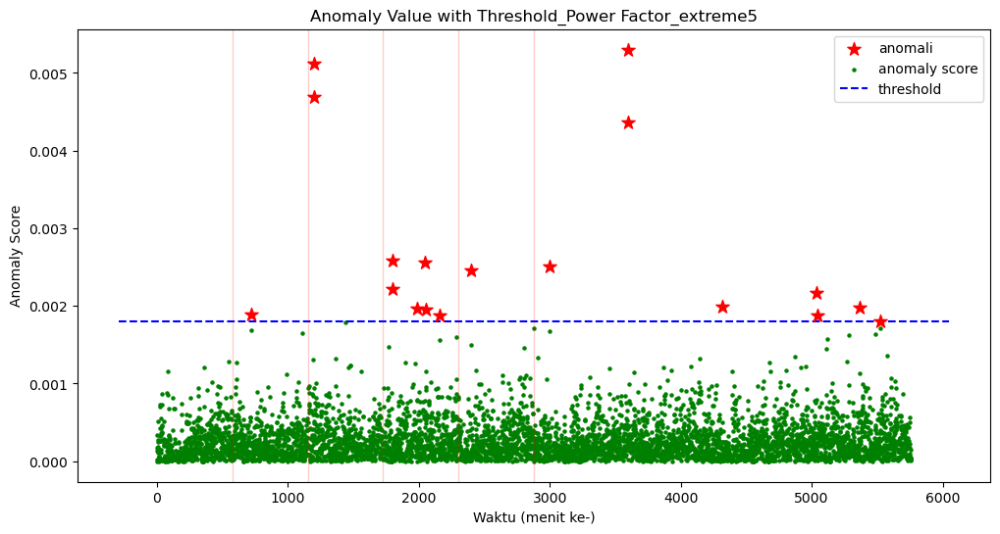

plot/Anomaly Value with Threshold_Power Factor_extreme5.jpg


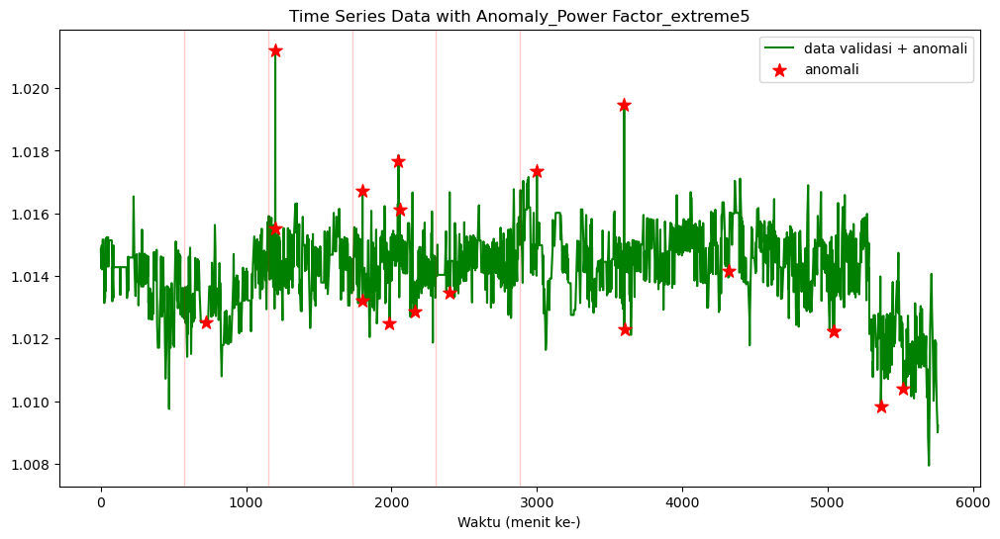

plot/Time Series Data with Anomaly_Power Factor_extreme5.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  5
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:19:31.634259
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Reactive Power _ extreme 5
| > Sensor Start Time:  2023-05-19 08:19:31.635221 



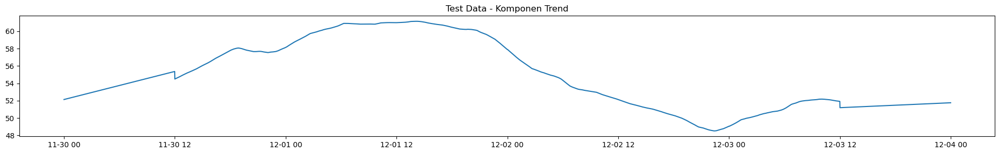

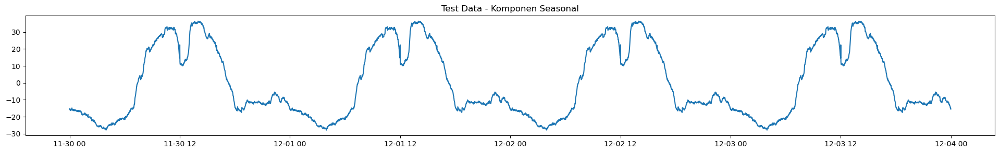

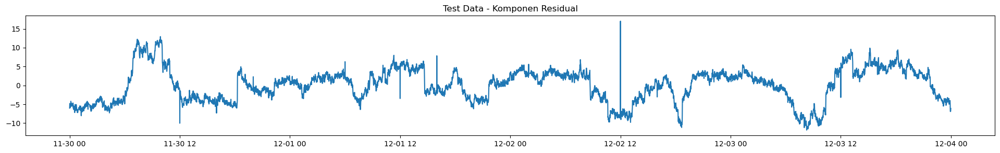

180/180 [==============================] - 1s 1ms/step


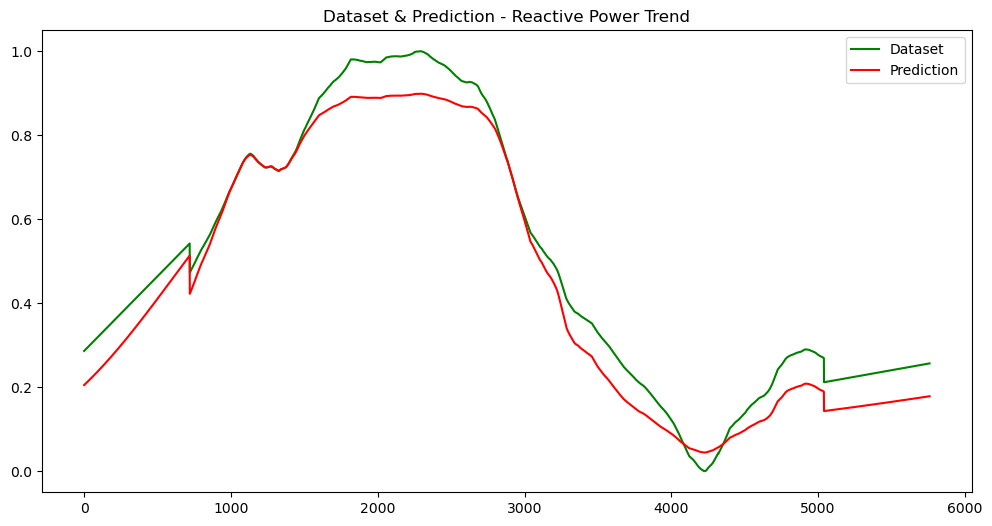

plot/Dataset & Prediction_Reactive Power_Trend.jpg
180/180 [==============================] - 1s 1ms/step


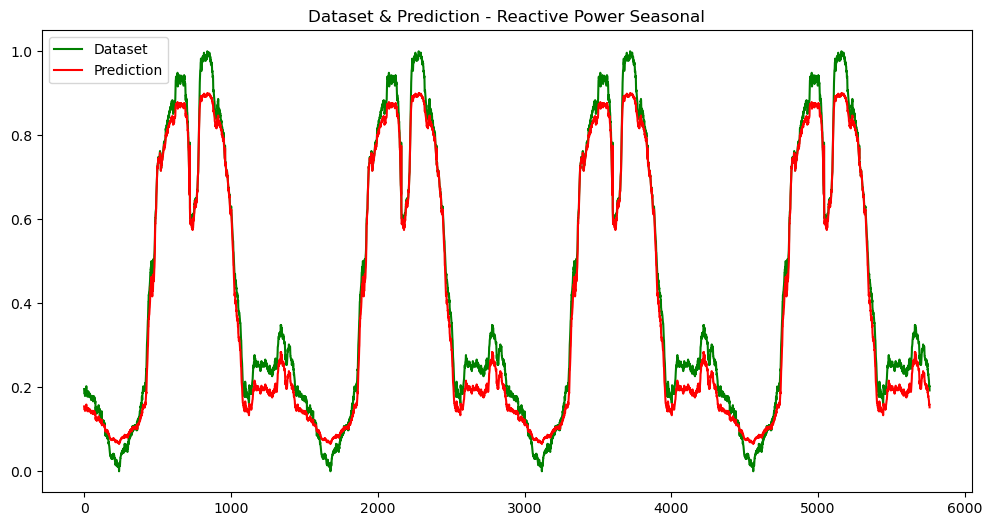

plot/Dataset & Prediction_Reactive Power_Seasonal.jpg
180/180 [==============================] - 1s 978us/step


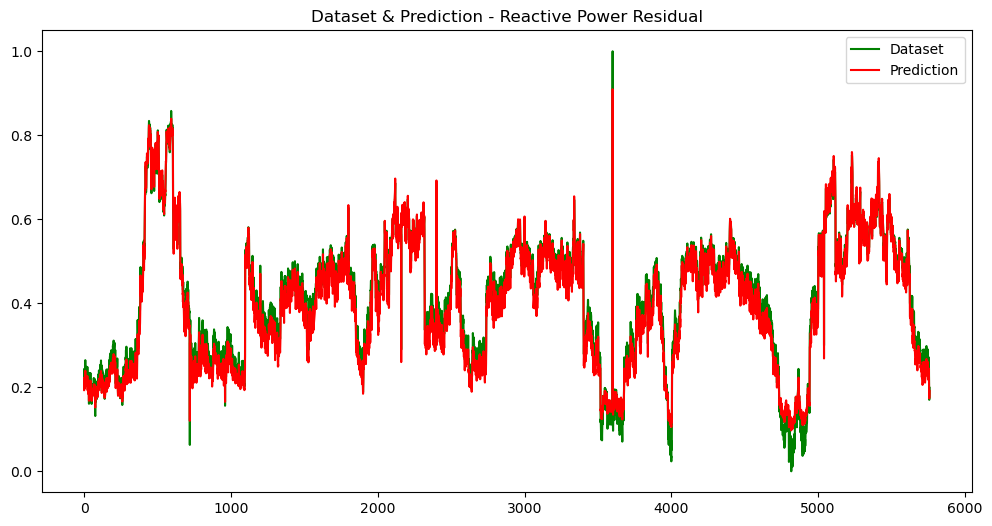

plot/Dataset & Prediction_Reactive Power_Residual.jpg


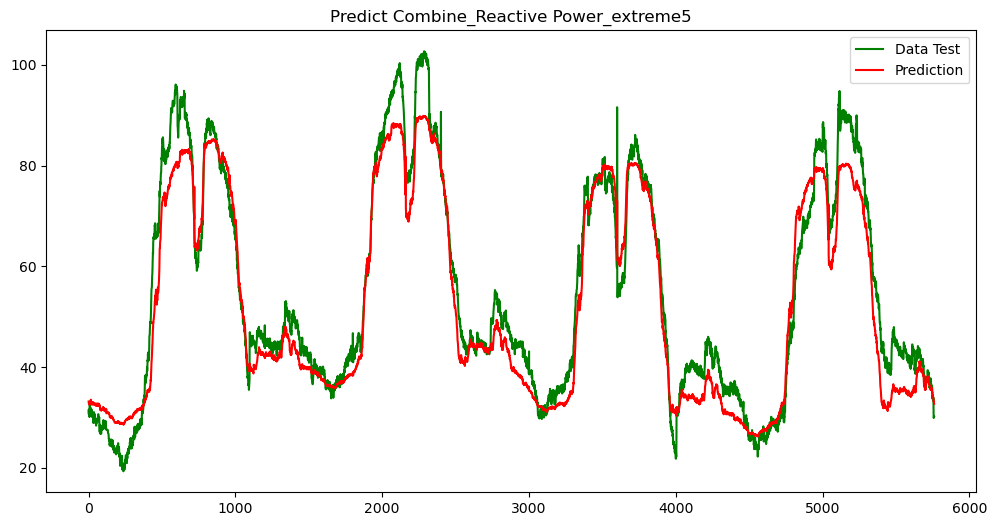

plot/Predict Combine_Reactive Power_extreme5.jpg
| > errorsDF:  [2.33841896 1.29159927 1.48572731 ... 3.16932869 3.04400826 2.53173828]
| > RSME:  5.507970689378472
| > MSE:  30.33774111505236
| > MAE:  4.4591390536900315
Threshold:  4.090176876131882


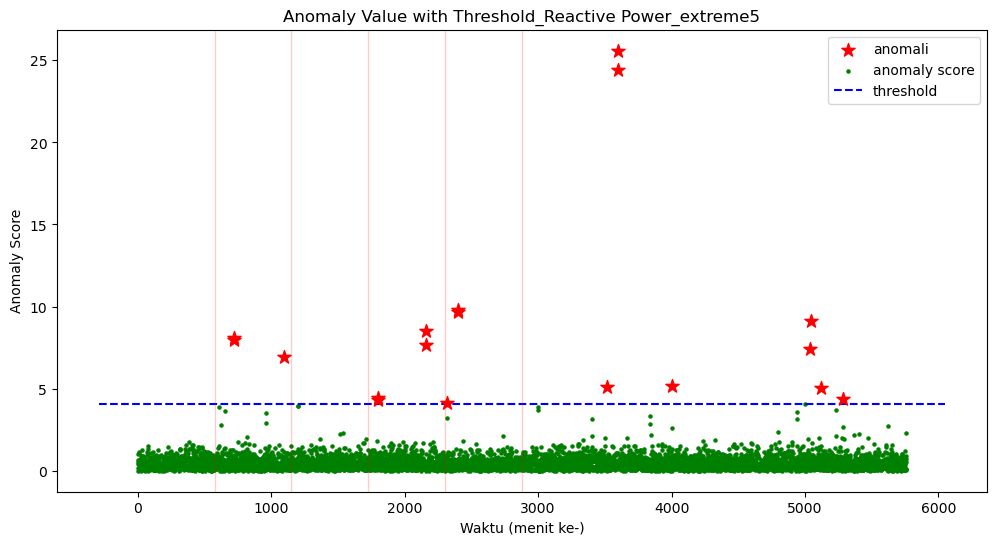

plot/Anomaly Value with Threshold_Reactive Power_extreme5.jpg


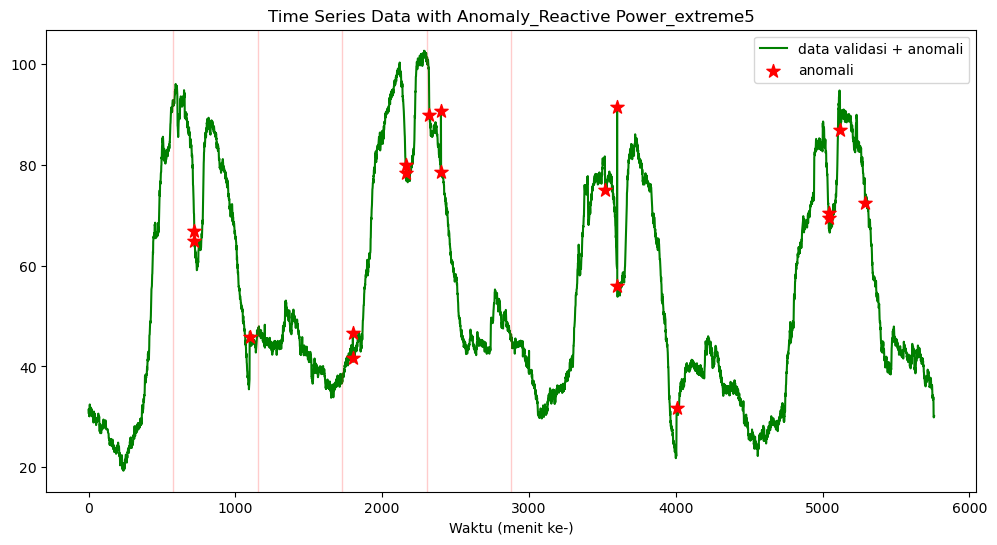

plot/Time Series Data with Anomaly_Reactive Power_extreme5.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  5
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:19:38.989148
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Generator Gross Capacity _ extreme 5
| > Sensor Start Time:  2023-05-19 08:19:38.989148 



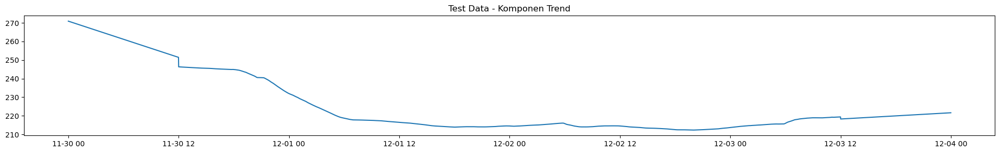

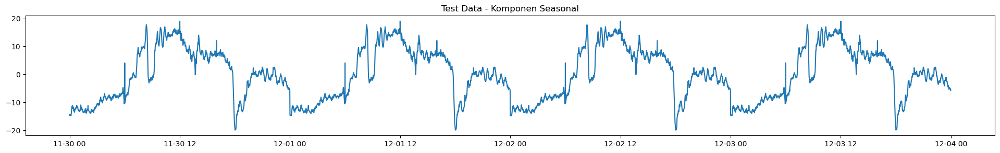

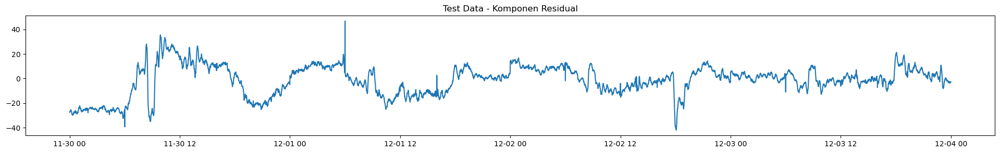

180/180 [==============================] - 1s 1ms/step


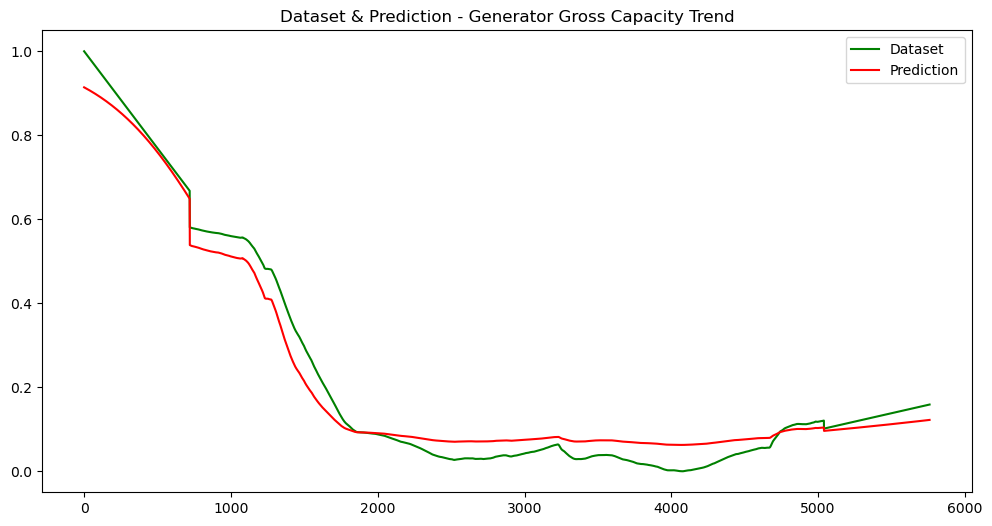

plot/Dataset & Prediction_Generator Gross Capacity_Trend.jpg
180/180 [==============================] - 1s 1ms/step


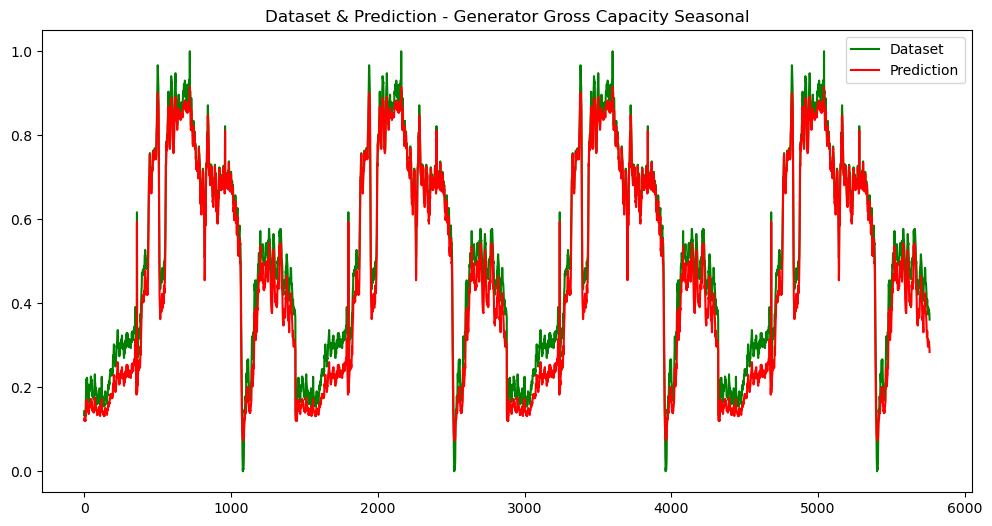

plot/Dataset & Prediction_Generator Gross Capacity_Seasonal.jpg
180/180 [==============================] - 1s 966us/step


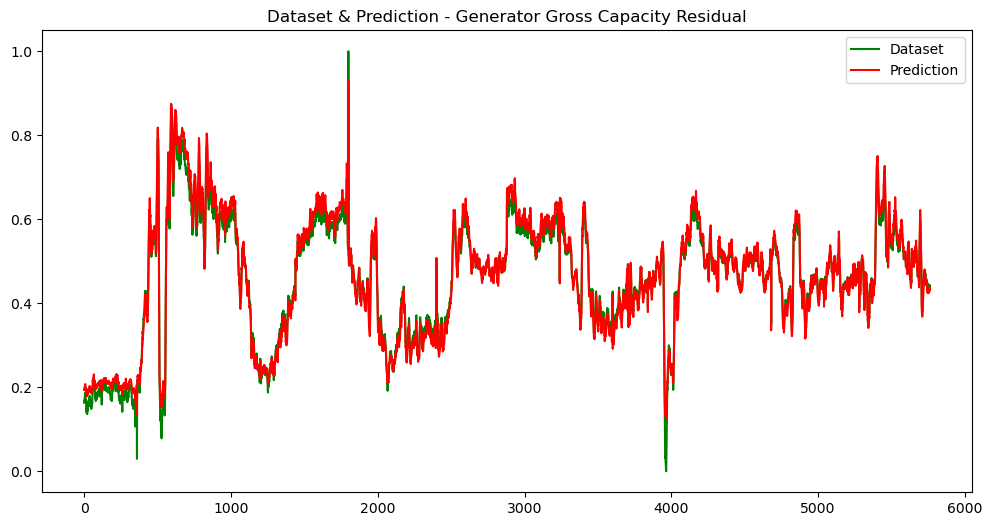

plot/Dataset & Prediction_Generator Gross Capacity_Residual.jpg


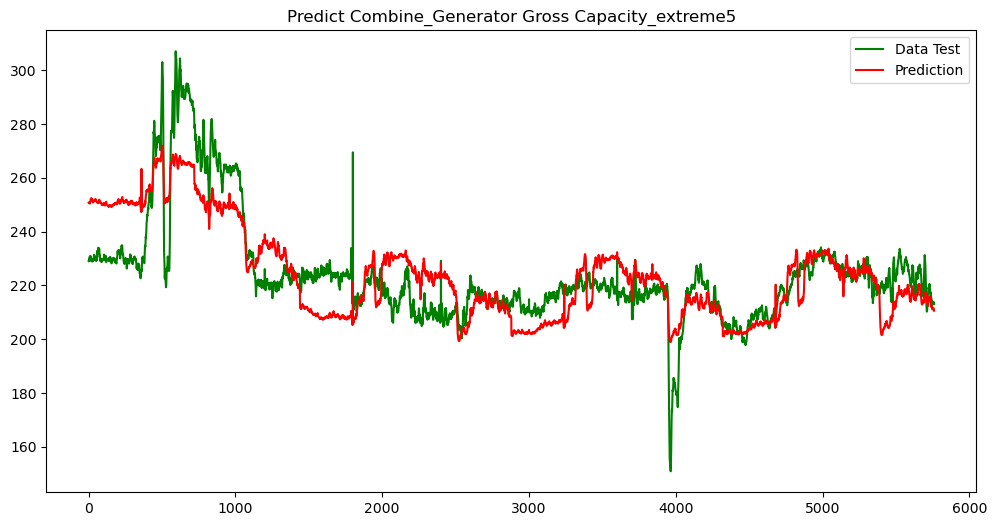

plot/Predict Combine_Generator Gross Capacity_extreme5.jpg
| > errorsDF:  [21.73627663 21.51961808 21.58000759 ...  2.50151916  1.98240565
  2.45907972]
| > RSME:  12.166501095649929
| > MSE:  148.02374891045093
| > MAE:  9.720678647792399
Threshold:  6.994332542485816


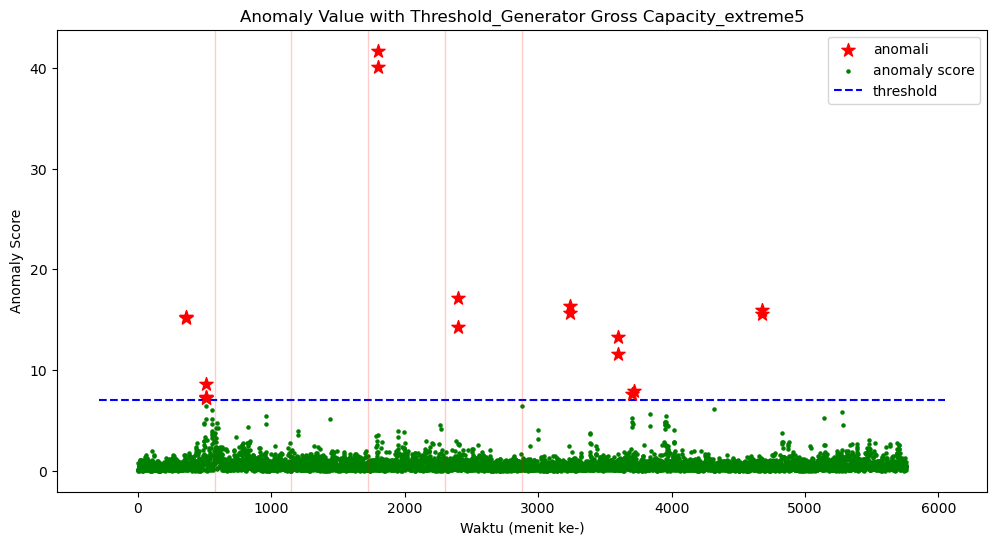

plot/Anomaly Value with Threshold_Generator Gross Capacity_extreme5.jpg


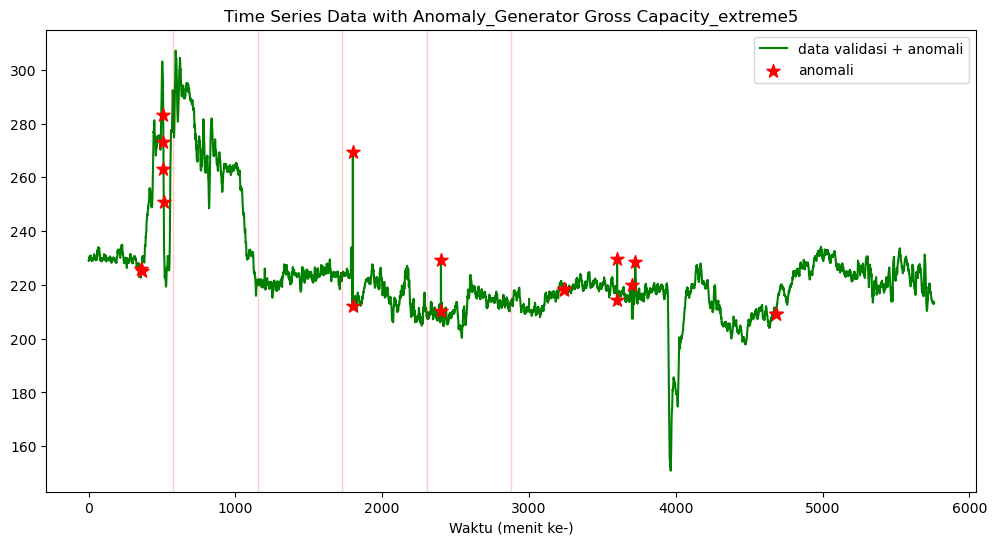

plot/Time Series Data with Anomaly_Generator Gross Capacity_extreme5.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  5
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:19:46.561507
| ========================================================================================== |



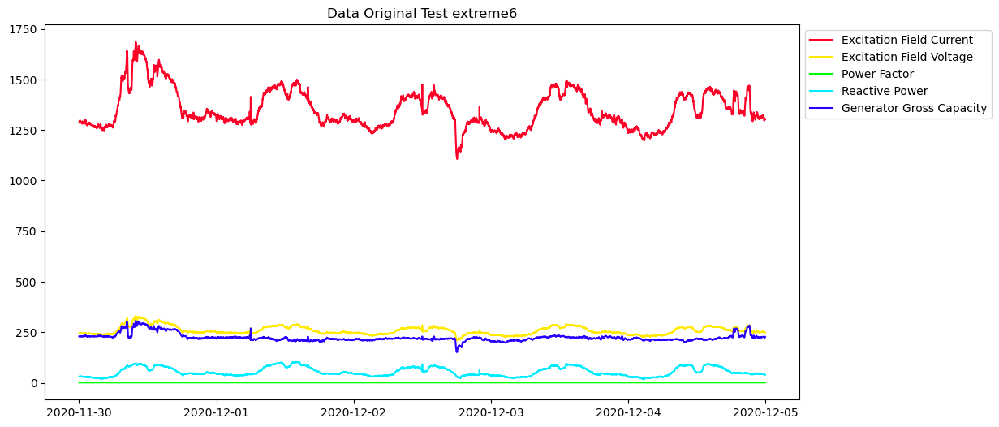


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 6
| > Sensor Start Time:  2023-05-19 08:19:48.788562 



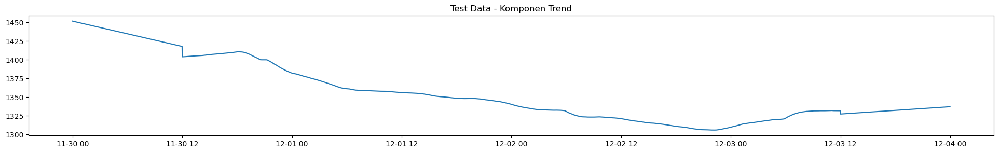

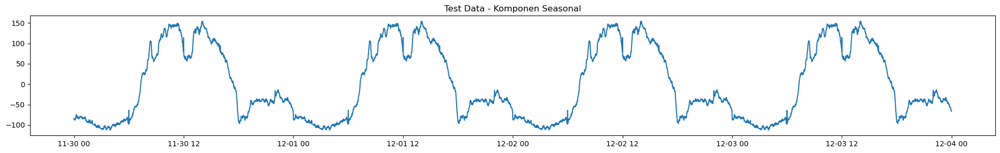

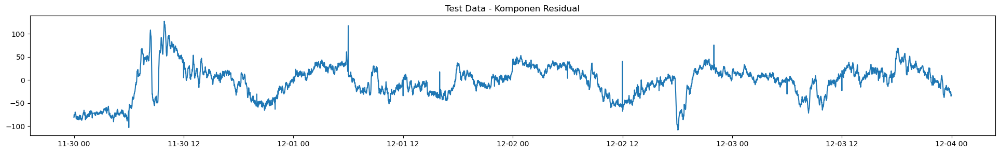

180/180 [==============================] - 1s 1ms/step


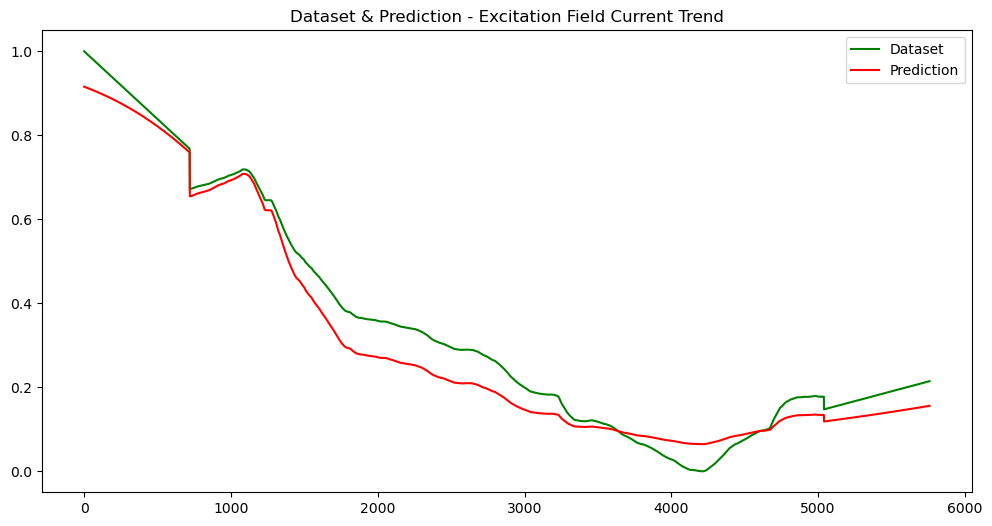

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 1ms/step


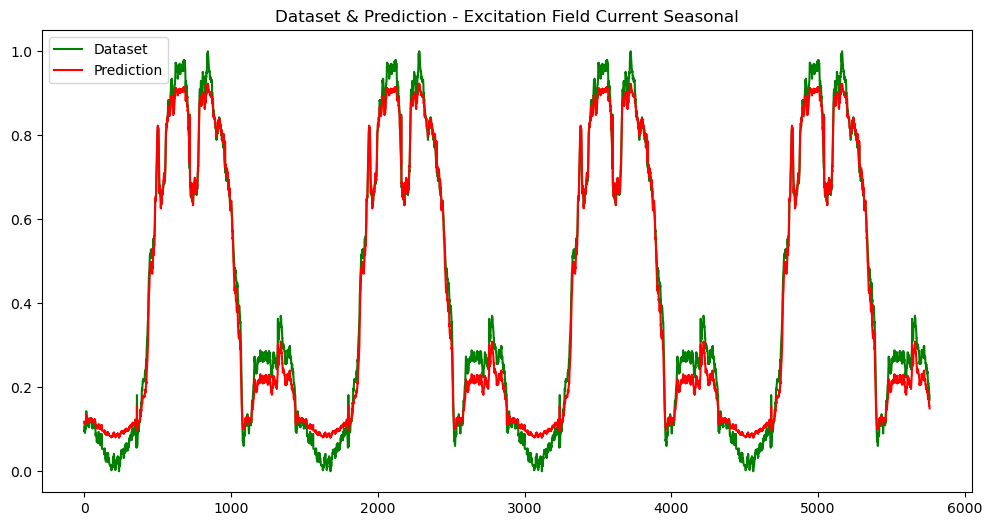

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


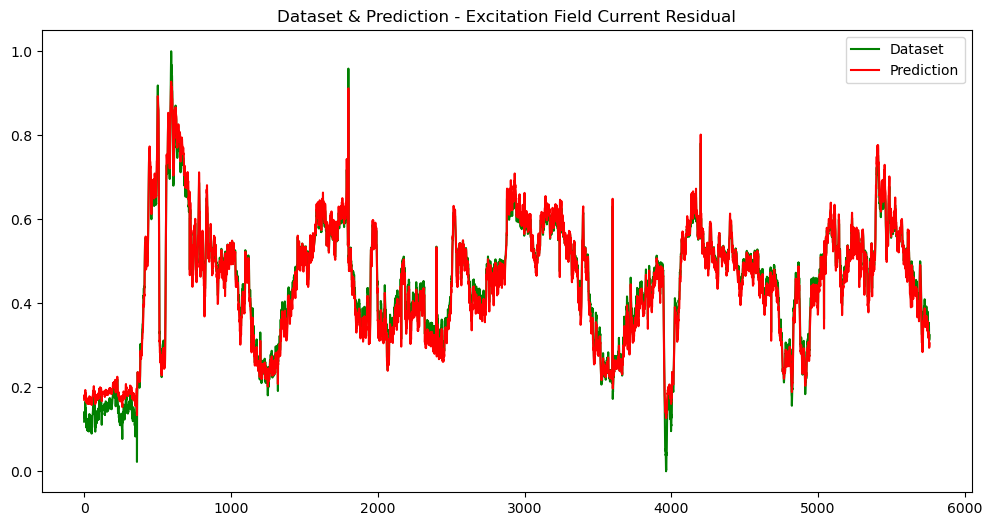

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


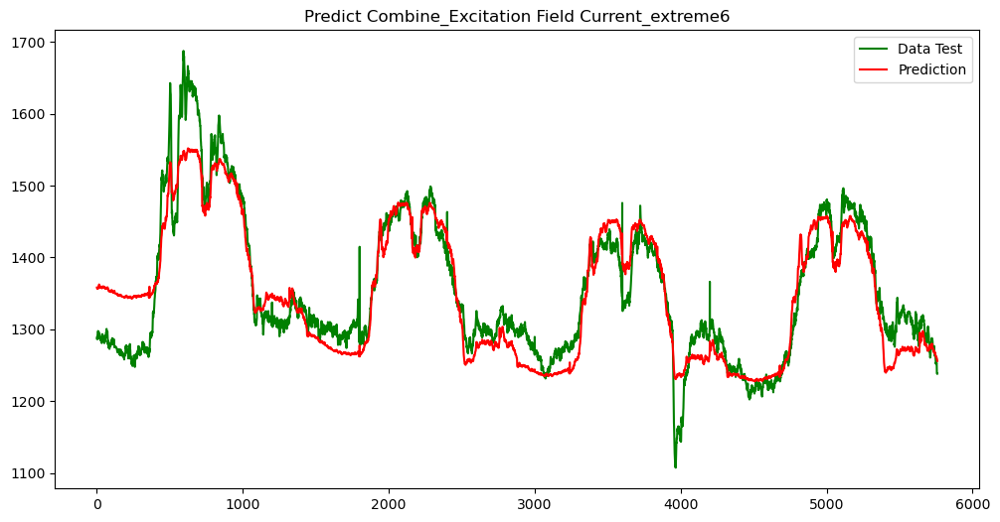

plot/Predict Combine_Excitation Field Current_extreme6.jpg
| > errorsDF:  [71.05943302 67.28584282 67.71234848 ... 18.70491024 18.45391091
 17.67726129]
| > RSME:  36.21505014589086
| > MSE:  1311.5298570693892
| > MAE:  28.407325601388695
Threshold:  23.761646220924714


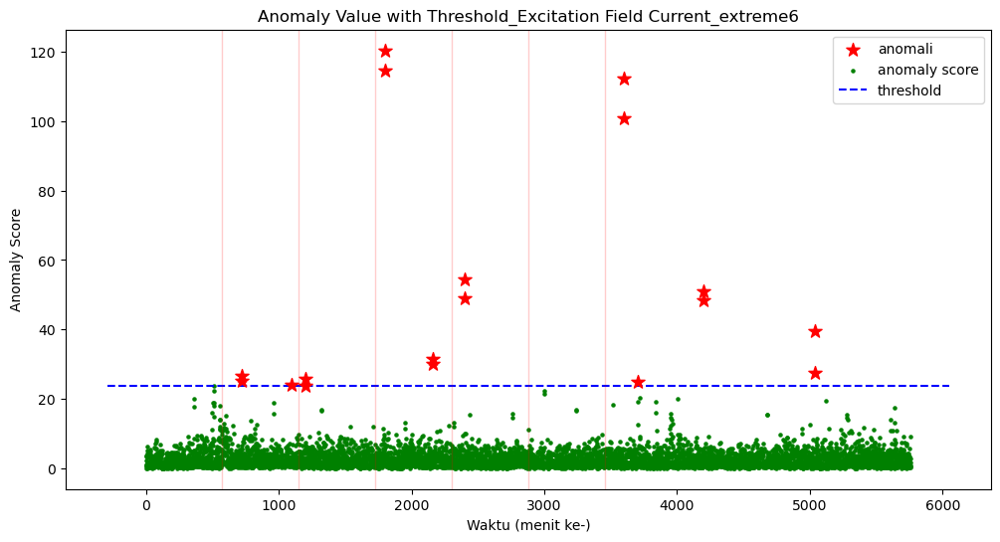

plot/Anomaly Value with Threshold_Excitation Field Current_extreme6.jpg


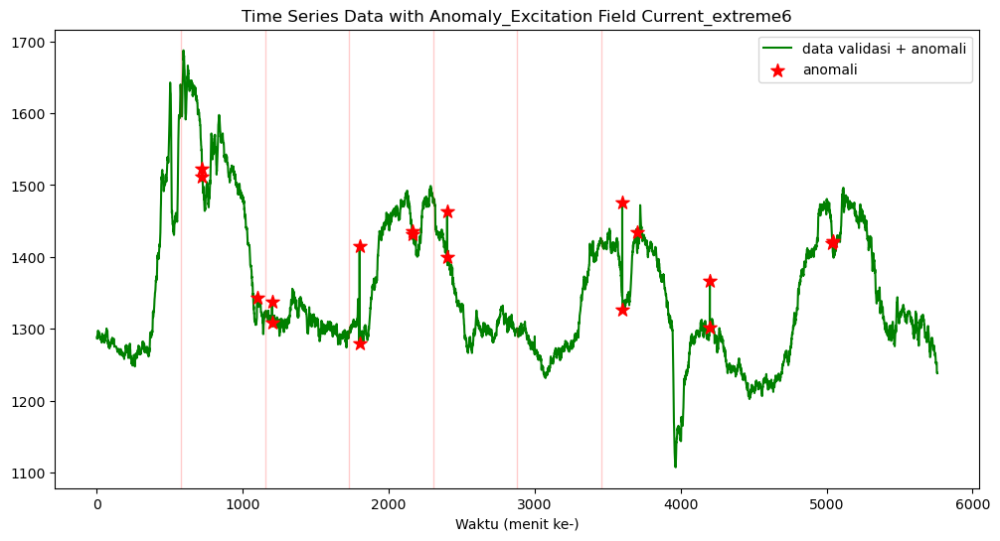

plot/Time Series Data with Anomaly_Excitation Field Current_extreme6.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  6
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:19:57.003550
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Excitation Field Voltage _ extreme 6
| > Sensor Start Time:  2023-05-19 08:19:57.003550 



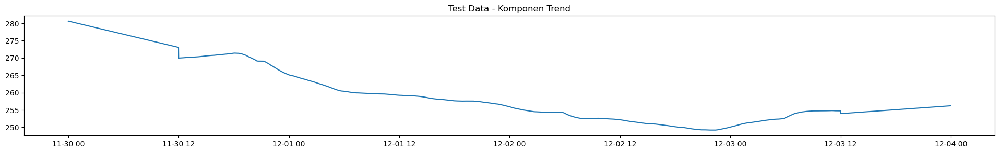

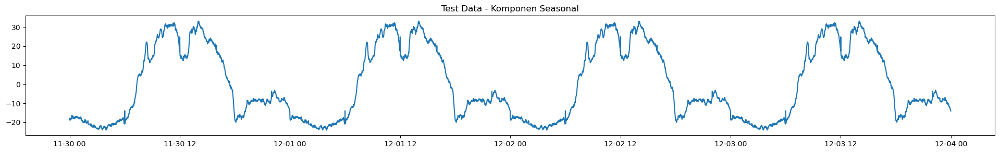

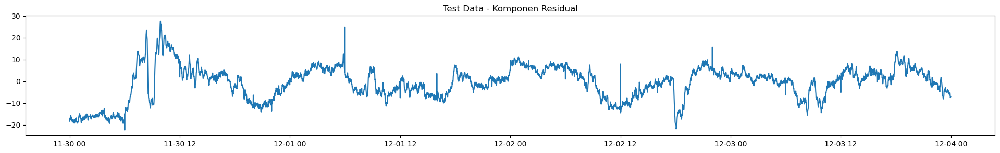

180/180 [==============================] - 1s 1ms/step


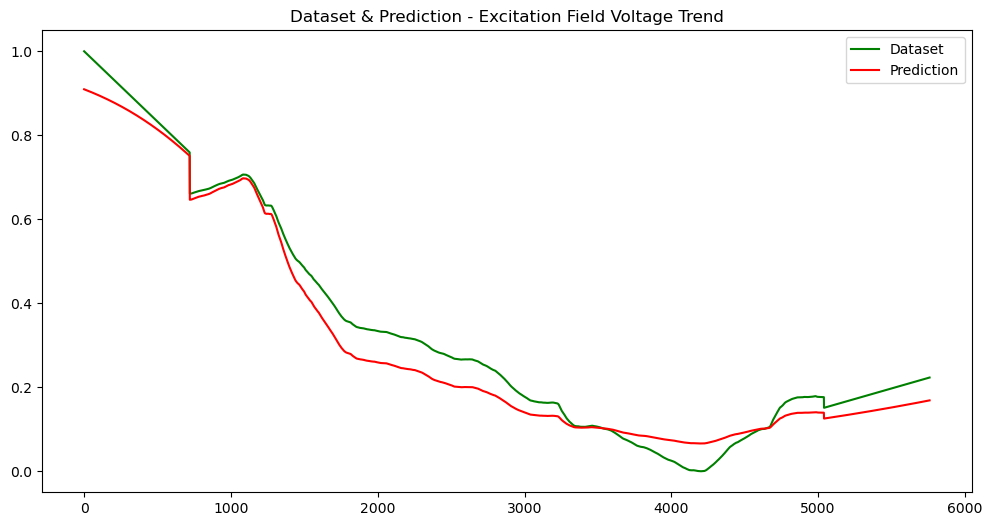

plot/Dataset & Prediction_Excitation Field Voltage_Trend.jpg
180/180 [==============================] - 1s 1000us/step


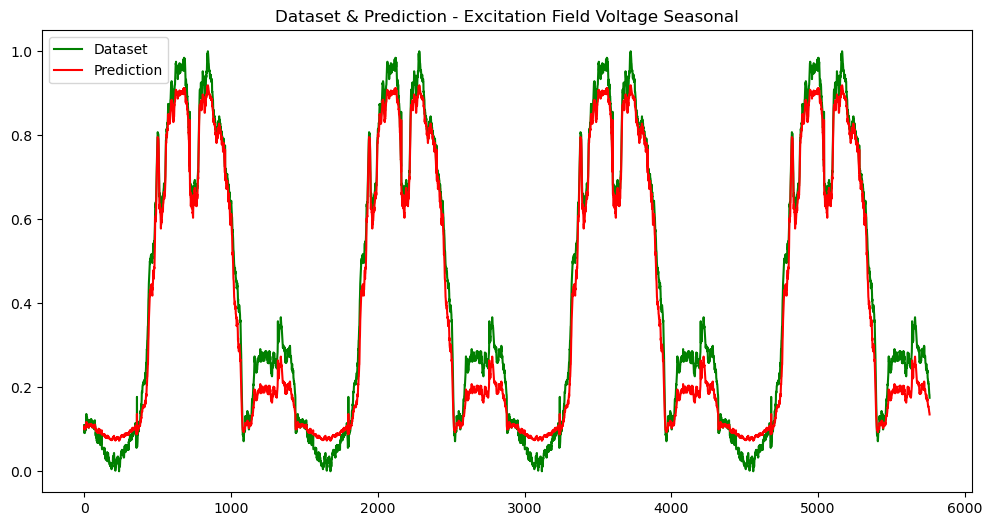

plot/Dataset & Prediction_Excitation Field Voltage_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


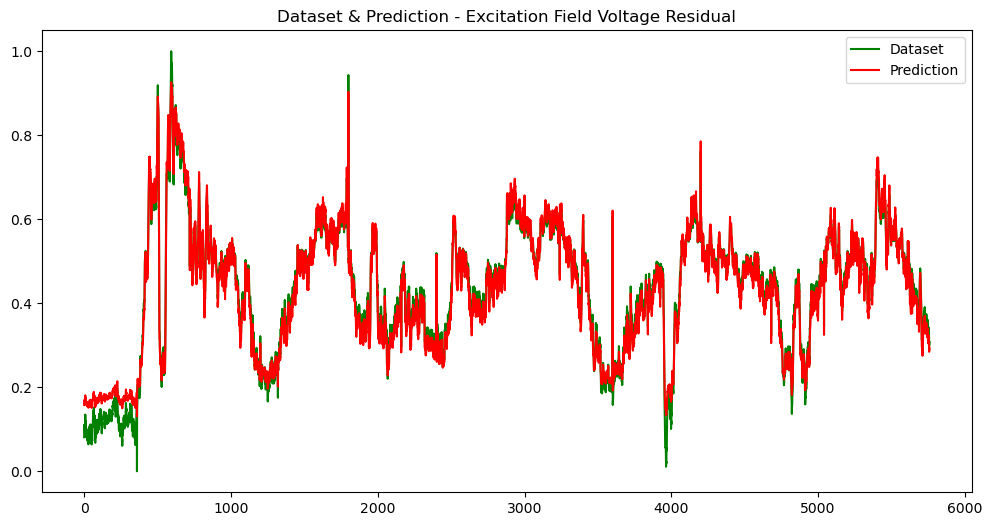

plot/Dataset & Prediction_Excitation Field Voltage_Residual.jpg


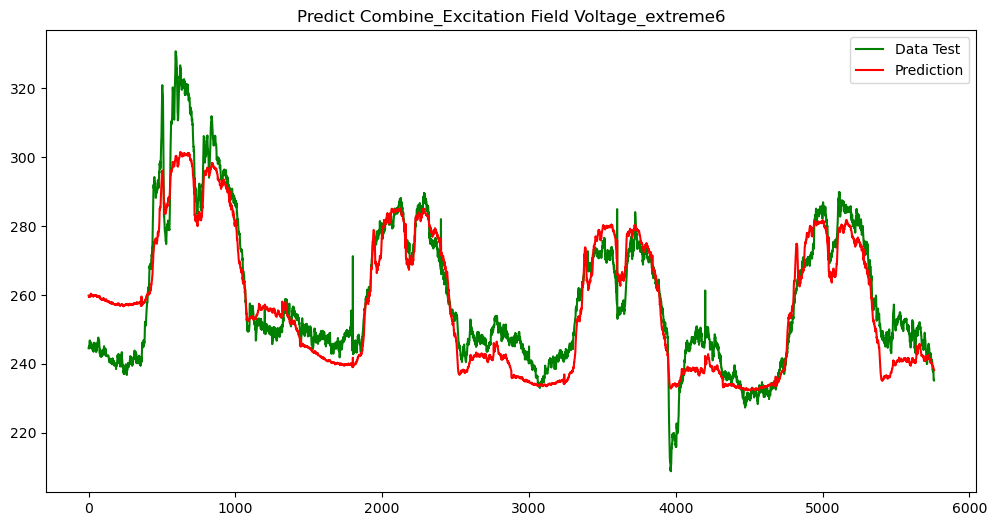

plot/Predict Combine_Excitation Field Voltage_extreme6.jpg
| > errorsDF:  [15.3021317  14.64128493 14.50885968 ...  3.05774877  2.94370465
  3.01723476]
| > RSME:  8.040355894607549
| > MSE:  64.64732291195037
| > MAE:  6.428119802086012
Threshold:  4.5124073892540615


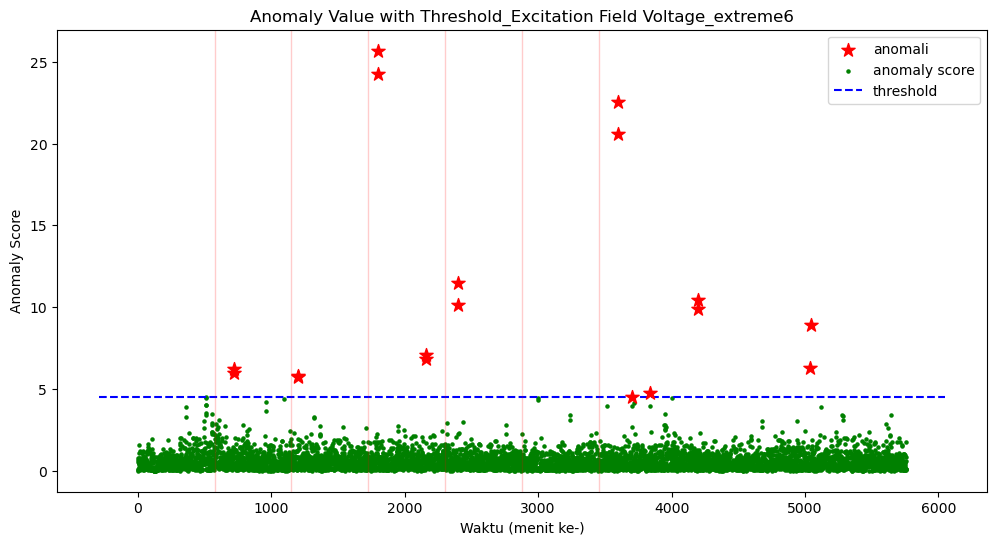

plot/Anomaly Value with Threshold_Excitation Field Voltage_extreme6.jpg


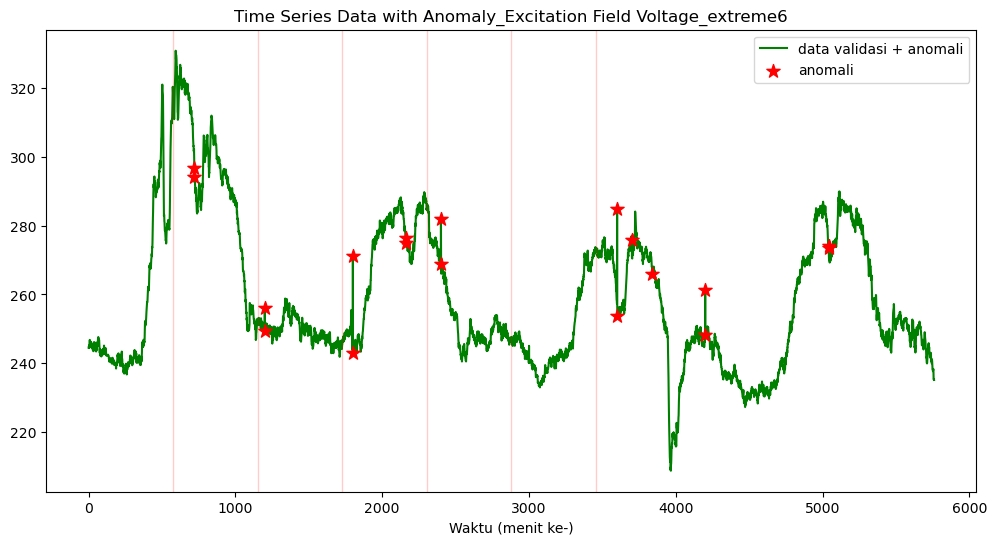

plot/Time Series Data with Anomaly_Excitation Field Voltage_extreme6.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  6
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:20:04.617628
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Power Factor _ extreme 6
| > Sensor Start Time:  2023-05-19 08:20:04.617628 



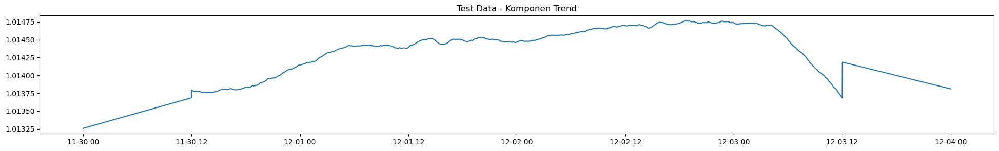

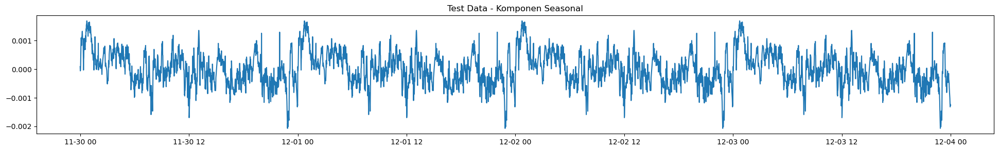

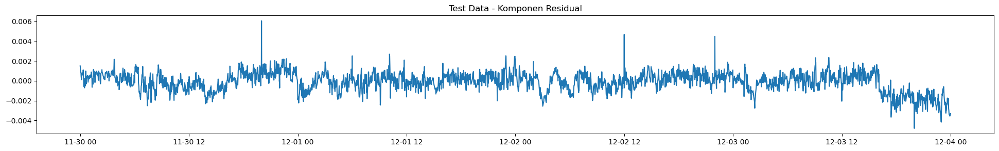

180/180 [==============================] - 1s 967us/step


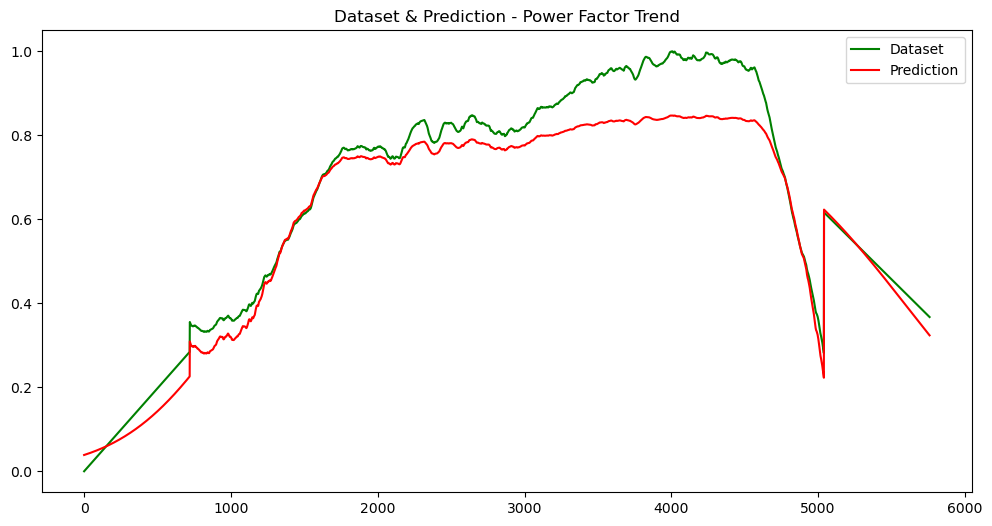

plot/Dataset & Prediction_Power Factor_Trend.jpg
180/180 [==============================] - 1s 1ms/step


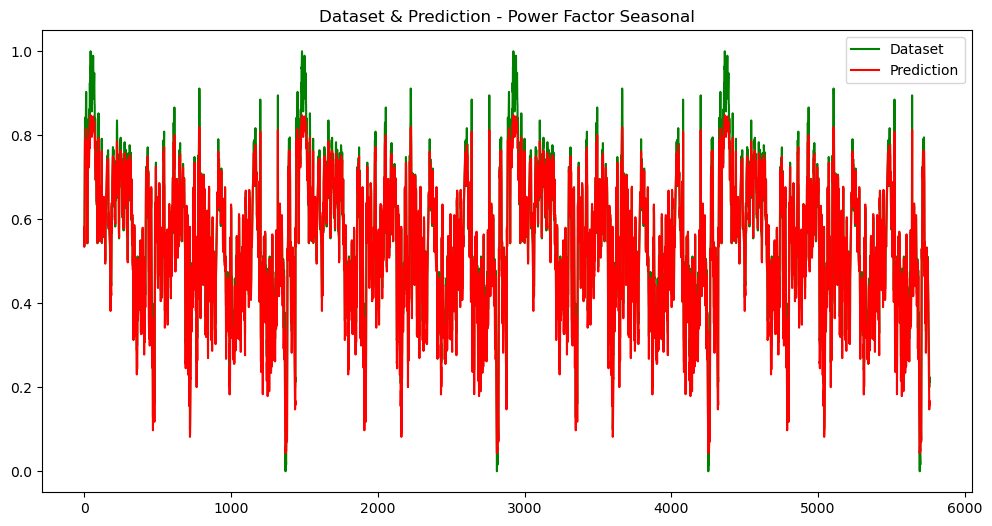

plot/Dataset & Prediction_Power Factor_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


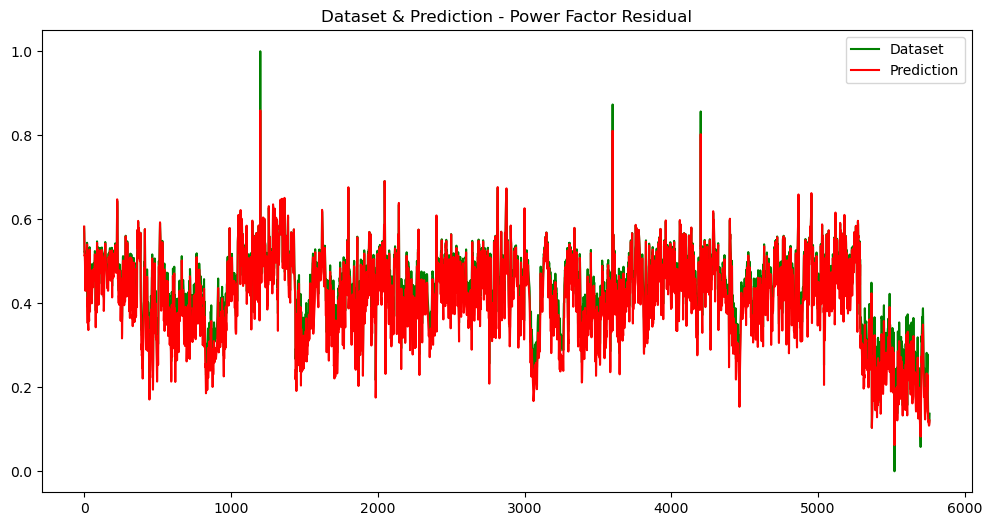

plot/Dataset & Prediction_Power Factor_Residual.jpg


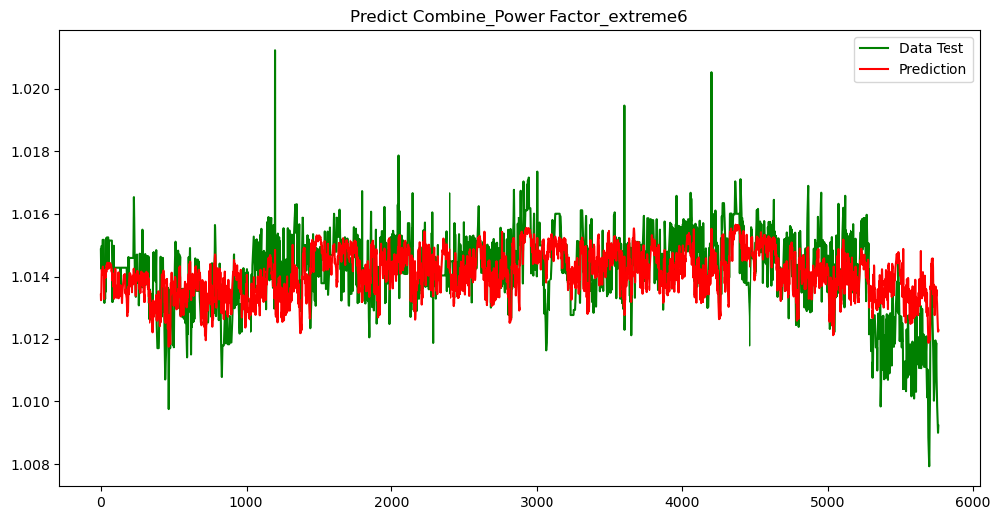

plot/Predict Combine_Power Factor_extreme6.jpg
| > errorsDF:  [0.00142936 0.00129362 0.00095144 ... 0.00322727 0.00319222 0.00304   ]
| > RSME:  0.0009527544924479016
| > MSE:  9.077411228796585e-07
| > MAE:  0.000744233436246928
Threshold:  0.0018822191349463537


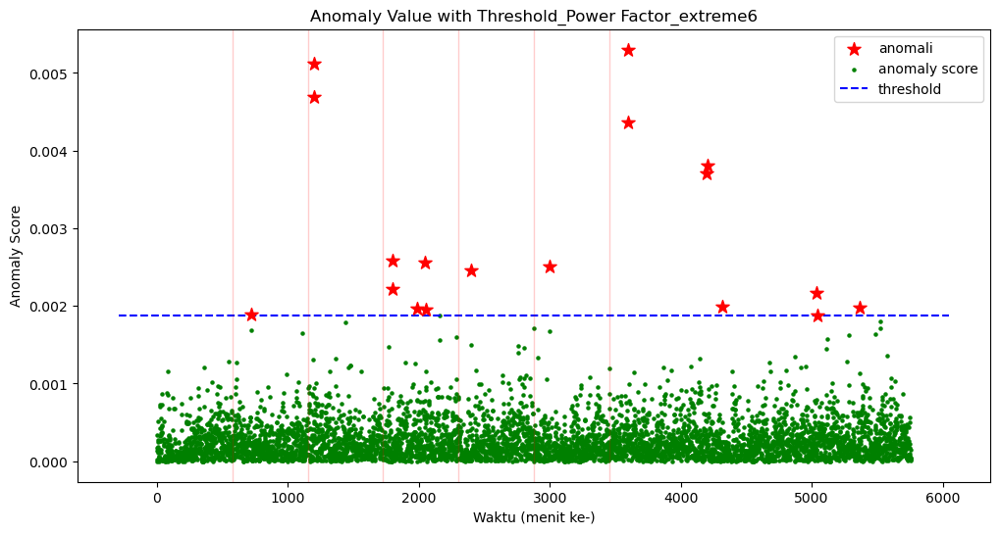

plot/Anomaly Value with Threshold_Power Factor_extreme6.jpg


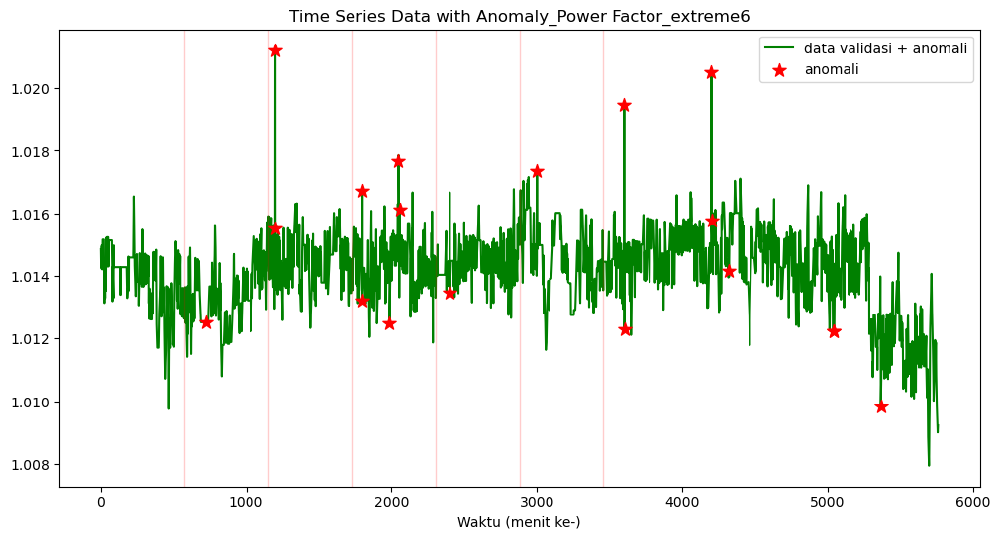

plot/Time Series Data with Anomaly_Power Factor_extreme6.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  6
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:20:12.756687
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Reactive Power _ extreme 6
| > Sensor Start Time:  2023-05-19 08:20:12.756687 



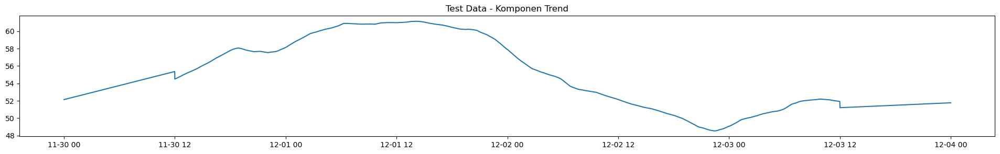

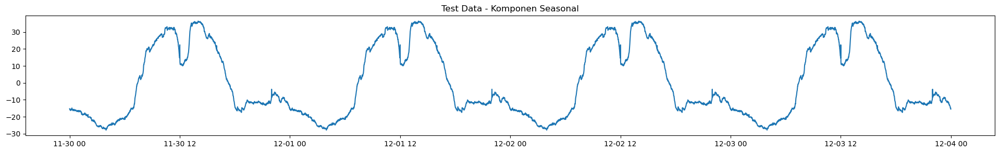

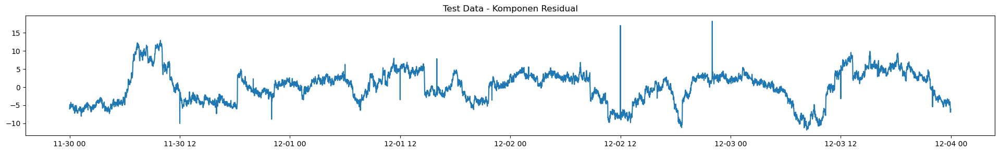

180/180 [==============================] - 1s 1ms/step


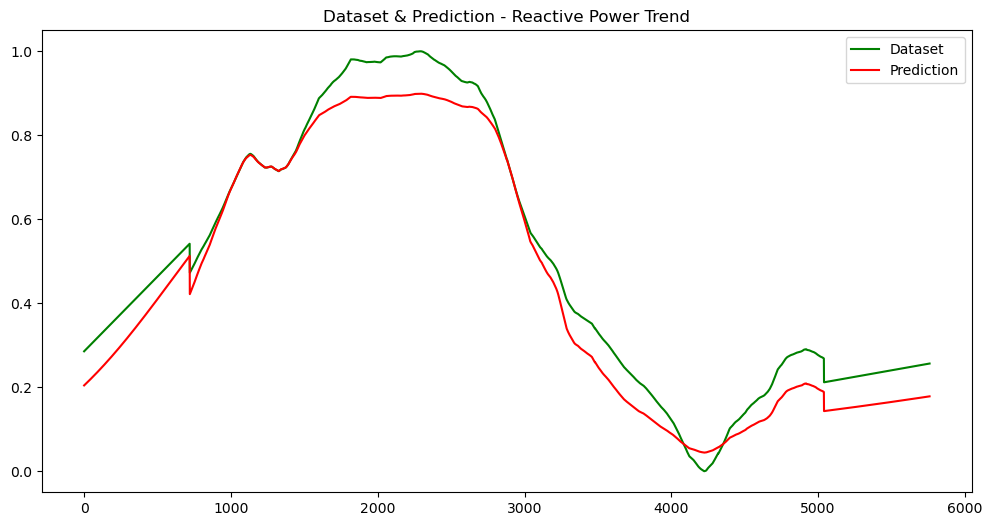

plot/Dataset & Prediction_Reactive Power_Trend.jpg
180/180 [==============================] - 1s 1ms/step


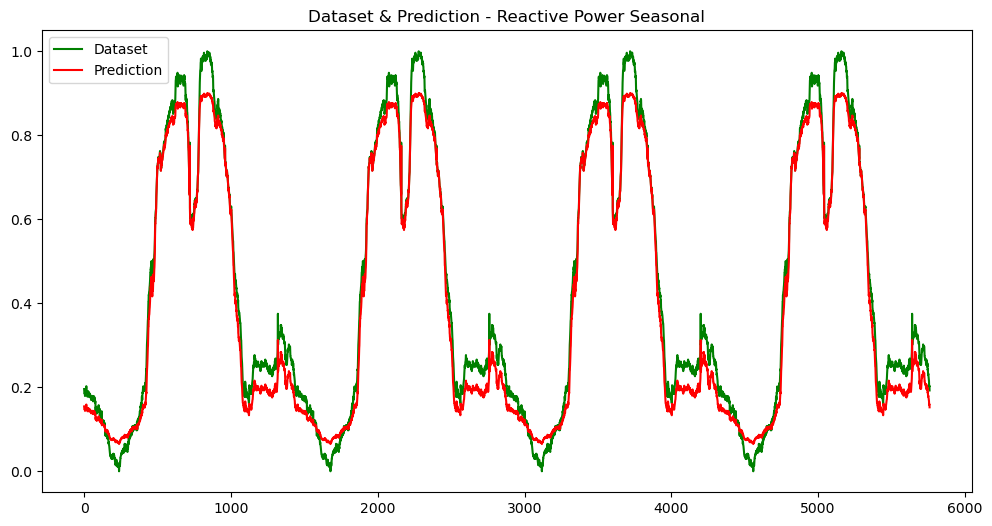

plot/Dataset & Prediction_Reactive Power_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


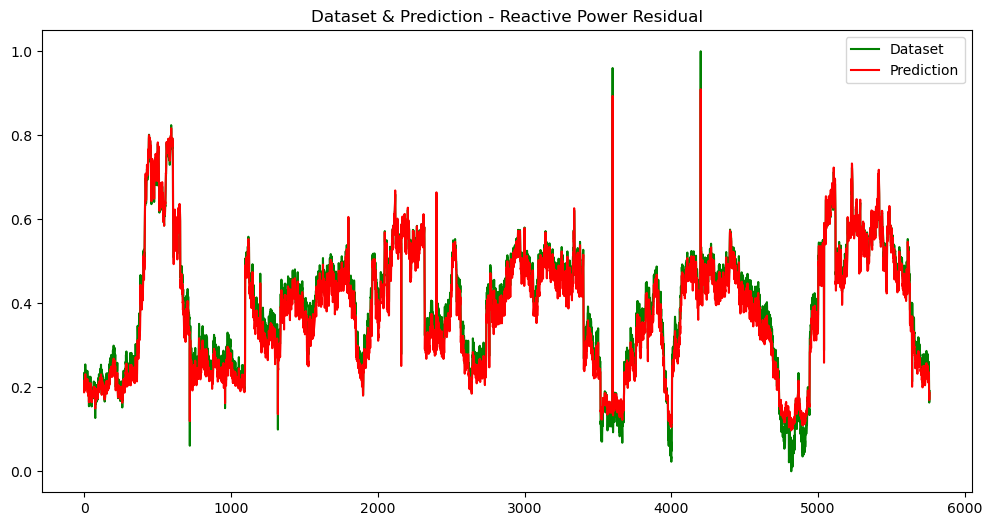

plot/Dataset & Prediction_Reactive Power_Residual.jpg


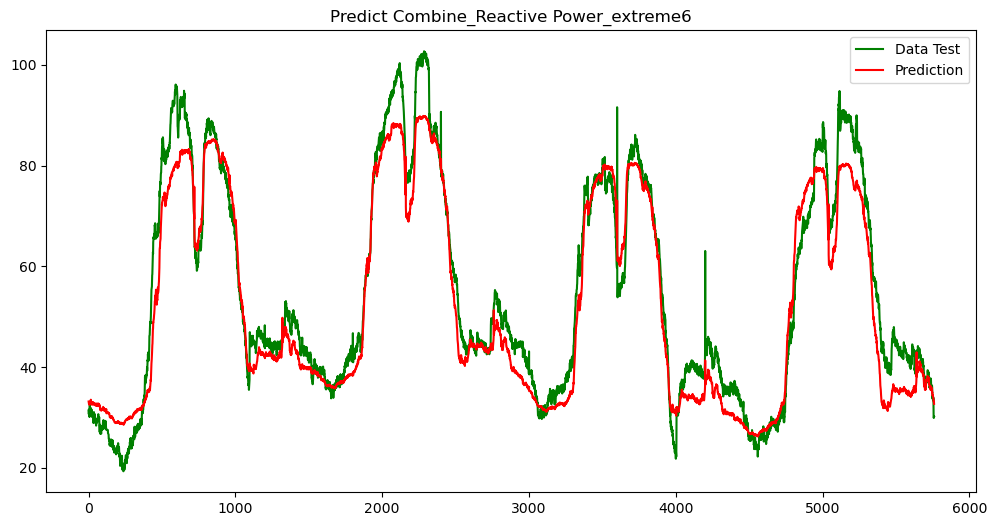

plot/Predict Combine_Reactive Power_extreme6.jpg
| > errorsDF:  [2.33759117 1.29076576 1.48487282 ... 3.17389679 3.04857254 2.53632355]
| > RSME:  5.5142038213638775
| > MSE:  30.406443783543992
| > MAE:  4.461060160820664
Threshold:  5.133976964457361


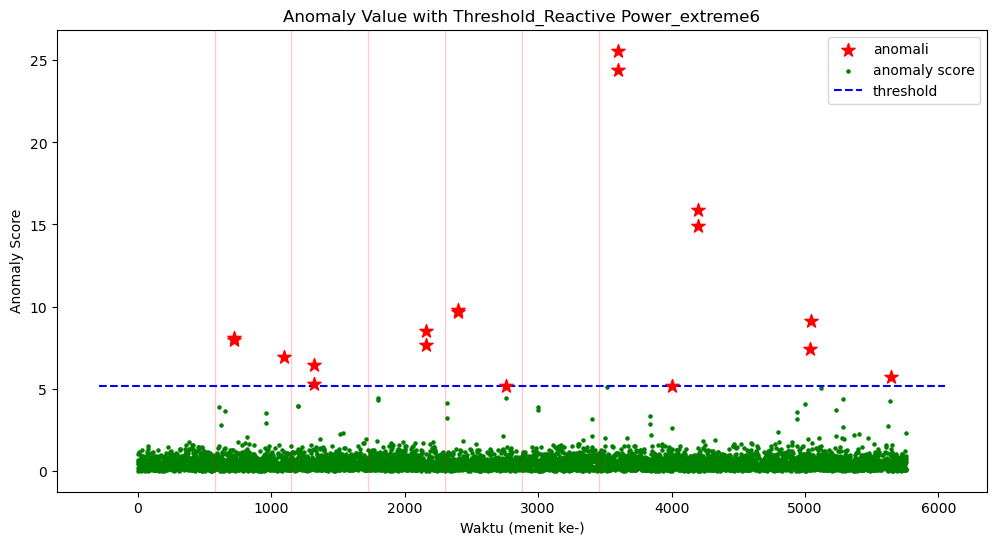

plot/Anomaly Value with Threshold_Reactive Power_extreme6.jpg


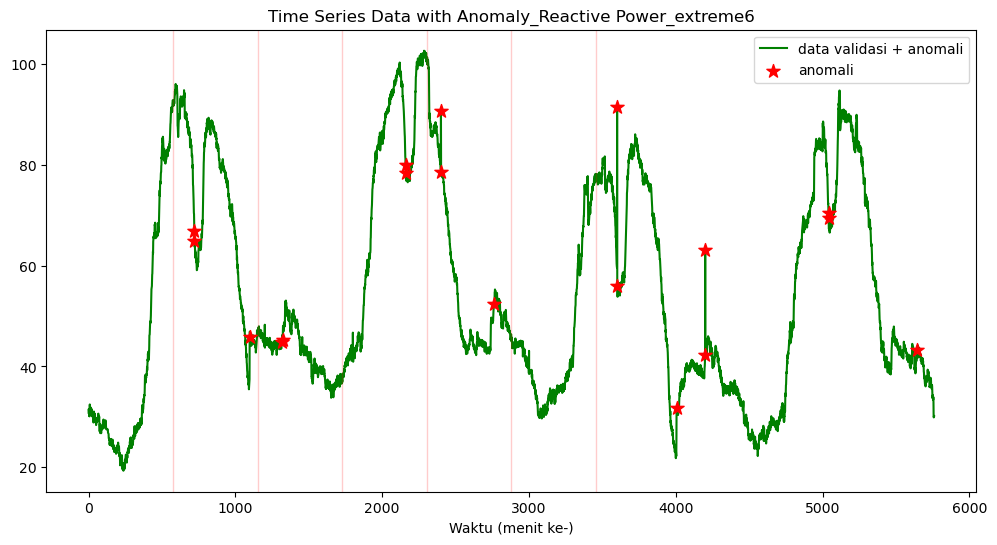

plot/Time Series Data with Anomaly_Reactive Power_extreme6.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  6
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:20:20.974645
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Generator Gross Capacity _ extreme 6
| > Sensor Start Time:  2023-05-19 08:20:20.974645 



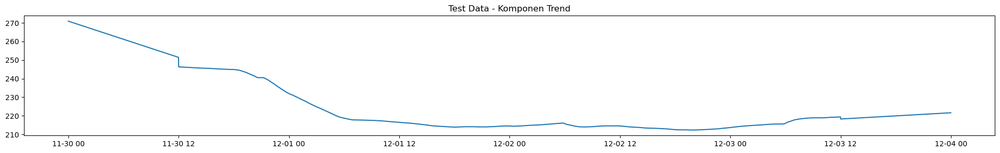

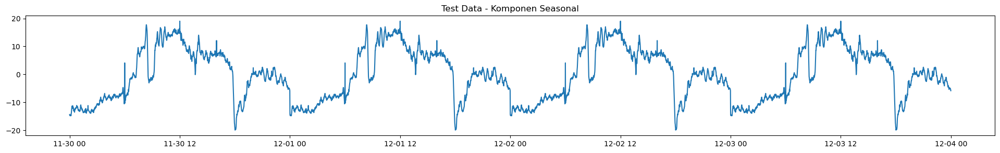

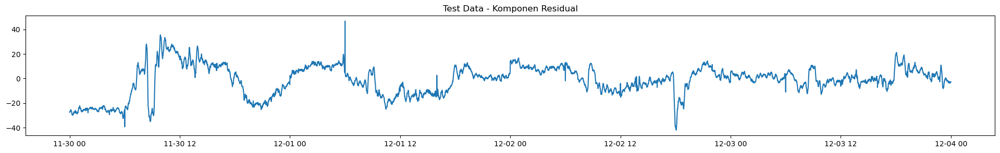

180/180 [==============================] - 1s 1ms/step


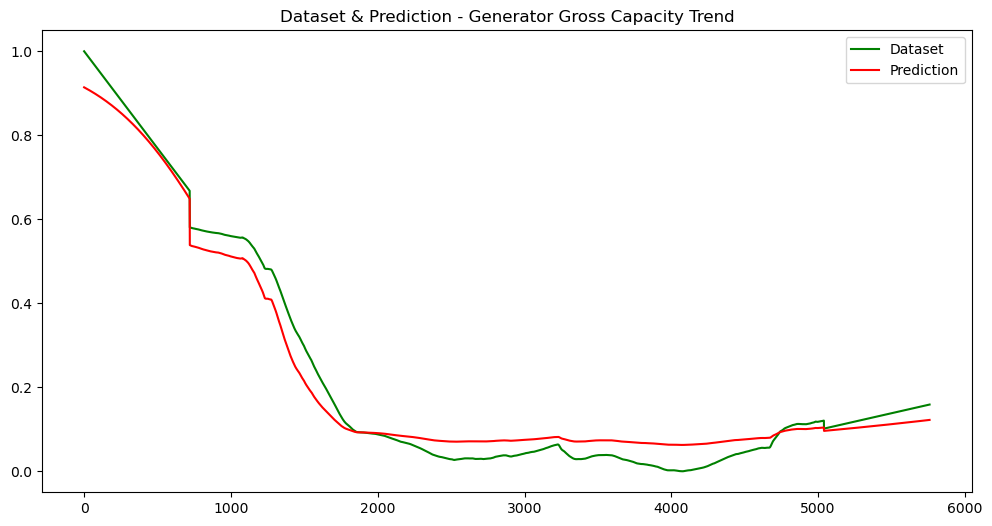

plot/Dataset & Prediction_Generator Gross Capacity_Trend.jpg
180/180 [==============================] - 1s 974us/step


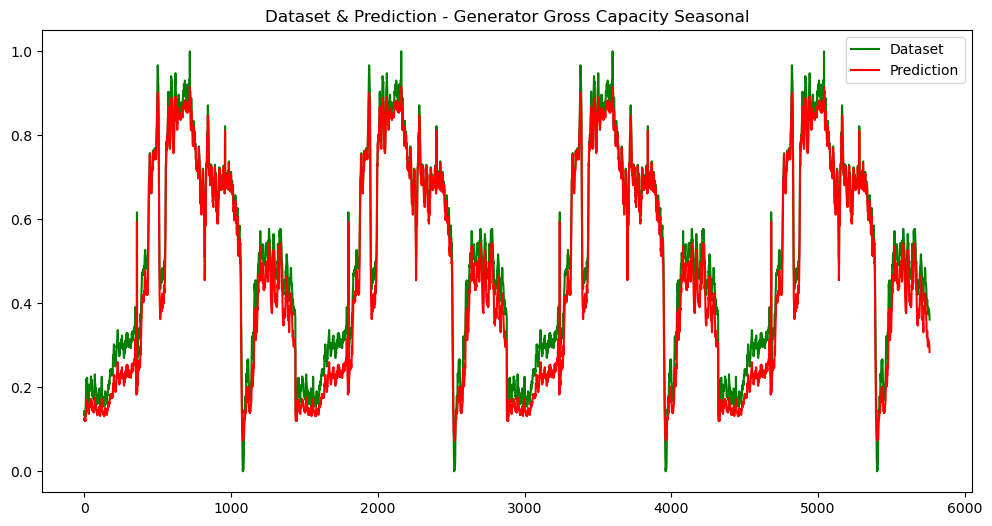

plot/Dataset & Prediction_Generator Gross Capacity_Seasonal.jpg
180/180 [==============================] - 1s 962us/step


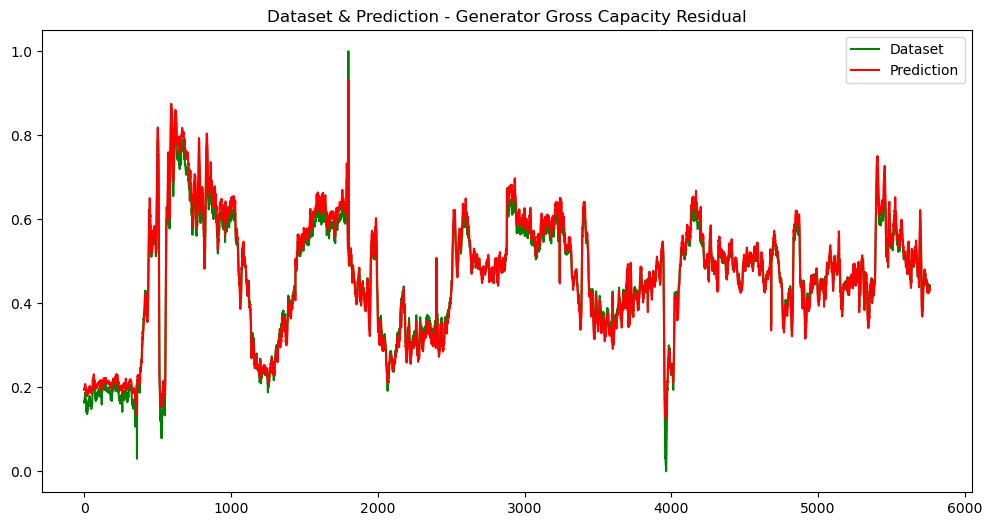

plot/Dataset & Prediction_Generator Gross Capacity_Residual.jpg


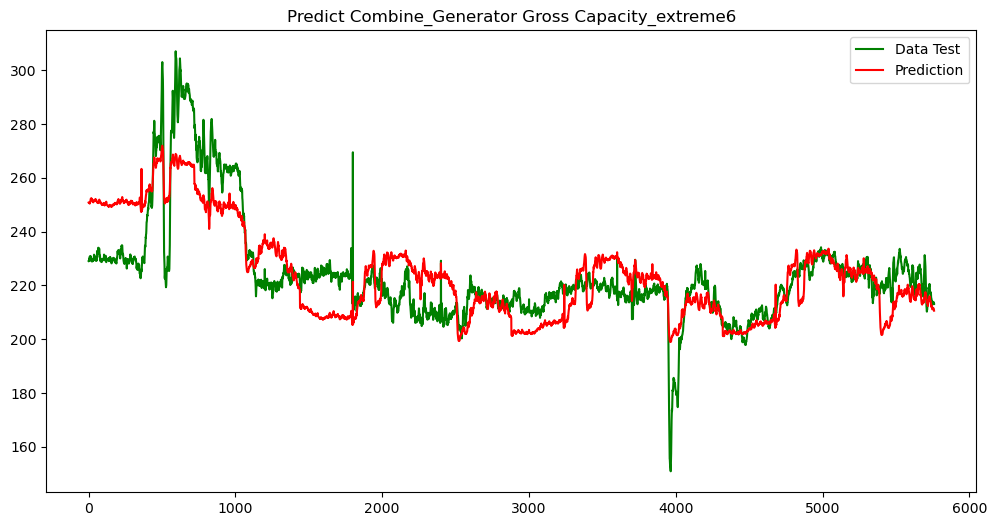

plot/Predict Combine_Generator Gross Capacity_extreme6.jpg
| > errorsDF:  [21.73555946 21.51886087 21.57924846 ...  2.49979969  1.98067091
  2.45735071]
| > RSME:  12.16717094746103
| > MSE:  148.04004886473973
| > MAE:  9.721661287001139
Threshold:  6.994394843167885


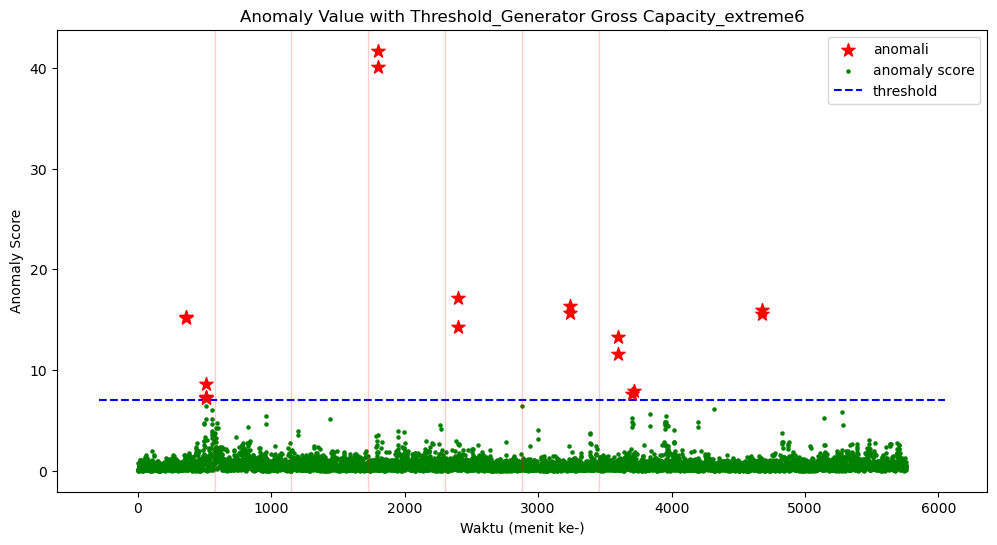

plot/Anomaly Value with Threshold_Generator Gross Capacity_extreme6.jpg


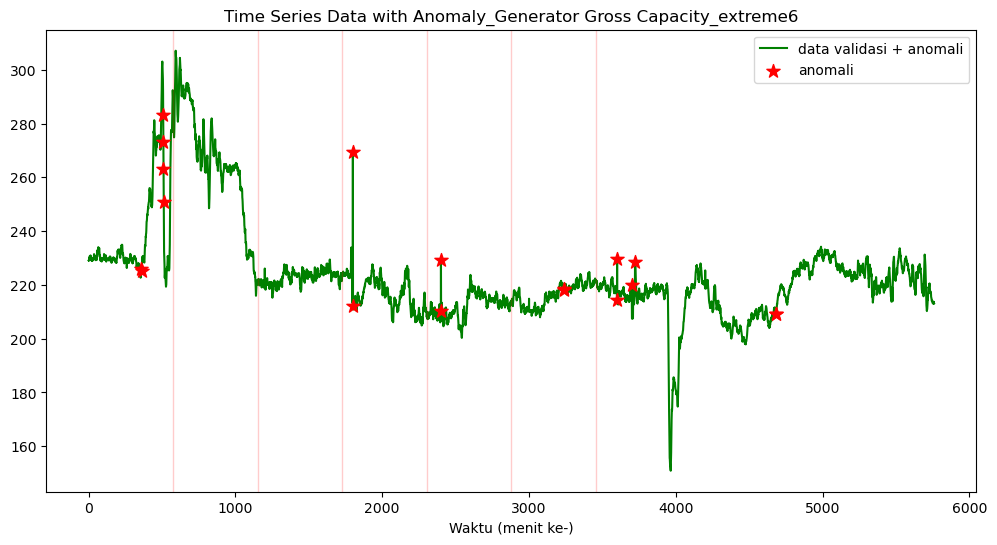

plot/Time Series Data with Anomaly_Generator Gross Capacity_extreme6.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  6
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:20:28.421990
| ========================================================================================== |



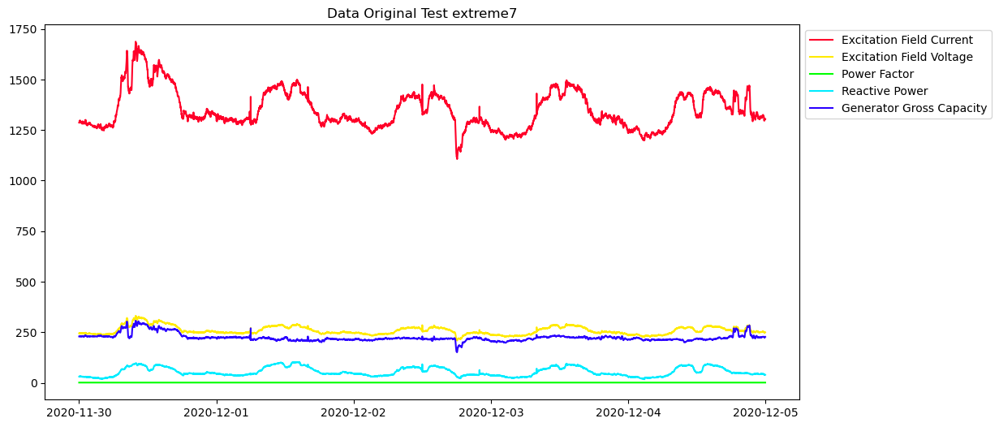


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 7
| > Sensor Start Time:  2023-05-19 08:20:31.452503 



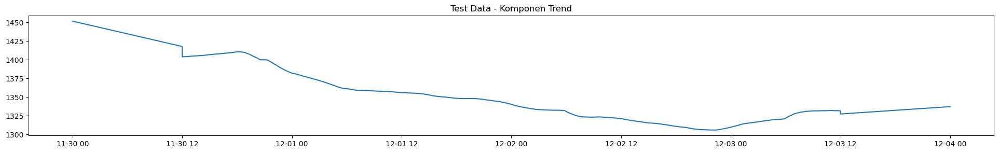

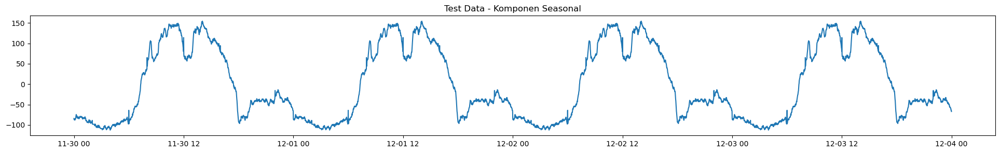

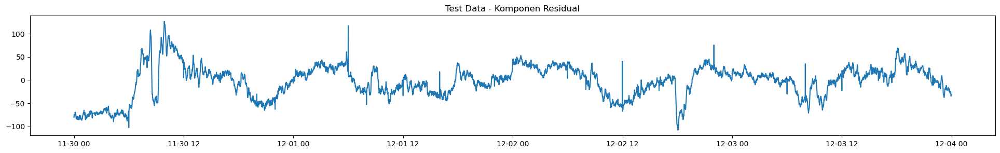

180/180 [==============================] - 1s 2ms/step


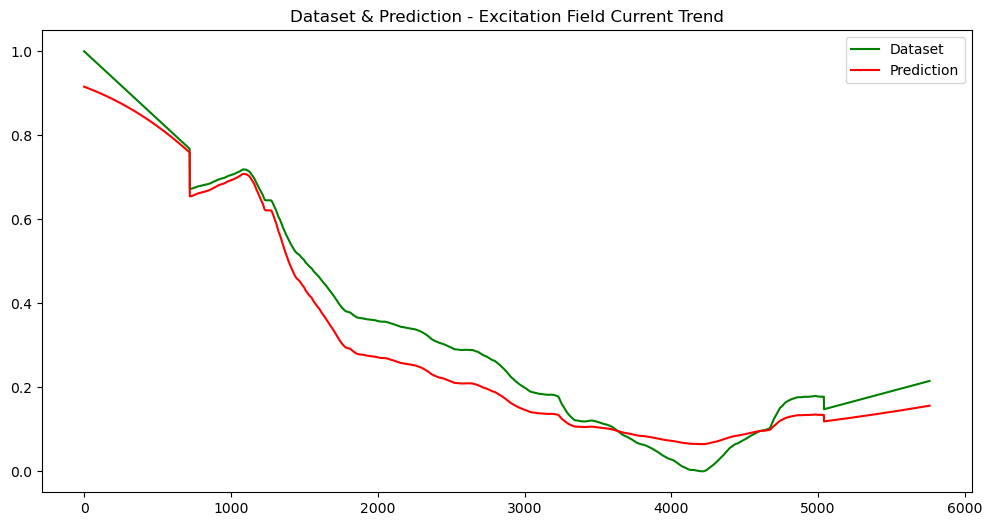

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 1ms/step


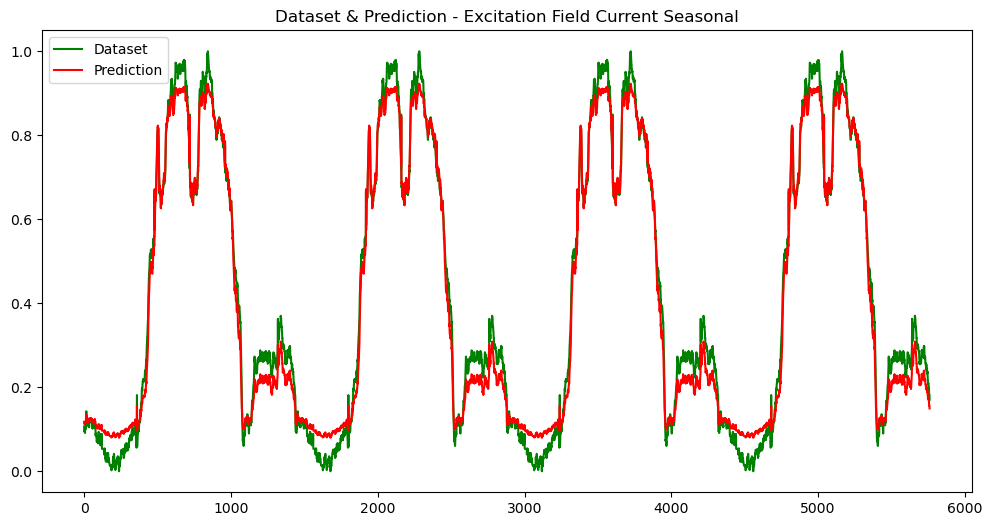

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


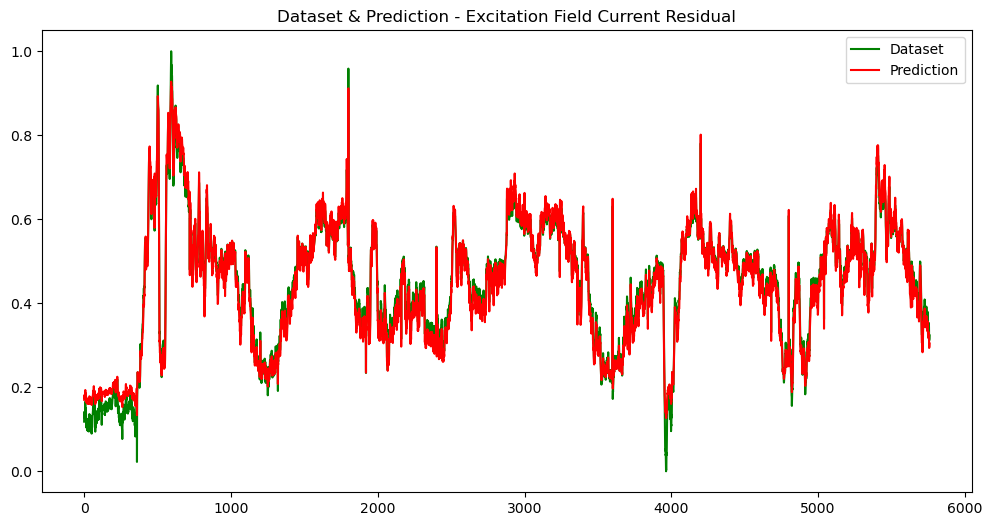

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


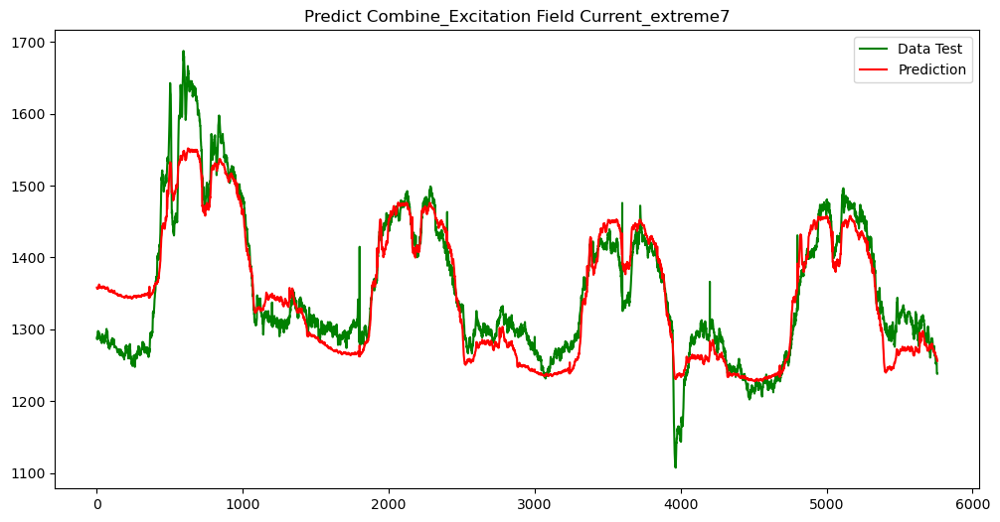

plot/Predict Combine_Excitation Field Current_extreme7.jpg
| > errorsDF:  [71.05590824 67.28241722 67.70880844 ... 18.78859707 18.53768167
 17.76185602]
| > RSME:  36.20932132916264
| > MSE:  1311.1149511185524
| > MAE:  28.40484990521944
Threshold:  30.251533156041067


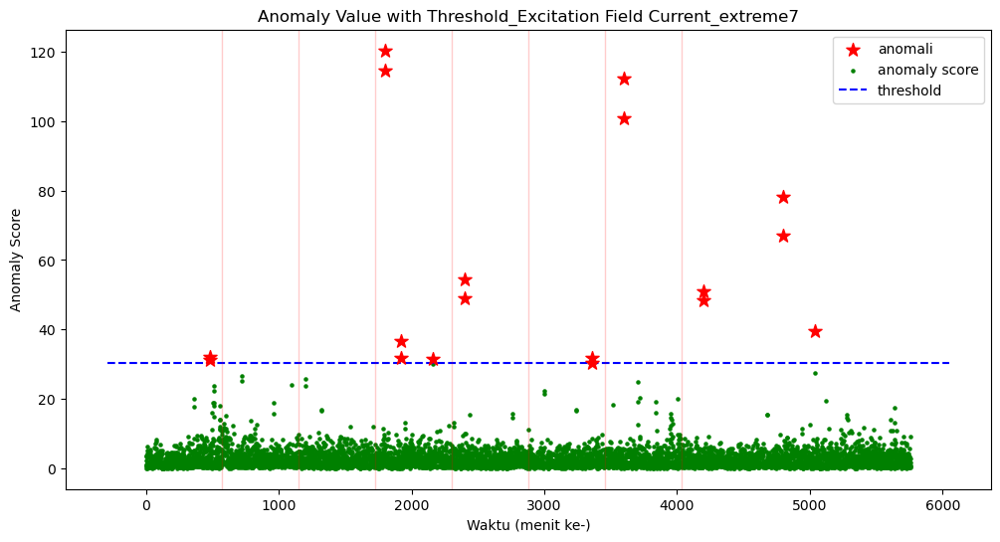

plot/Anomaly Value with Threshold_Excitation Field Current_extreme7.jpg


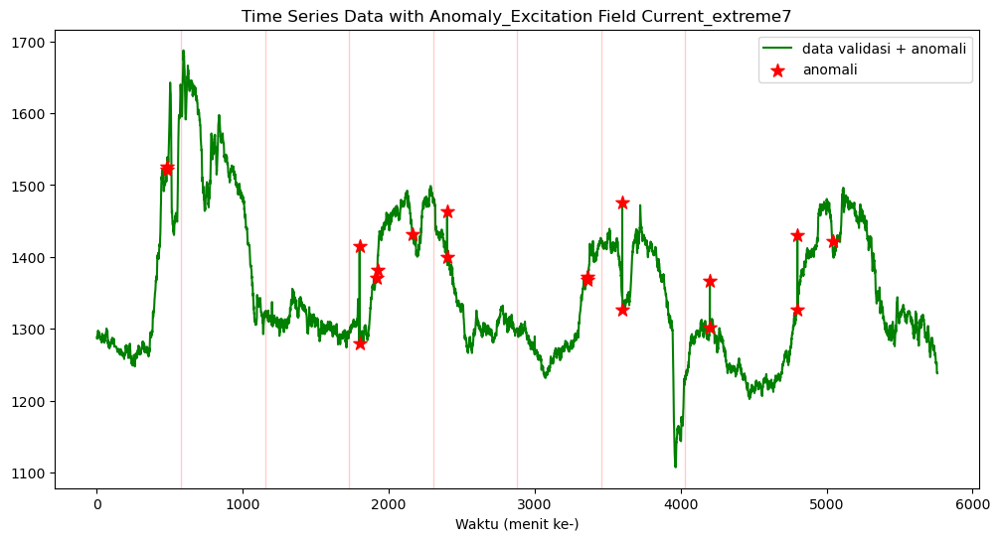

plot/Time Series Data with Anomaly_Excitation Field Current_extreme7.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  7
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:20:41.091947
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Excitation Field Voltage _ extreme 7
| > Sensor Start Time:  2023-05-19 08:20:41.091947 



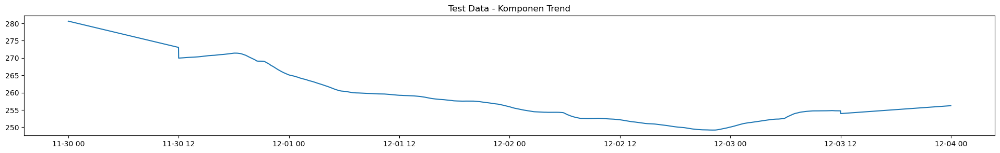

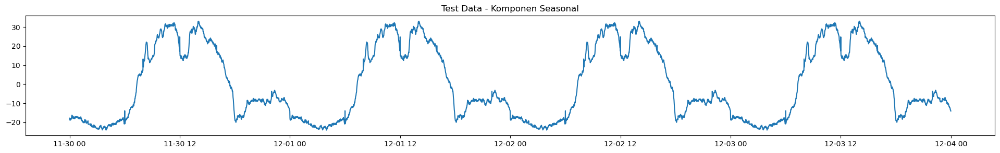

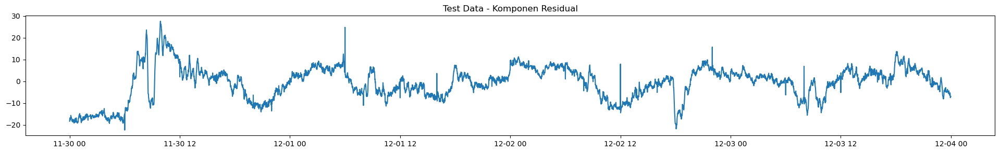

180/180 [==============================] - 1s 2ms/step


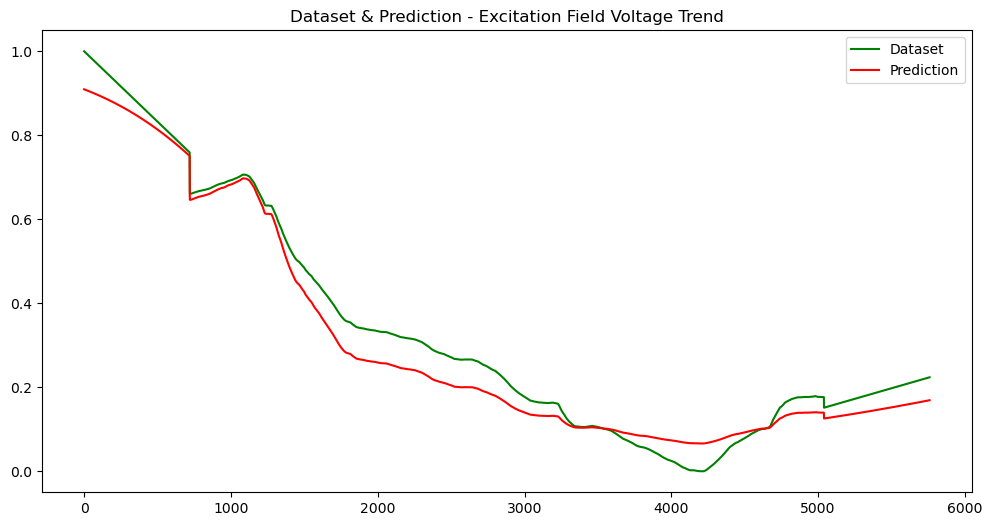

plot/Dataset & Prediction_Excitation Field Voltage_Trend.jpg
180/180 [==============================] - 1s 1ms/step


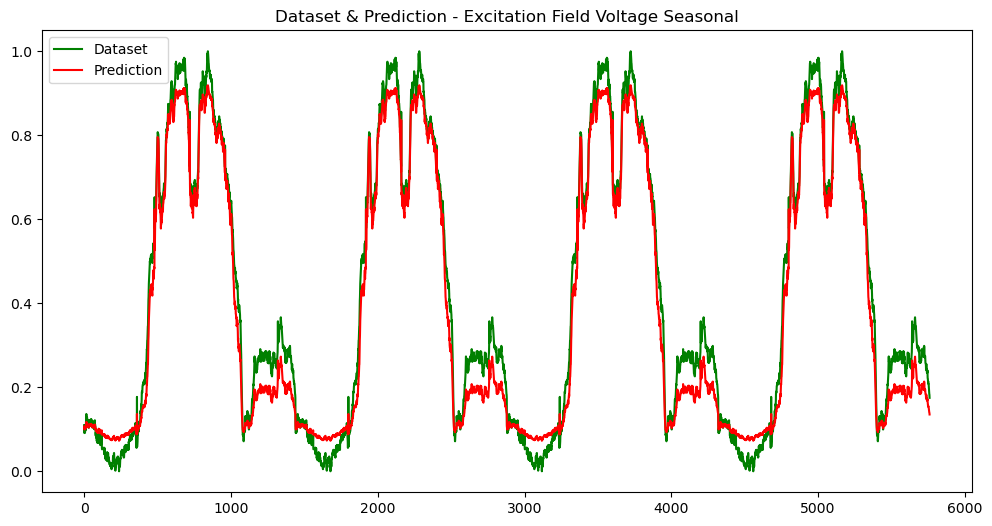

plot/Dataset & Prediction_Excitation Field Voltage_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


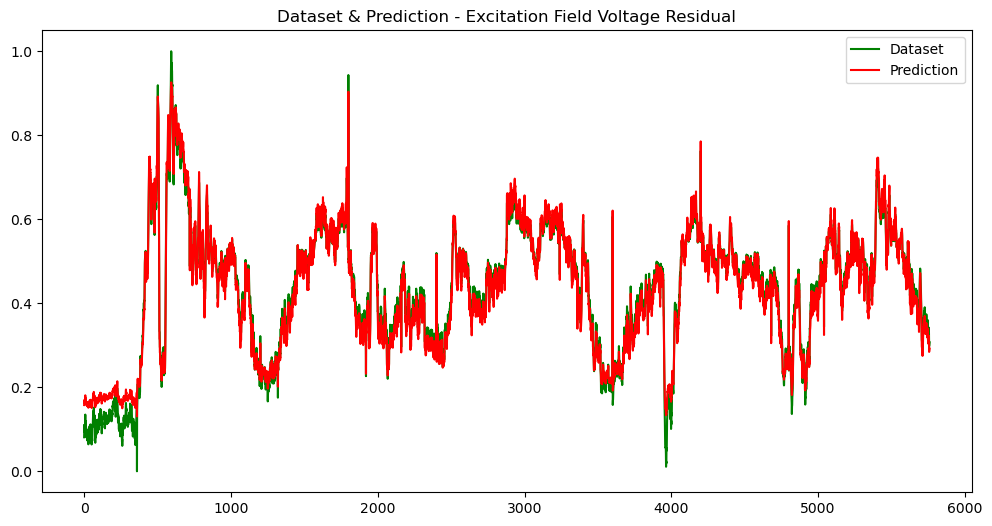

plot/Dataset & Prediction_Excitation Field Voltage_Residual.jpg


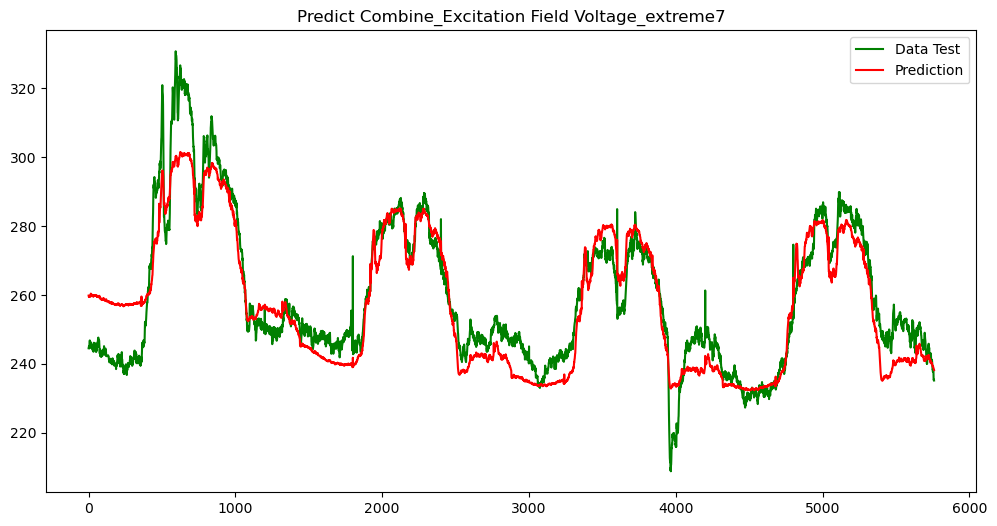

plot/Predict Combine_Excitation Field Voltage_extreme7.jpg
| > errorsDF:  [15.30148702 14.64066886 14.5082417  ...  3.07635687  2.96238331
  3.03599925]
| > RSME:  8.038353207920977
| > MSE:  64.61512229529347
| > MAE:  6.427237272361106
Threshold:  6.780205310257423


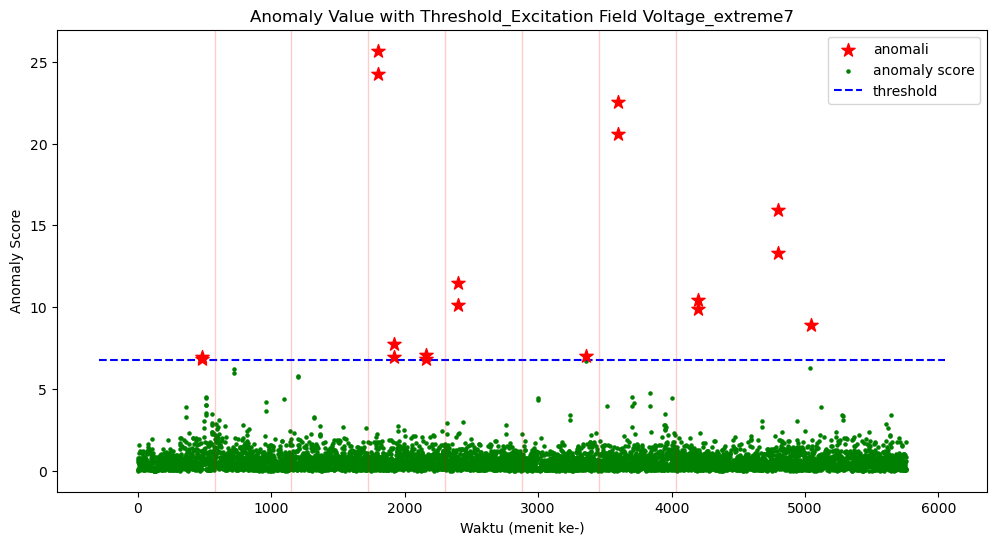

plot/Anomaly Value with Threshold_Excitation Field Voltage_extreme7.jpg


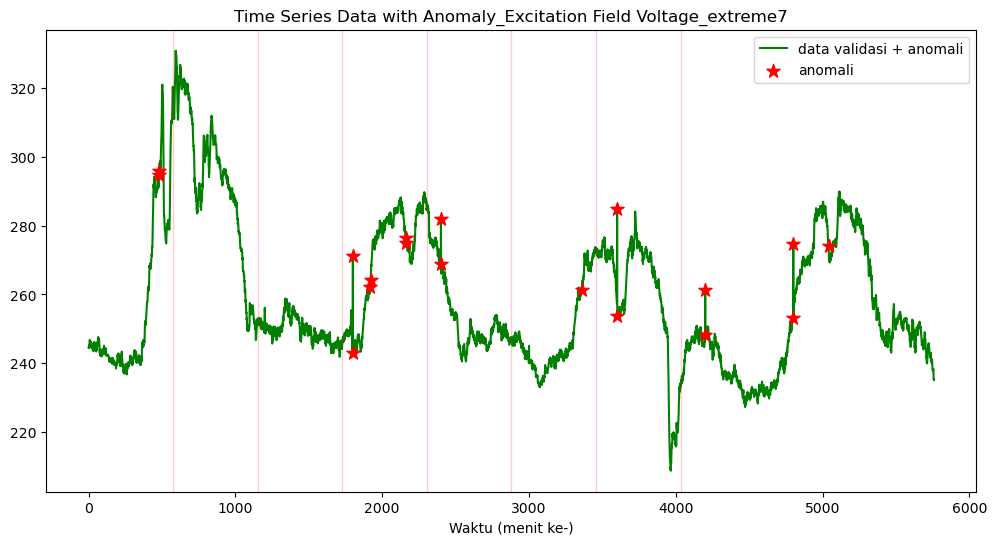

plot/Time Series Data with Anomaly_Excitation Field Voltage_extreme7.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  7
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:20:50.389366
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Power Factor _ extreme 7
| > Sensor Start Time:  2023-05-19 08:20:50.390367 



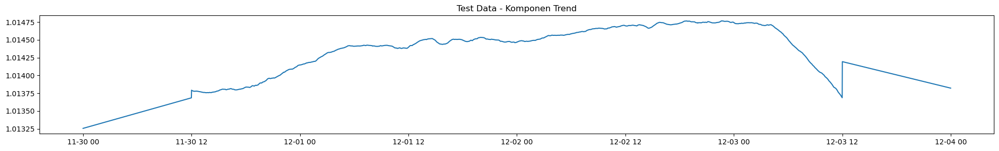

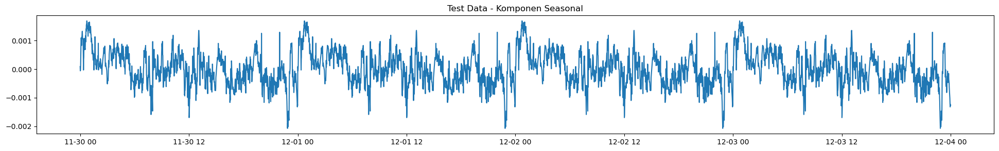

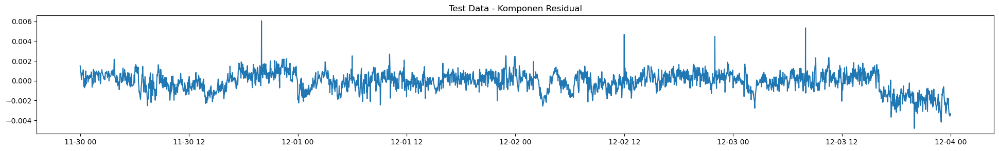

180/180 [==============================] - 1s 2ms/step


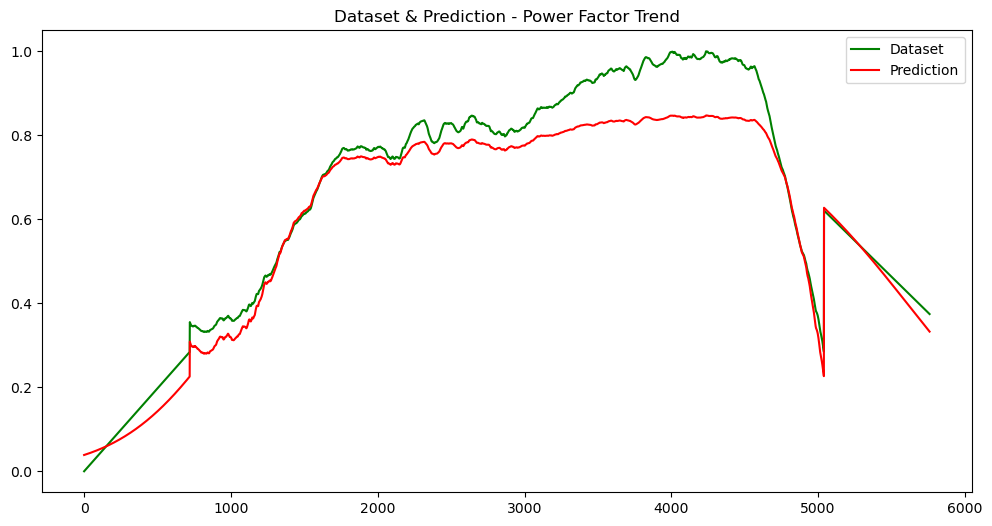

plot/Dataset & Prediction_Power Factor_Trend.jpg
180/180 [==============================] - 1s 2ms/step


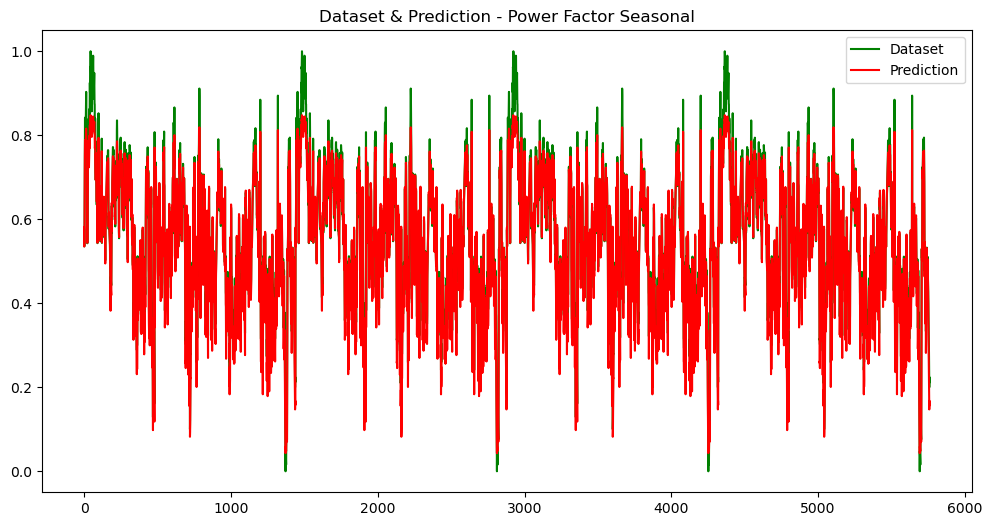

plot/Dataset & Prediction_Power Factor_Seasonal.jpg
180/180 [==============================] - 1s 2ms/step


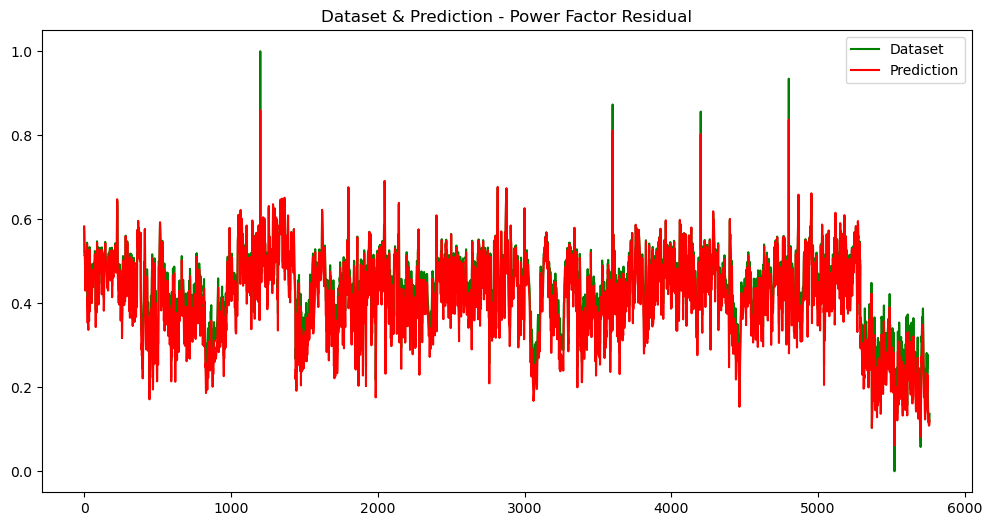

plot/Dataset & Prediction_Power Factor_Residual.jpg


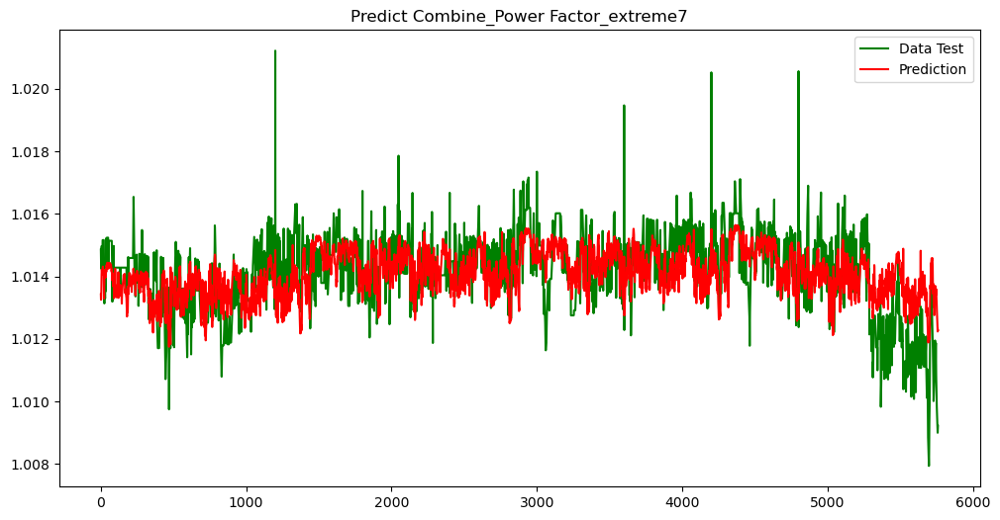

plot/Predict Combine_Power Factor_extreme7.jpg
| > errorsDF:  [0.00142993 0.00129409 0.00095182 ... 0.00323769 0.00320271 0.0030504 ]
| > RSME:  0.0009577165999948066
| > MSE:  9.172210859056124e-07
| > MAE:  0.0007465655584011447
Threshold:  0.002117857464801859


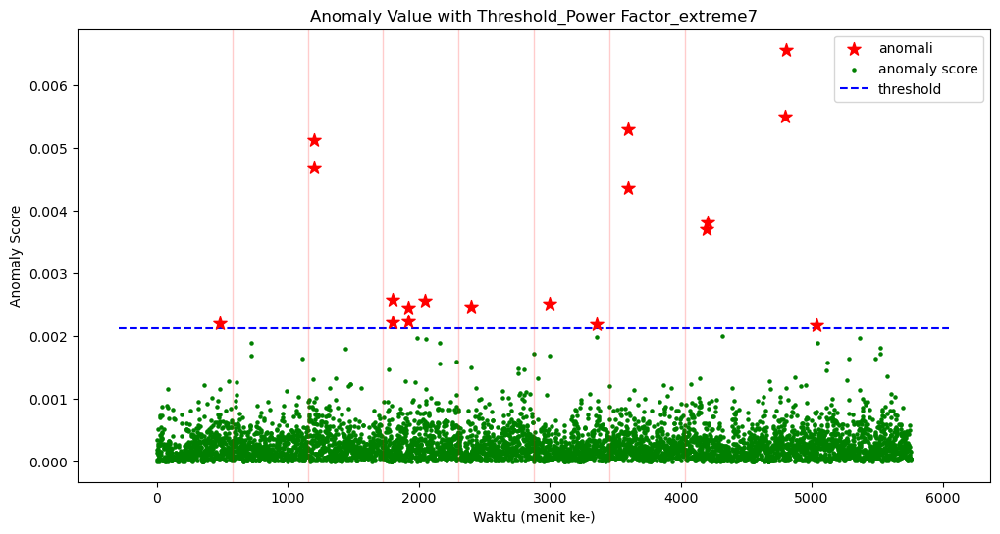

plot/Anomaly Value with Threshold_Power Factor_extreme7.jpg


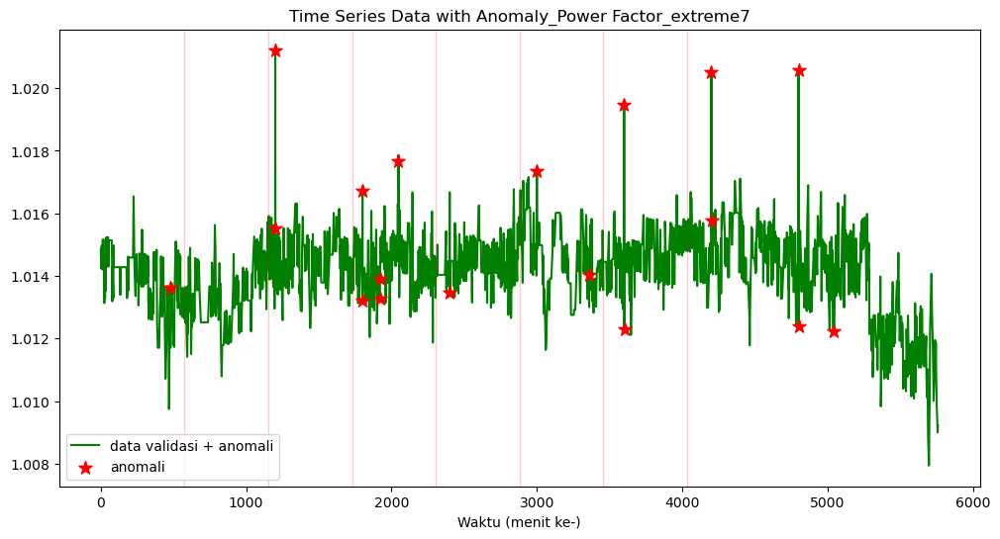

plot/Time Series Data with Anomaly_Power Factor_extreme7.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  7
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:21:00.968955
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Reactive Power _ extreme 7
| > Sensor Start Time:  2023-05-19 08:21:00.968955 



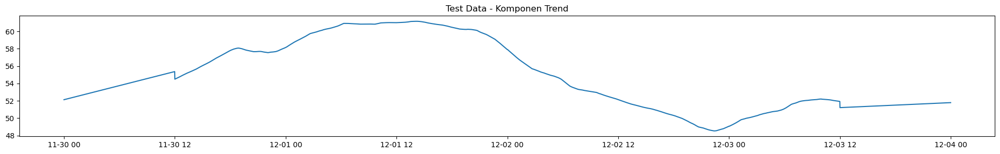

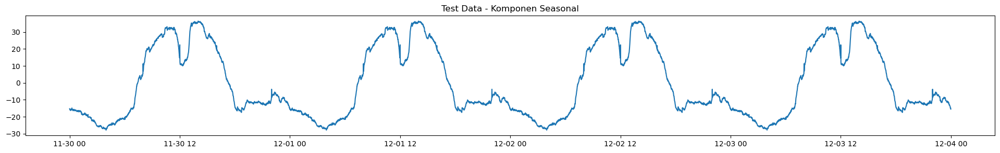

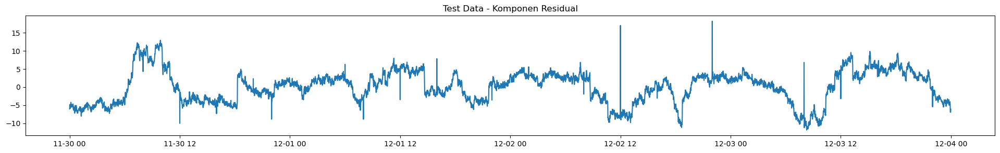

180/180 [==============================] - 1s 1ms/step


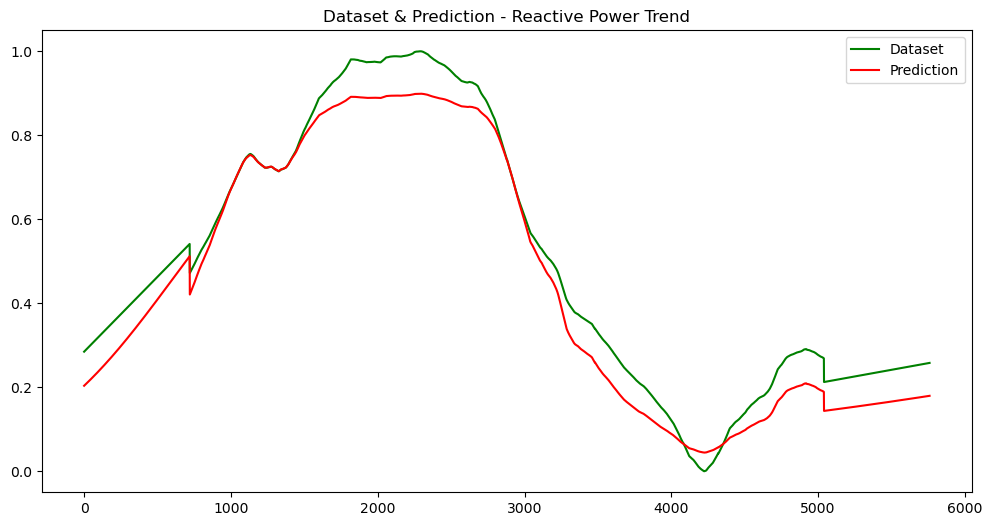

plot/Dataset & Prediction_Reactive Power_Trend.jpg
180/180 [==============================] - 1s 2ms/step


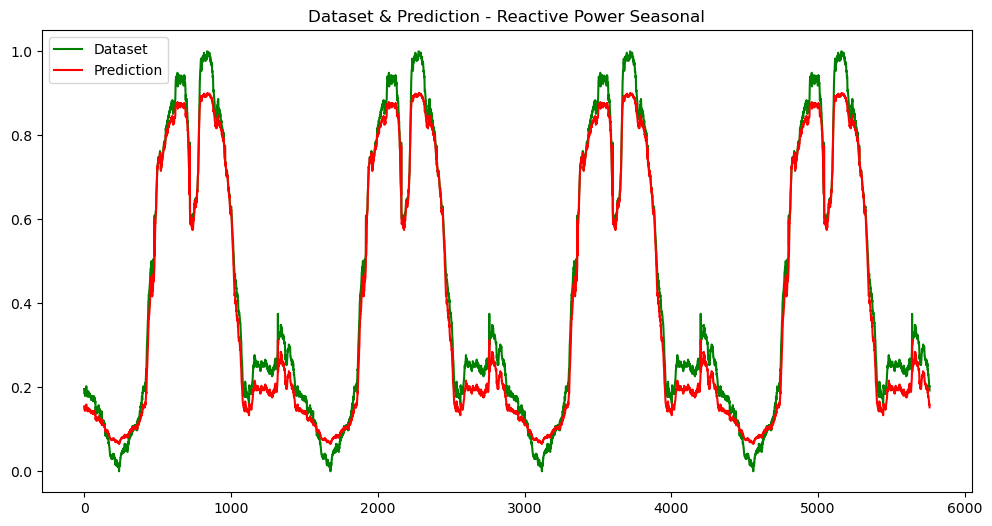

plot/Dataset & Prediction_Reactive Power_Seasonal.jpg
180/180 [==============================] - 1s 2ms/step


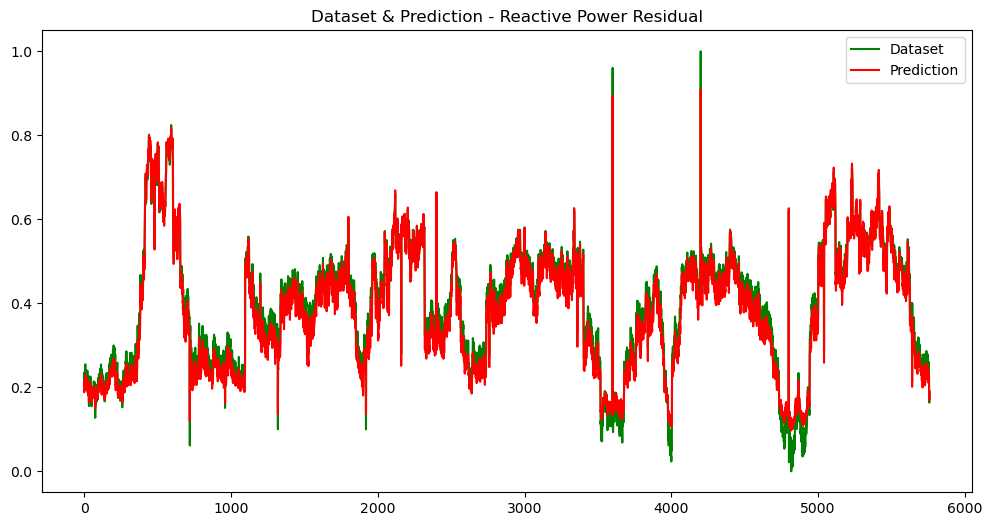

plot/Dataset & Prediction_Reactive Power_Residual.jpg


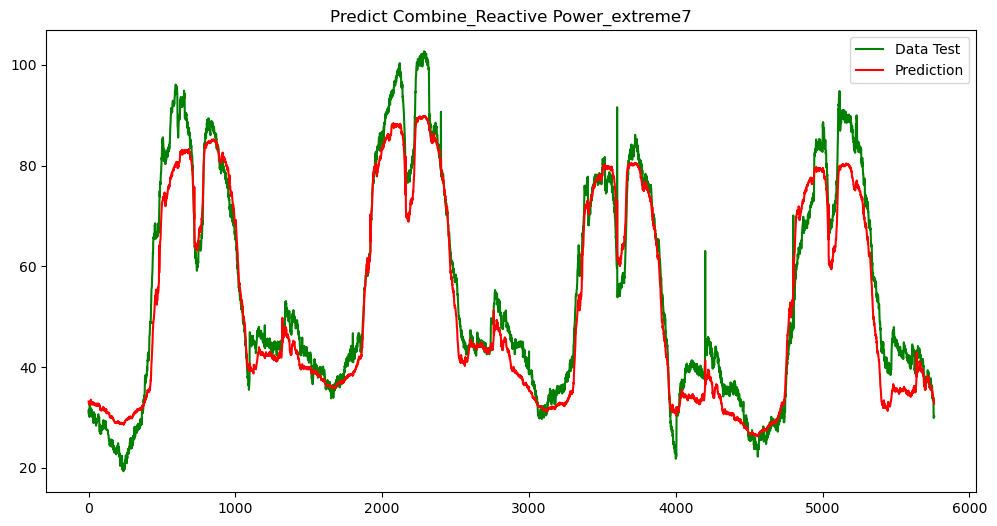

plot/Predict Combine_Reactive Power_extreme7.jpg
| > errorsDF:  [2.33744431 1.2905941  1.48469925 ... 3.19508934 3.0697403  2.55769539]
| > RSME:  5.510996578693402
| > MSE:  30.37108329037038
| > MAE:  4.459388891930042
Threshold:  6.691863129916062


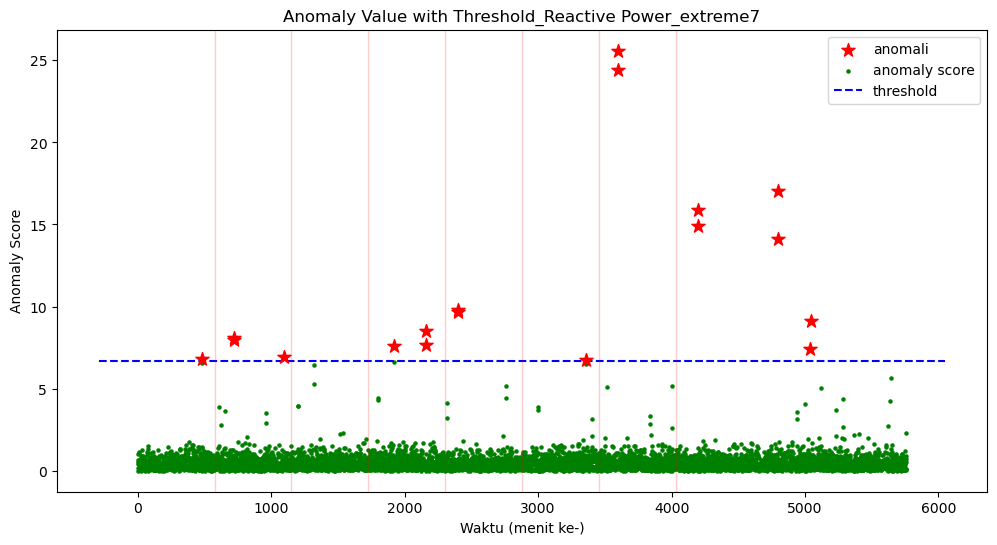

plot/Anomaly Value with Threshold_Reactive Power_extreme7.jpg


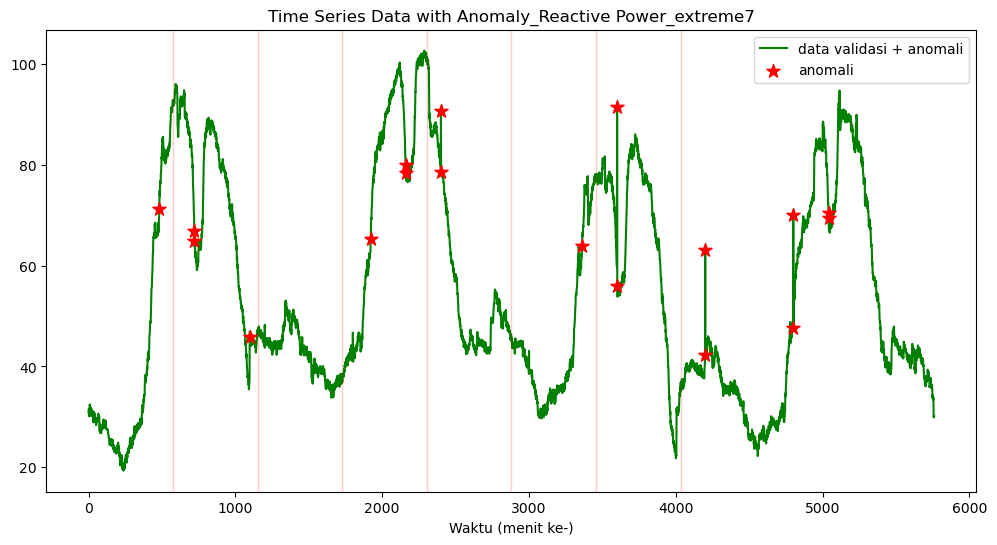

plot/Time Series Data with Anomaly_Reactive Power_extreme7.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  7
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:21:10.369467
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Generator Gross Capacity _ extreme 7
| > Sensor Start Time:  2023-05-19 08:21:10.369467 



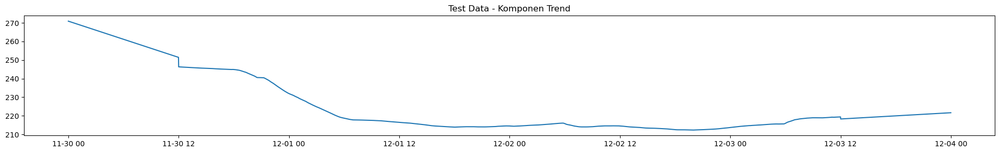

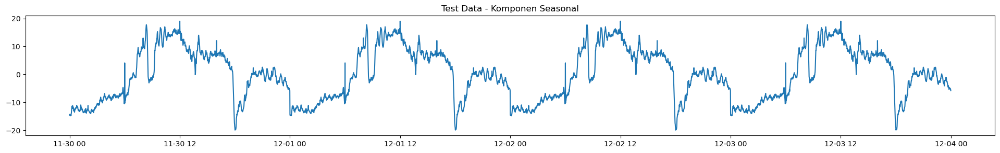

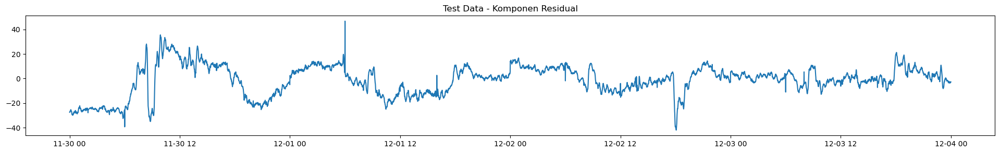

180/180 [==============================] - 1s 1ms/step


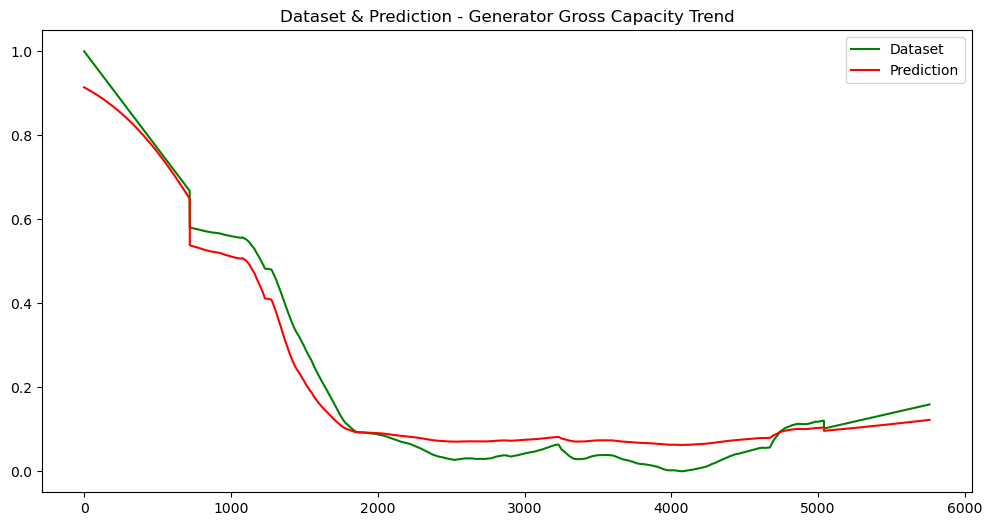

plot/Dataset & Prediction_Generator Gross Capacity_Trend.jpg
180/180 [==============================] - 1s 2ms/step


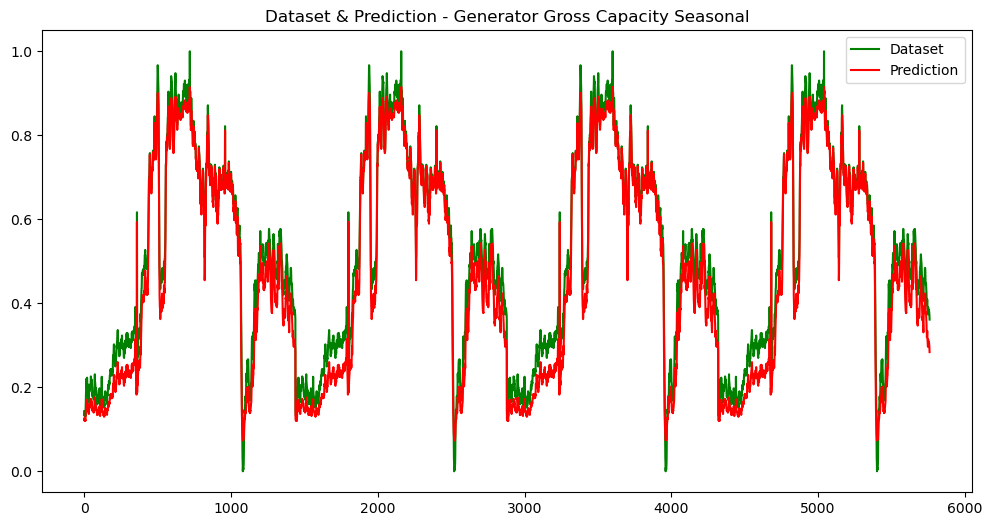

plot/Dataset & Prediction_Generator Gross Capacity_Seasonal.jpg
180/180 [==============================] - 1s 2ms/step


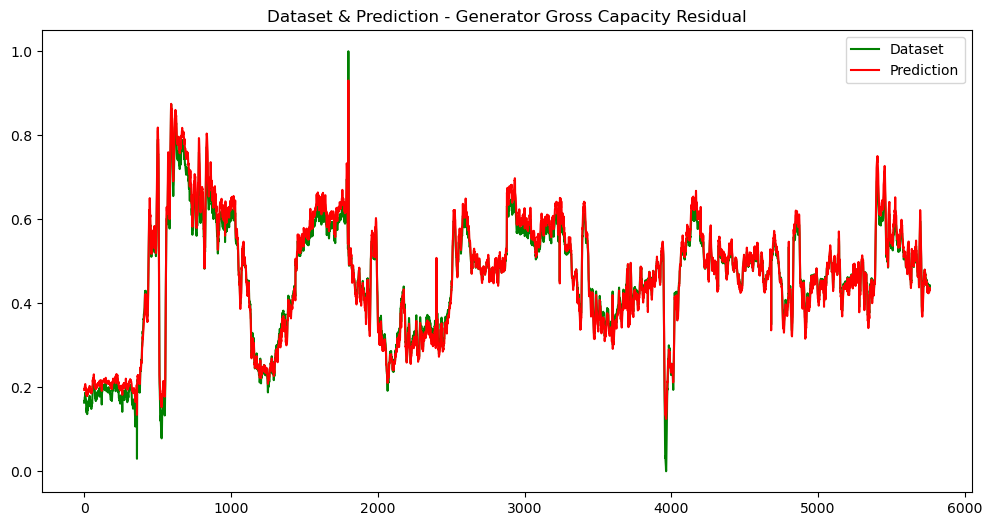

plot/Dataset & Prediction_Generator Gross Capacity_Residual.jpg


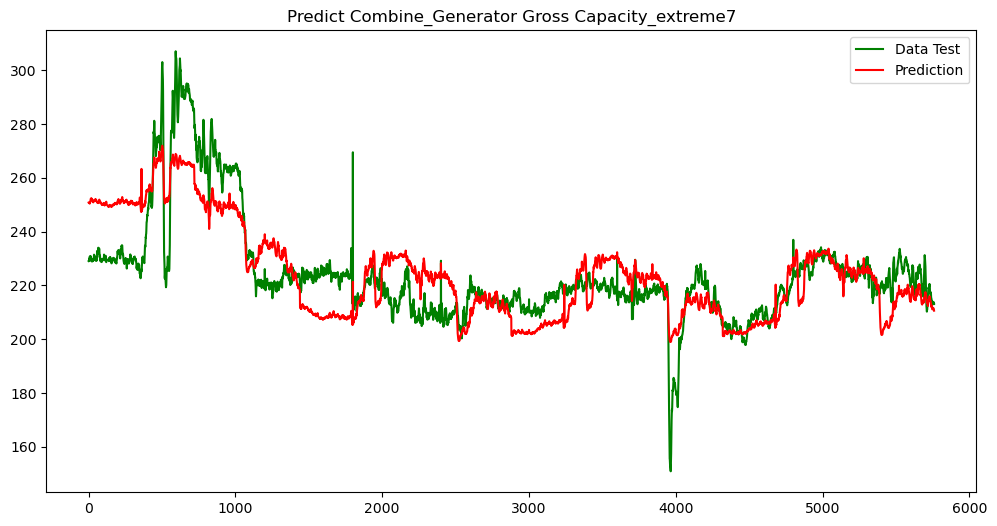

plot/Predict Combine_Generator Gross Capacity_extreme7.jpg
| > errorsDF:  [21.73326492 21.51654344 21.57692054 ...  2.49625107  1.977087
  2.4536619 ]
| > RSME:  12.167902325993689
| > MSE:  148.0578470149226
| > MAE:  9.722797123336786
Threshold:  7.2977824102153726


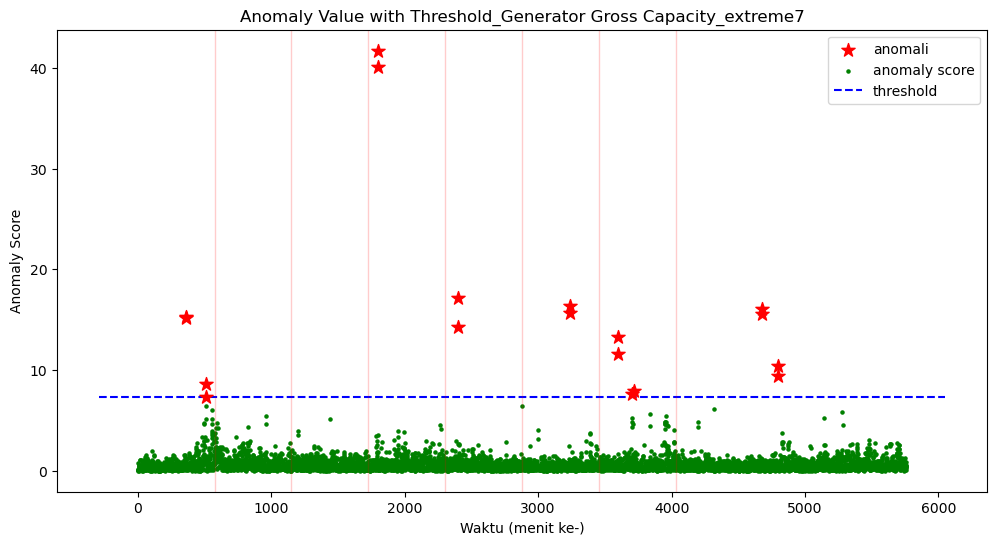

plot/Anomaly Value with Threshold_Generator Gross Capacity_extreme7.jpg


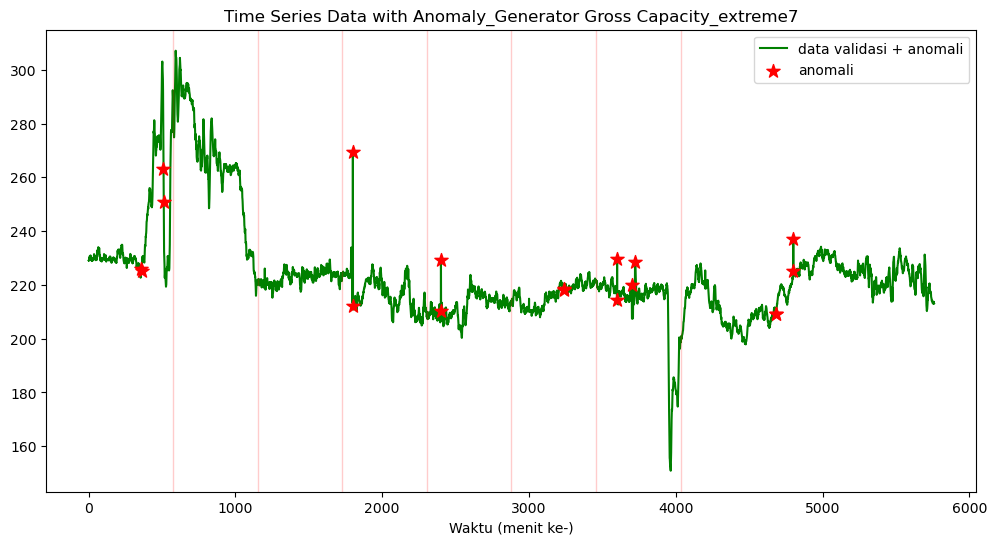

plot/Time Series Data with Anomaly_Generator Gross Capacity_extreme7.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  7
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:21:19.145417
| ========================================================================================== |



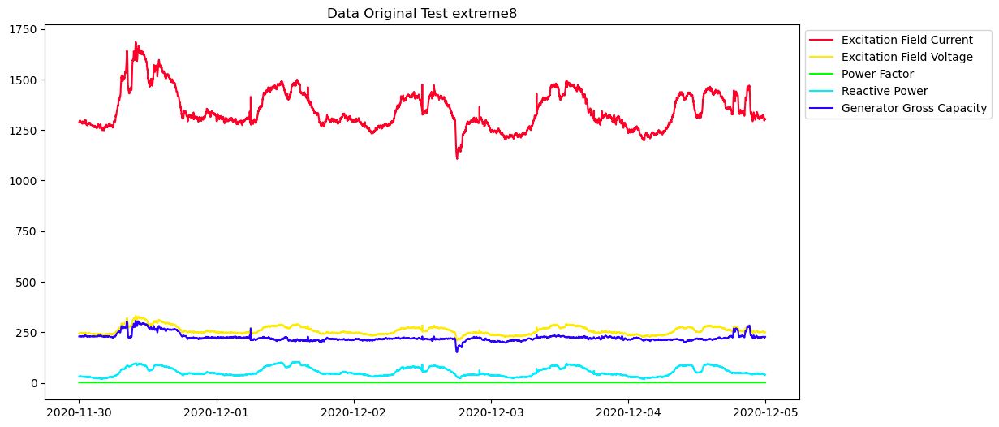


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 8
| > Sensor Start Time:  2023-05-19 08:21:22.361415 



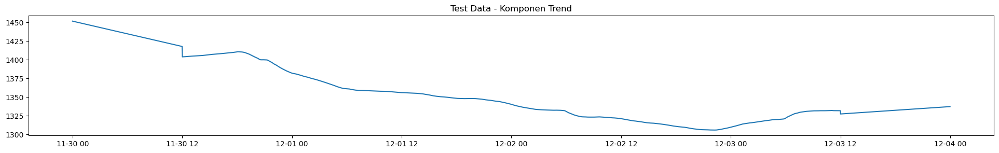

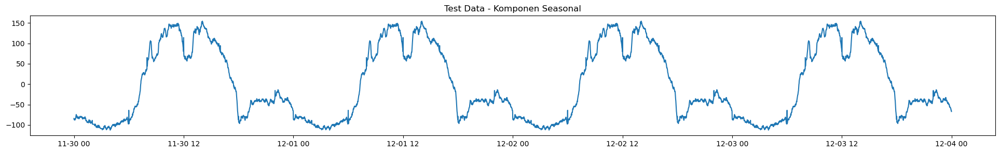

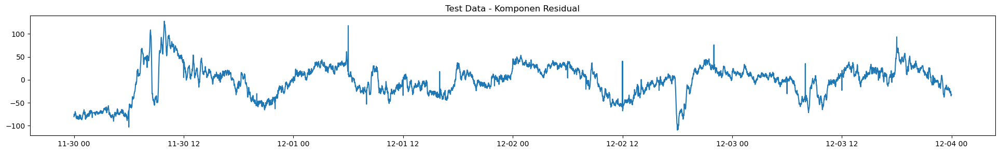

180/180 [==============================] - 1s 2ms/step


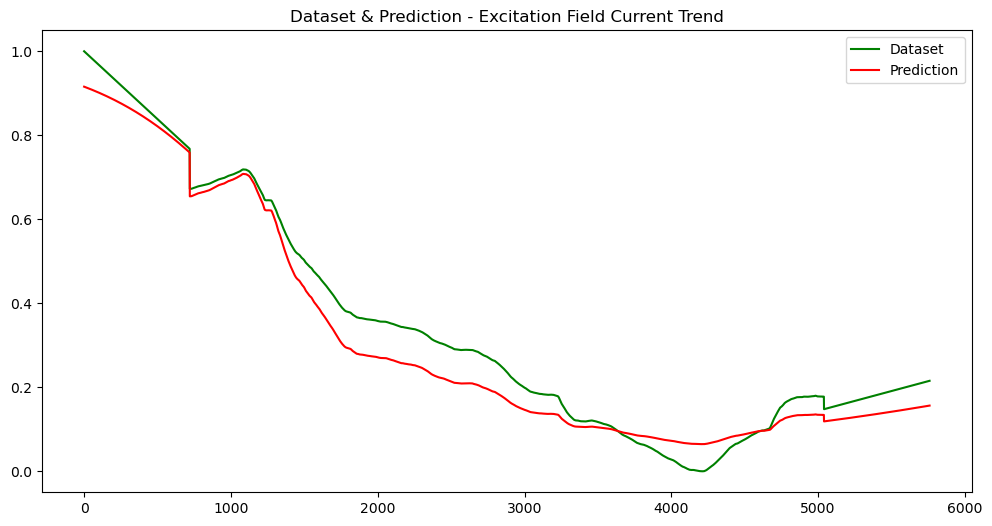

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 2ms/step


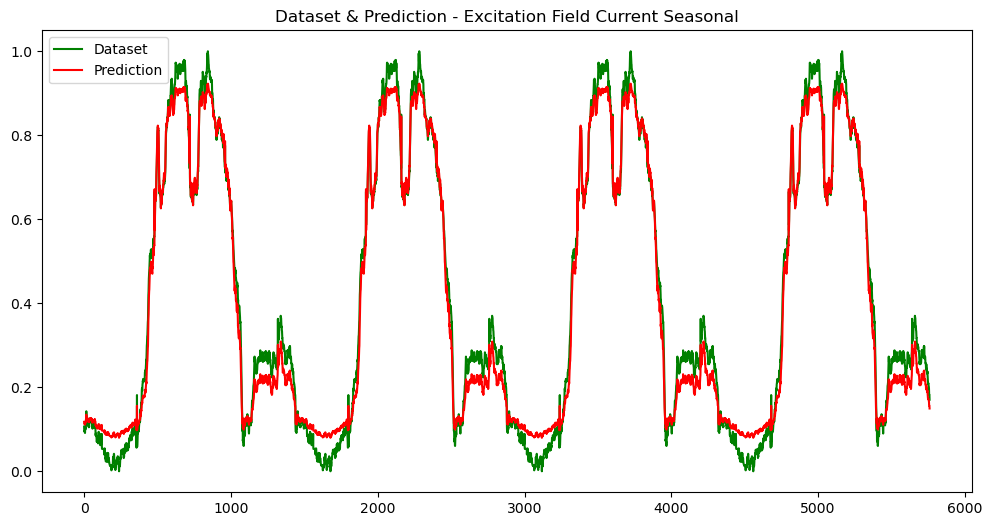

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 2ms/step


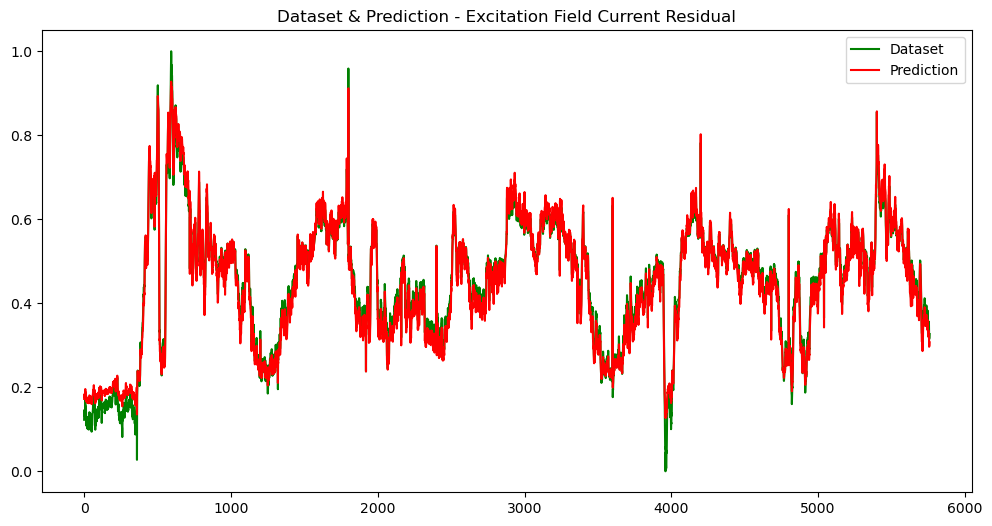

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


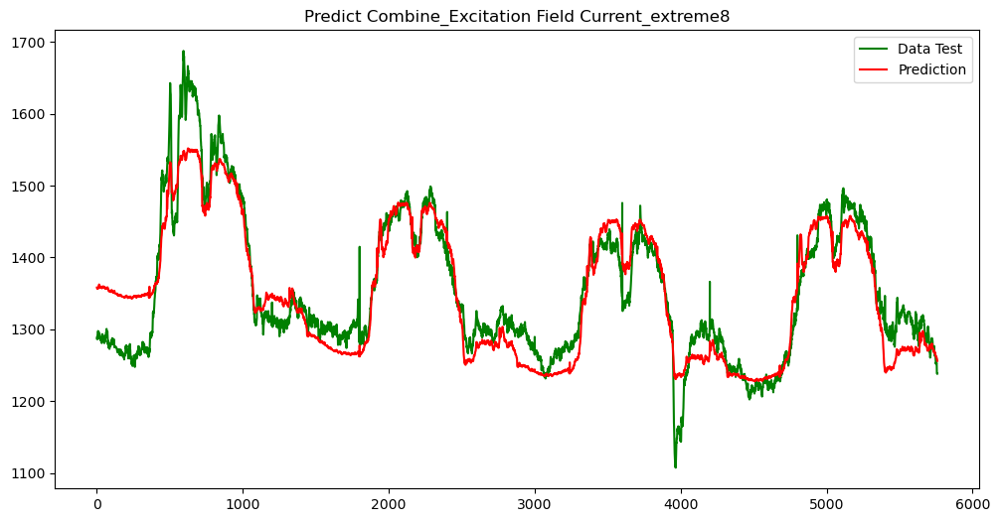

plot/Predict Combine_Excitation Field Current_extreme8.jpg
| > errorsDF:  [71.05370335 67.28019707 67.70659591 ... 18.80821987 18.55730447
 17.78171533]
| > RSME:  36.22730645789644
| > MSE:  1312.417733194345
| > MAE:  28.413109842855626
Threshold:  31.423407974543764


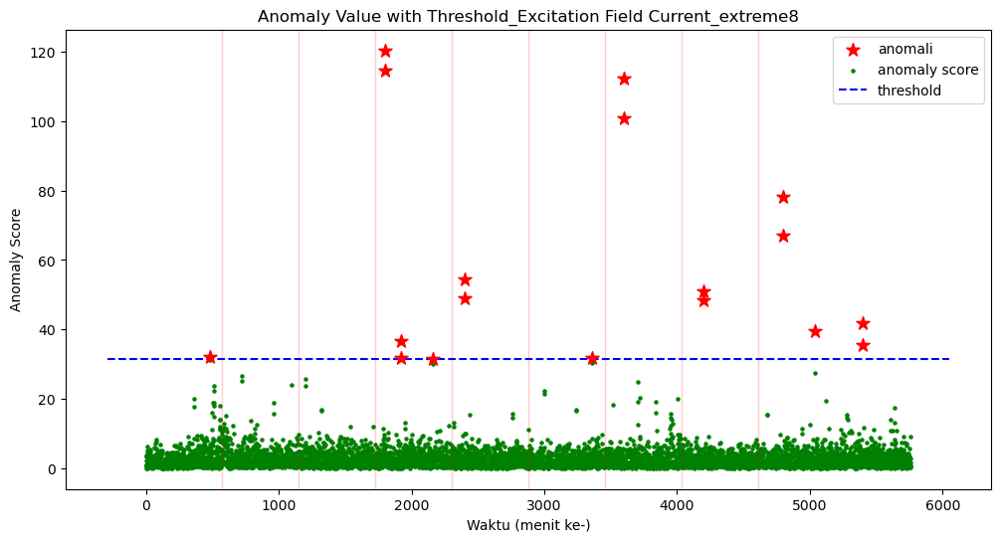

plot/Anomaly Value with Threshold_Excitation Field Current_extreme8.jpg


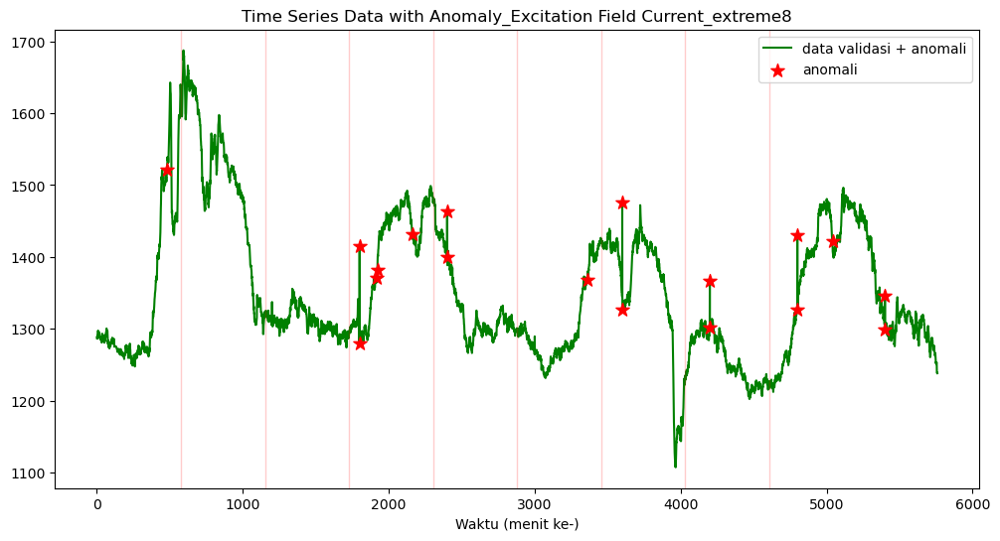

plot/Time Series Data with Anomaly_Excitation Field Current_extreme8.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  8
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:21:31.201581
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Excitation Field Voltage _ extreme 8
| > Sensor Start Time:  2023-05-19 08:21:31.201581 



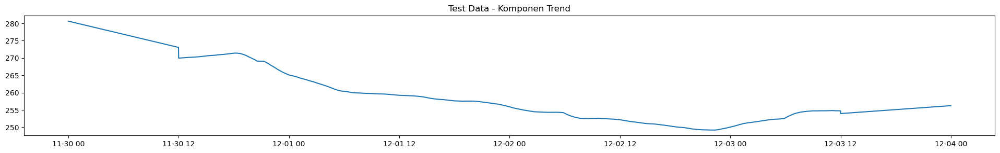

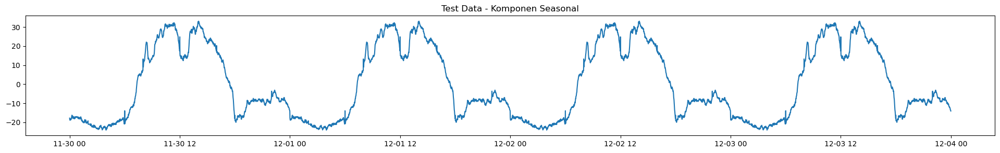

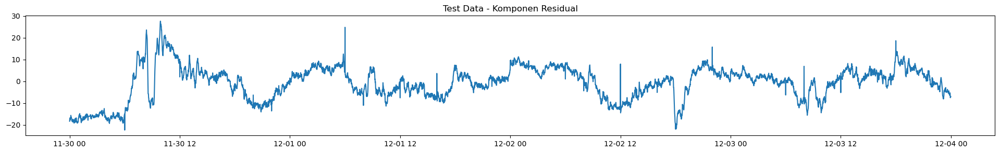

180/180 [==============================] - 1s 1ms/step


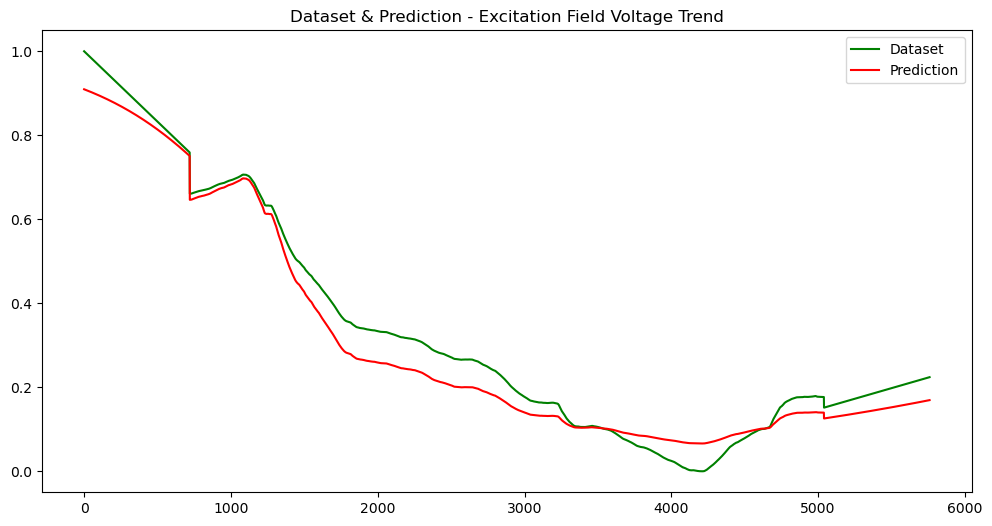

plot/Dataset & Prediction_Excitation Field Voltage_Trend.jpg
180/180 [==============================] - 1s 1ms/step


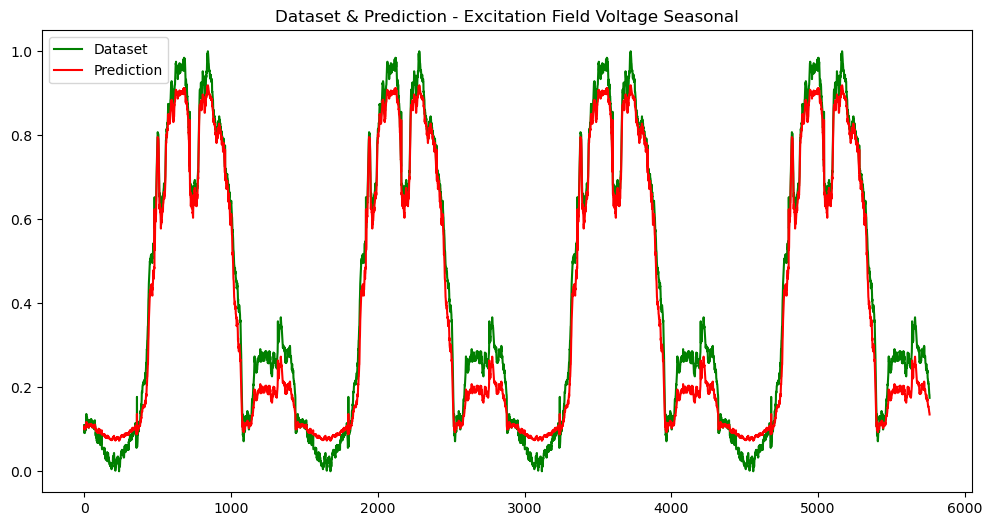

plot/Dataset & Prediction_Excitation Field Voltage_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


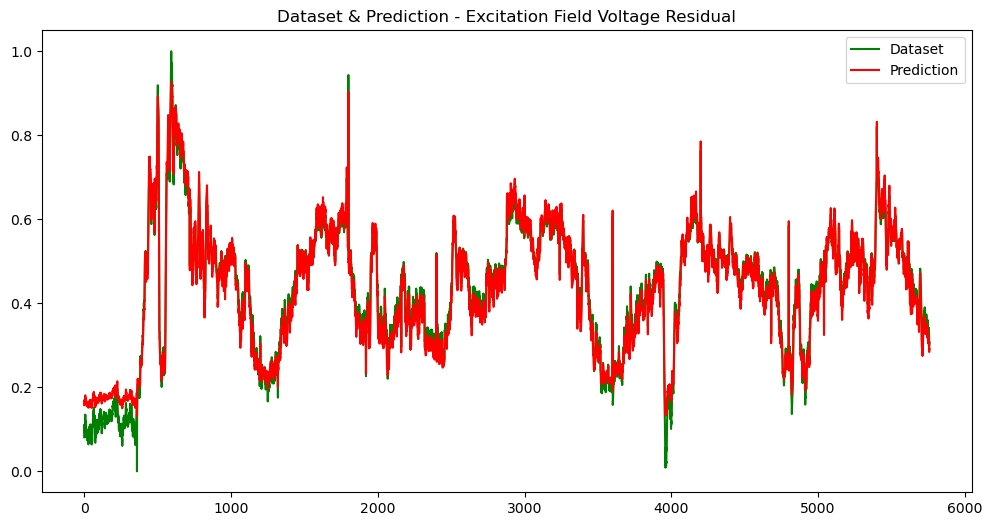

plot/Dataset & Prediction_Excitation Field Voltage_Residual.jpg


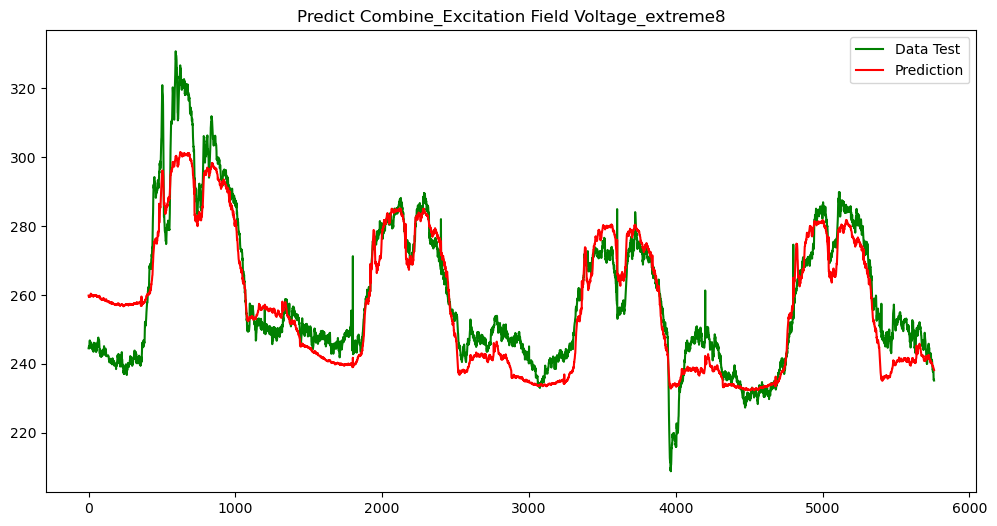

plot/Predict Combine_Excitation Field Voltage_extreme8.jpg
| > errorsDF:  [15.30105405 14.64023208 14.50780301 ...  3.08093641  2.96698193
  3.04064365]
| > RSME:  8.041801190403651
| > MSE:  64.6705663859776
| > MAE:  6.428912425005951
Threshold:  6.915665416271418


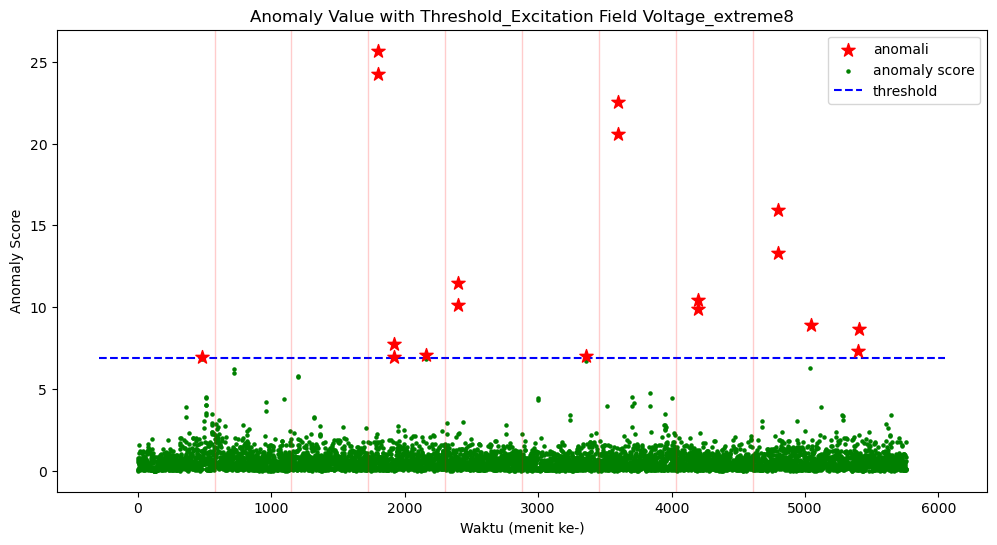

plot/Anomaly Value with Threshold_Excitation Field Voltage_extreme8.jpg


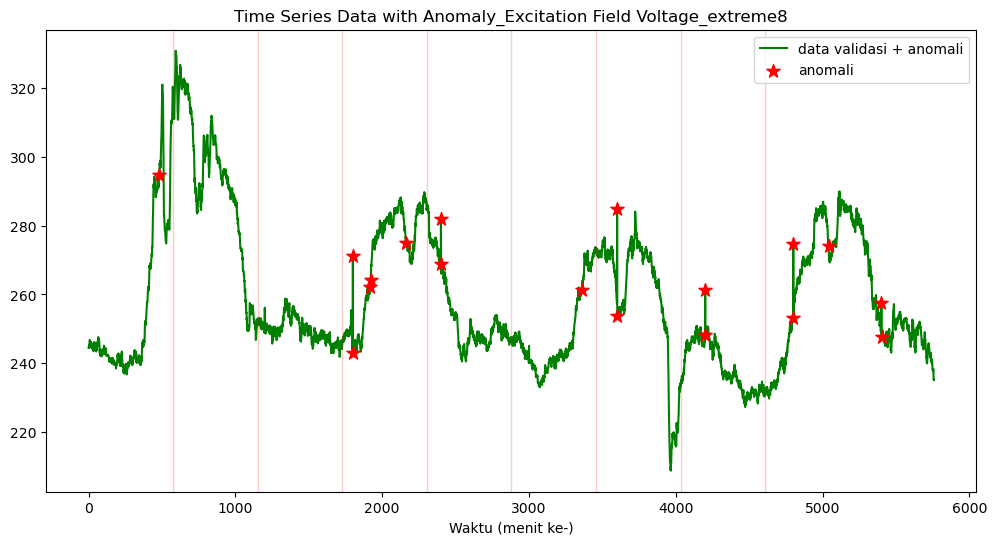

plot/Time Series Data with Anomaly_Excitation Field Voltage_extreme8.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  8
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:21:39.910916
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Power Factor _ extreme 8
| > Sensor Start Time:  2023-05-19 08:21:39.910916 



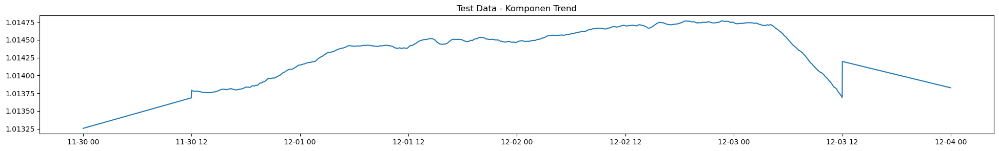

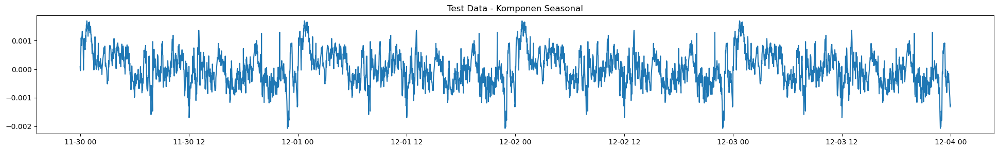

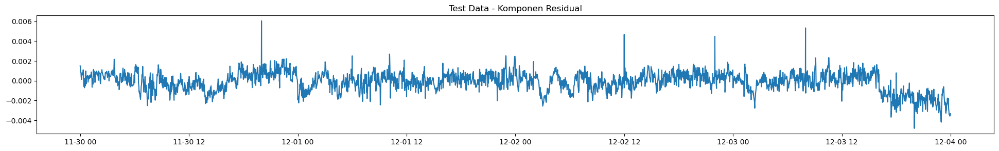

180/180 [==============================] - 1s 2ms/step


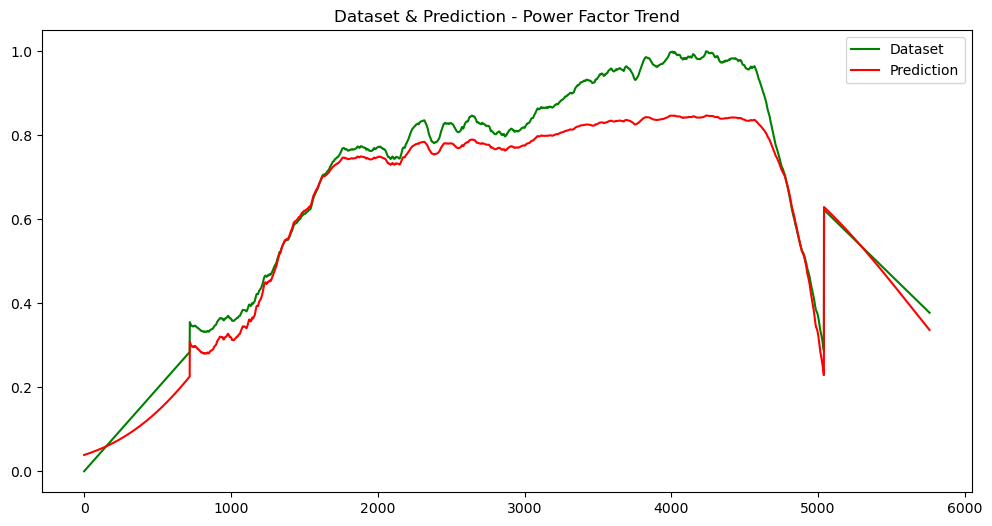

plot/Dataset & Prediction_Power Factor_Trend.jpg
180/180 [==============================] - 1s 1ms/step


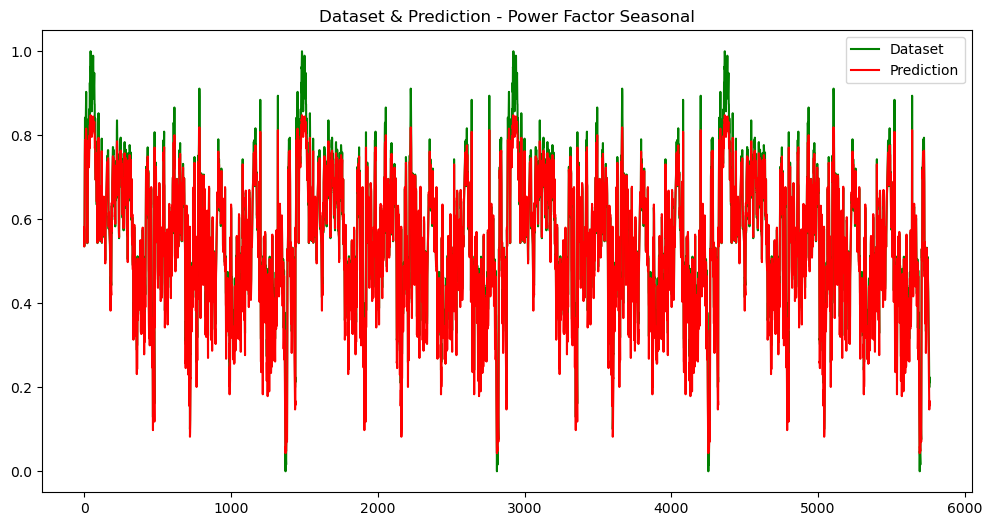

plot/Dataset & Prediction_Power Factor_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


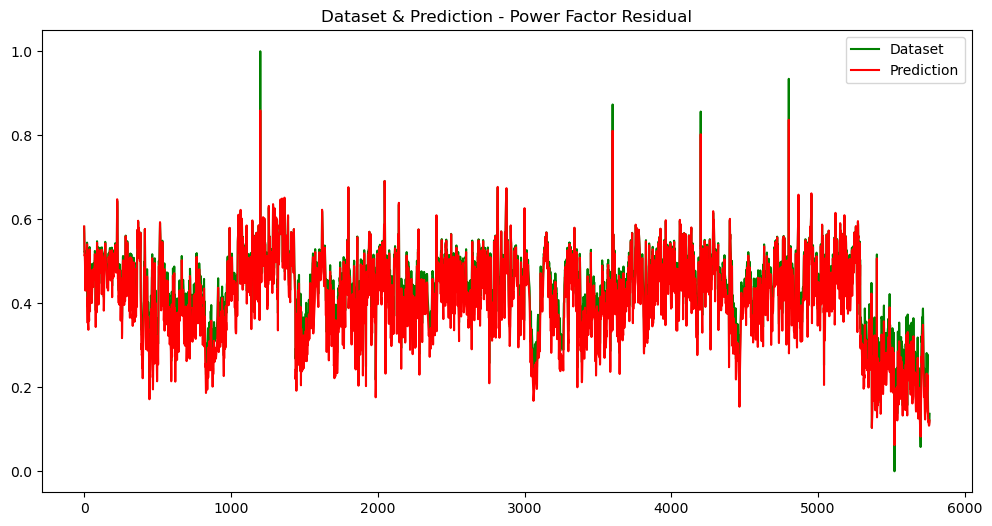

plot/Dataset & Prediction_Power Factor_Residual.jpg


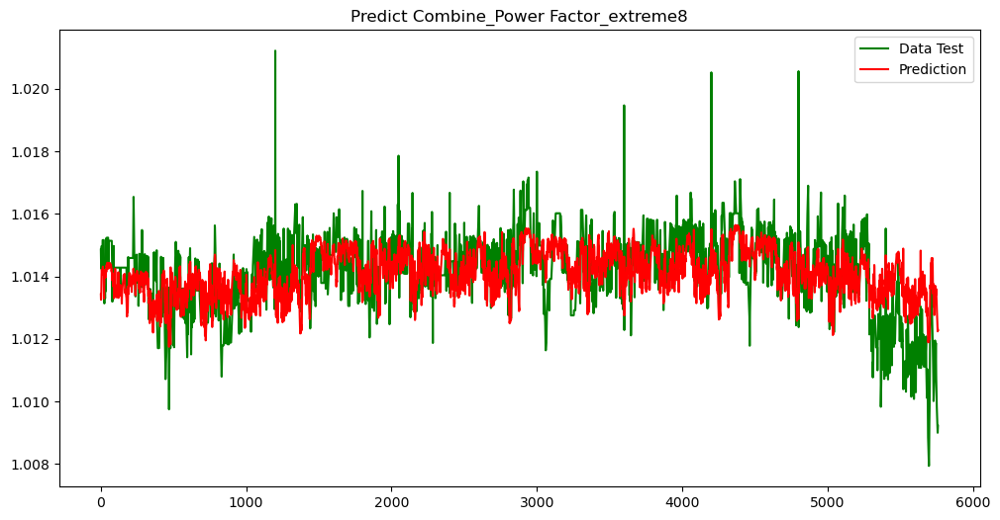

plot/Predict Combine_Power Factor_extreme8.jpg
| > errorsDF:  [0.00142993 0.00129416 0.00095202 ... 0.0032421  0.00320698 0.0030548 ]
| > RSME:  0.000957529323593648
| > MSE:  9.168624055417091e-07
| > MAE:  0.0007463193938900051
Threshold:  0.0021995103786816017


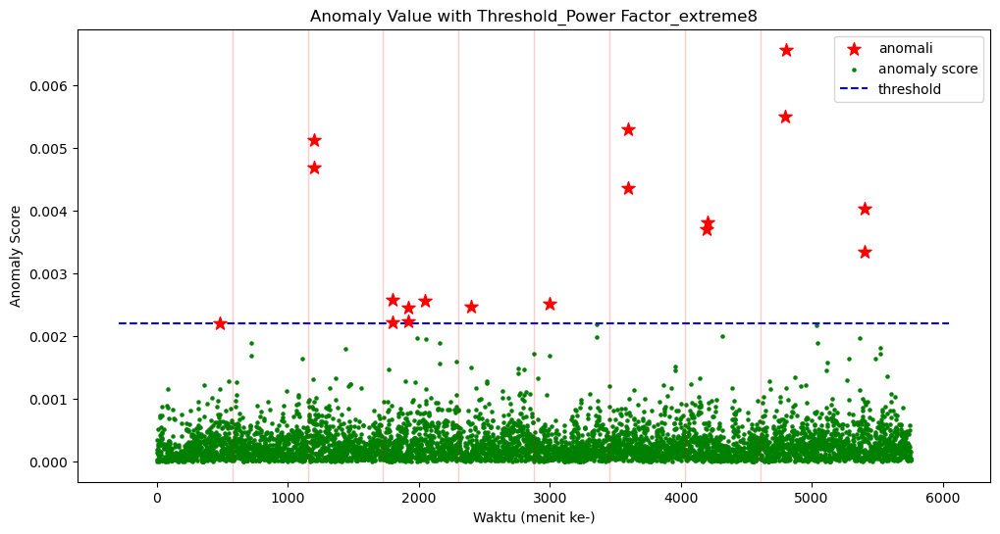

plot/Anomaly Value with Threshold_Power Factor_extreme8.jpg


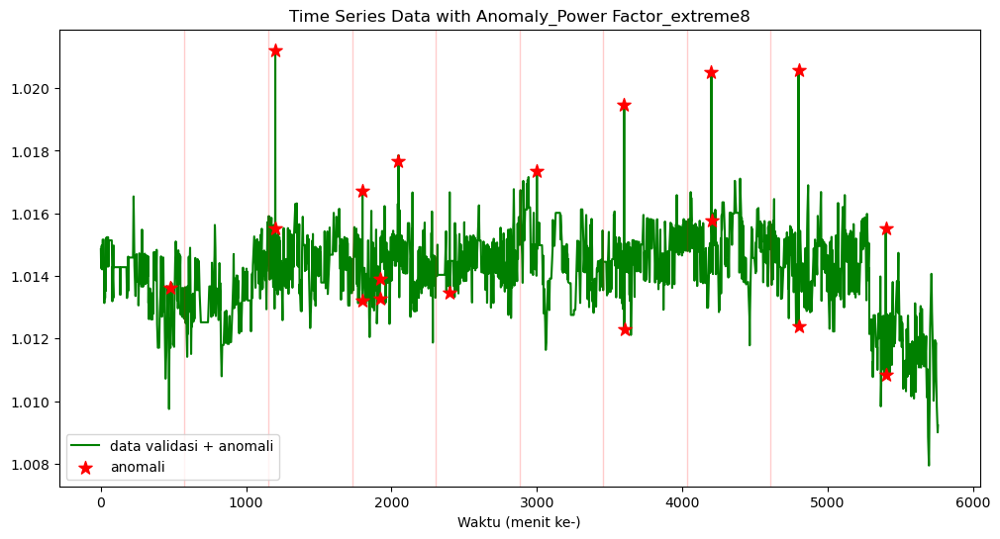

plot/Time Series Data with Anomaly_Power Factor_extreme8.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  8
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:21:49.395182
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Reactive Power _ extreme 8
| > Sensor Start Time:  2023-05-19 08:21:49.395182 



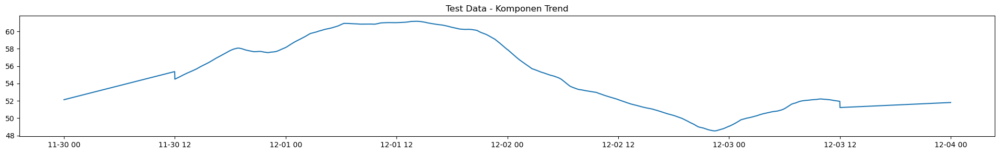

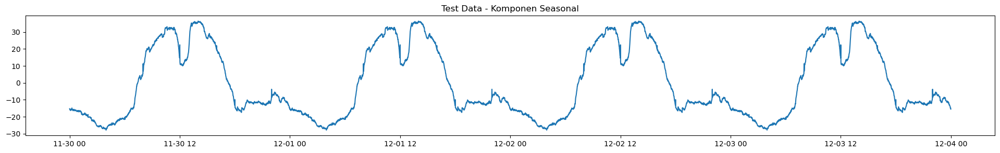

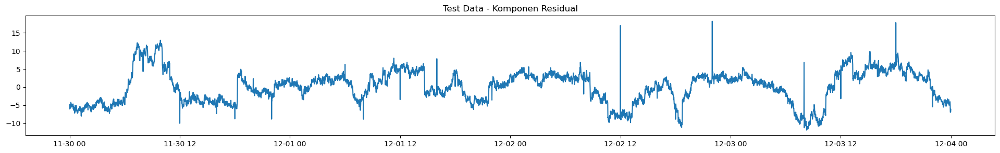

180/180 [==============================] - 1s 1ms/step


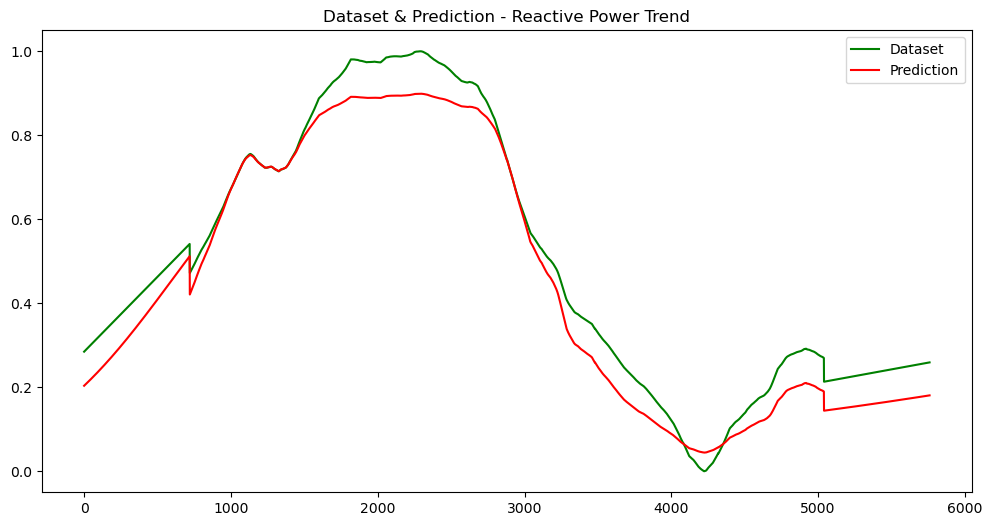

plot/Dataset & Prediction_Reactive Power_Trend.jpg
180/180 [==============================] - 1s 1ms/step


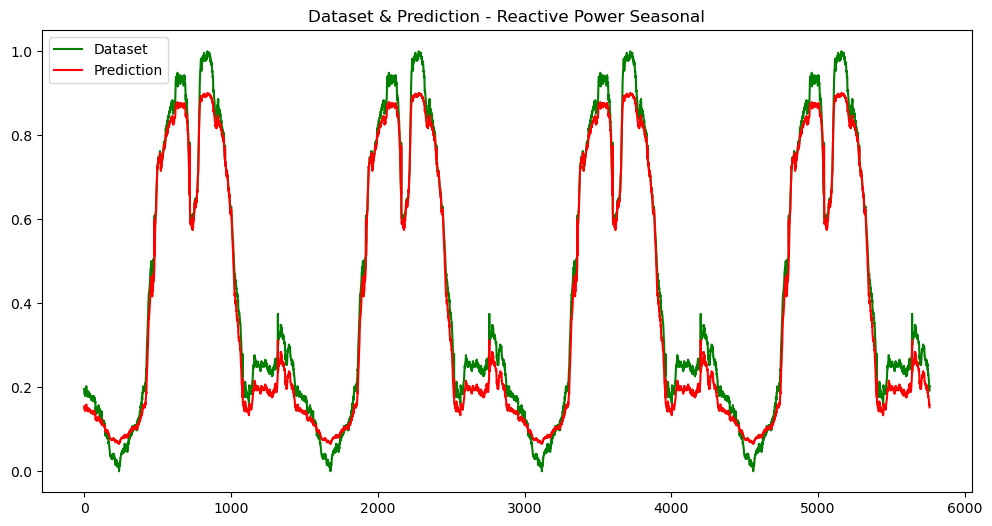

plot/Dataset & Prediction_Reactive Power_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


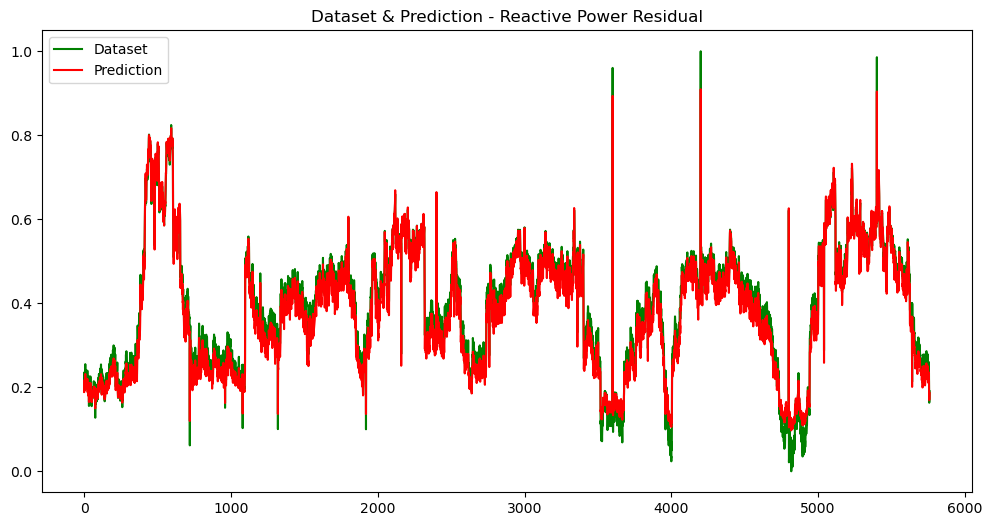

plot/Dataset & Prediction_Reactive Power_Residual.jpg


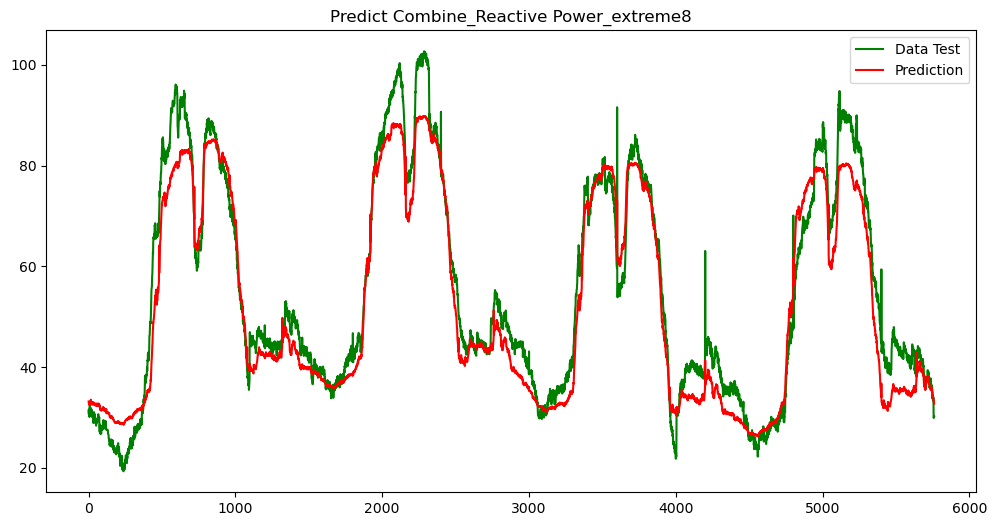

plot/Predict Combine_Reactive Power_extreme8.jpg
| > errorsDF:  [2.33687973 1.29001617 1.4841156  ... 3.20504952 3.0796814  2.56773567]
| > RSME:  5.517800516582621
| > MSE:  30.446122540799447
| > MAE:  4.46261429884135
Threshold:  6.893943890408701


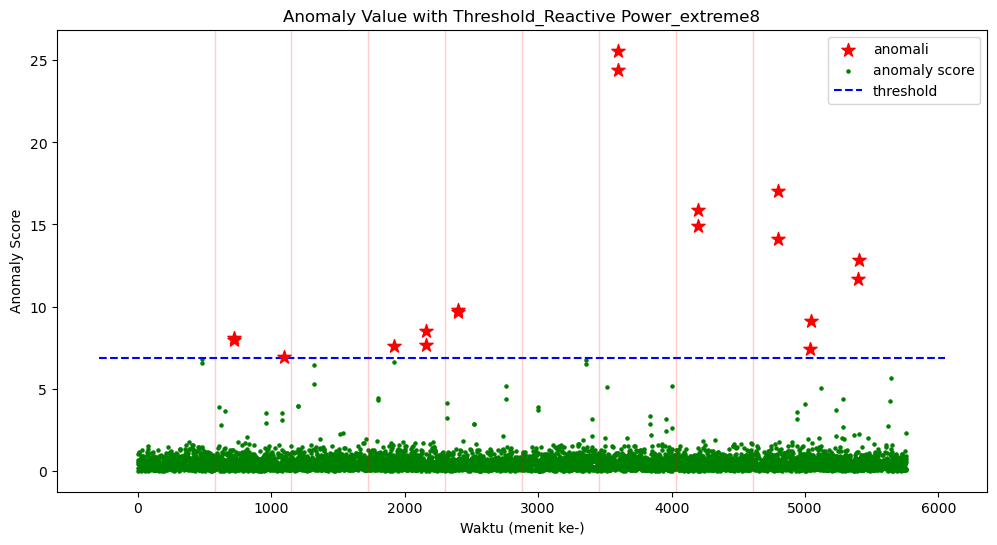

plot/Anomaly Value with Threshold_Reactive Power_extreme8.jpg


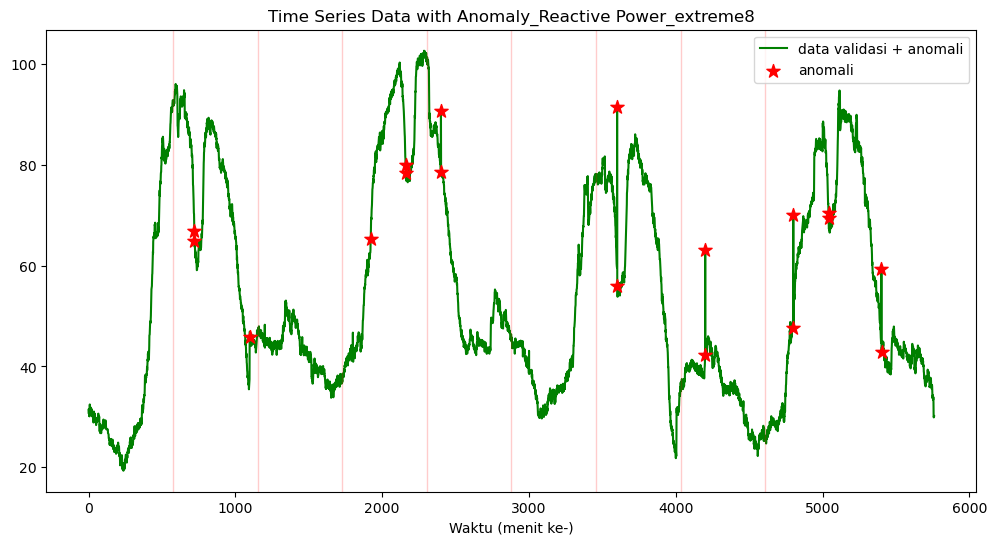

plot/Time Series Data with Anomaly_Reactive Power_extreme8.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  8
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:21:57.433255
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Generator Gross Capacity _ extreme 8
| > Sensor Start Time:  2023-05-19 08:21:57.433255 



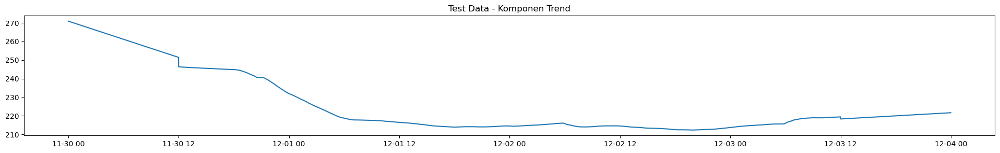

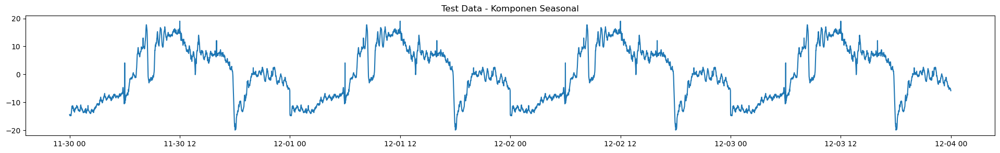

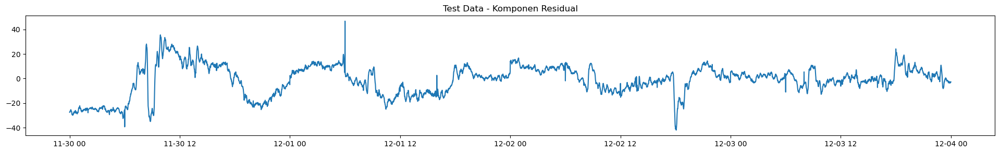

180/180 [==============================] - 1s 1ms/step


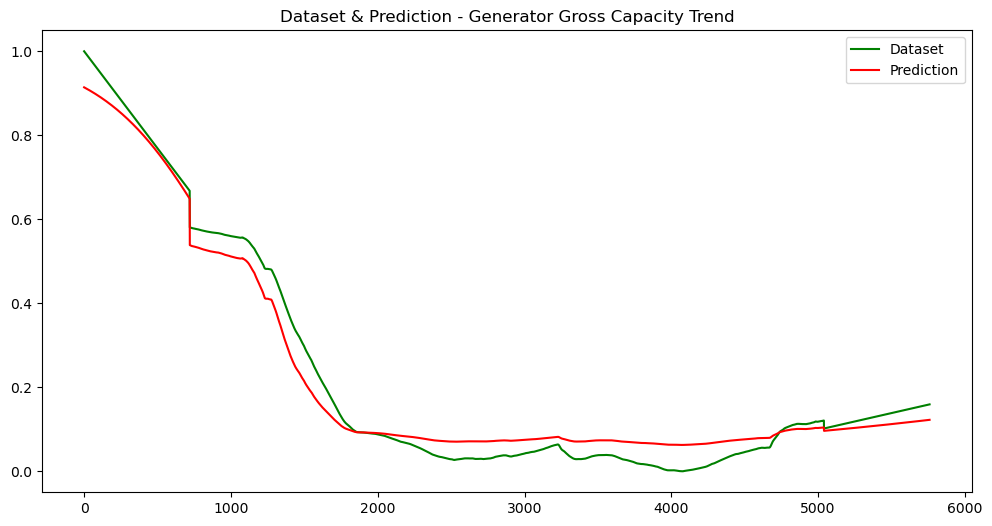

plot/Dataset & Prediction_Generator Gross Capacity_Trend.jpg
180/180 [==============================] - 1s 2ms/step


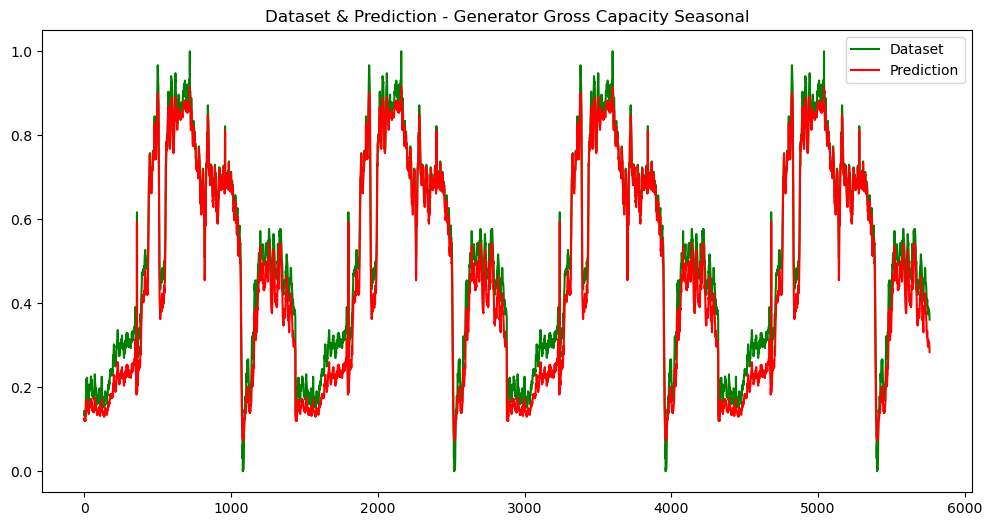

plot/Dataset & Prediction_Generator Gross Capacity_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


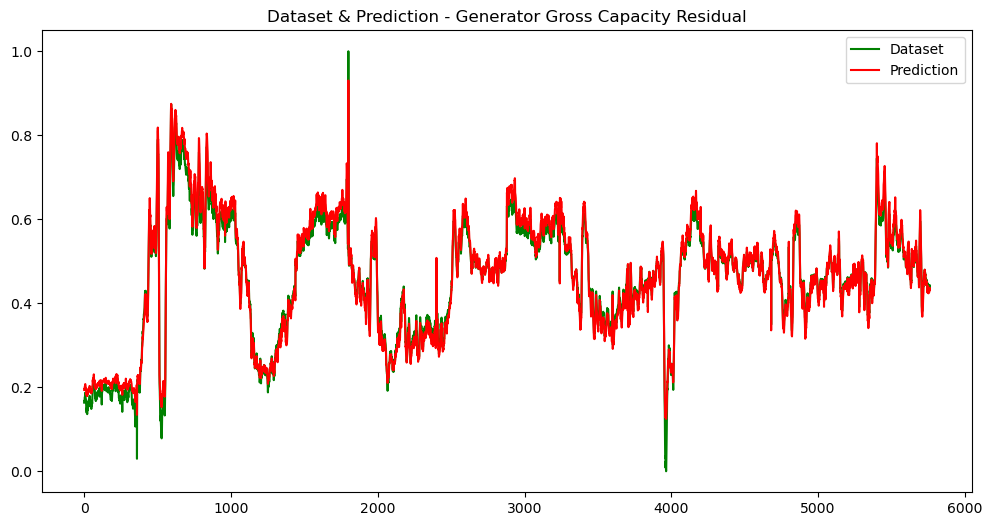

plot/Dataset & Prediction_Generator Gross Capacity_Residual.jpg


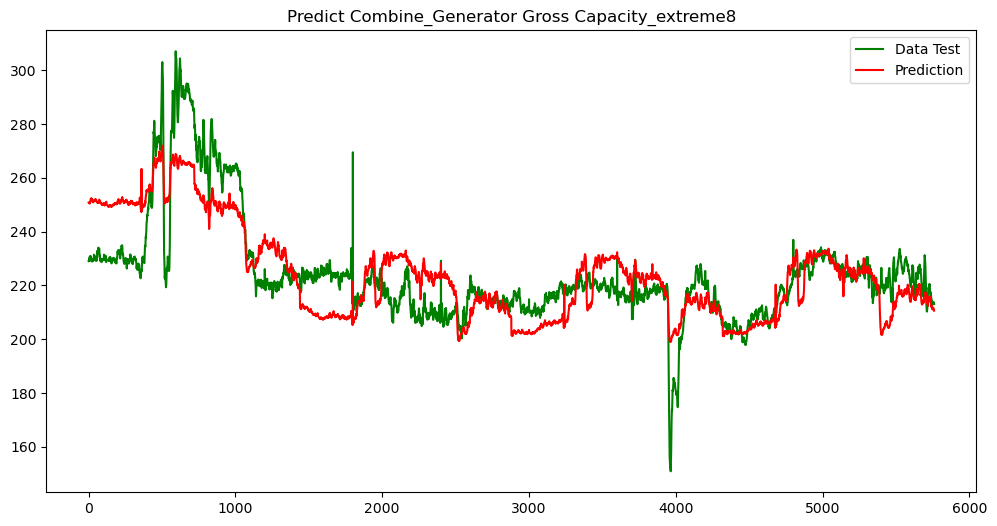

plot/Predict Combine_Generator Gross Capacity_extreme8.jpg
| > errorsDF:  [21.73244858 21.51571088 21.57608226 ...  2.49495216  1.97579764
  2.45234773]
| > RSME:  12.169786013946283
| > MSE:  148.10369162524253
| > MAE:  9.723655341054753
Threshold:  7.29776114280128


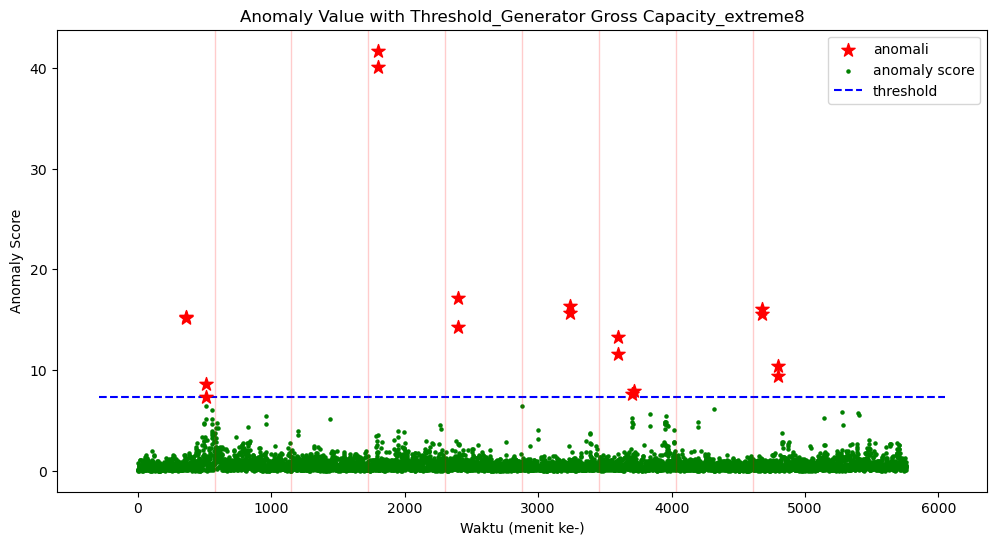

plot/Anomaly Value with Threshold_Generator Gross Capacity_extreme8.jpg


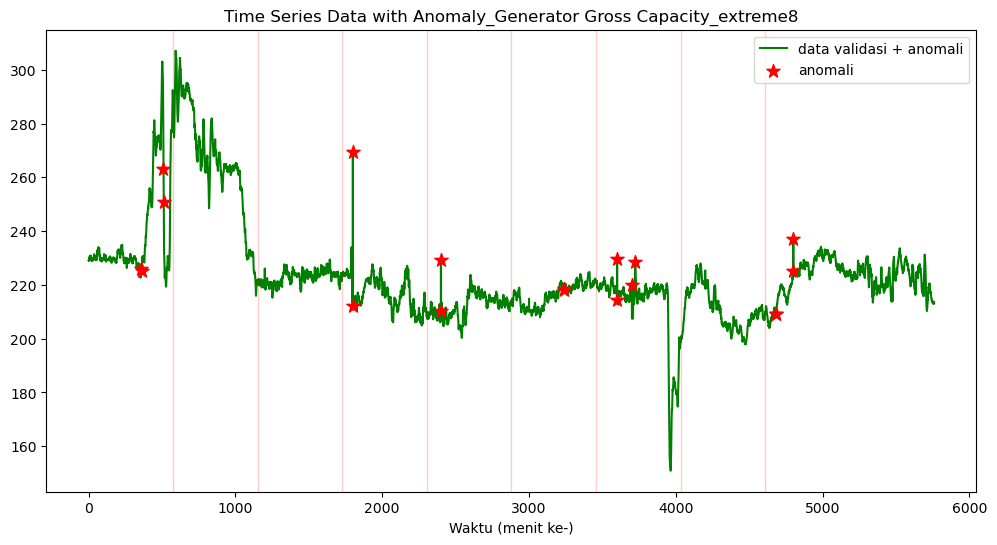

plot/Time Series Data with Anomaly_Generator Gross Capacity_extreme8.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  8
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:22:06.820194
| ========================================================================================== |



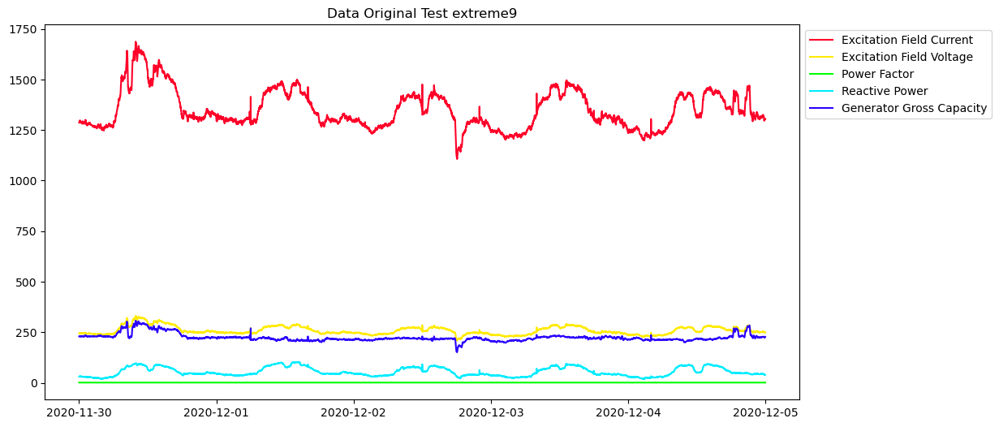


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 9
| > Sensor Start Time:  2023-05-19 08:22:10.370190 



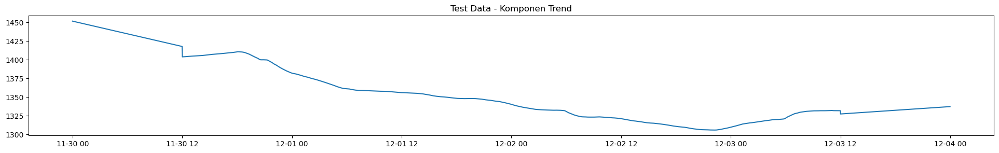

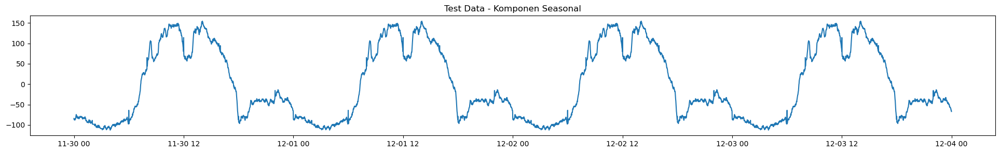

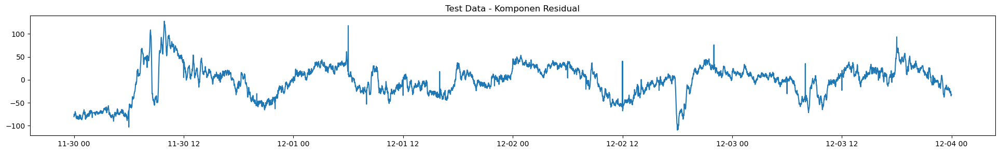

180/180 [==============================] - 1s 1ms/step


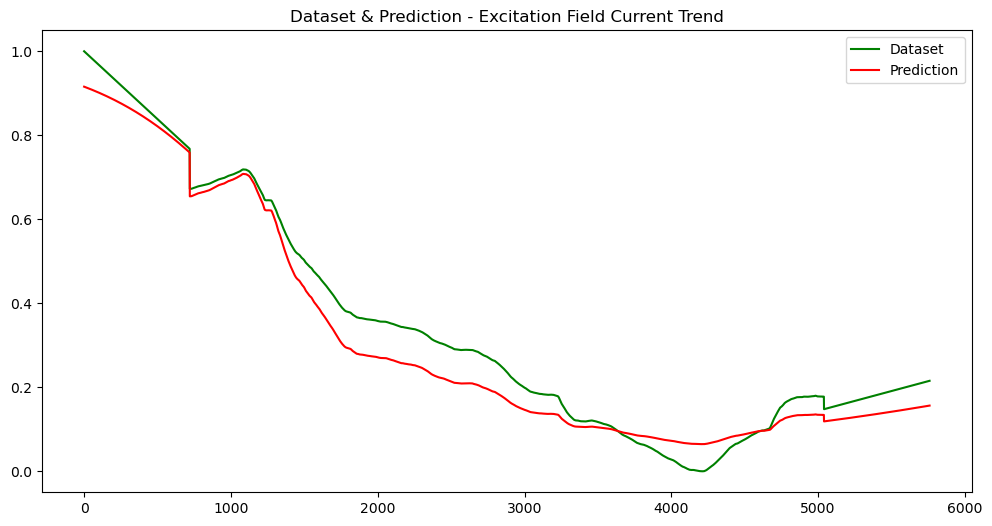

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 1ms/step


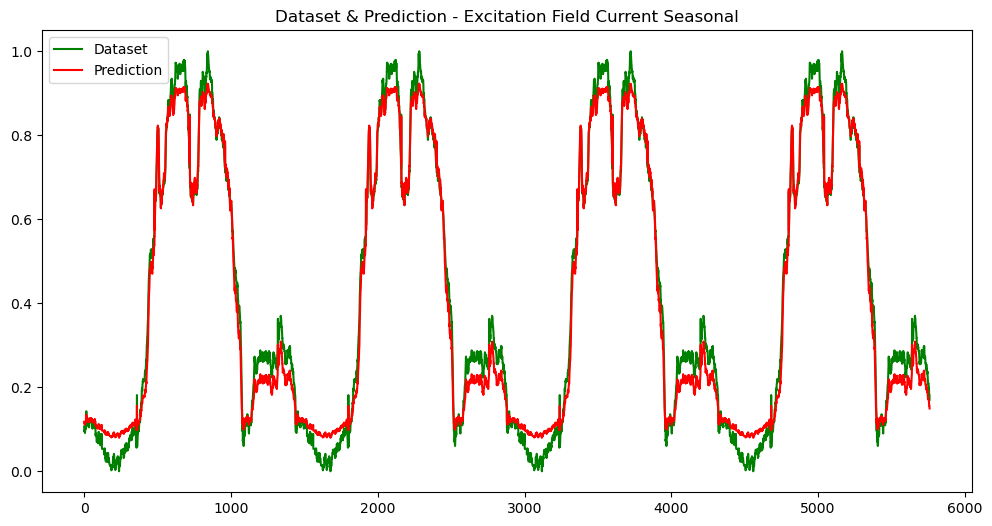

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


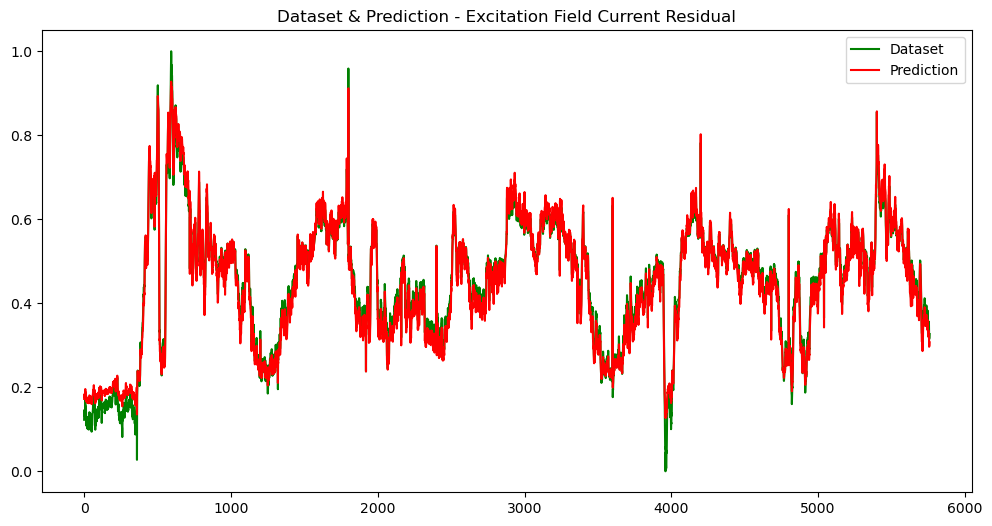

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


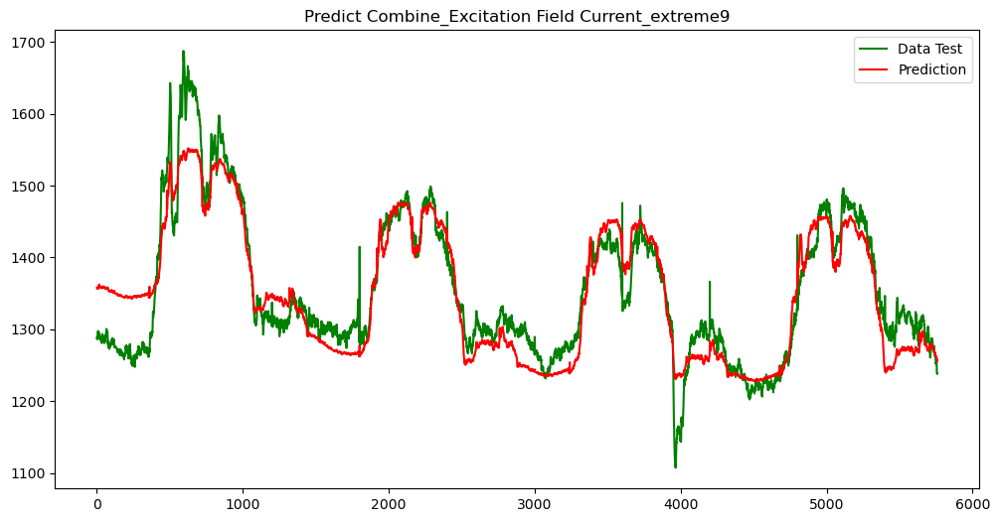

plot/Predict Combine_Excitation Field Current_extreme9.jpg
| > errorsDF:  [71.05370335 67.28019707 67.70659591 ... 18.80821987 18.55730447
 17.78171533]
| > RSME:  36.227305521090955
| > MSE:  1312.417665318467
| > MAE:  28.413108839183902
Threshold:  31.423407974543764


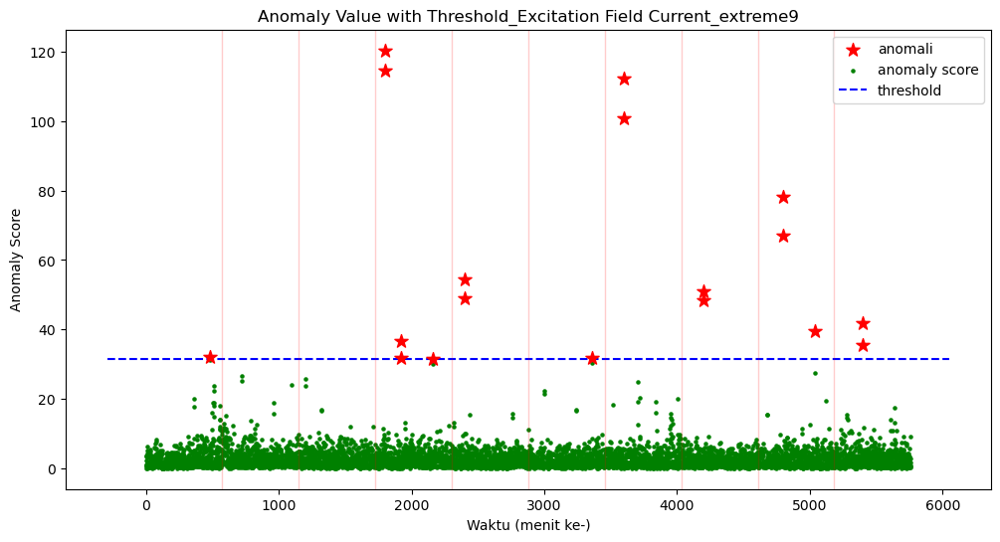

plot/Anomaly Value with Threshold_Excitation Field Current_extreme9.jpg


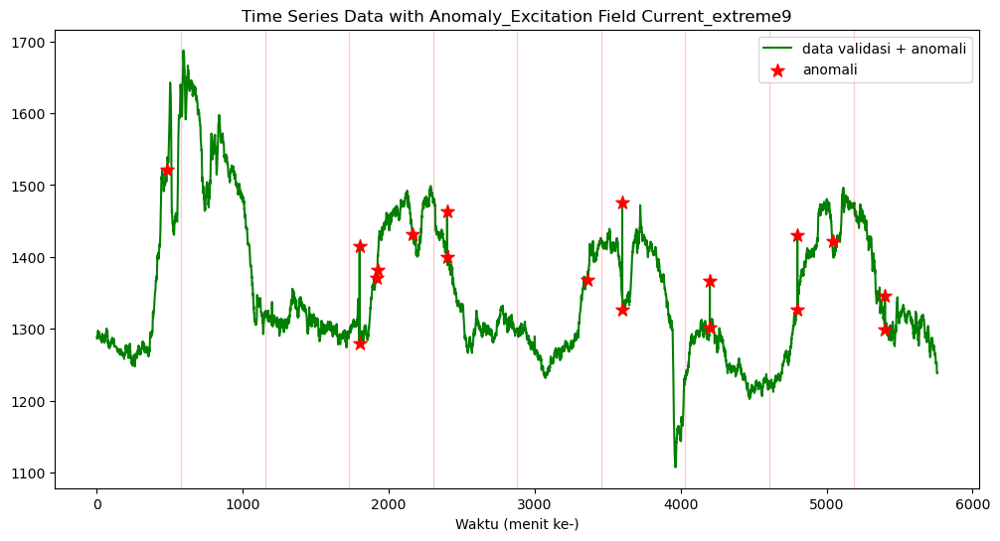

plot/Time Series Data with Anomaly_Excitation Field Current_extreme9.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  9
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:22:18.937843
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Excitation Field Voltage _ extreme 9
| > Sensor Start Time:  2023-05-19 08:22:18.937843 



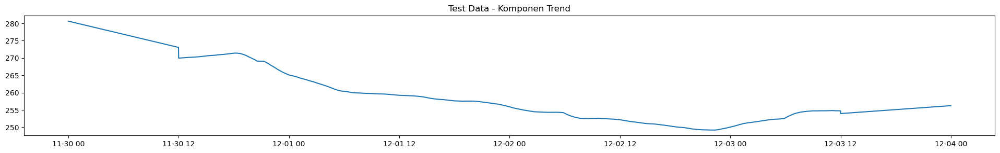

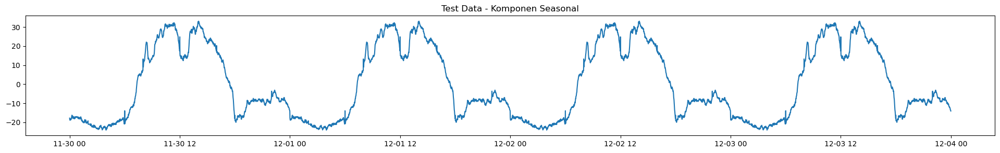

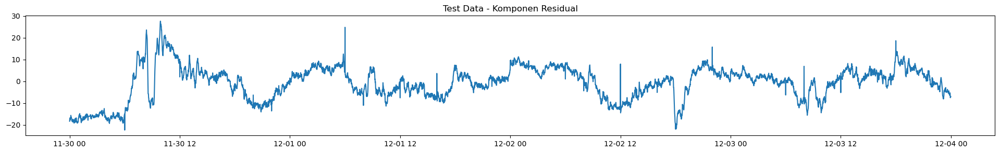

180/180 [==============================] - 1s 1ms/step


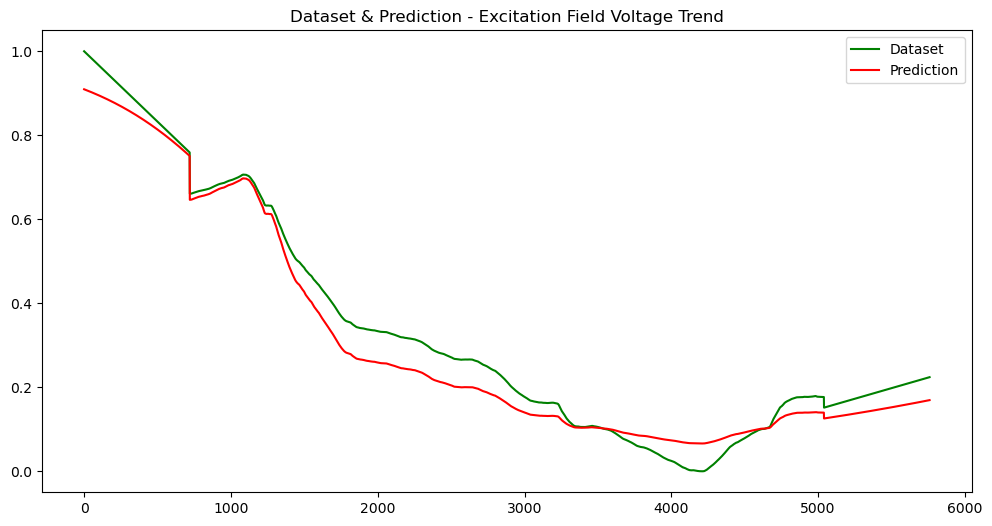

plot/Dataset & Prediction_Excitation Field Voltage_Trend.jpg
180/180 [==============================] - 1s 2ms/step


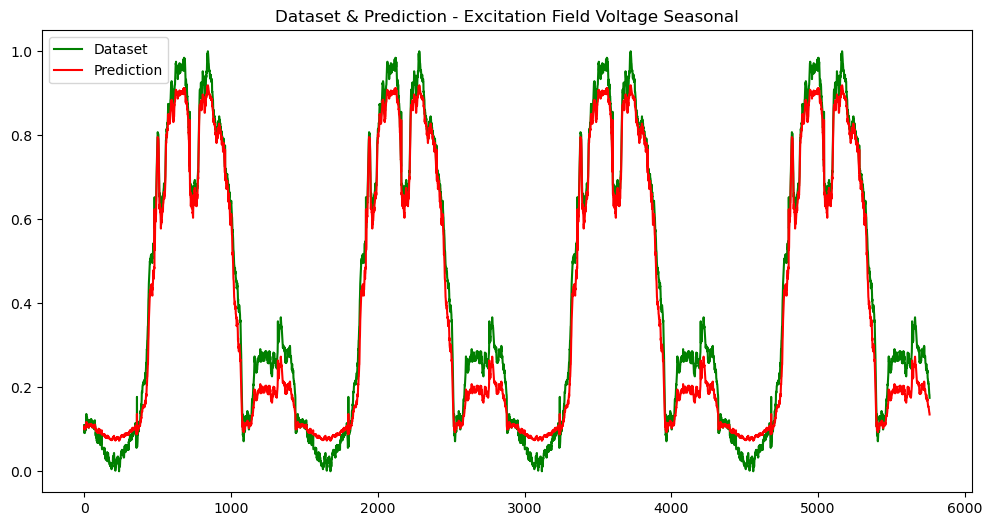

plot/Dataset & Prediction_Excitation Field Voltage_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


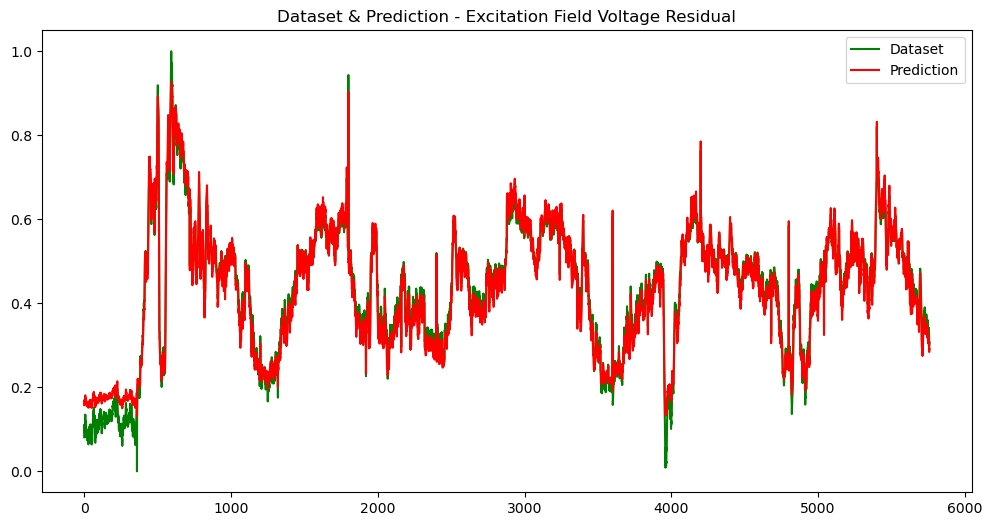

plot/Dataset & Prediction_Excitation Field Voltage_Residual.jpg


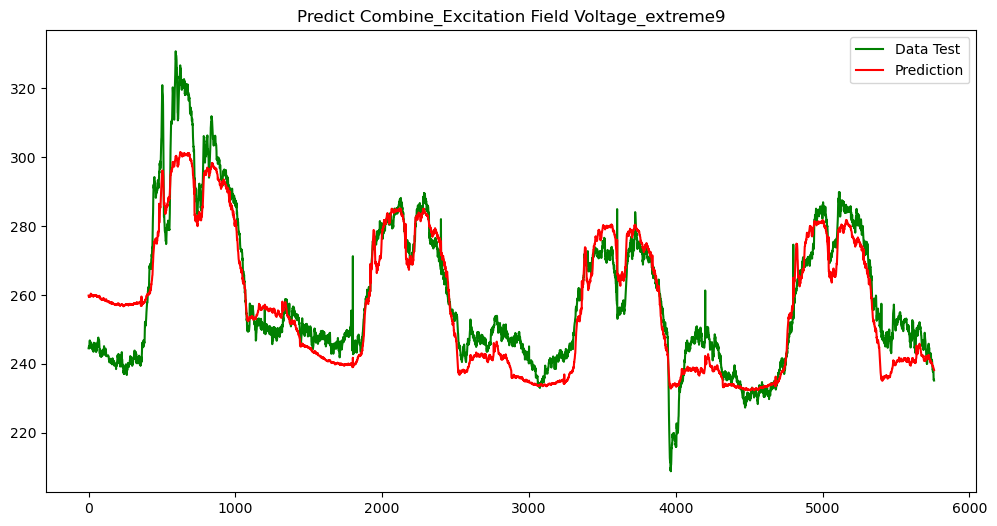

plot/Predict Combine_Excitation Field Voltage_extreme9.jpg
| > errorsDF:  [15.30105405 14.64023208 14.50780301 ...  3.08093641  2.96698193
  3.04064365]
| > RSME:  8.041801190403824
| > MSE:  64.67056638598036
| > MAE:  6.428912425006039
Threshold:  6.915665416271418


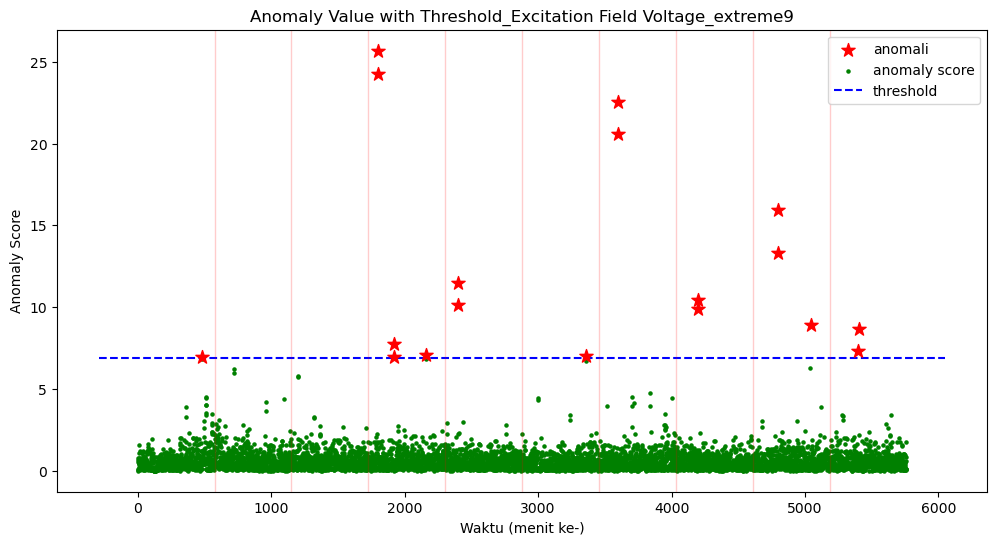

plot/Anomaly Value with Threshold_Excitation Field Voltage_extreme9.jpg


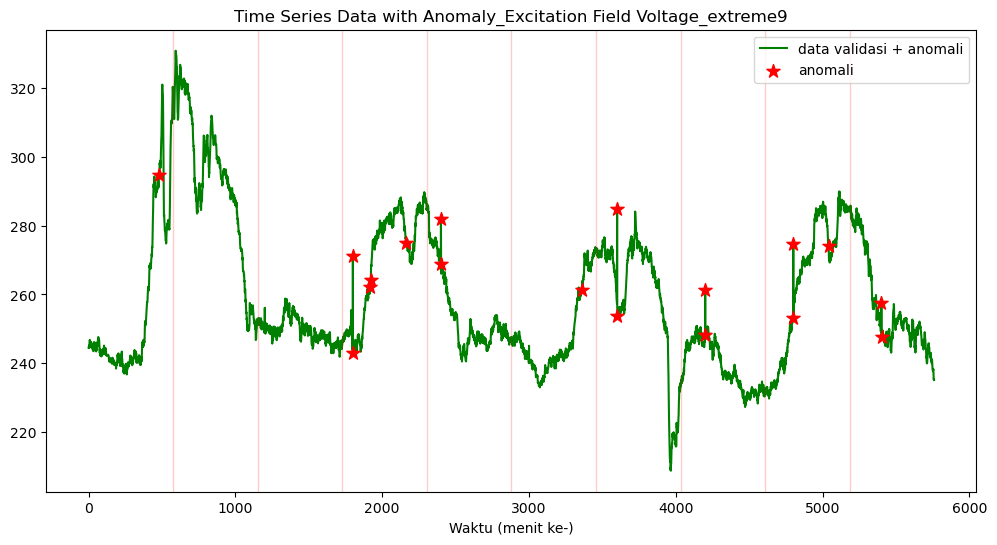

plot/Time Series Data with Anomaly_Excitation Field Voltage_extreme9.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  9
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:22:27.744857
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Power Factor _ extreme 9
| > Sensor Start Time:  2023-05-19 08:22:27.744857 



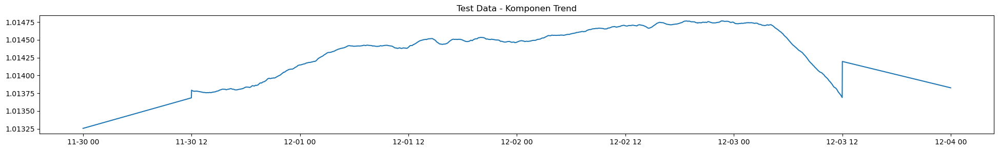

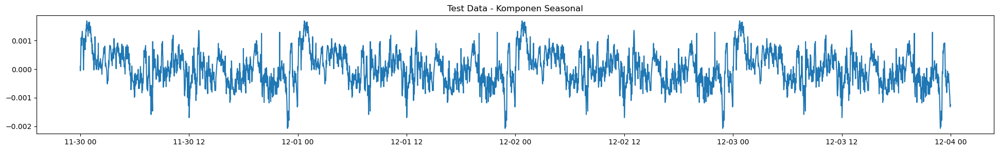

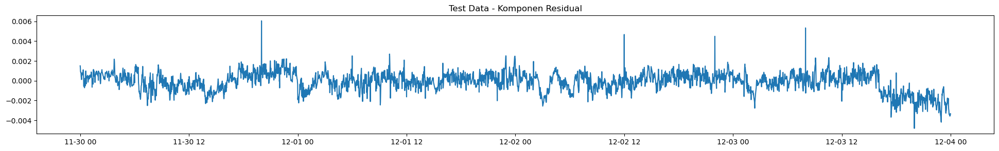

180/180 [==============================] - 1s 1ms/step


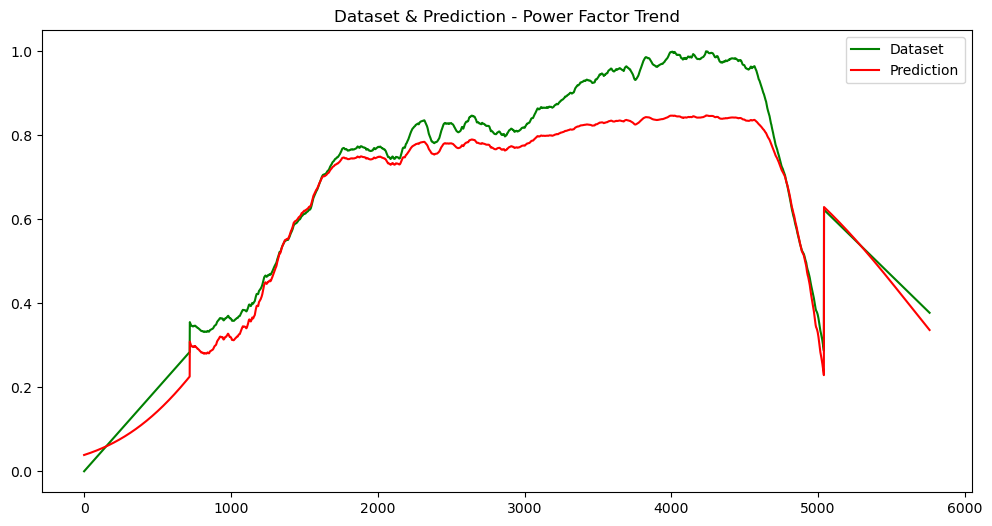

plot/Dataset & Prediction_Power Factor_Trend.jpg
180/180 [==============================] - 1s 1ms/step


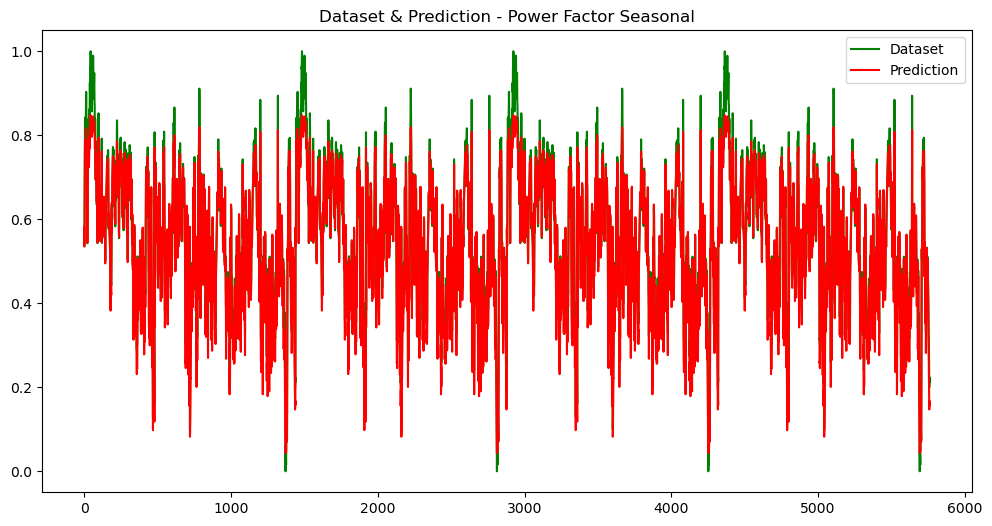

plot/Dataset & Prediction_Power Factor_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


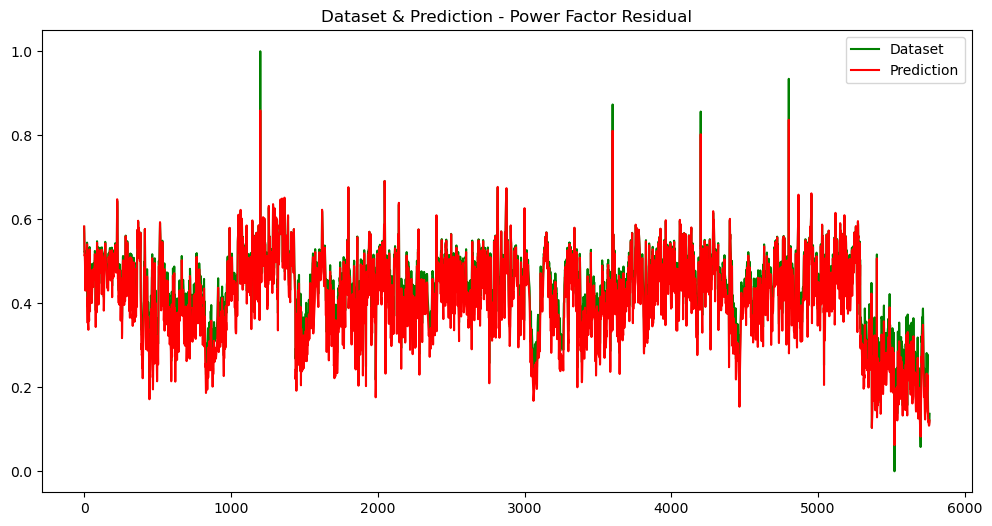

plot/Dataset & Prediction_Power Factor_Residual.jpg


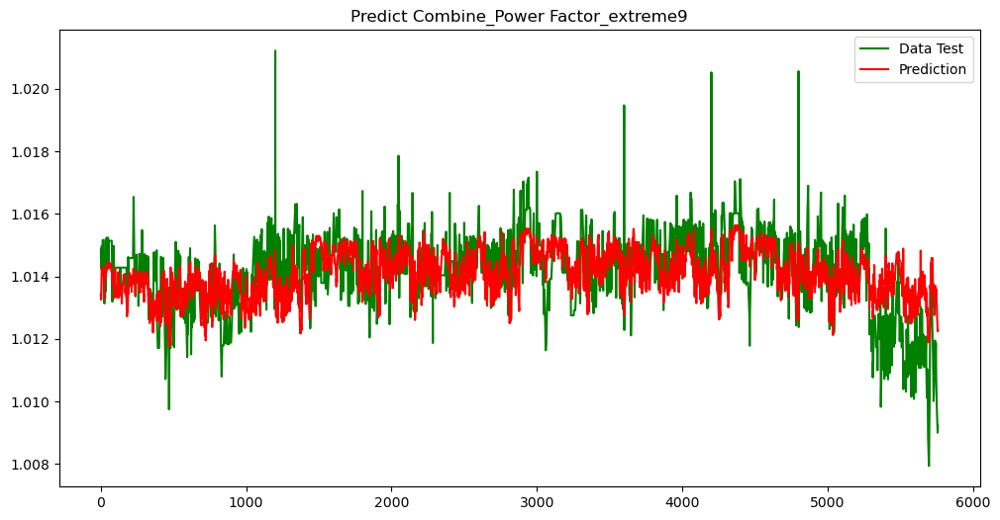

plot/Predict Combine_Power Factor_extreme9.jpg
| > errorsDF:  [0.00142993 0.00129416 0.0009519  ... 0.0032421  0.0032071  0.0030548 ]
| > RSME:  0.0009575287801933437
| > MSE:  9.168613648985527e-07
| > MAE:  0.0007463198508764201
Threshold:  0.002199424772441866


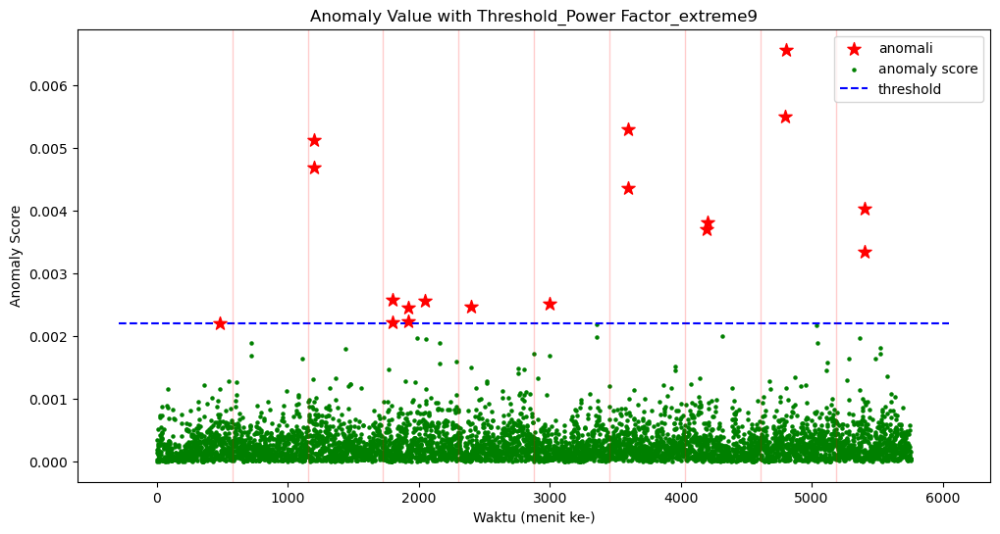

plot/Anomaly Value with Threshold_Power Factor_extreme9.jpg


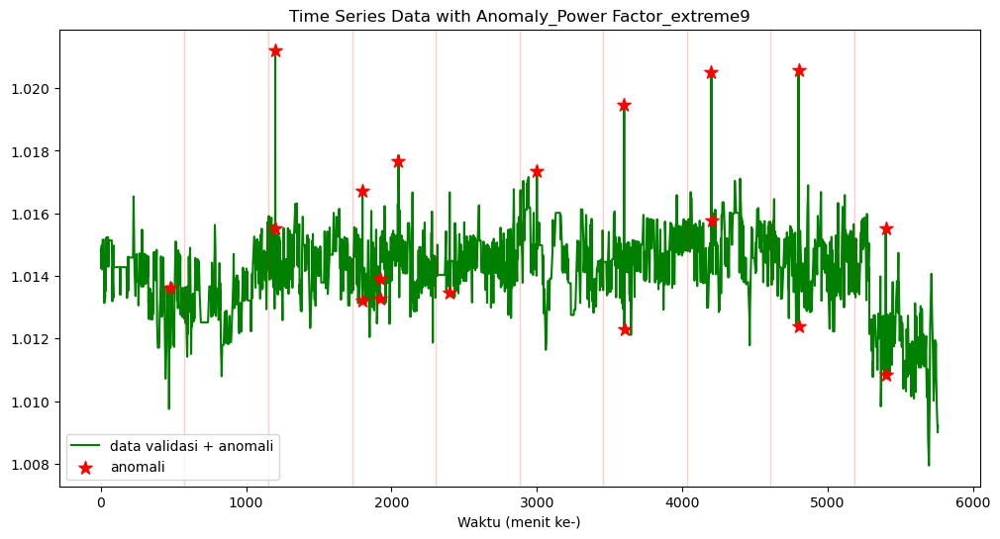

plot/Time Series Data with Anomaly_Power Factor_extreme9.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  9
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:22:36.194418
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Reactive Power _ extreme 9
| > Sensor Start Time:  2023-05-19 08:22:36.194418 



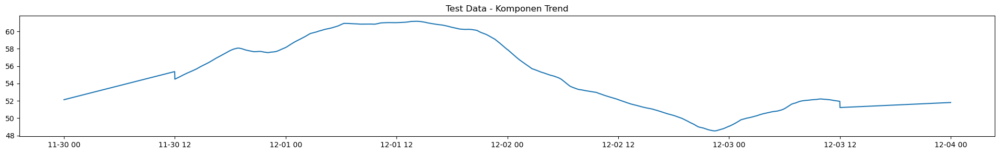

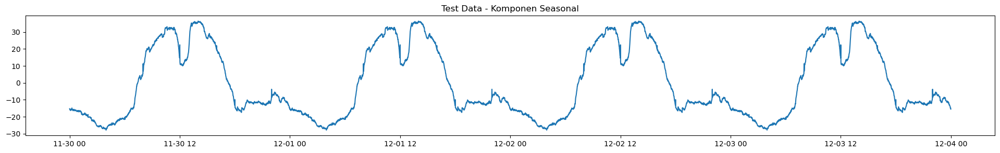

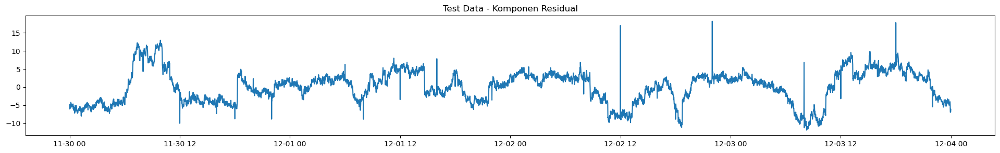

180/180 [==============================] - 1s 1ms/step


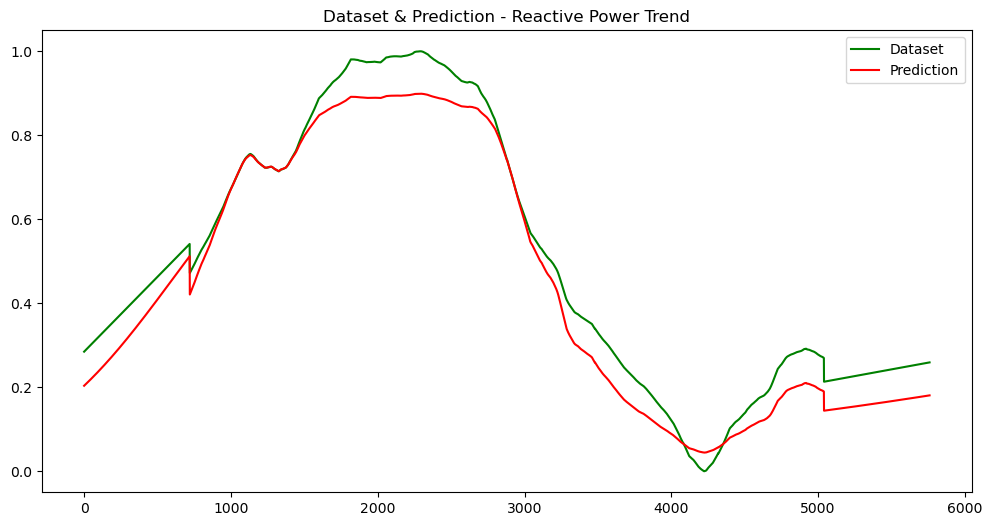

plot/Dataset & Prediction_Reactive Power_Trend.jpg
180/180 [==============================] - 1s 1ms/step


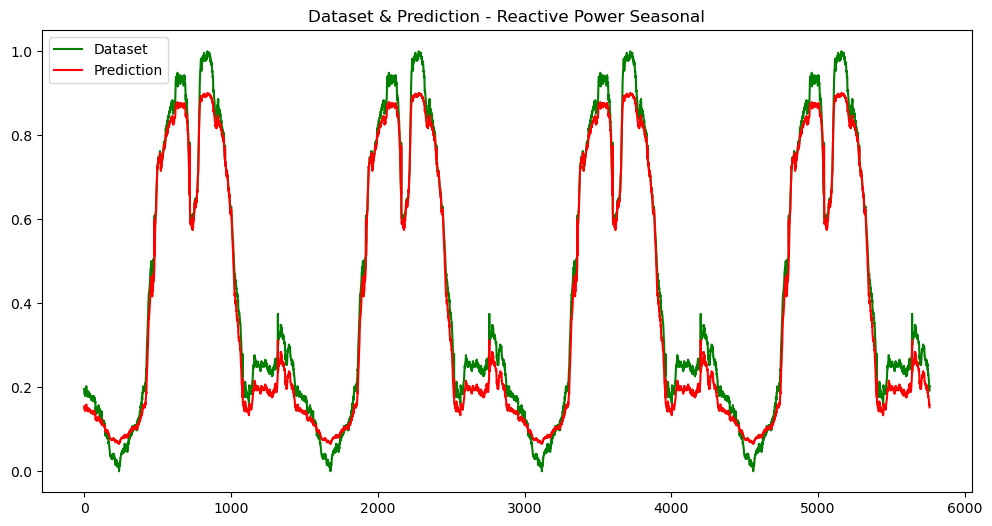

plot/Dataset & Prediction_Reactive Power_Seasonal.jpg
180/180 [==============================] - 1s 2ms/step


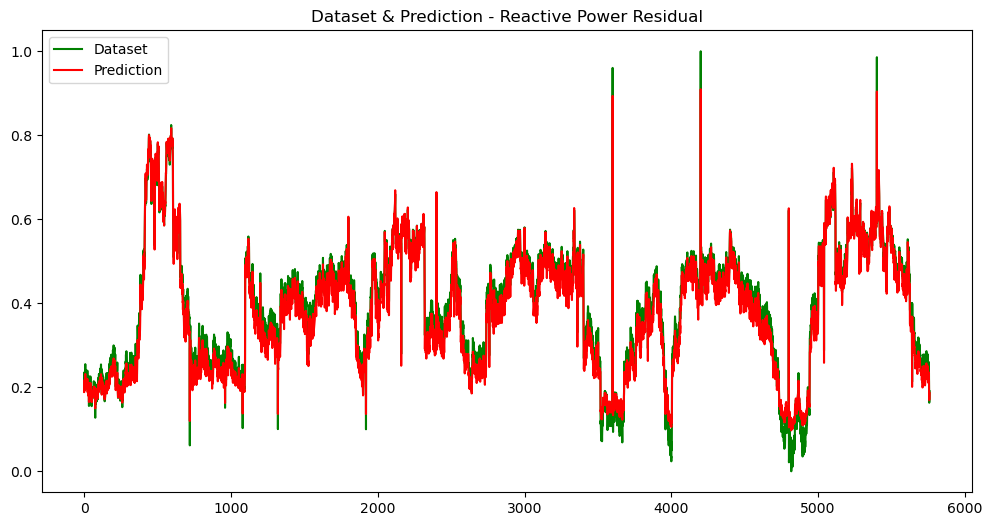

plot/Dataset & Prediction_Reactive Power_Residual.jpg


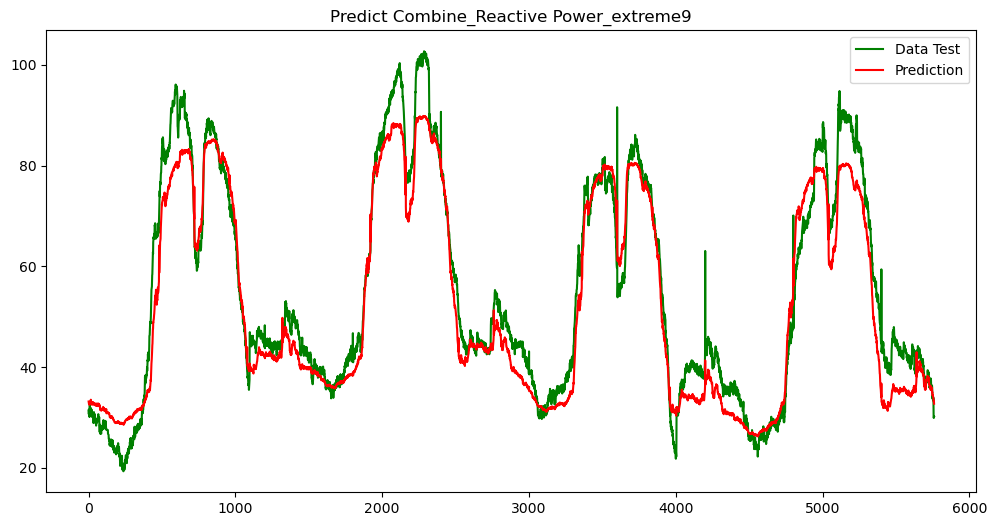

plot/Predict Combine_Reactive Power_extreme9.jpg
| > errorsDF:  [2.33687973 1.29001617 1.4841156  ... 3.20504952 3.0796814  2.56773567]
| > RSME:  5.517800516582604
| > MSE:  30.446122540799248
| > MAE:  4.462614298841326
Threshold:  6.893943890408701


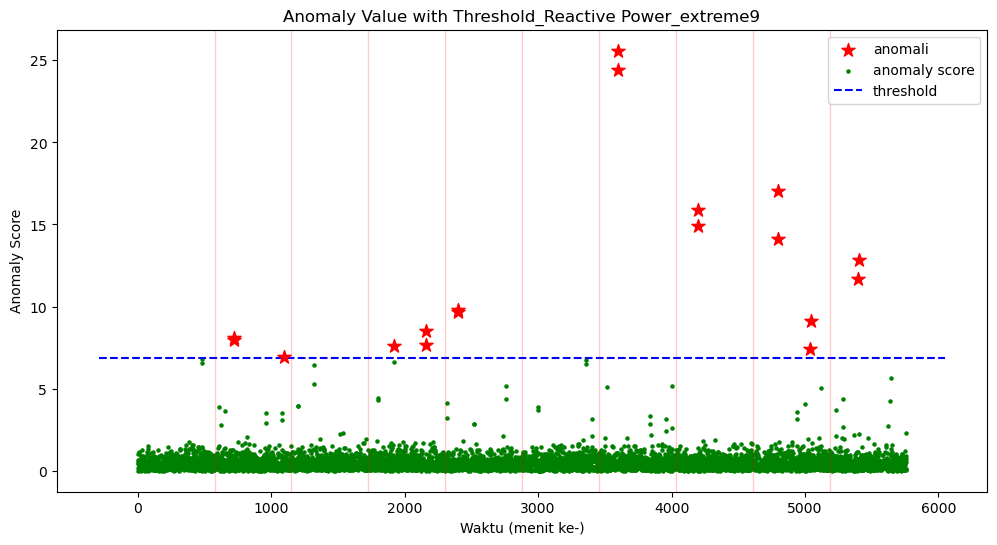

plot/Anomaly Value with Threshold_Reactive Power_extreme9.jpg


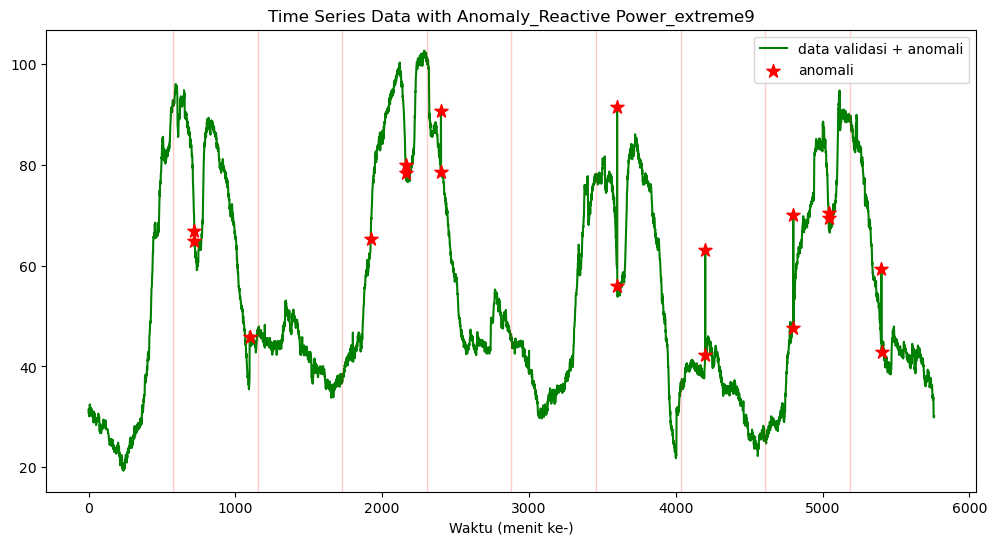

plot/Time Series Data with Anomaly_Reactive Power_extreme9.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  9
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:22:45.232344
| ========================================================================================== |


| ========================================================================================== |
| Testing Sensor:  Generator Gross Capacity _ extreme 9
| > Sensor Start Time:  2023-05-19 08:22:45.232344 



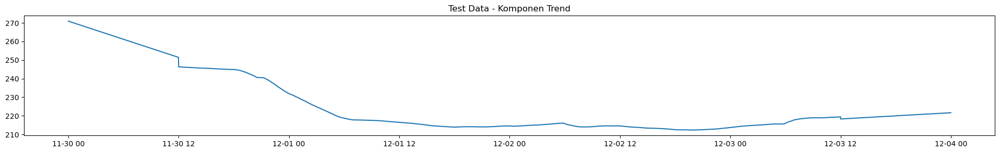

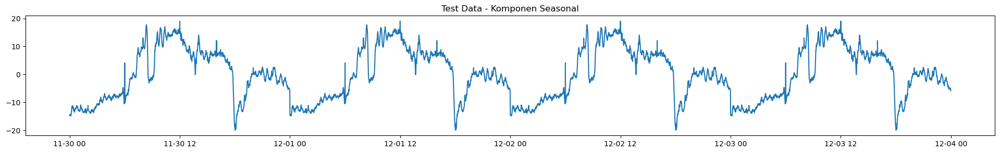

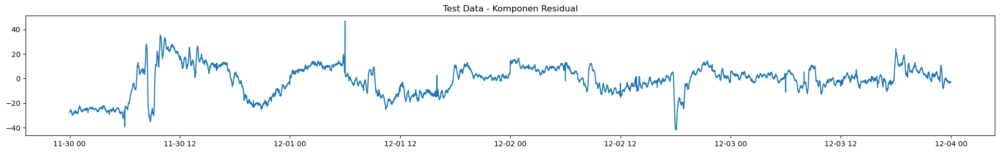

180/180 [==============================] - 1s 1ms/step


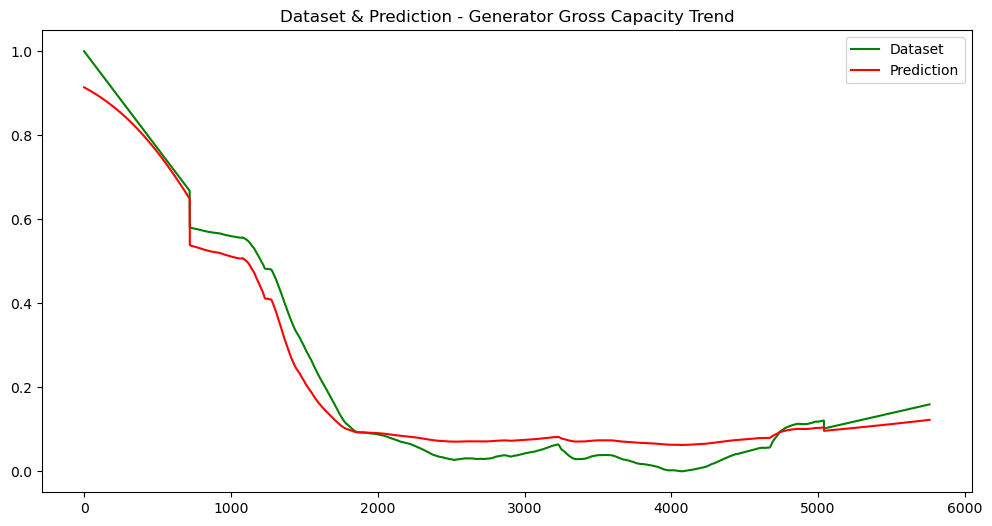

plot/Dataset & Prediction_Generator Gross Capacity_Trend.jpg
180/180 [==============================] - 1s 1ms/step


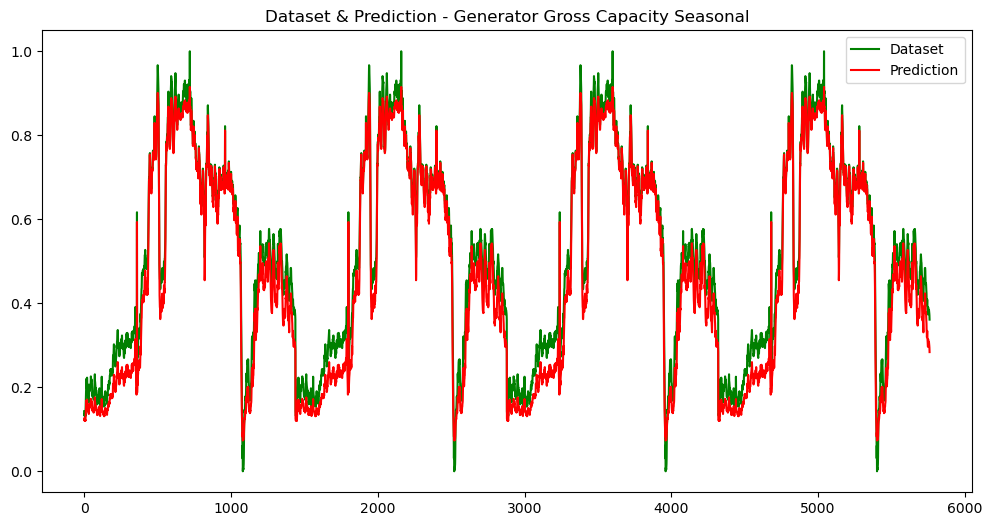

plot/Dataset & Prediction_Generator Gross Capacity_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


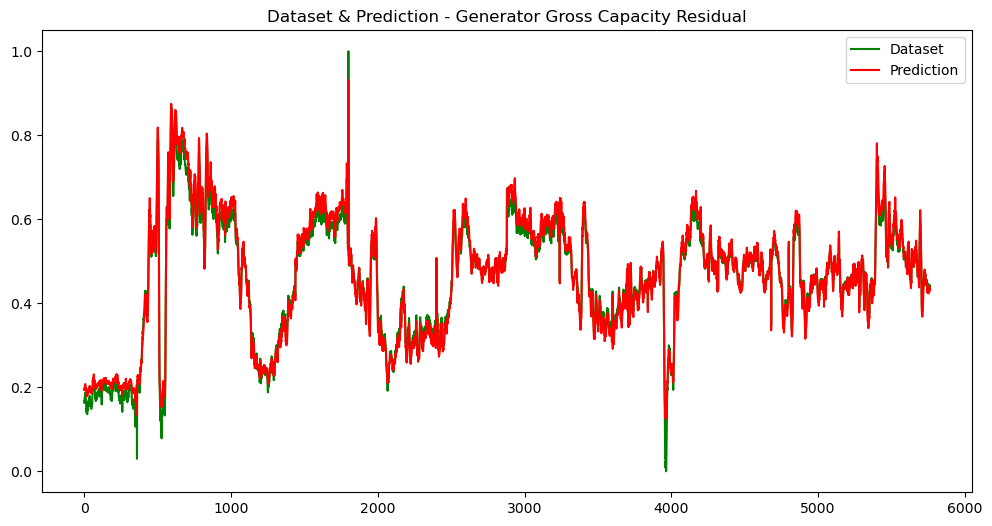

plot/Dataset & Prediction_Generator Gross Capacity_Residual.jpg


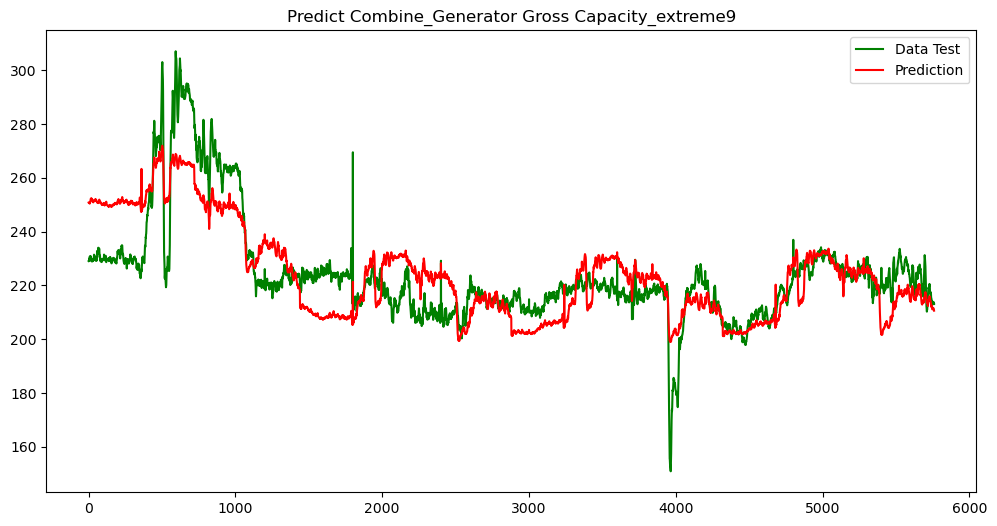

plot/Predict Combine_Generator Gross Capacity_extreme9.jpg
| > errorsDF:  [21.73288822 21.51615338 21.57652667 ...  2.49514099  1.97597311
  2.45254133]
| > RSME:  12.16917923766723
| > MSE:  148.08892331847116
| > MAE:  9.72329789066909
Threshold:  7.297756898473734


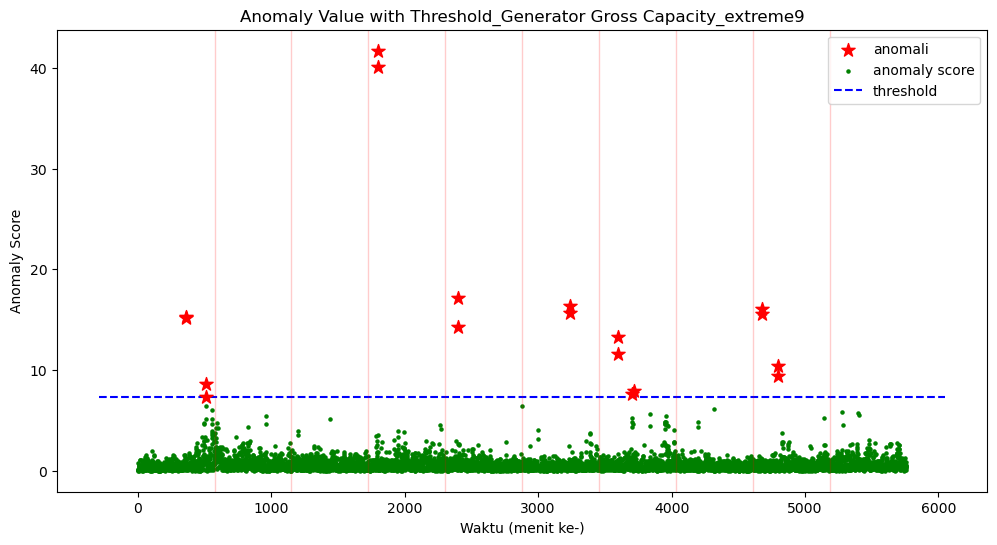

plot/Anomaly Value with Threshold_Generator Gross Capacity_extreme9.jpg


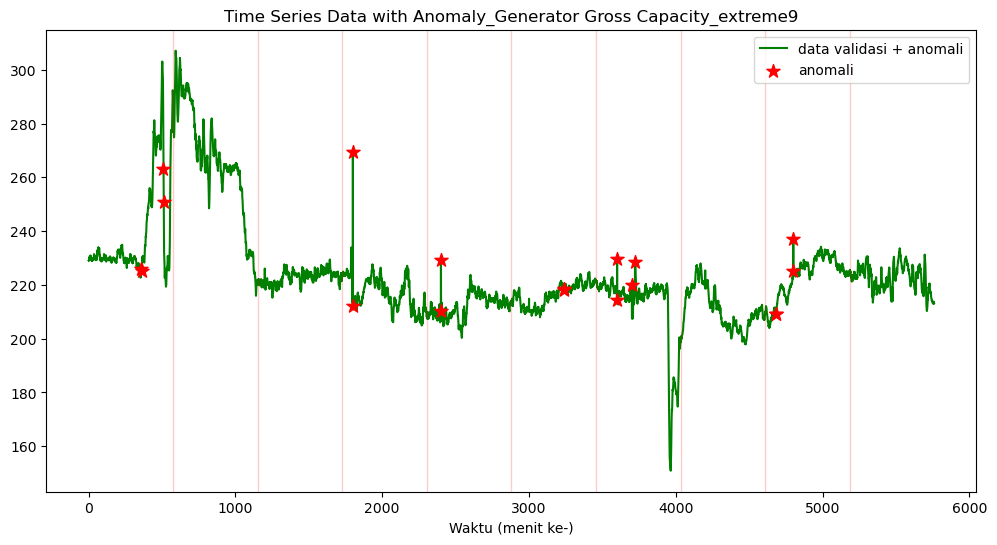

plot/Time Series Data with Anomaly_Generator Gross Capacity_extreme9.jpg
| > Anomaly Predicted:  18
| > True Positif:  0
| > False Positif:  18
| > False Negative:  9
| > Precision:  0.0
| > Recall:  0.0
| > F1:  0

| > Sensor End Time:  2023-05-19 08:22:55.598181
| ========================================================================================== |



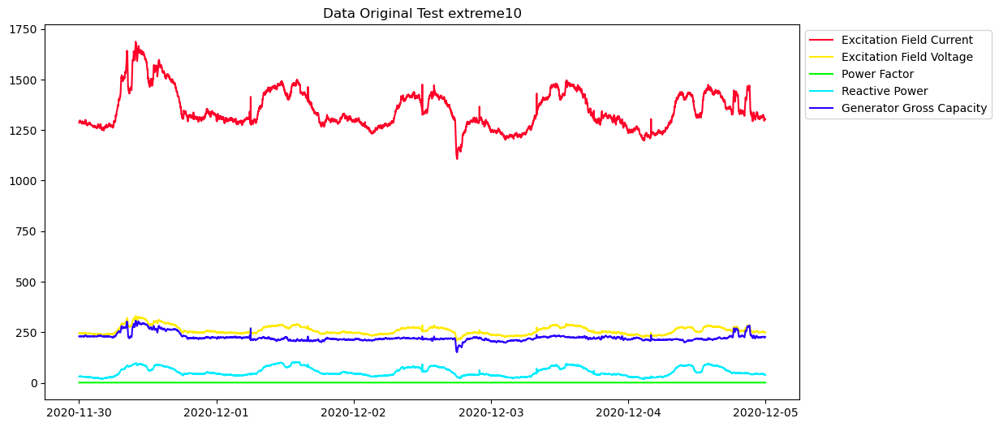


| ========================================================================================== |
| Testing Sensor:  Excitation Field Current _ extreme 10
| > Sensor Start Time:  2023-05-19 08:22:58.998187 



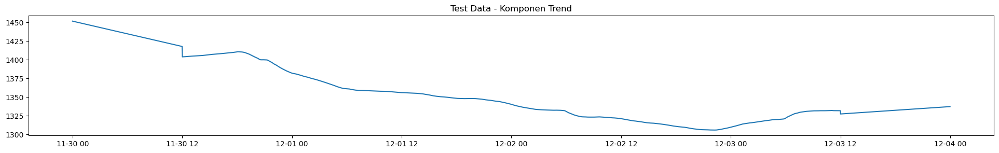

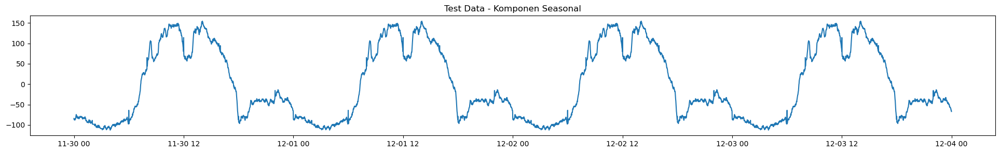

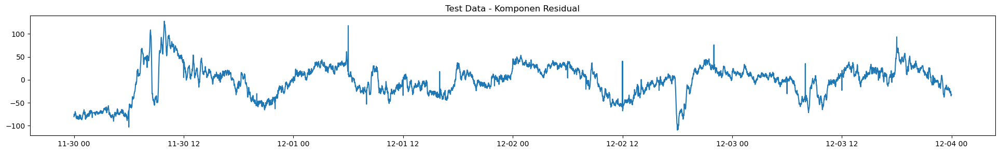

180/180 [==============================] - 1s 1ms/step


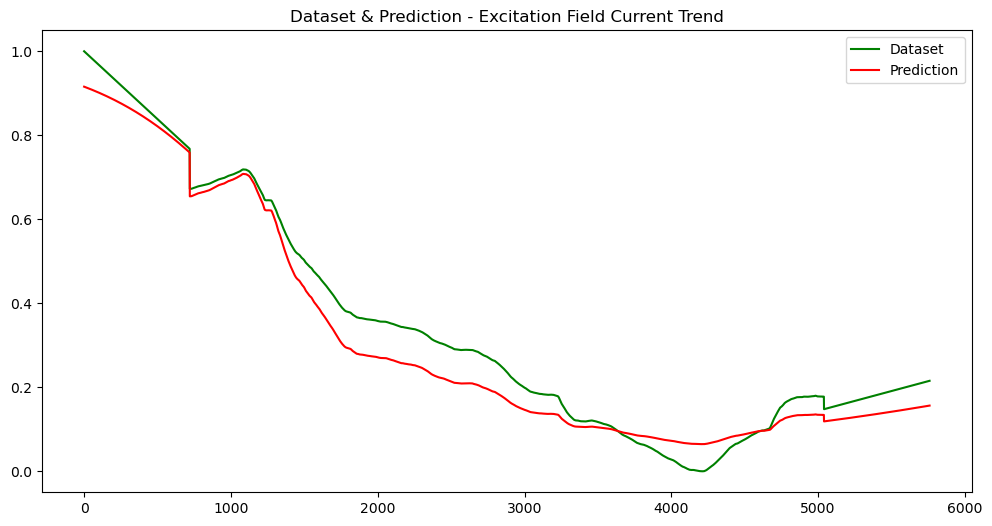

plot/Dataset & Prediction_Excitation Field Current_Trend.jpg
180/180 [==============================] - 1s 1ms/step


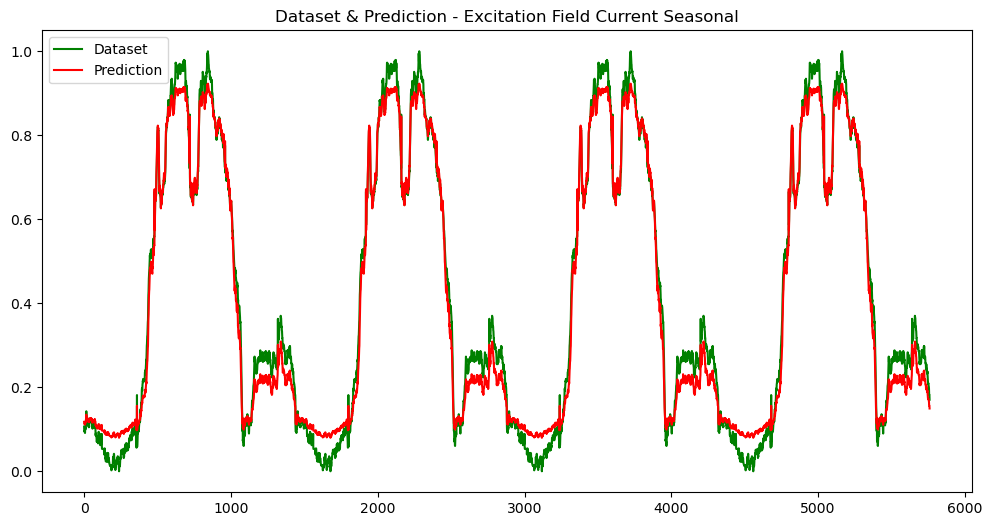

plot/Dataset & Prediction_Excitation Field Current_Seasonal.jpg
180/180 [==============================] - 1s 1ms/step


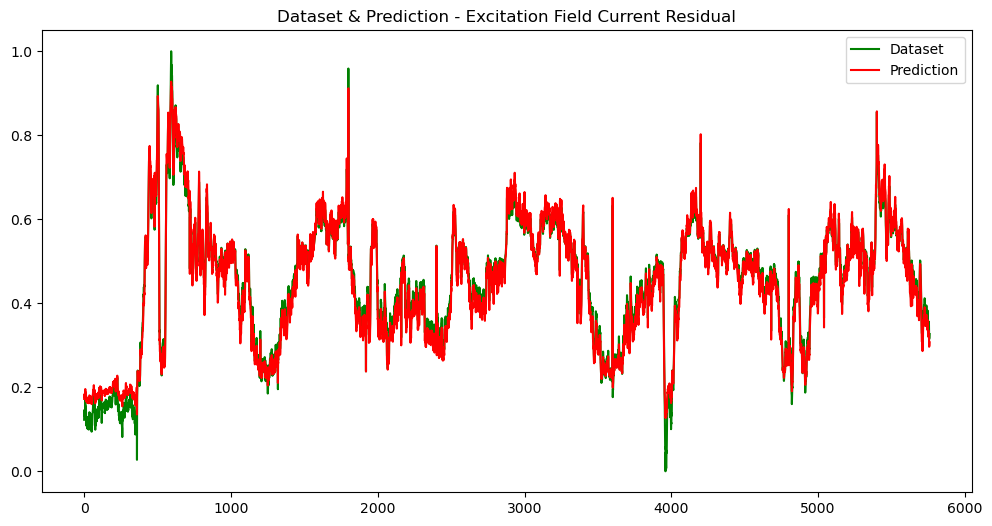

plot/Dataset & Prediction_Excitation Field Current_Residual.jpg


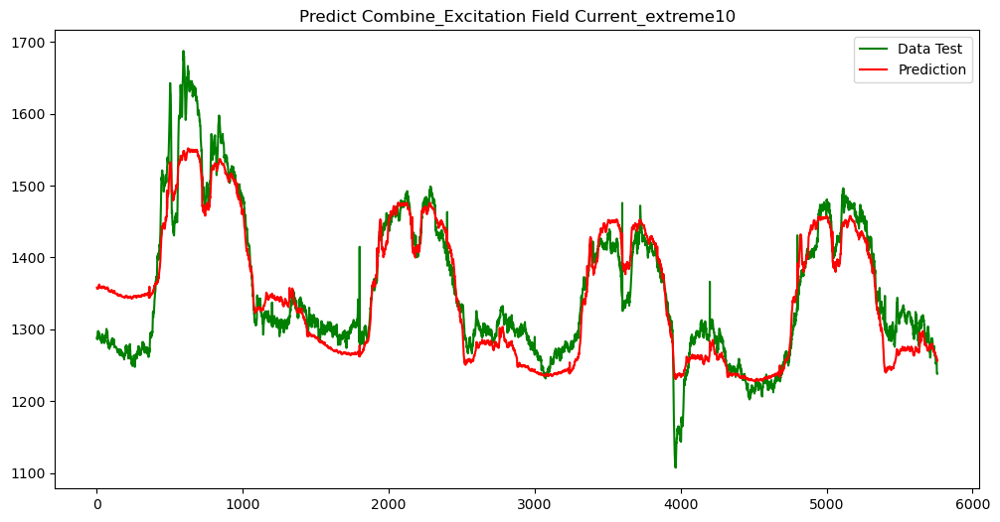

plot/Predict Combine_Excitation Field Current_extreme10.jpg
| > errorsDF:  [71.05370335 67.28019707 67.70659591 ... 18.80821987 18.55730447
 17.78171533]
| > RSME:  36.22730630606076
| > MSE:  1312.4177221931498
| > MAE:  28.413109691697343
Threshold:  31.423407974543764


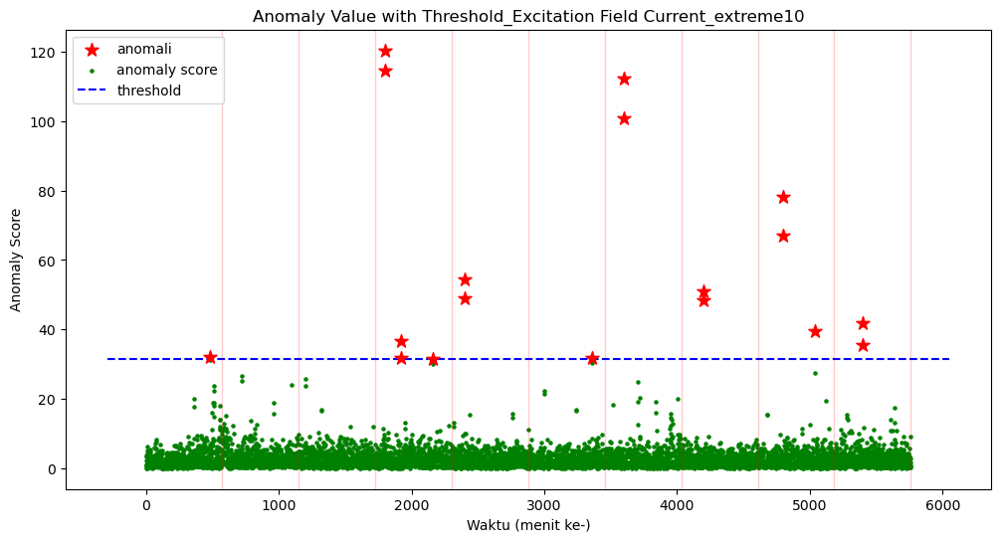

plot/Anomaly Value with Threshold_Excitation Field Current_extreme10.jpg


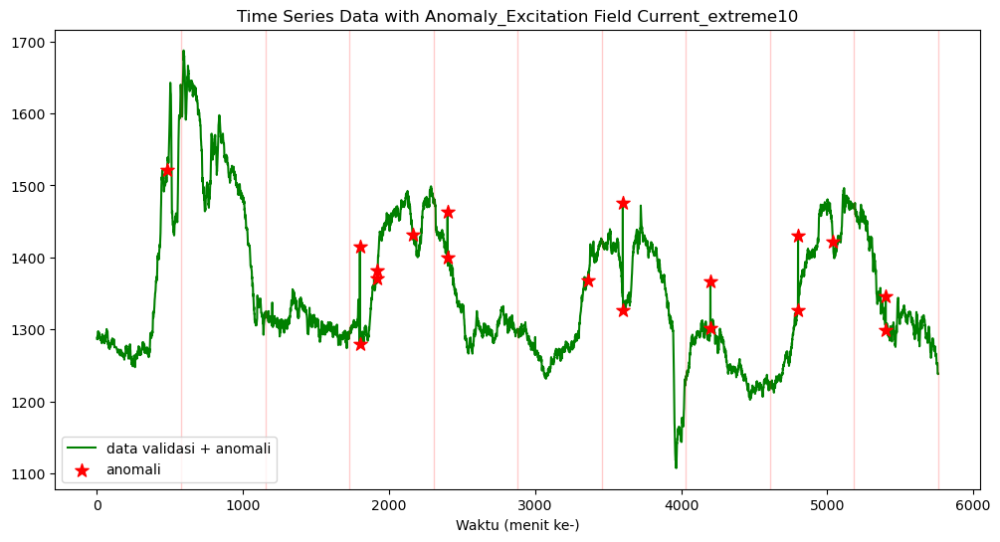

plot/Time Series Data with Anomaly_Excitation Field Current_extreme10.jpg


IndexError: positional indexers are out-of-bounds

In [16]:
for test_type in test_types:
  for anomaly_count in range(1,11):
    
    # Import Test Data
    df_test_original = pd.read_csv(filepath_or_buffer=DATA_TEST_PATH+DATA_TEST_PREFIX+'_'+test_type+str(anomaly_count)+'.csv', header=0, sep=',')
    df_test_original = df_test_original.loc[:, df_test_original.columns.intersection(sensors)]
    #Reshape data
    df_test_reshape = Reshape(df_test_original,'Test '+test_type + str(anomaly_count))

    for sensor in sensors:
      if sensor != 'date': 
        print('\n| ========================================================================================== |')
        print('| Testing Sensor: ',sensor,'_',test_type,anomaly_count)
        print('| > Sensor Start Time: ',datetime.now(),'\n')

    # Trim Test Data________________________________
        samples = df_test_reshape[sensor].shape[0]
        trim = samples % 1440
        df_test = df_test_reshape[sensor][:samples - trim].copy()
        # Split Seasonal
        df_test_trend, df_test_seasonal, df_test_residual = SplitSeasonalDecompose(df_test,'Test Data - Komponen')
        # MinMaxScaled
        df_test_trend_scaled, transform_test_trend = FitScaler(df_test_trend)
        df_test_seasonal_scaled, transform_test_seasonal = FitScaler(df_test_seasonal)
        df_test_residual_scaled, transform_test_residual = FitScaler(df_test_residual)

    # Prediction____________________________
        prediction_trend_reshape = Prediction(df_test_trend_scaled,sensor, 'Trend')
        prediction_seasonal_reshape = Prediction(df_test_seasonal_scaled,sensor, 'Seasonal')
        prediction_residual_reshape = Prediction(df_test_residual_scaled,sensor, 'Residual')

    # Inverse Scaler____________________________
        prediction_trend_transform = transform_test_trend.inverse_transform(prediction_trend_reshape)
        prediction_seasonal_transform = transform_test_seasonal.inverse_transform(prediction_seasonal_reshape)
        prediction_residual_transform = transform_test_residual.inverse_transform(prediction_residual_reshape)

    # Combine Prediction into One_________________
        prediction_combined = np.zeros(df_test.shape[0])
        for i in range(0,df_test.shape[0]):
          for selection in prediction_params[sensor]['seasonal_selections'][test_type]:
            if selection == 'Trend' or selection == 'Extreme':
              prediction_combined[i] = prediction_combined[i]+prediction_trend_transform[i][0]
            elif selection == 'Seasonal':
              prediction_combined[i] = prediction_combined[i]+prediction_seasonal_transform[i][0]
            elif selection == 'Residual':
              prediction_combined[i] = prediction_combined[i]+prediction_residual_transform[i][0]
        
        plt.figure(figsize=PLOT_SIZE)
        plt.plot(df_test.values.flatten(), label="Data Test", color='g')
        plt.plot(prediction_combined, label='Prediction', color='r')
        plt.title('Predict Combine_'+sensor+'_'+ test_type + str(anomaly_count))
        plt.savefig(PLOT_EXPORT_PATH + 'Predict Combine_'+sensor+'_'+ test_type + str(anomaly_count) + '.jpg', bbox_inches="tight")
        plt.legend()
        plt.show()
        print(PLOT_EXPORT_PATH + 'Predict Combine_'+sensor+'_'+ test_type +str(anomaly_count) + '.jpg')

    # Detect Anomaly
        testing_dataset  = df_test.values.flatten()
        df_error = abs(testing_dataset - prediction_combined) #save
        RMSE = math.sqrt(mean_squared_error(testing_dataset, prediction_combined)) #save
        MSE = mean_squared_error(testing_dataset, prediction_combined)
        MAE = mean_absolute_error(testing_dataset, prediction_combined)

        print('| > errorsDF: ',df_error)
        print('| > RSME: ',RMSE)
        print('| > MSE: ',MSE)
        print('| > MAE: ',MAE)

    # Detect Anomaly
        threshold, anomaly_value, anomaly_label = AnomalyDetection(testing_dataset,prediction_combined, prediction_params)
        df_result = pd.DataFrame({'df_anomaly': np.array(df_test).flatten(), 'anomaly_value': anomaly_value, 'anomaly_label': anomaly_label})

    # Plot Result
        PlotPrediction(df_result,threshold,anomaly_count,sensor+'_'+test_type + str(anomaly_count))
    
    # Calculate Metric
        anomaly_predicted,true_positive, false_positive, false_negative, df_false_positive = CalculateMetic(df_result, anomaly_count)
        
        true_negative = df_result.shape[0]-anomaly_predicted
        precision = true_positive/(true_positive + false_negative)
        recall = true_positive/(true_positive + false_negative)
        if  (precision != 0 or recall != 0):
          f1 = 2*((precision*recall) / (precision+recall))
        else:
          f1=0
        print('| > Precision: ',precision)
        print('| > Recall: ',recall)
        print('| > F1: ',f1) 

        print('\n| > Sensor End Time: ',datetime.now())
        print('| ========================================================================================== |\n') 
      # Save result
        summary.append([
          sensor,
          test_type,
          anomaly_count,
          RMSE,        
          MSE,        
          MAE,        
          threshold,
          anomaly_predicted,
          true_positive,
          false_positive,
          true_negative,
          false_negative,
          precision,
          recall,
          f1
        ])


## Save Summary

In [ ]:
export_summary = pd.DataFrame(summary,columns = ['sensor','test_type','anomaly_count','rmse','mse','mae','threshold','anomaly_predicted',
                                                 'true_positive','false_positive','true_negative','false_negative','precision','recall','f1'])

TIMESTAMP = datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
export_summary.to_excel(LOG_EXPORT_PATH+'Prediction_summary('+TIMESTAMP+').xlsx', index=False)
print('Export to: ',LOG_EXPORT_PATH+'Prediction_summary('+TIMESTAMP+').xlsx')
export_summary